# Name: Vara Prasad Repakula
# Student ID: 20249550

## The aim of this research is to make a contribution to the UN SDG 7,especially Target 7.2 (Forecasting  renewable energy consumption using time series models).It is focussed on key countries of renewable energy consumption and then forecasting by the year 2030 and evaluating model accuracy.

# Identifying Vital Countries

In [1]:
#import numpy as np
#pip install scipy

In [2]:
import statsmodels.graphics.tsaplots as sgt

In [3]:
# importing pandas library to convert csv file into pandas data frame for further analysis
import pandas as pd
df=pd.read_csv('owid-energy-data.csv')
df

,country,year,iso_code,population,gdp,biofuel_cons_change_pct,biofuel_cons_change_twh,biofuel_cons_per_capita,biofuel_consumption,biofuel_elec_per_capita,...,solar_share_elec,solar_share_energy,wind_cons_change_pct,wind_cons_change_twh,wind_consumption,wind_elec_per_capita,wind_electricity,wind_energy_per_capita,wind_share_elec,wind_share_energy
0,Afghanistan,1900,AFG,4832414.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,1901,AFG,4879685.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Afghanistan,1902,AFG,4935122.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Afghanistan,1903,AFG,4998861.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Afghanistan,1904,AFG,5063419.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21885,Zimbabwe,2017,ZWE,14751101.0,2.194784e+10,NaN,NaN,NaN,NaN,21.693,...,0.136,NaN,NaN,NaN,NaN,0.0,0.0,NaN,0.0,NaN
21886,Zimbabwe,2018,ZWE,15052191.0,2.271535e+10,NaN,NaN,NaN,NaN,25.910,...,0.218,NaN,NaN,NaN,NaN,0.0,0.0,NaN,0.0,NaN
21887,Zimbabwe,2019,ZWE,15354606.0,NaN,NaN,NaN,NaN,NaN,24.748,...,0.364,NaN,NaN,NaN,NaN,0.0,0.0,NaN,0.0,NaN
21888,Zimbabwe,2020,ZWE,15669663.0,NaN,NaN,NaN,NaN,NaN,22.336,...,0.395,NaN,NaN,NaN,NaN,0.0,0.0,NaN,0.0,NaN


This dataset is very big contains huge amount of data,But Inorder to identify the Key countries in the world for renewable energy consumption,the mentioned column named 'renewables_consumption' :Primary energy consumption from renewables, measured in terawatt-hours is used.

In [4]:
#Taking the particular column along wit the other useful data in a separate dataframe
df_world_renw_1=df[['country','year','iso_code','renewables_consumption','renewables_share_energy','primary_energy_consumption']]
df_world_renw_1

,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
0,Afghanistan,1900,AFG,NaN,NaN,NaN
1,Afghanistan,1901,AFG,NaN,NaN,NaN
2,Afghanistan,1902,AFG,NaN,NaN,NaN
3,Afghanistan,1903,AFG,NaN,NaN,NaN
4,Afghanistan,1904,AFG,NaN,NaN,NaN
...,...,...,...,...,...,...
21885,Zimbabwe,2017,ZWE,NaN,NaN,45.936
21886,Zimbabwe,2018,ZWE,NaN,NaN,47.502
21887,Zimbabwe,2019,ZWE,NaN,NaN,49.427
21888,Zimbabwe,2020,ZWE,NaN,NaN,NaN


In [5]:
#Taking the particular column along wit the other useful data in a separate dataframe
df_world_renw=df[['country','year','iso_code','renewables_consumption']]
df_world_renw

,country,year,iso_code,renewables_consumption
0,Afghanistan,1900,AFG,NaN
1,Afghanistan,1901,AFG,NaN
2,Afghanistan,1902,AFG,NaN
3,Afghanistan,1903,AFG,NaN
4,Afghanistan,1904,AFG,NaN
...,...,...,...,...
21885,Zimbabwe,2017,ZWE,NaN
21886,Zimbabwe,2018,ZWE,NaN
21887,Zimbabwe,2019,ZWE,NaN
21888,Zimbabwe,2020,ZWE,NaN


In [6]:
#pip install geopandas

In [7]:
#Importing suitable geo pandas libraries to make a visualisation using geo-pandas
import geopandas as gpd
#reading naturalearth_lowres data from built-in datasets of geo pandas
#as it contains country name and country code deatils along with geometry column
lowres_data = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
lowres_data.head()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\980722140.py:5: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  lowres_data = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253.0,Africa,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [8]:
#Geometry column is needed to make visualisation,Which can be incorporated into dataset based on common column iso_code
#Cut down lowres data into required format
lowres_cut=lowres_data[['iso_a3','geometry']]
#rename the iso_code column name in renewable data as iso_a3
df_world_renw=df_world_renw.rename(columns={'iso_code':'iso_a3'})
#Merge the two dataframes based on iso_a3 column
df_renew_merged=lowres_cut.merge(df_world_renw,on='iso_a3')
#Print the finalised dataframe
df_renew_merged


,iso_a3,geometry,country,year,renewables_consumption
0,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,1980,NaN
1,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,1981,NaN
2,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,1982,NaN
3,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,1983,NaN
4,FJI,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000...",Fiji,1984,NaN
...,...,...,...,...,...
14306,SSD,"POLYGON ((30.83385 3.50917, 29.95350 4.17370, ...",South Sudan,2017,NaN
14307,SSD,"POLYGON ((30.83385 3.50917, 29.95350 4.17370, ...",South Sudan,2018,NaN
14308,SSD,"POLYGON ((30.83385 3.50917, 29.95350 4.17370, ...",South Sudan,2019,NaN
14309,SSD,"POLYGON ((30.83385 3.50917, 29.95350 4.17370, ...",South Sudan,2020,NaN


In [9]:
df_renew_merged.isnull().sum()
#It is better to leave the null values as zero coonsumption,even though the data is available

iso_a3                        0
geometry                      0
country                       0
year                          0
renewables_consumption    10209
dtype: int64

In [10]:
df_renew_merged.dropna(inplace=True)
df_renew_merged

,iso_a3,geometry,country,year,renewables_consumption
271,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,1965,349.185
272,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,1966,387.366
273,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,1967,396.012
274,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,1968,402.742
275,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,1969,445.435
...,...,...,...,...,...
14296,TTO,"POLYGON ((-61.68000 10.76000, -61.10500 10.890...",Trinidad and Tobago,2017,0.014
14297,TTO,"POLYGON ((-61.68000 10.76000, -61.10500 10.890...",Trinidad and Tobago,2018,0.012
14298,TTO,"POLYGON ((-61.68000 10.76000, -61.10500 10.890...",Trinidad and Tobago,2019,0.012
14299,TTO,"POLYGON ((-61.68000 10.76000, -61.10500 10.890...",Trinidad and Tobago,2020,0.012


In [11]:
#Considering the consumption data after the year 2000 only
mask = df_renew_merged['year'] > 2000
selected_rows = df_renew_merged[mask]
#Setting year as index
#selected_rows.year=pd.to_datetime(selected_rows.year,format='%Y', errors='coerce')
#selected_rows.set_index("year",inplace=True)
selected_rows

,iso_a3,geometry,country,year,renewables_consumption
307,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,2001,1007.382
308,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,2002,1054.336
309,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,2003,1008.656
310,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,2004,1010.894
311,CAN,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,2005,1072.182
...,...,...,...,...,...
14296,TTO,"POLYGON ((-61.68000 10.76000, -61.10500 10.890...",Trinidad and Tobago,2017,0.014
14297,TTO,"POLYGON ((-61.68000 10.76000, -61.10500 10.890...",Trinidad and Tobago,2018,0.012
14298,TTO,"POLYGON ((-61.68000 10.76000, -61.10500 10.890...",Trinidad and Tobago,2019,0.012
14299,TTO,"POLYGON ((-61.68000 10.76000, -61.10500 10.890...",Trinidad and Tobago,2020,0.012


In [12]:
grouped_region=selected_rows.groupby('country')
region_mean=grouped_region['renewables_consumption'].mean()
desc_region= region_mean.sort_values(ascending=False).reset_index()
desc_region.head(10)

,country,renewables_consumption
0,China,2866.105810
1,United States,1707.071857
2,Brazil,1315.456048
3,Canada,1107.953619
4,India,502.991476
5,Russia,492.215381
6,Germany,409.308714
7,Japan,371.267476
8,Norway,366.007143
9,France,257.476238


In [13]:
# the geometry of United states can only be obtained ,if the country name is "United States of America"
us = lowres_data[lowres_data['iso_a3'] == 'USA']
us

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [14]:
#Renaming the "United States" as "United States of America"
desc_region.loc[1, 'country'] = 'United States of America'
desc_region

,country,renewables_consumption
0,China,2866.105810
1,United States of America,1707.071857
2,Brazil,1315.456048
3,Canada,1107.953619
4,India,502.991476
...,...,...
72,Saudi Arabia,0.113550
73,Oman,0.050400
74,Kuwait,0.040550
75,Trinidad and Tobago,0.039524


In [15]:
#finally Merging to get the Geometry Column in the final dataframe
merged_data = lowres_data.merge(desc_region, left_on='name', right_on='country')
merged_data

,pop_est,continent,name,iso_a3,gdp_md_est,geometry,country,renewables_consumption
0,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742...",Canada,1107.953619
1,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000...",United States of America,1707.071857
2,18513930.0,Asia,Kazakhstan,KAZ,181665,"POLYGON ((87.35997 49.21498, 86.59878 48.54918...",Kazakhstan,24.943190
3,33580650.0,Asia,Uzbekistan,UZB,57921,"POLYGON ((55.96819 41.30864, 55.92892 44.99586...",Uzbekistan,17.431952
4,270625568.0,Asia,Indonesia,IDN,1119190,"MULTIPOLYGON (((141.00021 -2.60015, 141.01706 ...",Indonesia,92.379857
...,...,...,...,...,...,...,...,...
72,1198575.0,Asia,Cyprus,CYP,24948,"POLYGON ((32.73178 35.14003, 32.91957 35.08783...",Cyprus,0.556000
73,36471769.0,Africa,Morocco,MAR,119700,"POLYGON ((-2.16991 35.16840, -1.79299 34.52792...",Morocco,9.333714
74,100388073.0,Africa,Egypt,EGY,303092,"POLYGON ((36.86623 22.00000, 32.90000 22.00000...",Egypt,43.832762
75,2083459.0,Europe,North Macedonia,MKD,12547,"POLYGON ((22.38053 42.32026, 22.88137 41.99930...",North Macedonia,3.950476


Text(0.5, 1.0, 'Mean Renewable energy consumption in the world(2000-2021)')

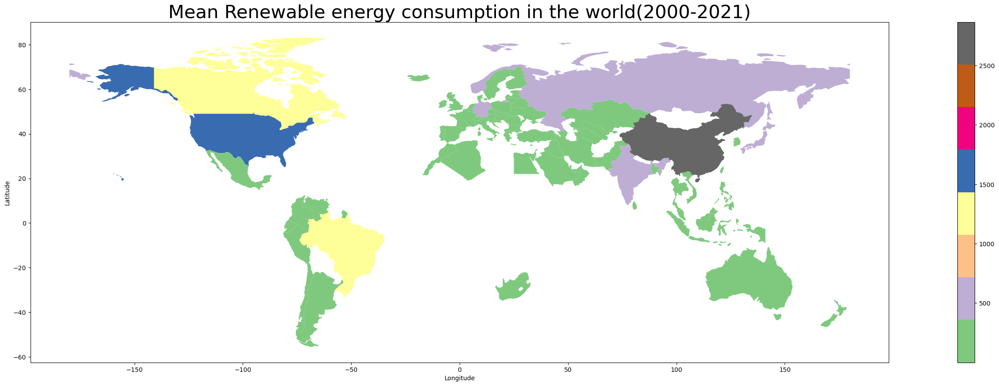

In [16]:
#Importing suitable visualisation library to plot the geo-spatial visualisation
import matplotlib.pyplot as plt 
fig, ax = plt.subplots(figsize=(40,10))
merged_data.plot(column='renewables_consumption', ax=ax, legend=True,cmap='Accent')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Mean Renewable energy consumption in the world(2000-2021)',size=30)

Text(0.5, 1.0, ' Renewable energy consumption in the world for the year 2021')

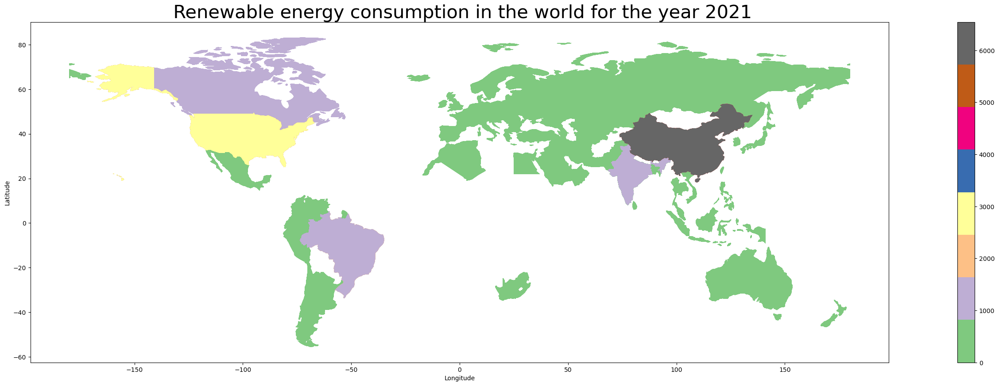

In [17]:
#Importing suitable visualisation library to plot the geo-spatial visualisation
fig, ax = plt.subplots(figsize=(40,10))
selected_rows.plot(column='renewables_consumption', ax=ax, legend=True,cmap='Accent')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title(' Renewable energy consumption in the world for the year 2021',size=30)

Eventhough Russia seems to be almostv equal with india,Ofcourse india is a bit more than Russia,But by the year india can be considered as the fifth most reewable energy consuming country (beated russia).

It is evident from the visualisation that,the major countries for the contribution of renewable energy consumption the world are:

1.China

2.United States

3.Canada

4.Brazil

5.India

These countries are further analysed independently through various time series models and forecasting of renewable consumption in these countries made untill the  year 2030 (based on Target 7.2 of UN SDG).



# 1.Time Series analysis and Forecasting for "China"

## Data Pre-processing 

In [18]:
#Taking the china country data only for further analysis
df_china=df_world_renw_1[df_world_renw_1['country'].isin(['China'])]
df_china


,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
4227,China,1900,CHN,NaN,NaN,NaN
4228,China,1901,CHN,NaN,NaN,NaN
4229,China,1902,CHN,NaN,NaN,NaN
4230,China,1903,CHN,NaN,NaN,NaN
4231,China,1904,CHN,NaN,NaN,NaN
...,...,...,...,...,...,...
4344,China,2017,CHN,4504.976,12.139,37112.145
4345,China,2018,CHN,4940.909,12.807,38578.570
4346,China,2019,CHN,5403.476,13.516,39978.492
4347,China,2020,CHN,5838.805,14.243,40994.574


The data of last 120 years is not required (even not much useful).As the paris agreement of United Nations SDG 7 made in the year 2015.It is advisable to consider the data only from year 2000 to 2021 (No fixed rule just an approximated time period)

In [19]:
#Checking whether there are any null values in dataset
df_china.isnull().sum()

country                        0
year                           0
iso_code                       0
renewables_consumption        65
renewables_share_energy       65
primary_energy_consumption    65
dtype: int64

It doestnot have the data for 65 years lets check whether these are early decades of 19th century or not.If yes,We can drop them.As it is a fact that renwable is not much familiar by that time.

In [20]:
df_china.head(60)

,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
4227,China,1900,CHN,NaN,NaN,NaN
4228,China,1901,CHN,NaN,NaN,NaN
4229,China,1902,CHN,NaN,NaN,NaN
4230,China,1903,CHN,NaN,NaN,NaN
4231,China,1904,CHN,NaN,NaN,NaN
4232,China,1905,CHN,NaN,NaN,NaN
4233,China,1906,CHN,NaN,NaN,NaN
4234,China,1907,CHN,NaN,NaN,NaN
4235,China,1908,CHN,NaN,NaN,NaN
4236,China,1909,CHN,NaN,NaN,NaN


It is evident that these are early 19th century data So that we can drop this values,Not only for china even for the analysis of Other countries also.

In [21]:
df_china.dropna(inplace=True)
df_china

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3949942985.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china.dropna(inplace=True)


,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
4292,China,1965,CHN,65.341,4.253,1536.194
4293,China,1966,CHN,66.491,3.983,1669.308
4294,China,1967,CHN,57.317,3.818,1501.068
4295,China,1968,CHN,67.628,4.459,1516.696
4296,China,1969,CHN,68.778,3.727,1845.186
4297,China,1970,CHN,71.077,3.010,2361.698
4298,China,1971,CHN,85.975,3.070,2800.124
4299,China,1972,CHN,97.436,3.228,3018.837
4300,China,1973,CHN,108.897,3.417,3186.893
4301,China,1974,CHN,123.232,3.749,3286.762


In [22]:
#Let us consider the data from year 1965 for now,If we want to cut down the time line we can do it later
#Checking data type of year
df_china.year.describe()

count      57.000000
mean     1993.000000
std        16.598193
min      1965.000000
25%      1979.000000
50%      1993.000000
75%      2007.000000
max      2021.000000
Name: year, dtype: float64

It is clear that the year is not in datetime format,So we need to convert it into the datetime format.

In [23]:
#As we have no dates ,So converting into year format
df_china.year=pd.to_datetime(df_china.year,format='%Y', errors='coerce')


C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2042715490.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china.year=pd.to_datetime(df_china.year,format='%Y', errors='coerce')


In [24]:
#Checking again whether it is converted into date time format or not
df_china.year.describe()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\534906101.py:2: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  df_china.year.describe()


count                      57
unique                     57
top       1965-01-01 00:00:00
freq                        1
first     1965-01-01 00:00:00
last      2021-01-01 00:00:00
Name: year, dtype: object

Yes it is in date time format now,Let us put it as a index as it is useful in further analysis 

In [25]:
df_china.head()

,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
4292,China,1965-01-01,CHN,65.341,4.253,1536.194
4293,China,1966-01-01,CHN,66.491,3.983,1669.308
4294,China,1967-01-01,CHN,57.317,3.818,1501.068
4295,China,1968-01-01,CHN,67.628,4.459,1516.696
4296,China,1969-01-01,CHN,68.778,3.727,1845.186


# 1.Predicting renewables consumption

In [26]:
df_china_No_index=df_china[['year','renewables_consumption']]
df_china_No_index.head()

,year,renewables_consumption
4292,1965-01-01,65.341
4293,1966-01-01,66.491
4294,1967-01-01,57.317
4295,1968-01-01,67.628
4296,1969-01-01,68.778


In [27]:
df_china_No_index_rshare=df_china[['year','renewables_share_energy']]
df_china_No_index_rshare.head()

,year,renewables_share_energy
4292,1965-01-01,4.253
4293,1966-01-01,3.983
4294,1967-01-01,3.818
4295,1968-01-01,4.459
4296,1969-01-01,3.727


In [28]:
df_china_No_index_tenergy=df_china[['year','primary_energy_consumption']]
df_china_No_index_tenergy.head()

,year,primary_energy_consumption
4292,1965-01-01,1536.194
4293,1966-01-01,1669.308
4294,1967-01-01,1501.068
4295,1968-01-01,1516.696
4296,1969-01-01,1845.186


In [29]:
#setting year as index,so that we dont have any more numbers as index but only year
df_china.set_index("year",inplace=True)

In [30]:
df_china.head()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
year,,,,,
1965-01-01,China,CHN,65.341,4.253,1536.194
1966-01-01,China,CHN,66.491,3.983,1669.308
1967-01-01,China,CHN,57.317,3.818,1501.068
1968-01-01,China,CHN,67.628,4.459,1516.696
1969-01-01,China,CHN,68.778,3.727,1845.186


The bold style and date time format for year indicates that it is set as s index

Pre-processing of data is completed ,Further steps are finding suitable time series model for this dataframe and forecasting the future consumption data.

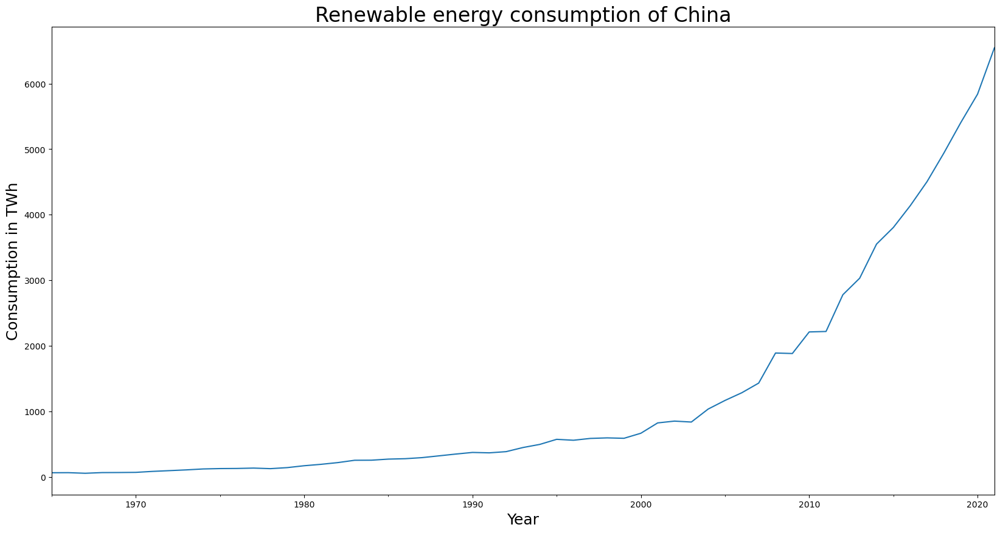

In [31]:
df_china.renewables_consumption.plot(figsize=(20,10))
plt.title("Renewable energy consumption of China",size=24)
plt.ylabel("Consumption in TWh",size=18)
plt.xlabel("Year",size=18)
plt.show()

# Seasonality Check for China dataframe

In [32]:
#pip install statsmodels
#pip install numpy
#pip install scipy
#conda install scipy

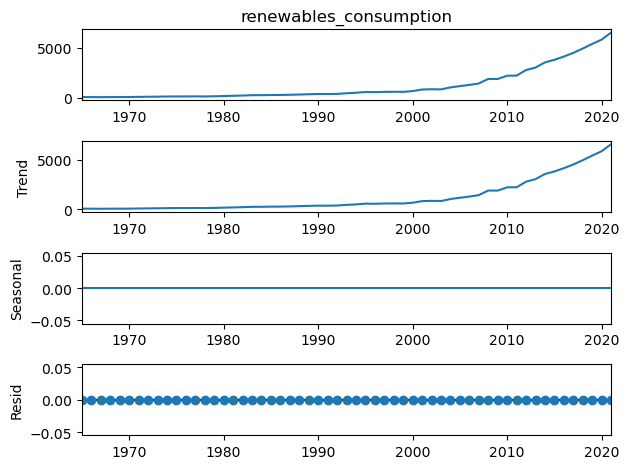

In [33]:
#Let us perform naive decomposition and see any cyclical patterns in seasonality
from statsmodels.tsa.seasonal import seasonal_decompose
seas_decompose_additive= seasonal_decompose(df_china.renewables_consumption,model="additive")
seas_decompose_additive.plot()
plt.show()

It is evident from the graph that ,there are no cyclical patterns over the time.So,there is no seasonality.

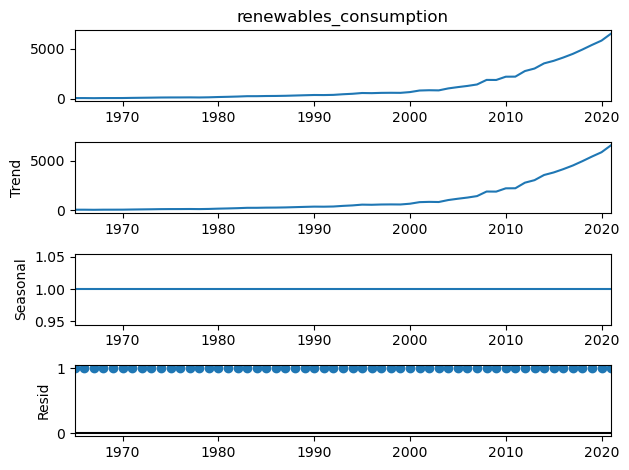

In [34]:
seas_decompose_multiplicative= seasonal_decompose(df_china.renewables_consumption,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

Even using the multiplicative method also it is evident that there is no seasonality pattern for this dataframe.

# LLR test function

In [35]:
# creating a function for LLR test
from scipy.stats.distributions import chi2

def LLR_test(model_1,model_2,DF=1):
    L1=model_1.fit().llf
    L2=model_2.fit().llf
    LR=(2*(L2-L1))
    p=chi2.sf(LR,DF).round(3)
    return p

# Stationarity Check for China dataframe

In [36]:
# We expect the series to be stationary to predict better,We expect atleast weak stationarity
# Ducky-Fuller test can be used to check the stationarity of time series
#importing suitable libraries before performing dickey-fuller test
import statsmodels.graphics.tsaplots as sgt
import statsmodels.tsa.stattools as sts
from statsmodels.tsa.stattools import adfuller
import seaborn as sns
sns.set()

In [37]:
#lets run the test
# we have two hypothesis one is null and another one is alternate hypothesis
# null hypothesis assusmes series to be non-stationary
#alternate hypothesis assumes series to be stationary
# If (ADF statastic or T-statastic) < Critical value....reject null hypothesis..so it is stationary seies
#If (ADF statastic or T-statastic) > Critical value....we cannot reject..so it is non-statioanry series

result = adfuller(df_china.renewables_consumption)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - China Time Series is Stationary")
else:
    print ("Failed to Reject Ho - China Time Series is Non-Stationary")

ADF Statistic: 0.463652
p-value: 0.983725
Critical Values:
	1%: -3.571
	5%: -2.923
	10%: -2.599
Failed to Reject Ho - China Time Series is Non-Stationary


## As the time series is Non-Stationary,So it is better to opt for integrated models like ARIMA rather than AR,MA,and ARMA.

# ARIMA

In [38]:
#Importing suitable libraries to build model
from statsmodels.tsa.arima.model import ARIMA

## Fitting for Basic ARIMA(1,1,1) 

In [39]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111=ARIMA(df_china.renewables_consumption[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111=model_AR_I_MA_111.fit()
#print the summary of model results
results_AR_I_MA_111.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     renewables_consumption   No. Observations:                   56
Model:                     ARIMA(1, 1, 1)   Log Likelihood                -338.490
Date:                    Thu, 27 Jul 2023   AIC                            682.979
Time:                            12:47:51   BIC                            689.001
Sample:                        01-01-1966   HQIC                           685.308
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9945      0.015     67.510      0.000       0.966       1.023
ma.L1         -0.6782      0.097     -7.024      0.000      -0.867      -0.489
sigma2      1.236e+04   1391.825      8.880      0.000    9632.022    1.51e+04
===================================================================================
Ljung-Box (L1) (Q):                  10.83   Jarque-Bera (JB):                50.82
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):             255.61   Skew:                             1.37
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.83
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

## Plotting Residual's ACF 

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\999763285.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['residuals_ARIMA_111']=results_AR_I_MA_111.resid


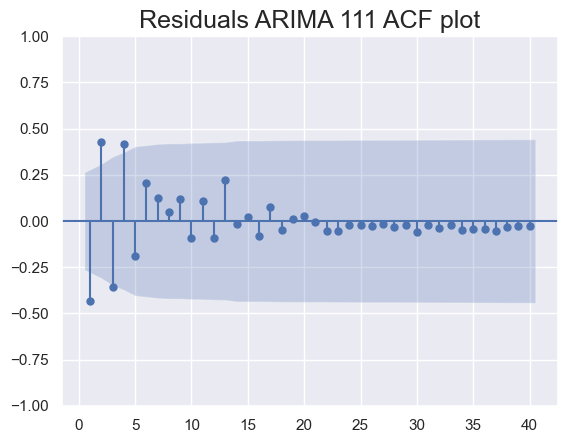

In [40]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_china['residuals_ARIMA_111']=results_AR_I_MA_111.resid
sgt.plot_acf(df_china.residuals_ARIMA_111[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot",size=18)
plt.show()

There are some higher lags considered to be significant,So there is a scope to find another best model.Lets try different order models.

## Evaluating for Better Model 

In [41]:
#Let us check whether higher models would be best fit or not
model_AR_I_MA_112=ARIMA(df_china.renewables_consumption[1:],order=(1,1,2))
results_AR_I_MA_112=model_AR_I_MA_112.fit()
results_AR_I_MA_112.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     renewables_consumption   No. Observations:                   56
Model:                     ARIMA(1, 1, 2)   Log Likelihood                -332.841
Date:                    Thu, 27 Jul 2023   AIC                            673.682
Time:                            12:47:51   BIC                            681.712
Sample:                        01-01-1966   HQIC                           676.787
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9953      0.012     83.469      0.000       0.972       1.019
ma.L1         -1.0464      0.090    -11.632      0.000      -1.223      -0.870
ma.L2          0.4122      0.124      3.330      0.001       0.170       0.655
sigma2      9899.9398   1364.055      7.258      0.000    7226.442    1.26e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.49   Jarque-Bera (JB):                37.01
Prob(Q):                              0.48   Prob(JB):                         0.00
Heteroskedasticity (H):             144.96   Skew:                             1.35
Prob(H) (two-sided):                  0.00   Kurtosis:                         5.98
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

Yes the coefficients are significantly different from zero.this model is suited.

In [42]:
model_AR_I_MA_211=ARIMA(df_china.renewables_consumption[1:],order=(2,1,1))
results_AR_I_MA_211=model_AR_I_MA_211.fit()
results_AR_I_MA_211.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     renewables_consumption   No. Observations:                   56
Model:                     ARIMA(2, 1, 1)   Log Likelihood                -330.252
Date:                    Thu, 27 Jul 2023   AIC                            668.504
Time:                            12:47:51   BIC                            676.533
Sample:                        01-01-1966   HQIC                           671.609
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2966      0.120      2.470      0.014       0.061       0.532
ar.L2          0.6922      0.113      6.149      0.000       0.472       0.913
ma.L1         -0.2432      0.180     -1.348      0.178      -0.597       0.110
sigma2      9019.5946   1137.899      7.927      0.000    6789.353    1.12e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.02   Jarque-Bera (JB):                36.85
Prob(Q):                              0.88   Prob(JB):                         0.00
Heteroskedasticity (H):             153.26   Skew:                             1.37
Prob(H) (two-sided):                  0.00   Kurtosis:                         5.93
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

The ma.L1 coefficient is more than significance of 0.05,so it is not best as compared to ARIMA(1,1,2)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2073580865.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['residuals_ARIMA_112']=results_AR_I_MA_112.resid


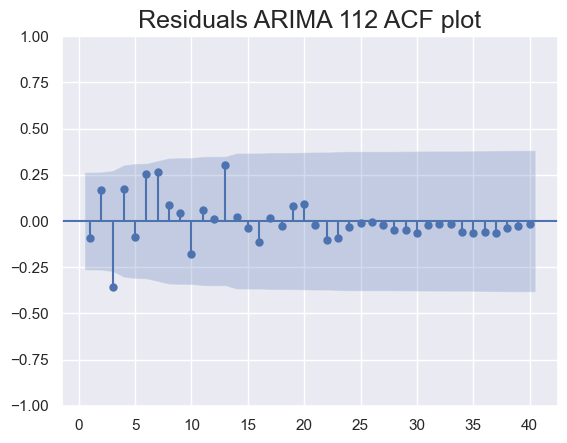

In [43]:
#So,the best model got till now is ARIMA(1,1,2).Let us verify its residuals.
df_china['residuals_ARIMA_112']=results_AR_I_MA_112.resid
sgt.plot_acf(df_china.residuals_ARIMA_112[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 112 ACF plot",size=18)
plt.show()

It is evident from this Residuals plot that,Third lag is significant.So,let us verify third order lag models of ARIMA and find any best model than ARIMA(1,1,2).

In [44]:
model_AR_I_MA_113=ARIMA(df_china.renewables_consumption[1:],order=(1,1,3))
results_AR_I_MA_113=model_AR_I_MA_113.fit()
results_AR_I_MA_113.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     renewables_consumption   No. Observations:                   56
Model:                     ARIMA(1, 1, 3)   Log Likelihood                -332.672
Date:                    Thu, 27 Jul 2023   AIC                            675.345
Time:                            12:47:52   BIC                            685.381
Sample:                        01-01-1966   HQIC                           679.226
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9945      0.014     69.867      0.000       0.967       1.022
ma.L1         -0.9565      0.118     -8.081      0.000      -1.188      -0.724
ma.L2          0.4532      0.174      2.601      0.009       0.112       0.795
ma.L3         -0.1127      0.119     -0.943      0.345      -0.347       0.121
sigma2      9890.7155   1457.404      6.787      0.000    7034.256    1.27e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.74   Jarque-Bera (JB):                38.65
Prob(Q):                              0.39   Prob(JB):                         0.00
Heteroskedasticity (H):             175.30   Skew:                             1.36
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.08
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

The coefficeint of ma.L3 is greater than 0.05,So this model is not best.Let us check ARIMA(3,1,1)

In [45]:
model_AR_I_MA_311=ARIMA(df_china.renewables_consumption[1:],order=(3,1,1))
results_AR_I_MA_311=model_AR_I_MA_311.fit()
results_AR_I_MA_311.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     renewables_consumption   No. Observations:                   56
Model:                     ARIMA(3, 1, 1)   Log Likelihood                -330.584
Date:                    Thu, 27 Jul 2023   AIC                            671.168
Time:                            12:47:52   BIC                            681.205
Sample:                        01-01-1966   HQIC                           675.049
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2216      6.367     -0.035      0.972     -12.701      12.258
ar.L2          0.8691      1.280      0.679      0.497      -1.639       3.377
ar.L3          0.3238      4.980      0.065      0.948      -9.437      10.085
ma.L1          0.4359      6.356      0.069      0.945     -12.022      12.894
sigma2      9136.6132   1211.233      7.543      0.000    6762.640    1.15e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.52   Jarque-Bera (JB):                34.00
Prob(Q):                              0.47   Prob(JB):                         0.00
Heteroskedasticity (H):             153.90   Skew:                             1.16
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.07
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

This is far worst than the ARIMA(1,1,3).So till now the best model got is ARIMA(1,1,2).Before finalising the best model based on own intrepretation,let us double check which model is best by performing LLR test for ARIMA (1,1,1) and ARIMA(1,1,2).

In [46]:
LLR_test(model_AR_I_MA_111,model_AR_I_MA_112)

0.001

The p-value is within significance range,So it can be confirmed that higher order is the best model i.e ARIMA(1,1,2)

## Checking Stationarity of Time Series 

Checking After how many differentiations the series is becoming Stationary.

In [47]:
#We have decided No higher lags are significant ,before conclusing lets check whether it is stationary or not
df_china['china_ren_consumption']=df_china.renewables_consumption.diff(1)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2224595902.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_ren_consumption']=df_china.renewables_consumption.diff(1)


In [48]:
#To comapre ARIMA 111 results with manually integrated time series ,performing arma 11 for integrated series
#As Arima(1,0,1) should equal to Arma(1,1) of manully integrated series
#All of this are doing to check after the first integration whether the series is statioanry or not
model_AR_I_MA_101_china=ARIMA(df_china.china_ren_consumption[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                 
=================================================================================
Dep. Variable:     china_ren_consumption   No. Observations:                   55
Model:                    ARIMA(1, 0, 1)   Log Likelihood                -338.114
Date:                   Thu, 27 Jul 2023   AIC                            684.228
Time:                           12:47:52   BIC                            692.257
Sample:                       01-01-1967   HQIC                           687.333
                            - 01-01-2021                                         
Covariance Type:                     opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        218.2914    254.321      0.858      0.391    -280.168     716.751
ar.L1          0.9874      0.047     20.969      0.000       0.895       1.080
ma.L1         -0.6764      0.097     -6.967      0.000      -0.867      -0.486
sigma2      1.233e+04   1474.049      8.361      0.000    9436.094    1.52e+04
===================================================================================
Ljung-Box (L1) (Q):                   8.93   Jarque-Bera (JB):                47.09
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):              45.72   Skew:                             1.38
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.59
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [49]:
result = adfuller(df_china.china_ren_consumption[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: 4.015445
p-value: 1.000000
Critical Values:
	1%: -3.571
	5%: -2.923
	10%: -2.599
Failed to Reject Ho - Time Series is Non-Stationary


Let us check whether any higher order differntiations can make it stationary or not

In [50]:
df_china['china_ren_consumption_2']=df_china.renewables_consumption.diff(2)
model_AR_I_MA_101_china=ARIMA(df_china.china_ren_consumption_2[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()


C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2499614800.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_ren_consumption_2']=df_china.renewables_consumption.diff(2)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     china_ren_consumption_2   No. Observations:                   55
Model:                      ARIMA(1, 0, 1)   Log Likelihood                -332.609
Date:                     Thu, 27 Jul 2023   AIC                            673.218
Time:                             12:47:52   BIC                            681.247
Sample:                         01-01-1967   HQIC                           676.323
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        421.4767    422.690      0.997      0.319    -406.980    1249.933
ar.L1          0.9712      0.057     17.146      0.000       0.860       1.082
ma.L1          0.1371      0.104      1.320      0.187      -0.066       0.341
sigma2      9896.9373   1457.987      6.788      0.000    7039.335    1.28e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.11   Jarque-Bera (JB):                15.01
Prob(Q):                              0.74   Prob(JB):                         0.00
Heteroskedasticity (H):              37.17   Skew:                             0.94
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.73
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [51]:
result = adfuller(df_china.china_ren_consumption_2[2:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -0.078693
p-value: 0.951520
Critical Values:
	1%: -3.585
	5%: -2.928
	10%: -2.602
Failed to Reject Ho - Time Series is Non-Stationary


In [52]:
df_china['china_ren_consumption_3']=df_china.renewables_consumption.diff(3)
model_AR_I_MA_101_china=ARIMA(df_china.china_ren_consumption_3[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2050434360.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_ren_consumption_3']=df_china.renewables_consumption.diff(3)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     china_ren_consumption_3   No. Observations:                   55
Model:                      ARIMA(1, 0, 1)   Log Likelihood                -346.302
Date:                     Thu, 27 Jul 2023   AIC                            700.604
Time:                             12:47:52   BIC                            708.633
Sample:                         01-01-1967   HQIC                           703.709
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        663.7049    684.362      0.970      0.332    -677.619    2005.029
ar.L1          0.9905      0.047     21.051      0.000       0.898       1.083
ma.L1         -0.3387      0.109     -3.121      0.002      -0.551      -0.126
sigma2      2.049e+04   2277.799      8.994      0.000     1.6e+04     2.5e+04
===================================================================================
Ljung-Box (L1) (Q):                   1.70   Jarque-Bera (JB):                50.30
Prob(Q):                              0.19   Prob(JB):                         0.00
Heteroskedasticity (H):              44.91   Skew:                             1.10
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.13
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [53]:
result = adfuller(df_china.china_ren_consumption_3[3:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -0.497977
p-value: 0.892411
Critical Values:
	1%: -3.585
	5%: -2.928
	10%: -2.602
Failed to Reject Ho - Time Series is Non-Stationary


In [54]:
df_china['china_ren_consumption_4']=df_china.renewables_consumption.diff(4)
model_AR_I_MA_101_china=ARIMA(df_china.china_ren_consumption_4[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1089973853.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_ren_consumption_4']=df_china.renewables_consumption.diff(4)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     china_ren_consumption_4   No. Observations:                   55
Model:                      ARIMA(1, 0, 1)   Log Likelihood                -328.231
Date:                     Thu, 27 Jul 2023   AIC                            664.462
Time:                             12:47:52   BIC                            672.491
Sample:                         01-01-1967   HQIC                           667.567
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        424.1175   4671.534      0.091      0.928   -8731.920    9580.155
ar.L1          0.9941      0.026     38.429      0.000       0.943       1.045
ma.L1          0.0238      0.112      0.213      0.831      -0.195       0.242
sigma2      1.288e+04   2248.197      5.729      0.000    8474.309    1.73e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.26   Jarque-Bera (JB):                 6.28
Prob(Q):                              0.61   Prob(JB):                         0.04
Heteroskedasticity (H):              95.04   Skew:                             0.70
Prob(H) (two-sided):                  0.00   Kurtosis:                         3.90
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [55]:
result = adfuller(df_china.china_ren_consumption_4[4:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -0.932953
p-value: 0.776927
Critical Values:
	1%: -3.601
	5%: -2.935
	10%: -2.606
Failed to Reject Ho - Time Series is Non-Stationary


In [56]:
df_china['china_ren_consumption_5']=df_china.renewables_consumption.diff(5)
model_AR_I_MA_101_china=ARIMA(df_china.china_ren_consumption_5[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\20909806.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_ren_consumption_5']=df_china.renewables_consumption.diff(5)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred fr

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     china_ren_consumption_5   No. Observations:                   55
Model:                      ARIMA(1, 0, 1)   Log Likelihood                -337.254
Date:                     Thu, 27 Jul 2023   AIC                            682.507
Time:                             12:47:52   BIC                            690.537
Sample:                         01-01-1967   HQIC                           685.612
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        517.5875   6427.653      0.081      0.936   -1.21e+04    1.31e+04
ar.L1          0.9950      0.027     37.265      0.000       0.943       1.047
ma.L1         -0.2004      0.185     -1.085      0.278      -0.562       0.162
sigma2      2.321e+04   3661.483      6.339      0.000     1.6e+04    3.04e+04
===================================================================================
Ljung-Box (L1) (Q):                   2.72   Jarque-Bera (JB):                57.04
Prob(Q):                              0.10   Prob(JB):                         0.00
Heteroskedasticity (H):             125.06   Skew:                             1.92
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.18
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [57]:
result = adfuller(df_china.china_ren_consumption_5[5:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: 0.251636
p-value: 0.975013
Critical Values:
	1%: -3.601
	5%: -2.935
	10%: -2.606
Failed to Reject Ho - Time Series is Non-Stationary


In [58]:
df_china['china_ren_consumption_6']=df_china.renewables_consumption.diff(6)
model_AR_I_MA_101_china=ARIMA(df_china.china_ren_consumption_2[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2563110706.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_ren_consumption_6']=df_china.renewables_consumption.diff(6)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     china_ren_consumption_2   No. Observations:                   55
Model:                      ARIMA(1, 0, 1)   Log Likelihood                -332.609
Date:                     Thu, 27 Jul 2023   AIC                            673.218
Time:                             12:47:53   BIC                            681.247
Sample:                         01-01-1967   HQIC                           676.323
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        421.4767    422.690      0.997      0.319    -406.980    1249.933
ar.L1          0.9712      0.057     17.146      0.000       0.860       1.082
ma.L1          0.1371      0.104      1.320      0.187      -0.066       0.341
sigma2      9896.9373   1457.987      6.788      0.000    7039.335    1.28e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.11   Jarque-Bera (JB):                15.01
Prob(Q):                              0.74   Prob(JB):                         0.00
Heteroskedasticity (H):              37.17   Skew:                             0.94
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.73
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [59]:
result = adfuller(df_china.china_ren_consumption_6[6:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -0.628874
p-value: 0.864323
Critical Values:
	1%: -3.585
	5%: -2.928
	10%: -2.602
Failed to Reject Ho - Time Series is Non-Stationary


In [60]:
df_china['china_ren_consumption_7']=df_china.renewables_consumption.diff(7)
model_AR_I_MA_101_china=ARIMA(df_china.china_ren_consumption_7[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1575134146.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_ren_consumption_7']=df_china.renewables_consumption.diff(7)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     china_ren_consumption_7   No. Observations:                   55
Model:                      ARIMA(1, 0, 1)   Log Likelihood                -323.594
Date:                     Thu, 27 Jul 2023   AIC                            655.189
Time:                             12:47:53   BIC                            663.218
Sample:                         01-01-1967   HQIC                           658.294
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        693.9556   9362.511      0.074      0.941   -1.77e+04     1.9e+04
ar.L1          0.9960      0.025     40.651      0.000       0.948       1.044
ma.L1         -0.0545      0.133     -0.410      0.682      -0.315       0.206
sigma2      2.228e+04   3770.479      5.909      0.000    1.49e+04    2.97e+04
===================================================================================
Ljung-Box (L1) (Q):                   2.19   Jarque-Bera (JB):                25.12
Prob(Q):                              0.14   Prob(JB):                         0.00
Heteroskedasticity (H):             159.49   Skew:                             1.43
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.68
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [61]:
result = adfuller(df_china.china_ren_consumption_7[7:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: 0.908229
p-value: 0.993197
Critical Values:
	1%: -3.616
	5%: -2.941
	10%: -2.609
Failed to Reject Ho - Time Series is Non-Stationary


In [62]:
df_china['china_ren_consumption_8']=df_china.renewables_consumption.diff(8)
model_AR_I_MA_101_china=ARIMA(df_china.china_ren_consumption_8[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\689906058.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_ren_consumption_8']=df_china.renewables_consumption.diff(8)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred f

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     china_ren_consumption_8   No. Observations:                   55
Model:                      ARIMA(1, 0, 1)   Log Likelihood                -322.149
Date:                     Thu, 27 Jul 2023   AIC                            652.297
Time:                             12:47:53   BIC                            660.327
Sample:                         01-01-1967   HQIC                           655.402
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        778.6282    1.1e+04      0.071      0.943   -2.07e+04    2.23e+04
ar.L1          0.9960      0.022     45.289      0.000       0.953       1.039
ma.L1          0.0179      0.163      0.110      0.912      -0.301       0.337
sigma2      2.722e+04   4684.198      5.811      0.000     1.8e+04    3.64e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.92   Jarque-Bera (JB):                26.86
Prob(Q):                              0.34   Prob(JB):                         0.00
Heteroskedasticity (H):             222.61   Skew:                             1.51
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.60
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [63]:
result = adfuller(df_china.china_ren_consumption_8[8:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -1.141721
p-value: 0.698151
Critical Values:
	1%: -3.606
	5%: -2.937
	10%: -2.607
Failed to Reject Ho - Time Series is Non-Stationary


In [64]:
df_china['china_ren_consumption_9']=df_china.renewables_consumption.diff(9)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1957895617.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_ren_consumption_9']=df_china.renewables_consumption.diff(9)


In [65]:
model_AR_I_MA_101_china=ARIMA(df_china.china_ren_consumption_9[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'


<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     china_ren_consumption_9   No. Observations:                   55
Model:                      ARIMA(1, 0, 1)   Log Likelihood                -316.005
Date:                     Thu, 27 Jul 2023   AIC                            640.009
Time:                             12:47:53   BIC                            648.038
Sample:                         01-01-1967   HQIC                           643.114
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        855.8011   1.26e+04      0.068      0.946   -2.37e+04    2.55e+04
ar.L1          0.9958      0.025     40.356      0.000       0.947       1.044
ma.L1          0.1039      0.209      0.498      0.619      -0.305       0.513
sigma2      2.759e+04   4757.010      5.799      0.000    1.83e+04    3.69e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.36   Jarque-Bera (JB):                72.81
Prob(Q):                              0.55   Prob(JB):                         0.00
Heteroskedasticity (H):             235.63   Skew:                             2.07
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.84
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [66]:
result = adfuller(df_china.china_ren_consumption_9[9:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: 0.354996
p-value: 0.979732
Critical Values:
	1%: -3.616
	5%: -2.941
	10%: -2.609
Failed to Reject Ho - Time Series is Non-Stationary


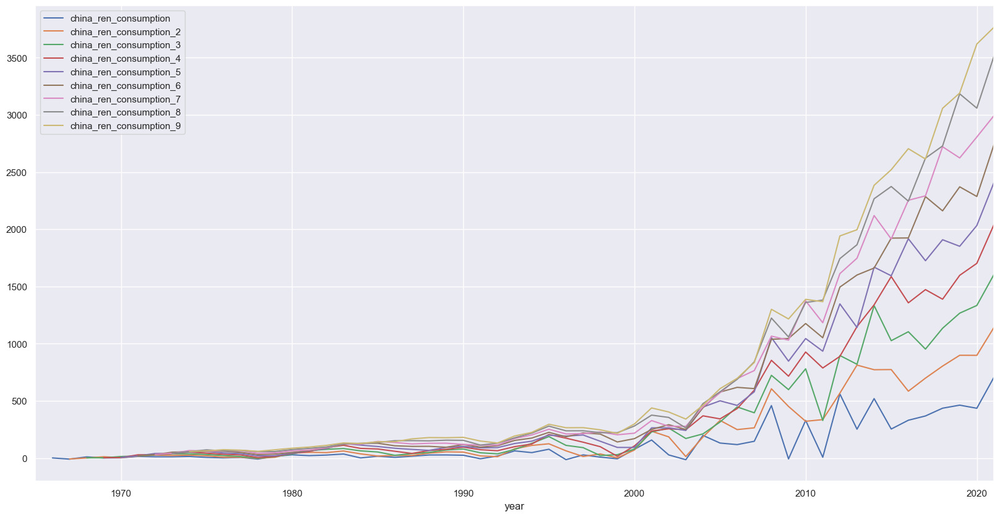

In [67]:
df_china.china_ren_consumption.plot(figsize=(20,10),legend=True)
df_china.china_ren_consumption_2.plot(legend=True)
df_china.china_ren_consumption_3.plot(legend=True)
df_china.china_ren_consumption_4.plot(legend=True)
df_china.china_ren_consumption_5.plot(legend=True)
df_china.china_ren_consumption_6.plot(legend=True)
df_china.china_ren_consumption_7.plot(legend=True)
df_china.china_ren_consumption_8.plot(legend=True)
df_china.china_ren_consumption_9.plot(legend=True)
plt.show()

So,There is inherent Non-stationarity in the time series of China,So modelling is restricted to first default differentiation itself,altogether ARIMA 112 is better fit for china time series based upon the Analysis.

## Predicting Using ARIMA(1,1,2) 

## Splitting the data 

In [68]:
#defining 'size' variable to find out cut off point while splitting the data
#This is time series ,so shuffling data is impossible.,there is a need to start testing  from where training have stopped
size=int(len(df_china)*0.8)
size

45

In [69]:
df_china_train=df_china.iloc[:size]
df_china_test=df_china.iloc[size:]

In [70]:
#let us check the ending year of training dataset ,so that starting date can be put as next year
df_china_train.tail()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption,residuals_ARIMA_111,residuals_ARIMA_112,china_ren_consumption,china_ren_consumption_2,china_ren_consumption_3,china_ren_consumption_4,china_ren_consumption_5,china_ren_consumption_6,china_ren_consumption_7,china_ren_consumption_8,china_ren_consumption_9
year,,,,,,,,,,,,,,,,
2005-01-01,China,CHN,1167.950,5.554,21027.164,45.156722,86.514139,131.264,329.380,315.029,342.603,500.417,577.208,570.864,579.171,606.965
2006-01-01,China,CHN,1285.634,5.578,23048.367,17.775193,32.902679,117.684,248.948,447.064,432.713,460.287,618.101,694.892,688.548,696.855
2007-01-01,China,CHN,1432.453,5.719,25049.293,41.843815,28.454038,146.819,264.503,395.767,593.883,579.532,607.106,764.920,841.711,835.367
2008-01-01,China,CHN,1891.234,7.269,26019.002,341.156603,328.864687,458.781,605.600,723.284,854.548,1052.664,1038.313,1065.887,1223.701,1300.492
2009-01-01,China,CHN,1883.614,6.936,27158.898,-232.471749,-131.843996,-7.620,451.161,597.980,715.664,846.928,1045.044,1030.693,1058.267,1216.081


In [71]:
df_china_test.tail()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption,residuals_ARIMA_111,residuals_ARIMA_112,china_ren_consumption,china_ren_consumption_2,china_ren_consumption_3,china_ren_consumption_4,china_ren_consumption_5,china_ren_consumption_6,china_ren_consumption_7,china_ren_consumption_8,china_ren_consumption_9
year,,,,,,,,,,,,,,,,
2017-01-01,China,CHN,4504.976,12.139,37112.145,50.711468,-18.729285,368.093,698.821,952.636,1472.405,1724.874,2285.241,2292.210,2621.362,2613.742
2018-01-01,China,CHN,4940.909,12.807,38578.570,104.276947,79.942942,435.933,804.026,1134.754,1388.569,1908.338,2160.807,2721.174,2728.143,3057.295
2019-01-01,China,CHN,5403.476,13.516,39978.492,99.777234,120.063513,462.567,898.500,1266.593,1597.321,1851.136,2370.905,2623.374,3183.741,3190.710
2020-01-01,China,CHN,5838.805,14.243,40994.574,43.001201,67.621686,435.329,897.896,1333.829,1701.922,2032.650,2286.465,2806.234,3058.703,3619.070
2021-01-01,China,CHN,6545.095,14.946,43790.895,302.541748,294.277569,706.290,1141.619,1604.186,2040.119,2408.212,2738.940,2992.755,3512.524,3764.993


## Fitting model for Training dataset 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


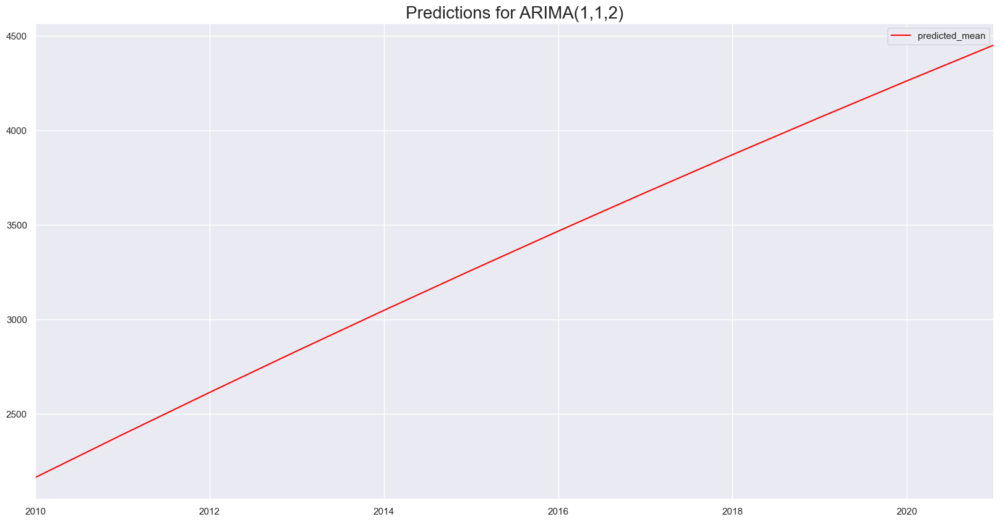

In [72]:
#Let us fit the model for only training dataset
model_Arima_112=ARIMA(df_china_train.renewables_consumption[1:],order=(1,1,2))
model_Arima_112=model_Arima_112.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_china_Arima_112_predict=model_Arima_112.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_china_Arima_112_predict[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for ARIMA(1,1,2)",size=20)
plt.show()

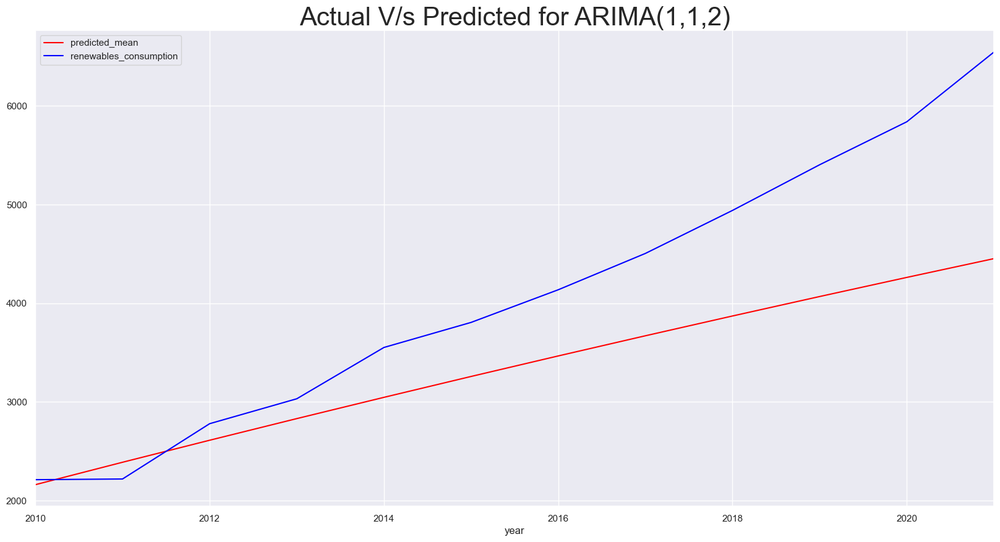

In [73]:
#Let us compare the test data and predicted values
df_china_Arima_112_predict.plot(figsize=(20,10),color="red",legend=True)
df_china_test.renewables_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for ARIMA(1,1,2)",size=30)
plt.show()

In [74]:
def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [75]:
from sklearn.metrics import mean_squared_error
from math import sqrt
import numpy as np
rmse=sqrt(mean_squared_error(df_china_Arima_112_predict,df_china_test['renewables_consumption']))
mse=mean_squared_error(df_china_Arima_112_predict,df_china_test['renewables_consumption'])
mape = np.mean(np.abs(df_china_Arima_112_predict - df_china_test['renewables_consumption'])/np.abs(df_china_test['renewables_consumption'])) 
mae = np.mean(np.abs(df_china_Arima_112_predict  - df_china_test['renewables_consumption']))
mpe = np.mean((df_china_Arima_112_predict  - df_china_test['renewables_consumption'])/df_china_test['renewables_consumption'])
print("Mean Percentage  error for ARIMA(1,1,2): ",mpe)
print("Mean absolutee  error for ARIMA(1,1,2): ",mae)
print("Mean absolute percentage error for ARIMA(1,1,2): ",mape)
print("Root Mean Squared Error for ARIMA(1,1,2): ",rmse)
print("Mean Squared Error for ARIMA(1,1,2):",mse)


Mean Percentage  error for ARIMA(1,1,2):  -0.14665177347818695
Mean absolutee  error for ARIMA(1,1,2):  768.3904390193494
Mean absolute percentage error for ARIMA(1,1,2):  0.15938116047103132
Root Mean Squared Error for ARIMA(1,1,2):  982.8914855337689
Mean Squared Error for ARIMA(1,1,2): 966075.6723347789


1. A smaller MPE indicates a better prediction performance, while a larger MPE suggests a higher level of deviation between the predicted and actual values.
2. MAPE assess the average percentage deviation of the predictions compared to the actual data. A smaller MAPE indicates a better prediction performance, while a larger MAPE suggests a higher level of deviation between the predicted and actual values.
3.MAE assess the average magnitude of the errors in predictions compared to the actual data. A smaller MAE indicates a better prediction performance, as it implies a smaller average deviation between the predicted and actual values.


In [76]:
mean_absolute_percentage_error(y_true=df_china_test['renewables_consumption'],
                   y_pred=df_china_Arima_112_predict)

15.938116047103131

# 2.Predictions for Renewable share

In [77]:
df_china_rshare=df_china[['renewables_share_energy']]
df_china_rshare.head()

,renewables_share_energy
year,
1965-01-01,4.253
1966-01-01,3.983
1967-01-01,3.818
1968-01-01,4.459
1969-01-01,3.727


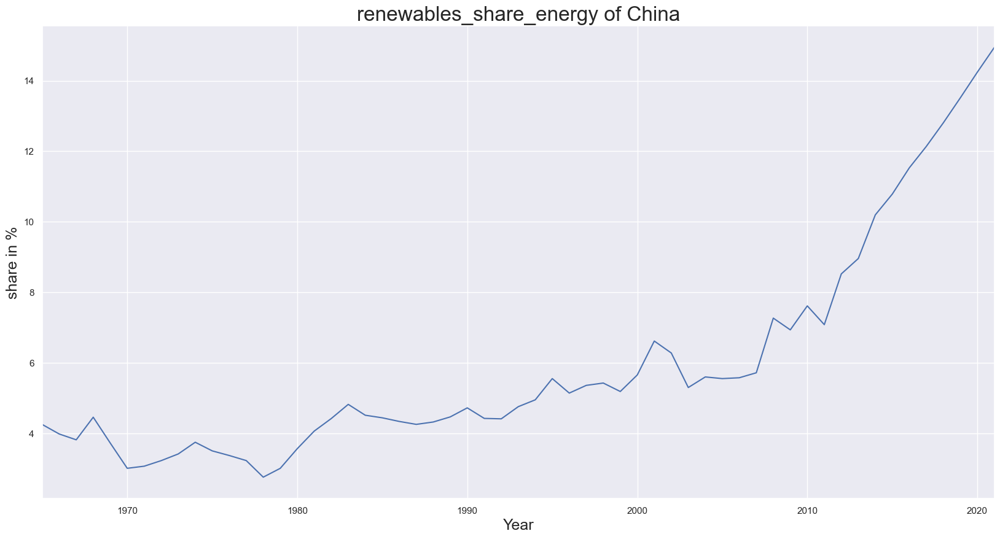

In [78]:
df_china.renewables_share_energy.plot(figsize=(20,10))
plt.title("renewables_share_energy of China",size=24)
plt.ylabel("share in %",size=18)
plt.xlabel("Year",size=18)
plt.show()

## Seasonality Checking

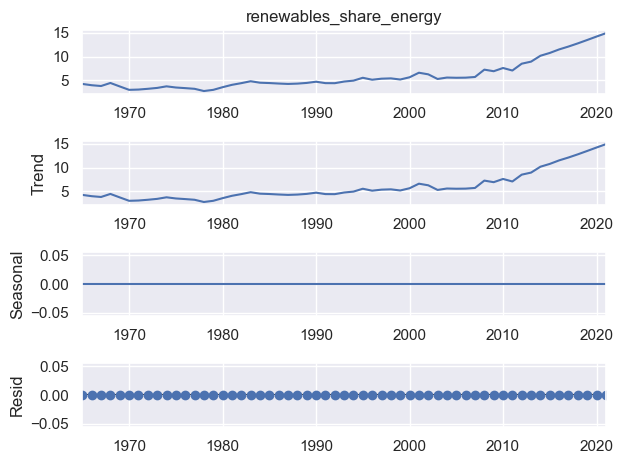

In [79]:
seas_decompose_additive= seasonal_decompose(df_china.renewables_share_energy,model="additive")
seas_decompose_additive.plot()
plt.show()

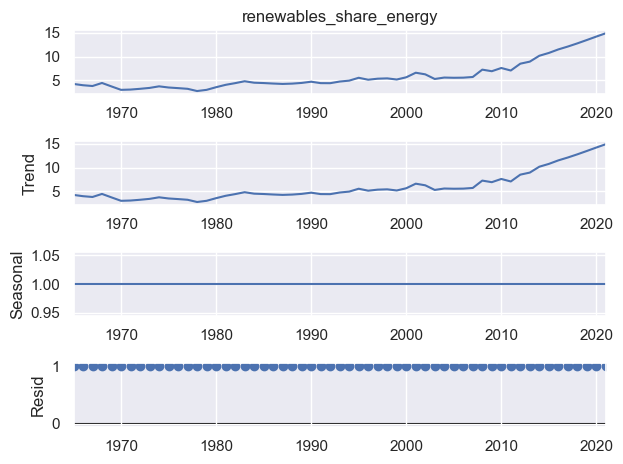

In [80]:
seas_decompose_multiplicative= seasonal_decompose(df_china.renewables_share_energy,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

From both the methods it is clear that,there is no proof of seasonality

In [81]:
result = adfuller(df_china.renewables_share_energy)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - China Time Series is Stationary")
else:
    print ("Failed to Reject Ho - China Time Series is Non-Stationary")

ADF Statistic: 3.265655
p-value: 1.000000
Critical Values:
	1%: -3.553
	5%: -2.915
	10%: -2.595
Failed to Reject Ho - China Time Series is Non-Stationary


## ARIMA 

In [82]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_rshare=ARIMA(df_china.renewables_share_energy[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_rshare=model_AR_I_MA_111_rshare.fit()
#print the summary of model results
results_AR_I_MA_111_rshare.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     renewables_share_energy   No. Observations:                   56
Model:                      ARIMA(1, 1, 1)   Log Likelihood                 -39.545
Date:                     Thu, 27 Jul 2023   AIC                             85.090
Time:                             12:47:56   BIC                             91.112
Sample:                         01-01-1966   HQIC                            87.418
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9795      0.121      8.081      0.000       0.742       1.217
ma.L1         -0.8506      0.236     -3.598      0.000      -1.314      -0.387
sigma2         0.2426      0.040      6.022      0.000       0.164       0.322
===================================================================================
Ljung-Box (L1) (Q):                   1.19   Jarque-Bera (JB):                 2.75
Prob(Q):                              0.27   Prob(JB):                         0.25
Heteroskedasticity (H):               2.05   Skew:                             0.25
Prob(H) (two-sided):                  0.14   Kurtosis:                         3.98
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2911864260.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['residuals_ARIMA_111_rshare']=results_AR_I_MA_111_rshare.resid


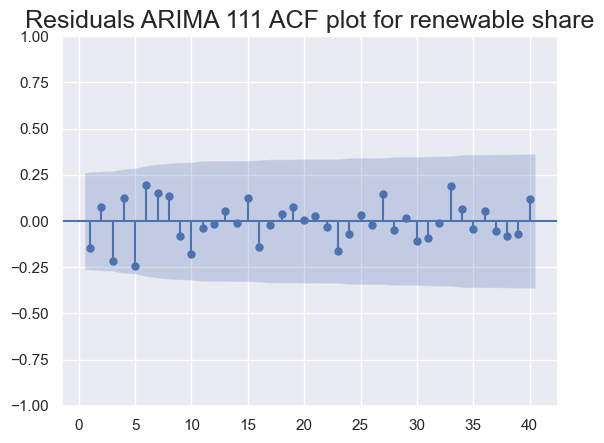

In [83]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_china['residuals_ARIMA_111_rshare']=results_AR_I_MA_111_rshare.resid
sgt.plot_acf(df_china.residuals_ARIMA_111_rshare[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for renewable share",size=18)
plt.show()

## Checking Stationarity

In [84]:
#We have decided No higher lags are significant ,before conclusing lets check whether it is stationary or not
df_china['china_renewables_share_energy']=df_china.renewables_share_energy.diff(1)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\620185695.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_renewables_share_energy']=df_china.renewables_share_energy.diff(1)


In [85]:
model_AR_I_MA_101_china=ARIMA(df_china.china_renewables_share_energy[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:     china_renewables_share_energy   No. Observations:                   55
Model:                            ARIMA(1, 0, 1)   Log Likelihood                 -39.019
Date:                           Thu, 27 Jul 2023   AIC                             86.038
Time:                                   12:47:57   BIC                             94.067
Sample:                               01-01-1967   HQIC                            89.143
                                    - 01-01-2021                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.2306      0.323      0.715      0.475      -0.402       0.863
ar.L1          0.9495      0.191      4.979      0.000       0.576       1.323
ma.L1         -0.8332      0.254     -3.274      0.001      -1.332      -0.334
sigma2         0.2403      0.039      6.185      0.000       0.164       0.316
===================================================================================
Ljung-Box (L1) (Q):                   0.66   Jarque-Bera (JB):                 2.41
Prob(Q):                              0.41   Prob(JB):                         0.30
Heteroskedasticity (H):               1.88   Skew:                             0.23
Prob(H) (two-sided):                  0.19   Kurtosis:                         3.91
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [86]:
result = adfuller(df_china.china_renewables_share_energy[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -0.706370
p-value: 0.845093
Critical Values:
	1%: -3.571
	5%: -2.923
	10%: -2.599
Failed to Reject Ho - Time Series is Non-Stationary


In [87]:
df_china['china_renewables_share_energy_2']=df_china.renewables_share_energy.diff(2)
model_AR_I_MA_101_china=ARIMA(df_china.china_renewables_share_energy_2[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\4190180031.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_renewables_share_energy_2']=df_china.renewables_share_energy.diff(2)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:     china_renewables_share_energy_2   No. Observations:                   55
Model:                              ARIMA(1, 0, 1)   Log Likelihood                 -41.165
Date:                             Thu, 27 Jul 2023   AIC                             90.331
Time:                                     12:47:57   BIC                             98.360
Sample:                                 01-01-1967   HQIC                            93.436
                                      - 01-01-2021                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.3822      0.178      2.145      0.032       0.033       0.731
ar.L1          0.3122      0.193      1.617      0.106      -0.066       0.691
ma.L1          0.7749      0.120      6.471      0.000       0.540       1.010
sigma2         0.2548      0.051      5.041      0.000       0.156       0.354
===================================================================================
Ljung-Box (L1) (Q):                   0.04   Jarque-Bera (JB):                 0.03
Prob(Q):                              0.84   Prob(JB):                         0.98
Heteroskedasticity (H):               1.53   Skew:                            -0.06
Prob(H) (two-sided):                  0.37   Kurtosis:                         3.00
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [88]:
result = adfuller(df_china.china_renewables_share_energy_2[2:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -0.796728
p-value: 0.820081
Critical Values:
	1%: -3.571
	5%: -2.923
	10%: -2.599
Failed to Reject Ho - Time Series is Non-Stationary


In [89]:
df_china['china_renewables_share_energy_3']=df_china.renewables_share_energy.diff(3)
model_AR_I_MA_101_china=ARIMA(df_china.china_renewables_share_energy_3[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3920774811.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_renewables_share_energy_3']=df_china.renewables_share_energy.diff(3)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:     china_renewables_share_energy_3   No. Observations:                   55
Model:                              ARIMA(1, 0, 1)   Log Likelihood                 -55.356
Date:                             Thu, 27 Jul 2023   AIC                            118.712
Time:                                     12:47:57   BIC                            126.741
Sample:                                 01-01-1967   HQIC                           121.817
                                      - 01-01-2021                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.6316      0.396      1.593      0.111      -0.145       1.409
ar.L1          0.7671      0.134      5.739      0.000       0.505       1.029
ma.L1         -0.0366      0.182     -0.201      0.840      -0.393       0.320
sigma2         0.4479      0.077      5.788      0.000       0.296       0.600
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                 2.87
Prob(Q):                              0.97   Prob(JB):                         0.24
Heteroskedasticity (H):               2.79   Skew:                             0.28
Prob(H) (two-sided):                  0.04   Kurtosis:                         3.96
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [90]:
result = adfuller(df_china.china_renewables_share_energy_3[3:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -1.239215
p-value: 0.656503
Critical Values:
	1%: -3.581
	5%: -2.927
	10%: -2.602
Failed to Reject Ho - Time Series is Non-Stationary


In [91]:
df_china['china_renewables_share_energy_4']=df_china.renewables_share_energy.diff(4)
model_AR_I_MA_101_china=ARIMA(df_china.china_renewables_share_energy_4[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3481803107.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_renewables_share_energy_4']=df_china.renewables_share_energy.diff(4)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:     china_renewables_share_energy_4   No. Observations:                   55
Model:                              ARIMA(1, 0, 1)   Log Likelihood                 -46.759
Date:                             Thu, 27 Jul 2023   AIC                            101.518
Time:                                     12:47:57   BIC                            109.548
Sample:                                 01-01-1967   HQIC                           104.623
                                      - 01-01-2021                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.8163      0.563      1.451      0.147      -0.286       1.919
ar.L1          0.8415      0.089      9.436      0.000       0.667       1.016
ma.L1          0.2067      0.159      1.303      0.193      -0.104       0.518
sigma2         0.3317      0.096      3.459      0.001       0.144       0.520
===================================================================================
Ljung-Box (L1) (Q):                   0.05   Jarque-Bera (JB):                 2.06
Prob(Q):                              0.83   Prob(JB):                         0.36
Heteroskedasticity (H):               1.56   Skew:                             0.14
Prob(H) (two-sided):                  0.36   Kurtosis:                         2.09
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [92]:
result = adfuller(df_china.china_renewables_share_energy_4[4:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -0.571335
p-value: 0.877328
Critical Values:
	1%: -3.589
	5%: -2.930
	10%: -2.603
Failed to Reject Ho - Time Series is Non-Stationary


In [93]:
df_china['china_renewables_share_energy_5']=df_china.renewables_share_energy.diff(5)
model_AR_I_MA_101_china=ARIMA(df_china.china_renewables_share_energy_5[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3246994809.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_renewables_share_energy_5']=df_china.renewables_share_energy.diff(5)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:     china_renewables_share_energy_5   No. Observations:                   55
Model:                              ARIMA(1, 0, 1)   Log Likelihood                 -56.667
Date:                             Thu, 27 Jul 2023   AIC                            121.333
Time:                                     12:47:57   BIC                            129.363
Sample:                                 01-01-1967   HQIC                           124.438
                                      - 01-01-2021                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.9783      0.955      1.025      0.305      -0.893       2.849
ar.L1          0.9272      0.071     13.055      0.000       0.788       1.066
ma.L1         -0.1505      0.216     -0.695      0.487      -0.575       0.274
sigma2         0.5012      0.082      6.078      0.000       0.340       0.663
===================================================================================
Ljung-Box (L1) (Q):                   0.11   Jarque-Bera (JB):                12.56
Prob(Q):                              0.74   Prob(JB):                         0.00
Heteroskedasticity (H):               2.89   Skew:                             0.94
Prob(H) (two-sided):                  0.03   Kurtosis:                         4.39
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [94]:
result = adfuller(df_china.china_renewables_share_energy_5[5:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: 0.825163
p-value: 0.992032
Critical Values:
	1%: -3.601
	5%: -2.935
	10%: -2.606
Failed to Reject Ho - Time Series is Non-Stationary


In [95]:
df_china['china_renewables_share_energy_6']=df_china.renewables_share_energy.diff(6)
model_AR_I_MA_101_china=ARIMA(df_china.china_renewables_share_energy_6[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2659935771.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_renewables_share_energy_6']=df_china.renewables_share_energy.diff(6)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so 

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:     china_renewables_share_energy_6   No. Observations:                   55
Model:                              ARIMA(1, 0, 1)   Log Likelihood                 -46.716
Date:                             Thu, 27 Jul 2023   AIC                            101.431
Time:                                     12:47:57   BIC                            109.460
Sample:                                 01-01-1967   HQIC                           104.536
                                      - 01-01-2021                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.2826      1.316      0.975      0.330      -1.296       3.861
ar.L1          0.9574      0.059     16.134      0.000       0.841       1.074
ma.L1         -0.0356      0.179     -0.200      0.842      -0.386       0.314
sigma2         0.3488      0.071      4.885      0.000       0.209       0.489
===================================================================================
Ljung-Box (L1) (Q):                   0.09   Jarque-Bera (JB):                 2.69
Prob(Q):                              0.77   Prob(JB):                         0.26
Heteroskedasticity (H):               3.63   Skew:                             0.43
Prob(H) (two-sided):                  0.01   Kurtosis:                         3.67
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [96]:
result = adfuller(df_china.china_renewables_share_energy_6[6:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -0.605306
p-value: 0.869779
Critical Values:
	1%: -3.593
	5%: -2.932
	10%: -2.604
Failed to Reject Ho - Time Series is Non-Stationary


It is clear that there is inherent non-stationarity in the series ,So ARIMA(1,1,1) is considered as better fit model

## Predicting Using ARIMA (1,1,1) 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


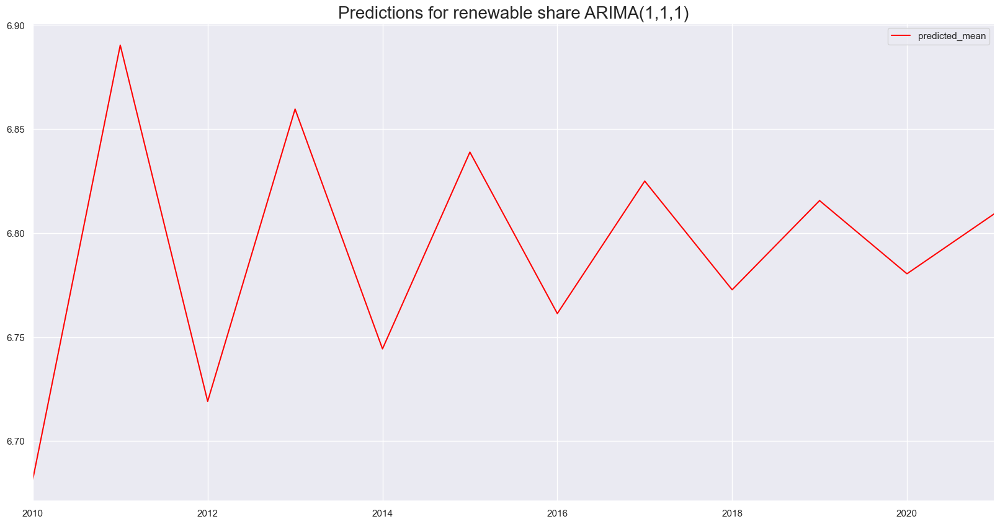

In [97]:
#Let us fit the model for only training dataset
model_Arima_111_rshare=ARIMA(df_china_train.renewables_share_energy[1:],order=(1,1,1))
model_Arima_111_rshare=model_Arima_111_rshare.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_china_Arima_111_predict_rshare=model_Arima_111_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_china_Arima_111_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for renewable share ARIMA(1,1,1)",size=20)
plt.show()

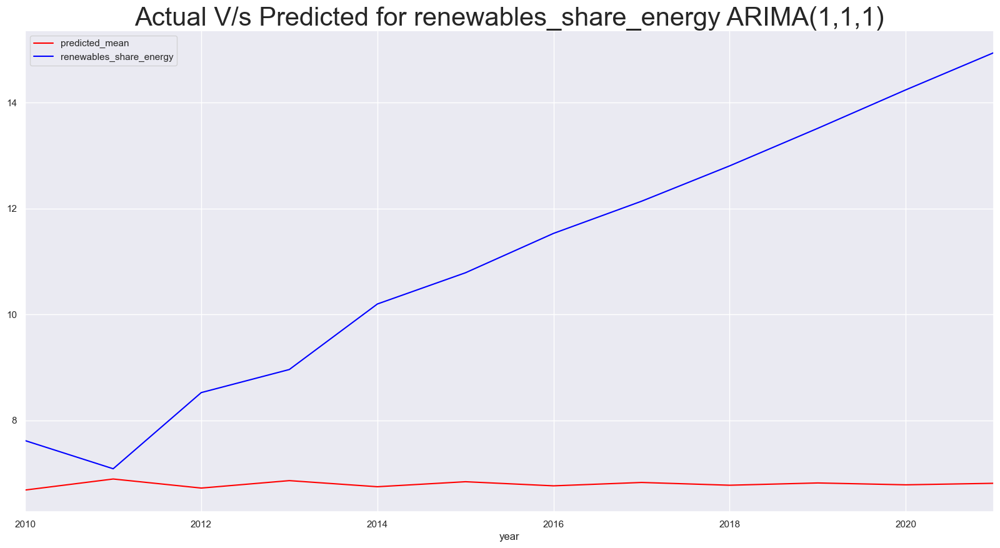

In [98]:
#Let us compare the test data and predicted values
df_china_Arima_111_predict_rshare.plot(figsize=(20,10),color="red",legend=True)
df_china_test.renewables_share_energy.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for renewables_share_energy ARIMA(1,1,1)",size=30)
plt.show()

In [99]:
rmse=sqrt(mean_squared_error(df_china_Arima_111_predict_rshare,df_china_test['renewables_share_energy']))
print(rmse)

4.918272825780758


In [100]:
mean_absolute_percentage_error(y_true=df_china_test['renewables_share_energy'],
                   y_pred=df_china_Arima_111_predict_rshare)

34.89393719094807

# 3.Predictions for Total energy

In [101]:
df_china_tenergy=df_china[['primary_energy_consumption']]
df_china_tenergy.head()

,primary_energy_consumption
year,
1965-01-01,1536.194
1966-01-01,1669.308
1967-01-01,1501.068
1968-01-01,1516.696
1969-01-01,1845.186


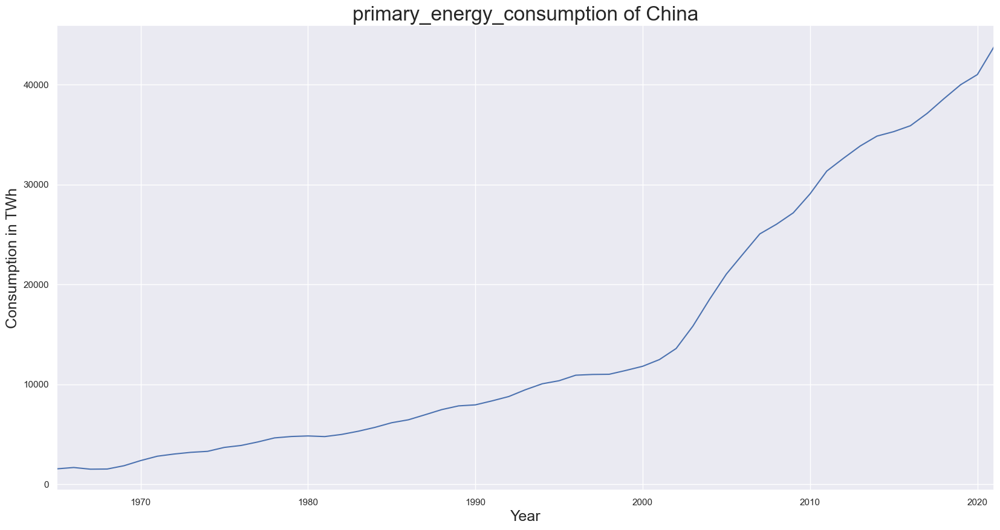

In [102]:
df_china.primary_energy_consumption.plot(figsize=(20,10))
plt.title("primary_energy_consumption of China",size=24)
plt.ylabel("Consumption in TWh",size=18)
plt.xlabel("Year",size=18)
plt.show()

## Seasonality Checking

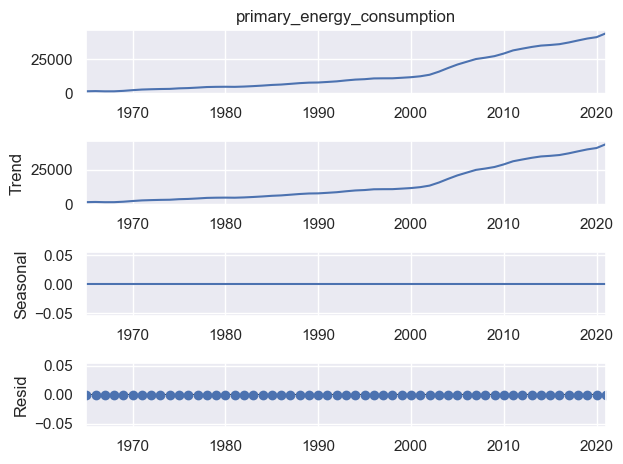

In [103]:
seas_decompose_additive= seasonal_decompose(df_china.primary_energy_consumption,model="additive")
seas_decompose_additive.plot()
plt.show()

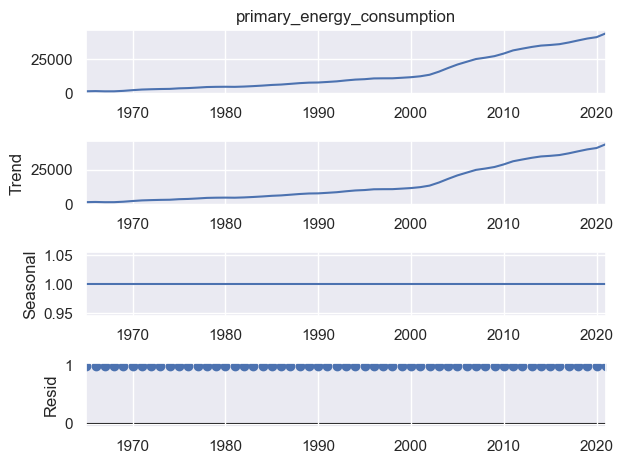

In [104]:
seas_decompose_multiplicative= seasonal_decompose(df_china.primary_energy_consumption,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

From both the methods it is clear that,there is no proof of stationarity

In [105]:
result = adfuller(df_china.primary_energy_consumption)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - China Time Series is Stationary")
else:
    print ("Failed to Reject Ho - China Time Series is Non-Stationary")

ADF Statistic: 2.158792
p-value: 0.998847
Critical Values:
	1%: -3.581
	5%: -2.927
	10%: -2.602
Failed to Reject Ho - China Time Series is Non-Stationary


## ARIMA 

In [106]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_tenergy=ARIMA(df_china.primary_energy_consumption[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_tenergy=model_AR_I_MA_111_tenergy.fit()
#print the summary of model results
results_AR_I_MA_111_tenergy.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


<class 'statsmodels.iolib.summary.Summary'>
"""
                                   SARIMAX Results                                    
======================================================================================
Dep. Variable:     primary_energy_consumption   No. Observations:                   56
Model:                         ARIMA(1, 1, 1)   Log Likelihood                -413.591
Date:                        Thu, 27 Jul 2023   AIC                            833.182
Time:                                12:48:00   BIC                            839.204
Sample:                            01-01-1966   HQIC                           835.511
                                 - 01-01-2021                                         
Covariance Type:                          opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9322      0.060     15.569      0.000       0.815       1.050
ma.L1          0.1348      0.193      0.700      0.484      -0.243       0.512
sigma2      1.886e+05   2.24e+04      8.422      0.000    1.45e+05    2.32e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.05   Jarque-Bera (JB):                60.61
Prob(Q):                              0.83   Prob(JB):                         0.00
Heteroskedasticity (H):               8.18   Skew:                             1.11
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.64
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3408866130.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['residuals_ARIMA_111_tenergy']=results_AR_I_MA_111_tenergy.resid


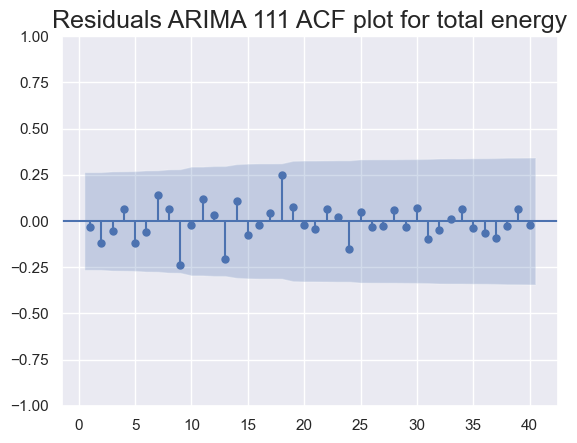

In [107]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_china['residuals_ARIMA_111_tenergy']=results_AR_I_MA_111_tenergy.resid
sgt.plot_acf(df_china.residuals_ARIMA_111_tenergy[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for total energy",size=18)
plt.show()

## Checking Stationarity

In [108]:
df_china['china_primary_energy_consumption_1']=df_china.primary_energy_consumption.diff(1)
model_AR_I_MA_101_china=ARIMA(df_china.china_primary_energy_consumption_1[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\306916501.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_primary_energy_consumption_1']=df_china.primary_energy_consumption.diff(1)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided

<class 'statsmodels.iolib.summary.Summary'>
"""
                                       SARIMAX Results                                        
==============================================================================================
Dep. Variable:     china_primary_energy_consumption_1   No. Observations:                   55
Model:                                 ARIMA(1, 0, 1)   Log Likelihood                -411.651
Date:                                Thu, 27 Jul 2023   AIC                            831.301
Time:                                        12:48:00   BIC                            839.331
Sample:                                    01-01-1967   HQIC                           834.407
                                         - 01-01-2021                                         
Covariance Type:                                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        767.2809    484.474      1.584      0.113    -182.271    1716.833
ar.L1          0.8218      0.134      6.118      0.000       0.559       1.085
ma.L1          0.2025      0.202      1.000      0.317      -0.194       0.599
sigma2      1.805e+05   2.28e+04      7.921      0.000    1.36e+05    2.25e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):                86.65
Prob(Q):                              0.93   Prob(JB):                         0.00
Heteroskedasticity (H):               9.74   Skew:                             1.48
Prob(H) (two-sided):                  0.00   Kurtosis:                         8.39
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [109]:
result = adfuller(df_china.china_primary_energy_consumption_1[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -1.447658
p-value: 0.559227
Critical Values:
	1%: -3.555
	5%: -2.916
	10%: -2.596
Failed to Reject Ho - Time Series is Non-Stationary


In [110]:
df_china['china_primary_energy_consumption_2']=df_china.primary_energy_consumption.diff(2)
model_AR_I_MA_101_china=ARIMA(df_china.china_primary_energy_consumption_2[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2242991434.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_primary_energy_consumption_2']=df_china.primary_energy_consumption.diff(2)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provide

<class 'statsmodels.iolib.summary.Summary'>
"""
                                       SARIMAX Results                                        
==============================================================================================
Dep. Variable:     china_primary_energy_consumption_2   No. Observations:                   55
Model:                                 ARIMA(1, 0, 1)   Log Likelihood                -413.476
Date:                                Thu, 27 Jul 2023   AIC                            834.952
Time:                                        12:48:00   BIC                            842.981
Sample:                                    01-01-1967   HQIC                           838.057
                                         - 01-01-2021                                         
Covariance Type:                                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       1484.9804   1060.368      1.400      0.161    -593.303    3563.263
ar.L1          0.8689      0.101      8.628      0.000       0.671       1.066
ma.L1          0.9476      0.101      9.341      0.000       0.749       1.146
sigma2      1.814e+05   2.44e+04      7.423      0.000    1.34e+05    2.29e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.89   Jarque-Bera (JB):                49.27
Prob(Q):                              0.35   Prob(JB):                         0.00
Heteroskedasticity (H):               8.85   Skew:                             1.34
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.78
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [111]:
result = adfuller(df_china.china_primary_energy_consumption_2[2:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -0.360802
p-value: 0.916441
Critical Values:
	1%: -3.581
	5%: -2.927
	10%: -2.602
Failed to Reject Ho - Time Series is Non-Stationary


In [112]:
df_china['china_primary_energy_consumption_3']=df_china.primary_energy_consumption.diff(3)
model_AR_I_MA_101_china=ARIMA(df_china.china_primary_energy_consumption_3[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3573469091.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_primary_energy_consumption_3']=df_china.primary_energy_consumption.diff(3)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provide

<class 'statsmodels.iolib.summary.Summary'>
"""
                                       SARIMAX Results                                        
==============================================================================================
Dep. Variable:     china_primary_energy_consumption_3   No. Observations:                   55
Model:                                 ARIMA(1, 0, 1)   Log Likelihood                -419.364
Date:                                Thu, 27 Jul 2023   AIC                            846.728
Time:                                        12:48:00   BIC                            854.757
Sample:                                    01-01-1967   HQIC                           849.833
                                         - 01-01-2021                                         
Covariance Type:                                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2223.7238   1677.562      1.326      0.185   -1064.237    5511.685
ar.L1          0.9258      0.066     14.064      0.000       0.797       1.055
ma.L1          0.5598      0.133      4.225      0.000       0.300       0.820
sigma2      3.073e+05   4.94e+04      6.224      0.000    2.11e+05    4.04e+05
===================================================================================
Ljung-Box (L1) (Q):                   3.01   Jarque-Bera (JB):                14.38
Prob(Q):                              0.08   Prob(JB):                         0.00
Heteroskedasticity (H):               8.55   Skew:                             0.98
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.55
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [113]:
result = adfuller(df_china.china_primary_energy_consumption_3[3:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: 0.035531
p-value: 0.961374
Critical Values:
	1%: -3.597
	5%: -2.933
	10%: -2.605
Failed to Reject Ho - Time Series is Non-Stationary


In [114]:
df_china['china_primary_energy_consumption_4']=df_china.primary_energy_consumption.diff(4)
model_AR_I_MA_101_china=ARIMA(df_china.china_primary_energy_consumption_4[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3527981673.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_primary_energy_consumption_4']=df_china.primary_energy_consumption.diff(4)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provide

<class 'statsmodels.iolib.summary.Summary'>
"""
                                       SARIMAX Results                                        
==============================================================================================
Dep. Variable:     china_primary_energy_consumption_4   No. Observations:                   55
Model:                                 ARIMA(1, 0, 1)   Log Likelihood                -408.288
Date:                                Thu, 27 Jul 2023   AIC                            824.576
Time:                                        12:48:01   BIC                            832.606
Sample:                                    01-01-1967   HQIC                           827.681
                                         - 01-01-2021                                         
Covariance Type:                                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       2965.3974   2520.298      1.177      0.239   -1974.296    7905.090
ar.L1          0.9462      0.052     18.082      0.000       0.844       1.049
ma.L1          0.9342      0.078     11.902      0.000       0.780       1.088
sigma2      2.588e+05   3.77e+04      6.863      0.000    1.85e+05    3.33e+05
===================================================================================
Ljung-Box (L1) (Q):                   4.30   Jarque-Bera (JB):                10.34
Prob(Q):                              0.04   Prob(JB):                         0.01
Heteroskedasticity (H):               7.69   Skew:                             0.41
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.96
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [115]:
result = adfuller(df_china.china_primary_energy_consumption_4[4:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -1.080205
p-value: 0.722901
Critical Values:
	1%: -3.568
	5%: -2.921
	10%: -2.599
Failed to Reject Ho - Time Series is Non-Stationary


In [116]:
df_china['china_primary_energy_consumption_5']=df_china.primary_energy_consumption.diff(5)
model_AR_I_MA_101_china=ARIMA(df_china.china_primary_energy_consumption_5[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1657250542.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_primary_energy_consumption_5']=df_china.primary_energy_consumption.diff(5)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provide

<class 'statsmodels.iolib.summary.Summary'>
"""
                                       SARIMAX Results                                        
==============================================================================================
Dep. Variable:     china_primary_energy_consumption_5   No. Observations:                   55
Model:                                 ARIMA(1, 0, 1)   Log Likelihood                -411.835
Date:                                Thu, 27 Jul 2023   AIC                            831.671
Time:                                        12:48:01   BIC                            839.700
Sample:                                    01-01-1967   HQIC                           834.776
                                         - 01-01-2021                                         
Covariance Type:                                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       3700.1642   3776.096      0.980      0.327   -3700.848    1.11e+04
ar.L1          0.9565      0.049     19.437      0.000       0.860       1.053
ma.L1          0.6213      0.111      5.622      0.000       0.405       0.838
sigma2      4.113e+05   6.67e+04      6.171      0.000    2.81e+05    5.42e+05
===================================================================================
Ljung-Box (L1) (Q):                   5.00   Jarque-Bera (JB):                12.60
Prob(Q):                              0.03   Prob(JB):                         0.00
Heteroskedasticity (H):              19.56   Skew:                             0.81
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.69
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [117]:
result = adfuller(df_china.china_primary_energy_consumption_5[5:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -0.302979
p-value: 0.925081
Critical Values:
	1%: -3.597
	5%: -2.933
	10%: -2.605
Failed to Reject Ho - Time Series is Non-Stationary


In [118]:
df_china['china_primary_energy_consumption_6']=df_china.primary_energy_consumption.diff(6)
model_AR_I_MA_101_china=ARIMA(df_china.china_primary_energy_consumption_6[2:],order=(1,0,1))
results_AR_I_MA_101_china=model_AR_I_MA_101_china.fit()
results_AR_I_MA_101_china.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1429034843.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_china['china_primary_energy_consumption_6']=df_china.primary_energy_consumption.diff(6)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provide

<class 'statsmodels.iolib.summary.Summary'>
"""
                                       SARIMAX Results                                        
==============================================================================================
Dep. Variable:     china_primary_energy_consumption_6   No. Observations:                   55
Model:                                 ARIMA(1, 0, 1)   Log Likelihood                -399.821
Date:                                Thu, 27 Jul 2023   AIC                            807.643
Time:                                        12:48:01   BIC                            815.672
Sample:                                    01-01-1967   HQIC                           810.748
                                         - 01-01-2021                                         
Covariance Type:                                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       4429.8676   4369.028      1.014      0.311   -4133.270     1.3e+04
ar.L1          0.9613      0.049     19.564      0.000       0.865       1.058
ma.L1          0.9052      0.101      8.939      0.000       0.707       1.104
sigma2      3.386e+05   5.05e+04      6.704      0.000     2.4e+05    4.38e+05
===================================================================================
Ljung-Box (L1) (Q):                   3.05   Jarque-Bera (JB):                39.97
Prob(Q):                              0.08   Prob(JB):                         0.00
Heteroskedasticity (H):              10.57   Skew:                             1.43
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.04
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [119]:
result = adfuller(df_china.china_primary_energy_consumption_6[6:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: 0.327821
p-value: 0.978586
Critical Values:
	1%: -3.601
	5%: -2.935
	10%: -2.606
Failed to Reject Ho - Time Series is Non-Stationary


There is inherent non-stationary again here,therefore ARIMA(1,1,1) is considered

## Predicting Using ARIMA (1,1,1) 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


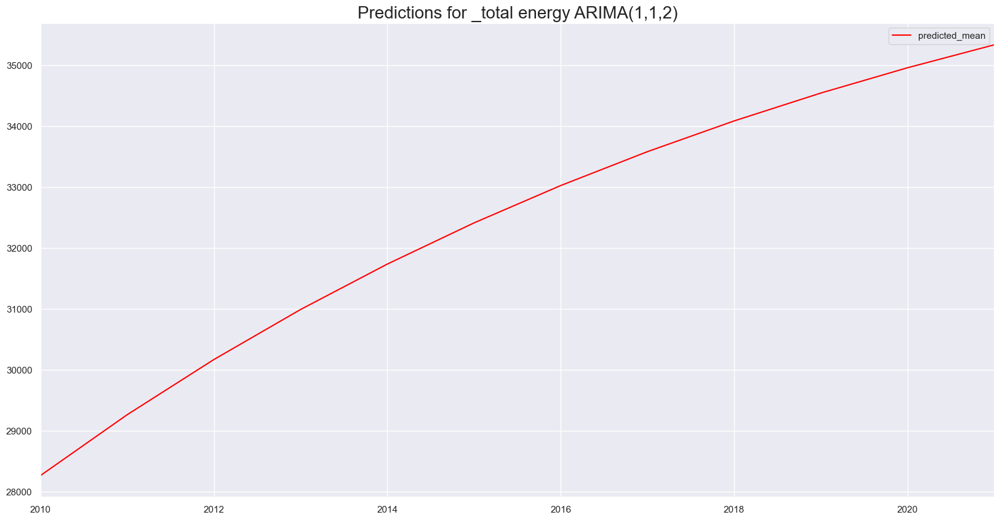

In [120]:
#Let us fit the model for only training dataset
model_Arima_111_tenergy=ARIMA(df_china_train.primary_energy_consumption[1:],order=(1,1,1))
model_Arima_111_tenergy=model_Arima_111_tenergy.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_china_Arima_111_predict_tenergy=model_Arima_111_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_china_Arima_111_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for _total energy ARIMA(1,1,2)",size=20)
plt.show()

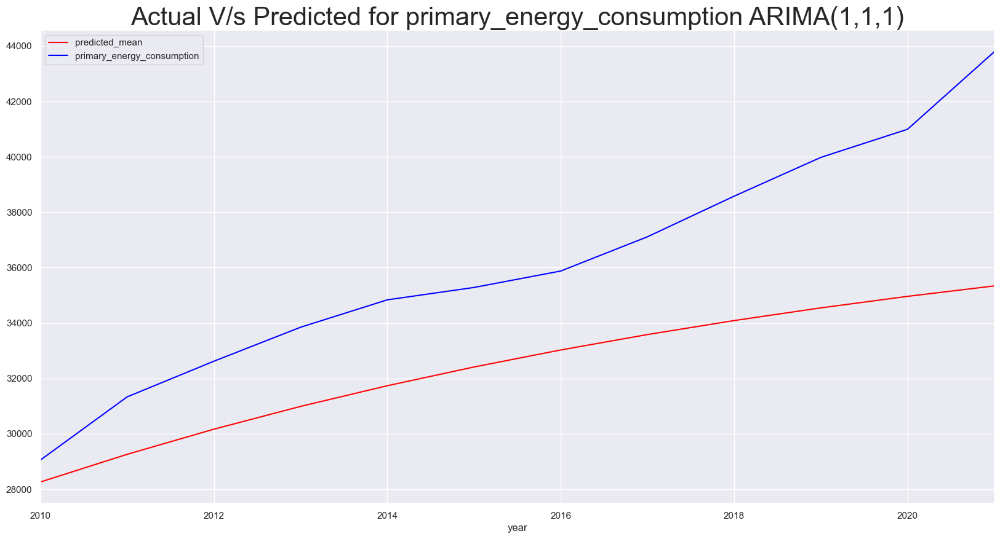

In [121]:
#Let us compare the test data and predicted values
df_china_Arima_111_predict_tenergy.plot(figsize=(20,10),color="red",legend=True)
df_china_test.primary_energy_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for primary_energy_consumption ARIMA(1,1,1)",size=30)
plt.show()

In [122]:
rmse=sqrt(mean_squared_error(df_china_Arima_111_predict_tenergy,df_china_test['primary_energy_consumption']))
print(rmse)

4233.1783616182365


In [123]:
mean_absolute_percentage_error(y_true=df_china_test['primary_energy_consumption'],
                   y_pred=df_china_Arima_111_predict_tenergy)

9.920186557112864

# Auto ARIMA Model

## 1. Predictions for renewable consumption 

In [124]:
#pip install pmdarima

In [125]:
#Importing suitable library to perform Auto Arima modelling
from pmdarima.arima import auto_arima

In [126]:
model_auto=auto_arima(df_china.renewables_consumption[1:])

In [127]:
model_auto

ARIMA(order=(1, 2, 4), scoring_args={}, suppress_warnings=True)

It can be seen that seasonal order is 0,So we can consider that there is no seasonality,which is already proven above using additive and multiplicative decomposition methods.

In [128]:
model_auto.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(1, 2, 4)   Log Likelihood                -312.560
Date:                Thu, 27 Jul 2023   AIC                            639.119
Time:                        12:48:04   BIC                            653.042
Sample:                    01-01-1966   HQIC                           644.489
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     16.9759     11.361      1.494      0.135      -5.290      39.242
ar.L1         -0.7018      0.104     -6.744      0.000      -0.906      -0.498
ma.L1         -0.3692      0.159     -2.321      0.020      -0.681      -0.057
ma.L2         -0.4213      0.170     -2.480      0.013      -0.754      -0.088
ma.L3         -0.1962      0.162     -1.210      0.226      -0.514       0.122
ma.L4          0.6734      0.163      4.125      0.000       0.353       0.993
sigma2      5794.1622    958.329      6.046      0.000    3915.872    7672.452
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                27.12
Prob(Q):                              0.96   Prob(JB):                         0.00
Heteroskedasticity (H):              19.20   Skew:                             1.16
Prob(H) (two-sided):                  0.00   Kurtosis:                         5.58
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

So Auto ARIMA reccomends SARIMAX(1,2,4).yet there is no seasonality and exogenous variable here So it can be treated as ARIMA(1,2,4) and its prediction accuracy can be checked in the next step

## Predictions for Auto ARIMA

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to 

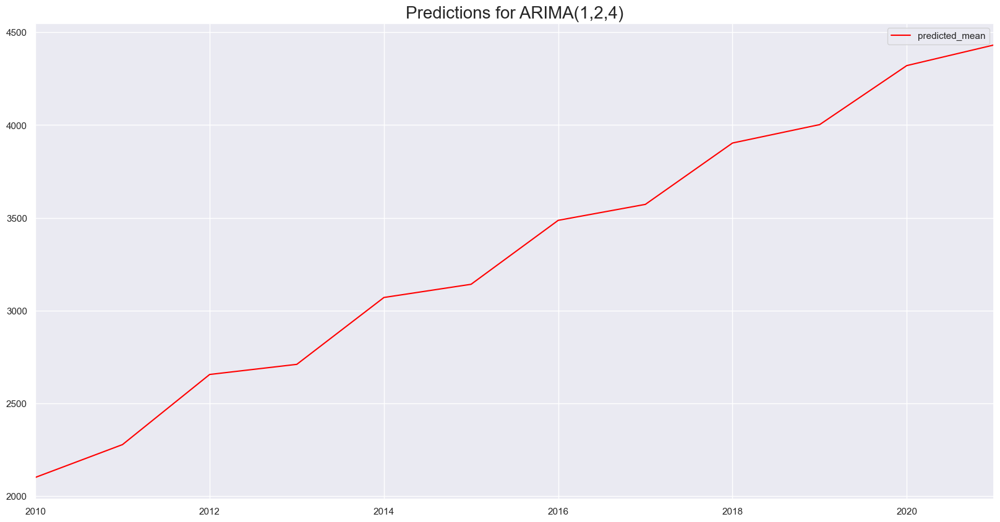

In [129]:
#Let us fit the model for only training dataset
model_Arima_124=ARIMA(df_china_train.renewables_consumption[1:],order=(1,2,4))
model_Arima_124=model_Arima_124.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_china_Arima_124_predict=model_Arima_124.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_china_Arima_124_predict[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for ARIMA(1,2,4)",size=20)
plt.show()

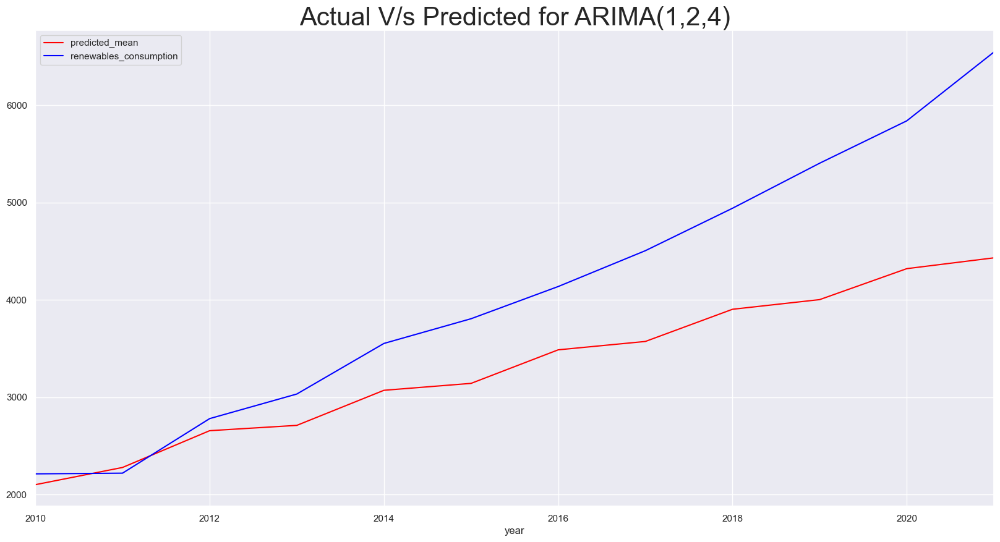

In [130]:
#Let us compare the test data and predicted values
df_china_Arima_124_predict.plot(figsize=(20,10),color="red",legend=True)
df_china_test.renewables_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for ARIMA(1,2,4)",size=30)
plt.show()

In [131]:
rmse=sqrt(mean_squared_error(df_china_Arima_124_predict,df_china_test['renewables_consumption']))
mse=mean_squared_error(df_china_Arima_124_predict,df_china_test['renewables_consumption'])
mape = np.mean(np.abs(df_china_Arima_124_predict - df_china_test['renewables_consumption'])/np.abs(df_china_test['renewables_consumption'])) 
mae = np.mean(np.abs(df_china_Arima_124_predict  - df_china_test['renewables_consumption']))
mpe = np.mean((df_china_Arima_124_predict  - df_china_test['renewables_consumption'])/df_china_test['renewables_consumption'])
print("Mean Percentage  error for ARIMA(1,2,4): ",mpe)
print("Mean absolutee  error for ARIMA(1,2,4): ",mae)
print("Mean absolute percentage error for ARIMA(1,2,4): ",mape)
print("Root Mean Squared Error for ARIMA(1,2,4): ",rmse)
print("Mean Squared Error for ARIMA(1,2,4):",mse)

Mean Percentage  error for ARIMA(1,2,4):  -0.15842924420204488
Mean absolutee  error for ARIMA(1,2,4):  784.5639566978069
Mean absolute percentage error for ARIMA(1,2,4):  0.1628247809814162
Root Mean Squared Error for ARIMA(1,2,4):  996.350770937259
Mean Squared Error for ARIMA(1,2,4): 992714.8587472703


In [132]:
mean_absolute_percentage_error(y_true=df_china_test['renewables_consumption'],
                   y_pred=df_china_Arima_124_predict)

16.28247809814162

## 2. Predictions for renewable share 

In [133]:
model_auto_rshare=auto_arima(df_china.renewables_share_energy[1:])

In [134]:
model_auto_rshare

ARIMA(order=(0, 2, 1), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [135]:
model_auto_rshare.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 2, 1)   Log Likelihood                 -39.233
Date:                Thu, 27 Jul 2023   AIC                             82.466
Time:                        12:48:05   BIC                             86.444
Sample:                    01-01-1966   HQIC                            84.000
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.8584      0.111     -7.713      0.000      -1.077      -0.640
sigma2         0.2443      0.039      6.341      0.000       0.169       0.320
===================================================================================
Ljung-Box (L1) (Q):                   1.29   Jarque-Bera (JB):                 2.47
Prob(Q):                              0.26   Prob(JB):                         0.29
Heteroskedasticity (H):               1.93   Skew:                             0.21
Prob(H) (two-sided):                  0.17   Kurtosis:                         3.96
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

SARIMAX(0,2,1) will be decoded as ARIMA(0,2,1)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


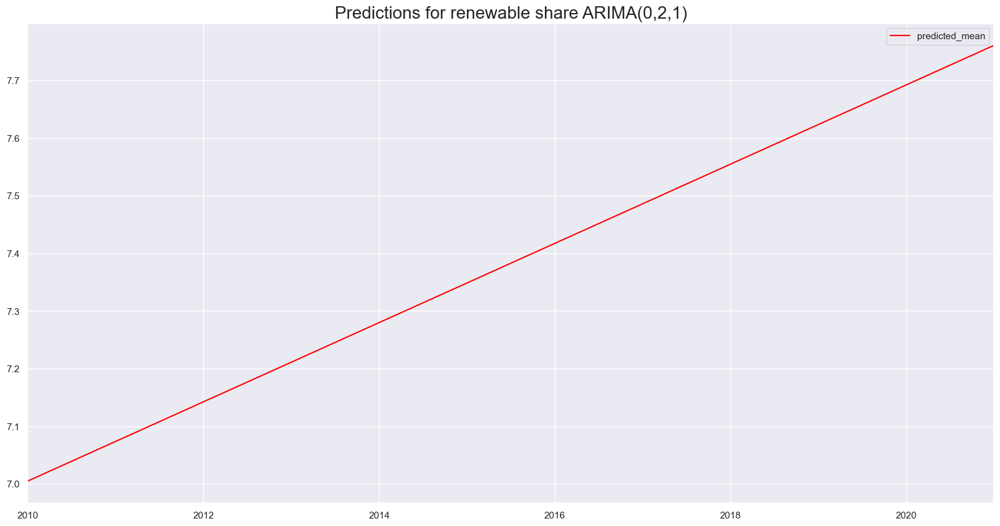

In [136]:
#Let us fit the model for only training dataset
model_Arima_021_rshare=ARIMA(df_china_train.renewables_share_energy[1:],order=(0,2,1))
model_Arima_021_rshare=model_Arima_021_rshare.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_china_Arima_021_predict_rshare=model_Arima_021_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_china_Arima_021_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for renewable share ARIMA(0,2,1)",size=20)
plt.show()

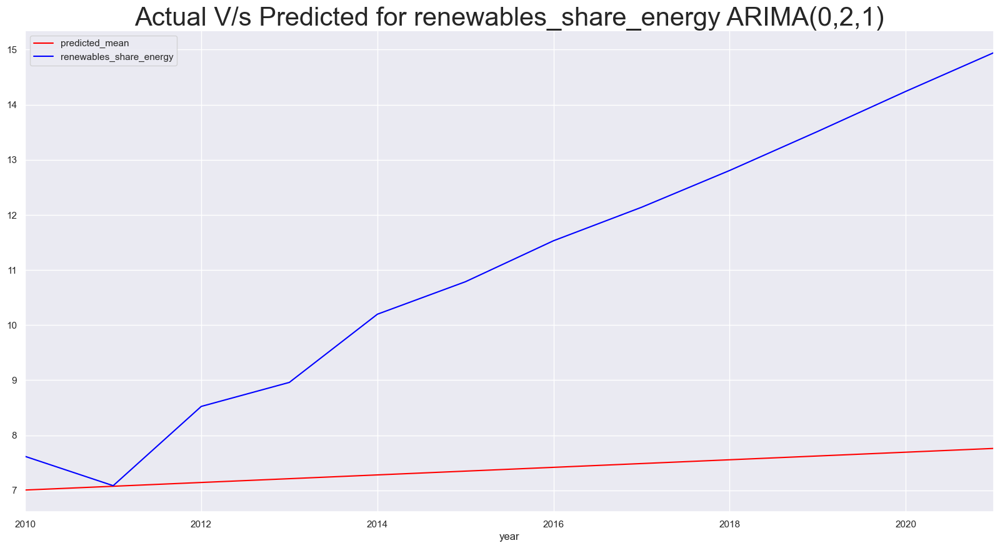

In [137]:
#Let us compare the test data and predicted values
df_china_Arima_021_predict_rshare.plot(figsize=(20,10),color="red",legend=True)
df_china_test.renewables_share_energy.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for renewables_share_energy ARIMA(0,2,1)",size=30)
plt.show()

In [138]:
rmse=sqrt(mean_squared_error(df_china_Arima_021_predict_rshare,df_china_test['renewables_share_energy']))
print(rmse)

4.292532460792869


In [139]:
mean_absolute_percentage_error(y_true=df_china_test['renewables_share_energy'],
                   y_pred=df_china_Arima_021_predict_rshare)

29.755864964974837

## 3. Predictions for total energy

In [140]:
model_auto_tenergy=auto_arima(df_china.primary_energy_consumption[1:])

In [141]:
model_auto_tenergy

ARIMA(order=(0, 2, 0), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [142]:
model_auto_tenergy.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 2, 0)   Log Likelihood                -405.133
Date:                Thu, 27 Jul 2023   AIC                            812.267
Time:                        12:48:06   BIC                            814.256
Sample:                    01-01-1966   HQIC                           813.034
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      1.921e+05   2.07e+04      9.270      0.000    1.51e+05    2.33e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.13   Jarque-Bera (JB):                43.78
Prob(Q):                              0.72   Prob(JB):                         0.00
Heteroskedasticity (H):              12.97   Skew:                             0.88
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.04
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

SARIMAX(0,2,0) can be decoded as ARIMA (0,2,0)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)
C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency AS-JAN will be used.
  self._init_dates(dates, freq)


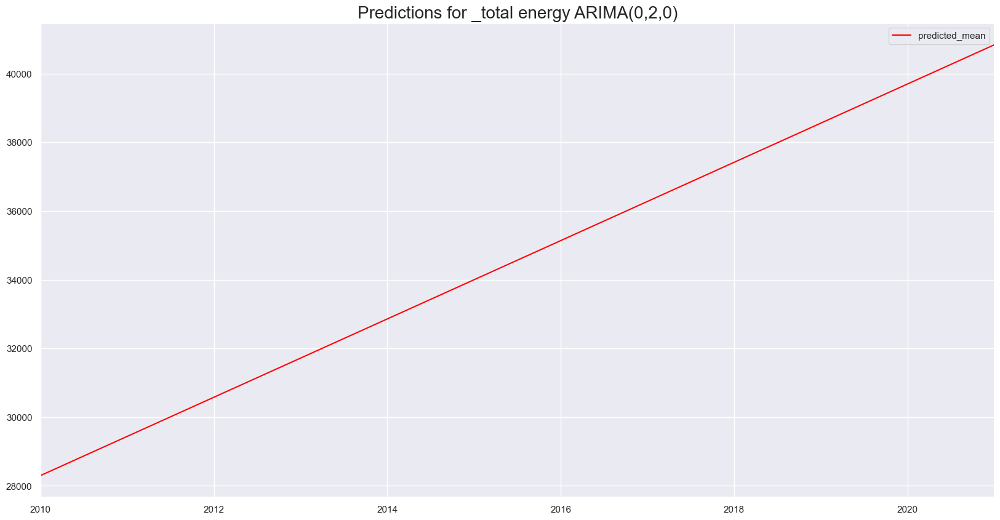

In [143]:
#Let us fit the model for only training dataset
model_Arima_020_tenergy=ARIMA(df_china_train.primary_energy_consumption[1:],order=(0,2,0))
model_Arima_020_tenergy=model_Arima_020_tenergy.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_china_Arima_020_predict_tenergy=model_Arima_020_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_china_Arima_020_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for _total energy ARIMA(0,2,0)",size=20)
plt.show()

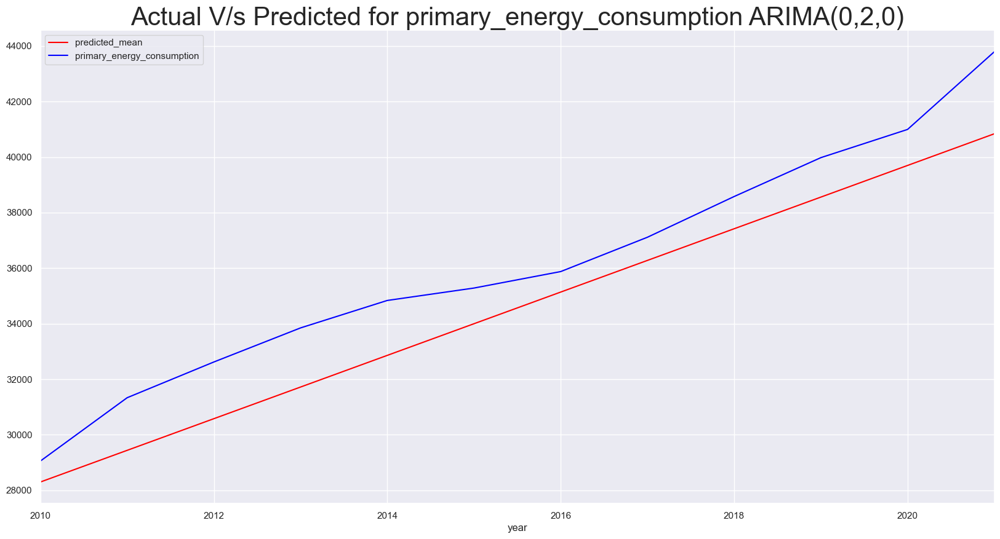

In [144]:
#Let us compare the test data and predicted values
df_china_Arima_020_predict_tenergy.plot(figsize=(20,10),color="red",legend=True)
df_china_test.primary_energy_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for primary_energy_consumption ARIMA(0,2,0)",size=30)
plt.show()

In [145]:
rmse=sqrt(mean_squared_error(df_china_Arima_020_predict_tenergy,df_china_test['primary_energy_consumption']))
print(rmse)

1669.203812753635


In [146]:
mean_absolute_percentage_error(y_true=df_china_test['primary_energy_consumption'],
                   y_pred=df_china_Arima_020_predict_tenergy)

4.274167828937961

# FB Prophet Model

## 1. Prediction for Renewable consumption 

In [147]:
#pip install prophet
#pip install fbprophet
#!conda install -c conda-forge fbprophet -y
#conda install -c anaconda ephem
#conda install -c conda-forge pystan
#conda install -c conda-forge fbprophet


In [148]:
from prophet.plot import plot_plotly, plot_components_plotly
from prophet import Prophet

In [149]:
df_china_No_index.head()

,year,renewables_consumption
4292,1965-01-01,65.341
4293,1966-01-01,66.491
4294,1967-01-01,57.317
4295,1968-01-01,67.628
4296,1969-01-01,68.778


In [150]:
df_china_No_index.columns = ['ds','y']
df_china_No_index.head()

,ds,y
4292,1965-01-01,65.341
4293,1966-01-01,66.491
4294,1967-01-01,57.317
4295,1968-01-01,67.628
4296,1969-01-01,68.778


In [151]:
train = df_china_No_index.iloc[:len(df_china_No_index)-12]
test = df_china_No_index.iloc[len(df_china_No_index)-12:]
test.head()

,ds,y
4337,2010-01-01,2212.766
4338,2011-01-01,2219.735
4339,2012-01-01,2780.102
4340,2013-01-01,3032.571
4341,2014-01-01,3552.340


In [152]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

12:48:07 - cmdstanpy - INFO - Chain [1] start processing
12:48:07 - cmdstanpy - INFO - Chain [1] done processing


In [153]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,2204.661532,1109.034562,1687.824878,2204.437191,2204.886044,-788.996459,-788.996459,-788.996459,-788.996459,-788.996459,-788.996459,0.0,0.0,0.0,1415.665073
53,2018-01-01,2235.647457,1127.864432,1696.929881,2235.379996,2235.922823,-812.763674,-812.763674,-812.763674,-812.763674,-812.763674,-812.763674,0.0,0.0,0.0,1422.883783
54,2019-01-01,2266.633382,1145.990309,1730.537028,2266.326880,2266.961788,-823.408644,-823.408644,-823.408644,-823.408644,-823.408644,-823.408644,0.0,0.0,0.0,1443.224738
55,2020-01-01,2297.619307,1192.306071,1776.378795,2297.263940,2297.994481,-820.918545,-820.918545,-820.918545,-820.918545,-820.918545,-820.918545,0.0,0.0,0.0,1476.700762
56,2021-01-01,2328.690125,1262.931027,1805.432780,2328.285240,2329.115385,-788.996459,-788.996459,-788.996459,-788.996459,-788.996459,-788.996459,0.0,0.0,0.0,1539.693666


In [154]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,1415.665073,1109.034562,1687.824878
53,2018-01-01,1422.883783,1127.864432,1696.929881
54,2019-01-01,1443.224738,1145.990309,1730.537028
55,2020-01-01,1476.700762,1192.306071,1776.378795
56,2021-01-01,1539.693666,1262.931027,1805.432780


In [155]:
test.tail()


,ds,y
4344,2017-01-01,4504.976
4345,2018-01-01,4940.909
4346,2019-01-01,5403.476
4347,2020-01-01,5838.805
4348,2021-01-01,6545.095


In [156]:
plot_plotly(m,forecast)


In [157]:
plot_components_plotly(m, forecast)


In [158]:
from statsmodels.tools.eval_measures import rmse


In [159]:
predictions = forecast.iloc[-12:]['yhat']
predictions.head()

45    1174.826596
46    1195.167551
47    1228.643576
48    1291.636479
49    1298.855189
Name: yhat, dtype: float64

In [160]:
test['y'].head()

4337    2212.766
4338    2219.735
4339    2780.102
4340    3032.571
4341    3552.340
Name: y, dtype: float64

In [161]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))
print("Mean Value of Test Dataset:", test['y'].mean())

Root Mean Squared Error between actual and  predicted values:  3003.6900970877055
Mean Value of Test Dataset: 4081.1510833333336


In [162]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

63.88414655775296

## 2. Predictions for Renewable share 

In [163]:
df_china_No_index_rshare.head()

,year,renewables_share_energy
4292,1965-01-01,4.253
4293,1966-01-01,3.983
4294,1967-01-01,3.818
4295,1968-01-01,4.459
4296,1969-01-01,3.727


In [164]:
df_china_No_index_rshare.columns = ['ds','y']
df_china_No_index_rshare.head()

,ds,y
4292,1965-01-01,4.253
4293,1966-01-01,3.983
4294,1967-01-01,3.818
4295,1968-01-01,4.459
4296,1969-01-01,3.727


In [165]:
train = df_china_No_index_rshare.iloc[:len(df_china_No_index_rshare)-12]
test = df_china_No_index_rshare.iloc[len(df_china_No_index_rshare)-12:]
test.head()

,ds,y
4337,2010-01-01,7.616
4338,2011-01-01,7.084
4339,2012-01-01,8.523
4340,2013-01-01,8.959
4341,2014-01-01,10.197


In [166]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

12:48:08 - cmdstanpy - INFO - Chain [1] start processing
12:48:09 - cmdstanpy - INFO - Chain [1] done processing


In [167]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,7.577705,6.099264,7.490967,7.576972,7.578353,-0.764274,-0.764274,-0.764274,-0.764274,-0.764274,-0.764274,0.0,0.0,0.0,6.813432
53,2018-01-01,7.648401,6.105134,7.444282,7.647524,7.649198,-0.893825,-0.893825,-0.893825,-0.893825,-0.893825,-0.893825,0.0,0.0,0.0,6.754575
54,2019-01-01,7.719096,6.087017,7.445433,7.718052,7.720030,-0.943157,-0.943157,-0.943157,-0.943157,-0.943157,-0.943157,0.0,0.0,0.0,6.775939
55,2020-01-01,7.789792,6.172465,7.545606,7.788583,7.790857,-0.912204,-0.912204,-0.912204,-0.912204,-0.912204,-0.912204,0.0,0.0,0.0,6.877588
56,2021-01-01,7.860681,6.443744,7.784390,7.859317,7.861907,-0.764274,-0.764274,-0.764274,-0.764274,-0.764274,-0.764274,0.0,0.0,0.0,7.096408


In [168]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,6.813432,6.099264,7.490967
53,2018-01-01,6.754575,6.105134,7.444282
54,2019-01-01,6.775939,6.087017,7.445433
55,2020-01-01,6.877588,6.172465,7.545606
56,2021-01-01,7.096408,6.443744,7.784390


In [169]:
test.tail()


,ds,y
4344,2017-01-01,12.139
4345,2018-01-01,12.807
4346,2019-01-01,13.516
4347,2020-01-01,14.243
4348,2021-01-01,14.946


In [170]:
plot_plotly(m,forecast)


In [171]:
plot_components_plotly(m, forecast)


In [172]:
predictions = forecast.iloc[-12:]['yhat']
predictions.tail()

52    6.813432
53    6.754575
54    6.775939
55    6.877588
56    7.096408
Name: yhat, dtype: float64

In [173]:
test['y'].tail()

4344    12.139
4345    12.807
4346    13.516
4347    14.243
4348    14.946
Name: y, dtype: float64

In [174]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))


Root Mean Squared Error between actual and  predicted values:  4.971266594209083


In [175]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

37.37617468395063

## 3. Predictions for Total Energy 

In [176]:
df_china_No_index_tenergy.head()

,year,primary_energy_consumption
4292,1965-01-01,1536.194
4293,1966-01-01,1669.308
4294,1967-01-01,1501.068
4295,1968-01-01,1516.696
4296,1969-01-01,1845.186


In [177]:
df_china_No_index_tenergy.columns = ['ds','y']
df_china_No_index_tenergy.head()

,ds,y
4292,1965-01-01,1536.194
4293,1966-01-01,1669.308
4294,1967-01-01,1501.068
4295,1968-01-01,1516.696
4296,1969-01-01,1845.186


In [178]:
train = df_china_No_index_tenergy.iloc[:len(df_china_No_index_tenergy)-12]
test = df_china_No_index_tenergy.iloc[len(df_china_No_index_tenergy)-12:]
test.head()

,ds,y
4337,2010-01-01,29054.180
4338,2011-01-01,31333.574
4339,2012-01-01,32620.357
4340,2013-01-01,33847.848
4341,2014-01-01,34835.977


In [179]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

12:48:09 - cmdstanpy - INFO - Chain [1] start processing
12:48:10 - cmdstanpy - INFO - Chain [1] done processing


In [180]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,41478.594349,40226.487926,42563.676959,40469.994738,42487.232439,-71.786019,-71.786019,-71.786019,-71.786019,-71.786019,-71.786019,0.0,0.0,0.0,41406.808330
53,2018-01-01,43224.554028,41690.949078,44507.189014,41992.569075,44409.369007,-73.255696,-73.255696,-73.255696,-73.255696,-73.255696,-73.255696,0.0,0.0,0.0,43151.298333
54,2019-01-01,44970.513707,43340.378848,46475.258837,43480.141003,46347.084543,-50.369483,-50.369483,-50.369483,-50.369483,-50.369483,-50.369483,0.0,0.0,0.0,44920.144224
55,2020-01-01,46716.473386,44869.386013,48458.648672,45003.870528,48300.473285,-3.216747,-3.216747,-3.216747,-3.216747,-3.216747,-3.216747,0.0,0.0,0.0,46713.256639
56,2021-01-01,48467.216516,46315.871166,50330.345994,46483.518565,50337.634737,-71.786019,-71.786019,-71.786019,-71.786019,-71.786019,-71.786019,0.0,0.0,0.0,48395.430497


In [181]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,41406.808330,40226.487926,42563.676959
53,2018-01-01,43151.298333,41690.949078,44507.189014
54,2019-01-01,44920.144224,43340.378848,46475.258837
55,2020-01-01,46713.256639,44869.386013,48458.648672
56,2021-01-01,48395.430497,46315.871166,50330.345994


In [182]:
test.tail()


,ds,y
4344,2017-01-01,37112.145
4345,2018-01-01,38578.570
4346,2019-01-01,39978.492
4347,2020-01-01,40994.574
4348,2021-01-01,43790.895


In [183]:
plot_plotly(m,forecast)


In [184]:
plot_components_plotly(m, forecast)


In [185]:
predictions = forecast.iloc[-12:]['yhat']
predictions.tail()

52    41406.808330
53    43151.298333
54    44920.144224
55    46713.256639
56    48395.430497
Name: yhat, dtype: float64

In [186]:
test['y'].tail()

4344    37112.145
4345    38578.570
4346    39978.492
4347    40994.574
4348    43790.895
Name: y, dtype: float64

In [187]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))


Root Mean Squared Error between actual and  predicted values:  3437.157775667122


In [188]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

7.165913653848389

# VAR Model development 

## 1. Predictions for renewable consumption 

In [189]:
#Importing suitable libraries
from statsmodels.tsa.statespace.varmax import VARMAX
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import grangercausalitytests, adfuller
from tqdm import tqdm_notebook
from itertools import product

In [190]:
df_world_var=df[['country','year','iso_code','renewables_consumption','primary_energy_consumption','fossil_fuel_consumption','renewables_energy_per_capita','fossil_energy_per_capita','energy_per_capita']]
df_world_var.head()

,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
0,Afghanistan,1900,AFG,NaN,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,1901,AFG,NaN,NaN,NaN,NaN,NaN,NaN
2,Afghanistan,1902,AFG,NaN,NaN,NaN,NaN,NaN,NaN
3,Afghanistan,1903,AFG,NaN,NaN,NaN,NaN,NaN,NaN
4,Afghanistan,1904,AFG,NaN,NaN,NaN,NaN,NaN,NaN


In [191]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_china=df_world_var[df_world_var['country'].isin(['China'])]
df_var_china

,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
4227,China,1900,CHN,NaN,NaN,NaN,NaN,NaN,NaN
4228,China,1901,CHN,NaN,NaN,NaN,NaN,NaN,NaN
4229,China,1902,CHN,NaN,NaN,NaN,NaN,NaN,NaN
4230,China,1903,CHN,NaN,NaN,NaN,NaN,NaN,NaN
4231,China,1904,CHN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
4344,China,2017,CHN,4504.976,37112.145,31973.576,3194.393,22671.857,26315.520
4345,China,2018,CHN,4940.909,38578.570,32888.707,3486.709,23208.959,27224.191
4346,China,2019,CHN,5403.476,39978.492,33692.988,3800.276,23696.350,28116.959
4347,China,2020,CHN,5838.805,40994.574,34232.883,4097.609,24024.260,28769.539


In [192]:
#dropping the null values corresponding to initial years of null data
df_var_china.dropna(inplace=True)
df_var_china.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\766892343.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
4344,China,2017,CHN,4504.976,37112.145,31973.576,3194.393,22671.857,26315.520
4345,China,2018,CHN,4940.909,38578.570,32888.707,3486.709,23208.959,27224.191
4346,China,2019,CHN,5403.476,39978.492,33692.988,3800.276,23696.350,28116.959
4347,China,2020,CHN,5838.805,40994.574,34232.883,4097.609,24024.260,28769.539
4348,China,2021,CHN,6545.095,43790.895,36222.586,4590.171,25403.430,30711.195


In [193]:
#Converting them into date time format with years format
df_var_china.year=pd.to_datetime(df_var_china.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1439915875.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [194]:
#Setting the year as index
df_var_china.set_index("year",inplace=True)
df_var_china.head()

,country,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
year,,,,,,,,
1965-01-01,China,CHN,65.341,1536.194,1470.854,90.269,2031.997,2122.266
1966-01-01,China,CHN,66.491,1669.308,1602.817,89.496,2157.373,2246.869
1967-01-01,China,CHN,57.317,1501.068,1443.752,75.317,1897.161,1972.479
1968-01-01,China,CHN,67.628,1516.696,1449.068,86.661,1856.894,1943.555
1969-01-01,China,CHN,68.778,1845.186,1776.409,85.818,2216.546,2302.365


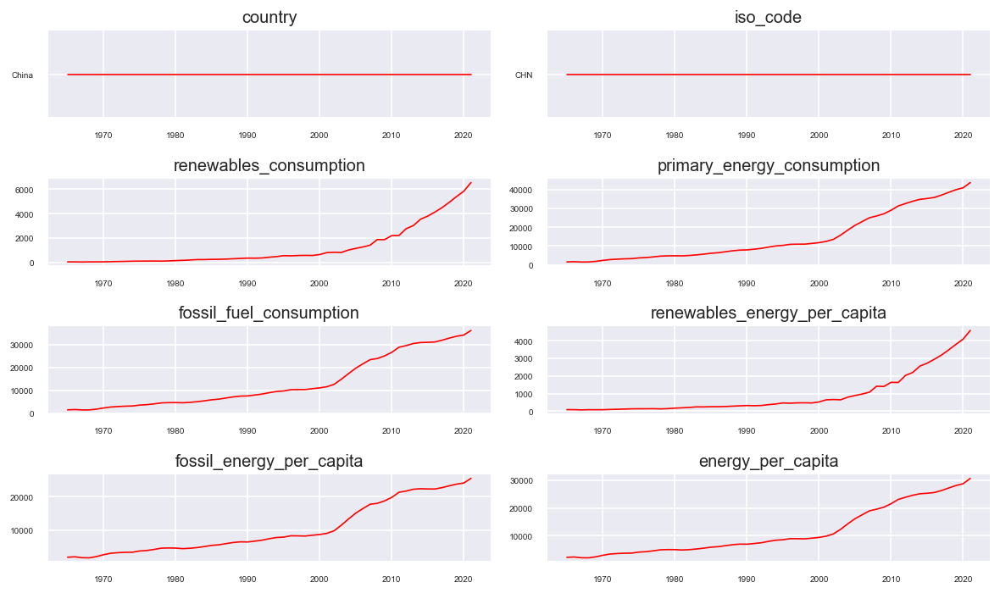

In [195]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=4, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_china[df_var_china.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_china.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

So Renewable consumption and renewable energy per-capita patterns are looking alike.

In [196]:
#Let us check which time series is causing the other using granger casuality tests
print('renewables_energy_per_capita causes renewables_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_china[['renewables_consumption', 'renewables_energy_per_capita']], 8)

print('\n renewables_consumption causes renewables_energy_per_capita?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_china[['renewables_energy_per_capita', 'renewables_consumption']], 8)

renewables_energy_per_capita causes renewables_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.1113  , p=0.7400  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=0.1176  , p=0.7317  , df=1
likelihood ratio test: chi2=0.1174  , p=0.7318  , df=1
parameter F test:         F=0.1113  , p=0.7400  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=2.4311  , p=0.0983  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=5.3484  , p=0.0690  , df=2
likelihood ratio test: chi2=5.1041  , p=0.0779  , df=2
parameter F test:         F=2.4311  , p=0.0983  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.8830  , p=0.4568  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=3.0435  , p=0.3850  , df=3
likelihood ratio test: chi2=2.9608  , p=0.3977  , df=3
parameter F test:         F=0.8830  , p=0.4568  , df_denom=47, df_num=3

Granger Causality
n

In [197]:
print('\n So Finally renewables_energy_per_capita causes renewables_consumption\n')
#Taking two of them into separate dataframe before fitting into model
df_var_china=df_var_china[['renewables_consumption', 'renewables_energy_per_capita']]
print(df_var_china.shape)


 So Finally renewables_energy_per_capita causes renewables_consumption

(57, 2)


In [198]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_china=df_var_china[:-12]
test_var_china=df_var_china[-12:]

In [199]:
#Taking the training data for modelling
model = VAR(train_var_china)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [200]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        15.68       15.77   6.436e+06       15.71
1        10.45      10.72*   3.463e+04       10.54
2        10.33       10.78   3.083e+04       10.49
3        10.46       11.08   3.527e+04       10.67
4        10.68       11.48   4.450e+04       10.96
5        10.32       11.30   3.173e+04       10.66
6        10.12       11.27   2.664e+04       10.51
7        10.10       11.43   2.745e+04       10.56
8       9.887*       11.40  2.352e+04*      10.41*
9        10.02       11.71   2.918e+04       10.60
10       10.17       12.04   3.786e+04       10.81
--------------------------------------------------


order'1' is having just lower BIC value.but order '8' is having lower AIC,FPE,and HQIC value.So Order '8' is considered.

In [201]:
#Here only modelling for VAR..so MA=0 and S0,VAR(8,0)
#Here the model automatically converts the series into stationaryn using function enfore_stationarity
var_model = VARMAX(train_var_china, order=(8,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\varmax.py:374: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



                                               Statespace Model Results                                               
Dep. Variable:     ['renewables_consumption', 'renewables_energy_per_capita']   No. Observations:                   45
Model:                                                                 VAR(8)   Log Likelihood                -384.341
                                                                  + intercept   AIC                            842.682
Date:                                                        Thu, 27 Jul 2023   BIC                            909.529
Time:                                                                12:48:13   HQIC                           867.602
Sample:                                                            01-01-1965                                         
                                                                 - 01-01-2009                                         
Covariance Type:                                

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [202]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [203]:
#Naming the columns of predicted results with suitable names
predictions.columns=['china_consumption_predicted','china_ per capita consumption_predicted']
predictions

,china_consumption_predicted,china_ per capita consumption_predicted
2010-01-01,2114.467064,1574.988926
2011-01-01,2240.732465,1672.659969
2012-01-01,2672.170361,1999.757878
2013-01-01,2534.111333,1900.130358
2014-01-01,2855.412342,2148.382246
2015-01-01,2875.952940,2166.658578
2016-01-01,3078.353347,2316.210345
2017-01-01,2827.733137,2128.844169
2018-01-01,3079.938339,2321.926726
2019-01-01,2990.923813,2255.844273


<Axes: >

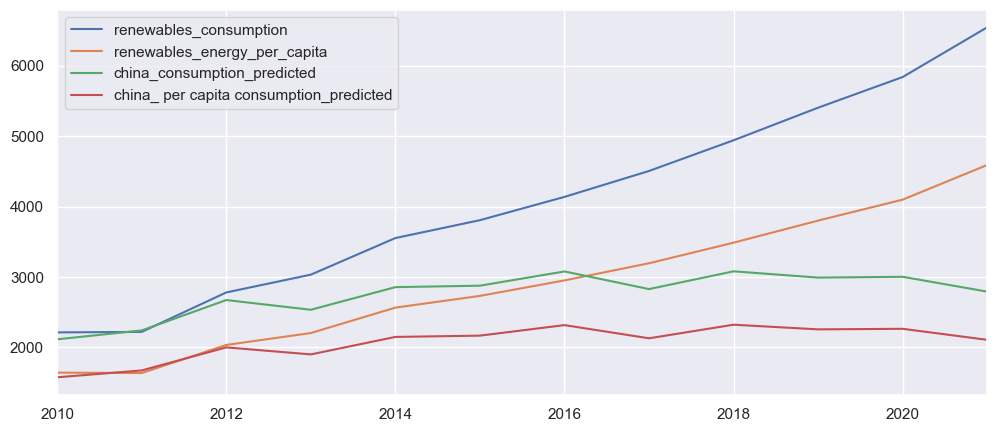

In [204]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_china,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [205]:
mean_absolute_percentage_error(y_true=test_var_china['renewables_consumption'],
                   y_pred=predictions['china_consumption_predicted'])

26.73536335256142

In [206]:
from sklearn.metrics import mean_squared_error
import math 
from statistics import mean

In [207]:
rmse_consumption=math.sqrt(mean_squared_error(predictions['china_consumption_predicted'],test_var_china['renewables_consumption']))
print('Mean value of consumption is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_china['renewables_consumption']),rmse_consumption))

Mean value of consumption is : 4081.151083333333. Root Mean Squared Error is :1755.2828212584527


## Forecasting the renewable consumption of China 

Out of all models.ARIMA(1,1,2) predicts with less error.So that model is used to forecast future consumption of china

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



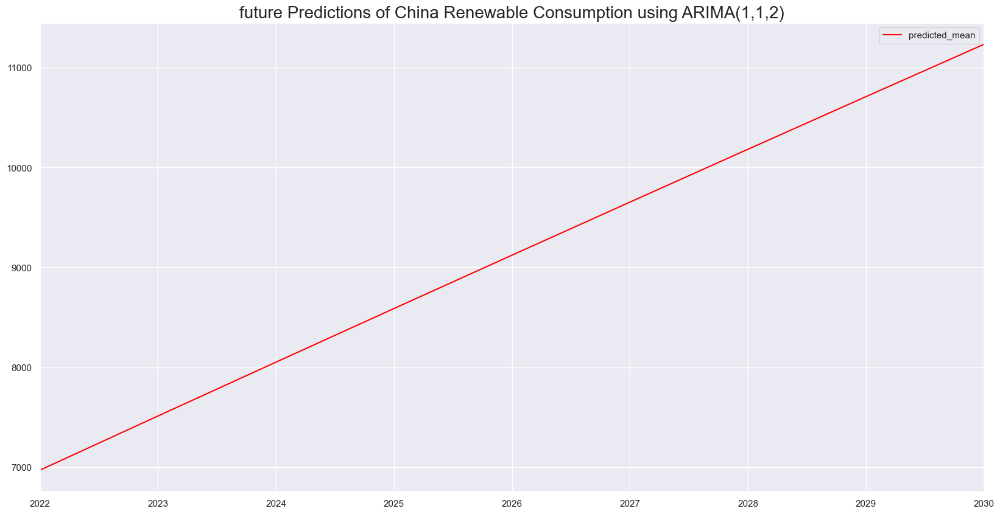

In [208]:
#let us fit the model with the whole dataset
model_AR_I_MA_112=ARIMA(df_china.renewables_consumption[1:],order=(1,1,2))
results_AR_I_MA_112=model_AR_I_MA_112.fit()
#Let us forecast the future consumption of china
df_china_Arima_112_forecast=results_AR_I_MA_112.predict(start="2022-01-01",end="2030-01-01")
#Let us visualise the predicted data
df_china_Arima_112_forecast.plot(figsize=(20,10),color="red",legend=True)
plt.title("future Predictions of China Renewable Consumption using ARIMA(1,1,2)",size=20)
plt.show()

In [209]:
df_china_Arima_112_forecast

2022-01-01     6967.999154
2023-01-01     7510.224022
2024-01-01     8049.891176
2025-01-01     8587.012682
2026-01-01     9121.600548
2027-01-01     9653.666724
2028-01-01    10183.223106
2029-01-01    10710.281533
2030-01-01    11234.853787
Freq: AS-JAN, Name: predicted_mean, dtype: float64

## 2. Predictions for renewable share 

In [210]:
df_world_var_2=df[['country','year','iso_code','renewables_share_energy','other_renewables_share_energy','nuclear_share_energy','fossil_share_energy']]
df_world_var_2.head()

,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
0,Afghanistan,1900,AFG,NaN,NaN,NaN,NaN
1,Afghanistan,1901,AFG,NaN,NaN,NaN,NaN
2,Afghanistan,1902,AFG,NaN,NaN,NaN,NaN
3,Afghanistan,1903,AFG,NaN,NaN,NaN,NaN
4,Afghanistan,1904,AFG,NaN,NaN,NaN,NaN


In [211]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_2_china=df_world_var_2[df_world_var_2['country'].isin(['China'])]
df_var_2_china

,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
4227,China,1900,CHN,NaN,NaN,NaN,NaN
4228,China,1901,CHN,NaN,NaN,NaN,NaN
4229,China,1902,CHN,NaN,NaN,NaN,NaN
4230,China,1903,CHN,NaN,NaN,NaN,NaN
4231,China,1904,CHN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
4344,China,2017,CHN,12.139,0.684,1.707,86.154
4345,China,2018,CHN,12.807,0.775,1.941,85.251
4346,China,2019,CHN,13.516,0.900,2.206,84.278
4347,China,2020,CHN,14.243,1.056,2.251,83.506


In [212]:
#dropping the null values corresponding to initial years of null data
df_var_2_china.dropna(inplace=True)
df_var_2_china.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3838749212.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
4344,China,2017,CHN,12.139,0.684,1.707,86.154
4345,China,2018,CHN,12.807,0.775,1.941,85.251
4346,China,2019,CHN,13.516,0.900,2.206,84.278
4347,China,2020,CHN,14.243,1.056,2.251,83.506
4348,China,2021,CHN,14.946,1.239,2.337,82.717


In [213]:
#Converting them into date time format with years format
df_var_2_china.year=pd.to_datetime(df_var_2_china.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2288882406.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [214]:
#Setting the year as index
df_var_2_china.set_index("year",inplace=True)
df_var_2_china.tail()

,country,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
year,,,,,,
2017-01-01,China,CHN,12.139,0.684,1.707,86.154
2018-01-01,China,CHN,12.807,0.775,1.941,85.251
2019-01-01,China,CHN,13.516,0.900,2.206,84.278
2020-01-01,China,CHN,14.243,1.056,2.251,83.506
2021-01-01,China,CHN,14.946,1.239,2.337,82.717


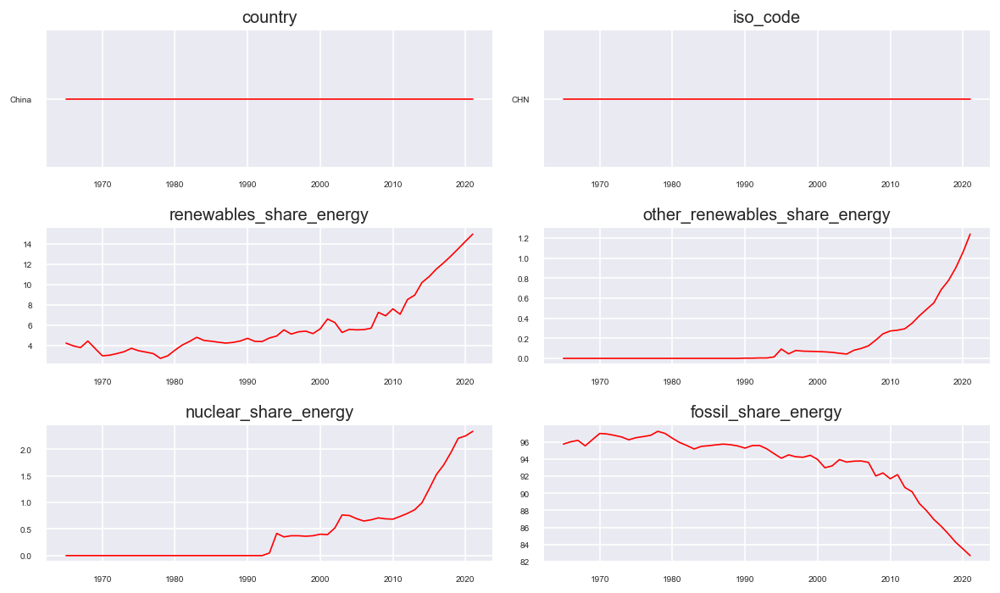

In [215]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=3, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_2_china[df_var_2_china.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_2_china.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

renewable and other renwables are having same kind of trend

In [216]:
#Let us check which time series is causing the other using granger casuality tests
print('	renewables_share_energy causes other_renewables_share_energy?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_2_china[['other_renewables_share_energy', 'renewables_share_energy']], 8)
print('\n other_renewables_share_energy causes renewables_share_energy?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_2_china[['renewables_share_energy', 'other_renewables_share_energy']], 8)

	renewables_share_energy causes other_renewables_share_energy?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.1094  , p=0.7421  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=0.1156  , p=0.7338  , df=1
likelihood ratio test: chi2=0.1155  , p=0.7340  , df=1
parameter F test:         F=0.1094  , p=0.7421  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.7033  , p=0.4998  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=1.5473  , p=0.4613  , df=2
likelihood ratio test: chi2=1.5259  , p=0.4663  , df=2
parameter F test:         F=0.7033  , p=0.4998  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.4562  , p=0.7141  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=1.5726  , p=0.6656  , df=3
likelihood ratio test: chi2=1.5501  , p=0.6707  , df=3
parameter F test:         F=0.4562  , p=0.7141  , df_denom=47, df_num=3

Granger Causalit

In [217]:
print('\n So Finally renewables_share_energy causes renewables_share_energy\n')
#Taking two of them into separate dataframe before fitting into model
df_var_2_china=df_var_2_china[['renewables_share_energy', 'other_renewables_share_energy']]
print(df_var_2_china.shape)


 So Finally renewables_share_energy causes renewables_share_energy

(57, 2)


In [218]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_2_china=df_var_2_china[:-12]
test_var_2_china=df_var_2_china[-12:]

In [219]:
#Taking the training data for modelling
model = VAR(train_var_2_china)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [220]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -6.603      -6.514    0.001356      -6.572
1       -9.233     -8.966*  9.788e-05*     -9.141*
2       -9.132      -8.688   0.0001085      -8.979
3       -9.001      -8.379   0.0001246      -8.786
4       -8.978      -8.178   0.0001292      -8.702
5       -8.775      -7.797   0.0001615      -8.437
6       -8.943      -7.788   0.0001408      -8.544
7       -9.023      -7.690   0.0001357      -8.563
8       -9.219      -7.709   0.0001185      -8.698
9       -9.453      -7.764   0.0001019      -8.870
10     -9.458*      -7.591   0.0001133      -8.813
--------------------------------------------------


Order '1' is having all low values

In [221]:
var_model = VARMAX(train_var_2_china, order=(1,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\varmax.py:374: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



                                                Statespace Model Results                                                
Dep. Variable:     ['renewables_share_energy', 'other_renewables_share_energy']   No. Observations:                   45
Model:                                                                   VAR(1)   Log Likelihood                  59.335
                                                                    + intercept   AIC                           -100.670
Date:                                                          Thu, 27 Jul 2023   BIC                            -84.410
Time:                                                                  12:48:16   HQIC                           -94.609
Sample:                                                              01-01-1965                                         
                                                                   - 01-01-2009                                         
Covariance Type:                

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [222]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [223]:
#Naming the columns of predicted results with suitable names
predictions.columns=['renewables_share_energy_predicted','other_renewables_share_energy_predicted']
predictions

,renewables_share_energy_predicted,other_renewables_share_energy_predicted
2010-01-01,8.233090,0.250371
2011-01-01,8.285075,0.221965
2012-01-01,7.812690,0.183768
2013-01-01,7.192987,0.147191
2014-01-01,6.604325,0.116725
2015-01-01,6.116098,0.093327
2016-01-01,5.742160,0.076341
2017-01-01,5.471262,0.064542
2018-01-01,5.283409,0.056651
2019-01-01,5.157956,0.051554


<Axes: >

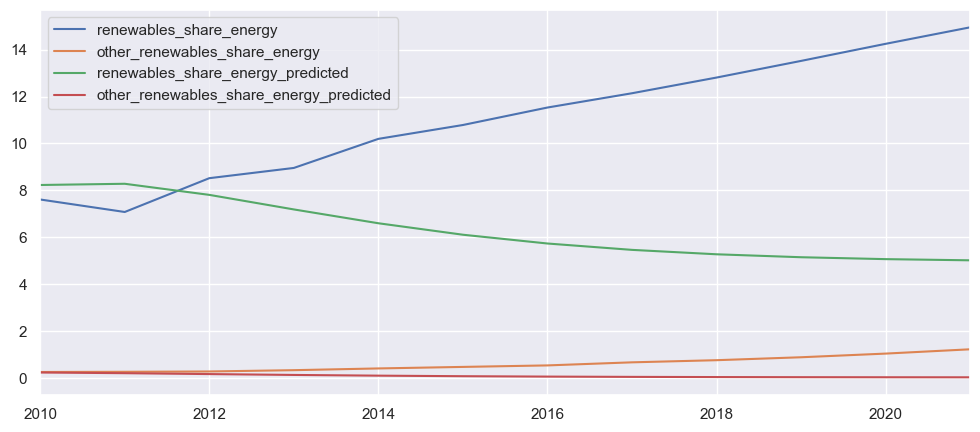

In [224]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_2_china,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [225]:
mean_absolute_percentage_error(y_true=test_var_2_china['renewables_share_energy'],
                   y_pred=predictions['renewables_share_energy_predicted'])

40.6728294646817

In [226]:
rmse_rshare=math.sqrt(mean_squared_error(predictions['renewables_share_energy_predicted'],test_var_2_china['renewables_share_energy']))
print('Mean value of renewable share is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_2_china['renewables_share_energy']),rmse_rshare))

Mean value of renewable share is : 11.029. Root Mean Squared Error is :5.965245300722325


## forecasting future renewable share 

Out of all four models, SARIMAX (0,2,1) is predicting better

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



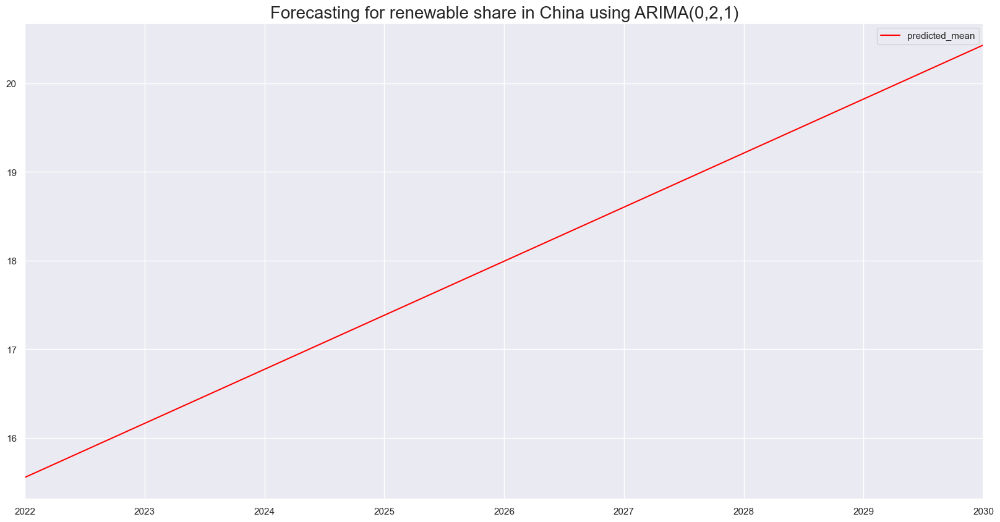

In [227]:
#Let us fit the model for wholedataset
model_Arima_021_rshare=ARIMA(df_china.renewables_share_energy[1:],order=(0,2,1))
model_Arima_021_rshare=model_Arima_021_rshare.fit()
#predicting the values for test dataset
start_date="2022-01-01"
end_date="2030-01-01"
df_china_Arima_021_predict_rshare=model_Arima_021_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_china_Arima_021_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Forecasting for renewable share in China using ARIMA(0,2,1)",size=20)
plt.show()

In [228]:
df_china_Arima_021_predict_rshare

2022-01-01    15.555613
2023-01-01    16.165227
2024-01-01    16.774840
2025-01-01    17.384453
2026-01-01    17.994067
2027-01-01    18.603680
2028-01-01    19.213293
2029-01-01    19.822907
2030-01-01    20.432520
Freq: AS-JAN, Name: predicted_mean, dtype: float64

## 3. Predictions for total energy 

In [229]:
df_world_var_3=df[['country','year','iso_code','primary_energy_consumption','renewables_consumption','nuclear_consumption','fossil_fuel_consumption']]
df_world_var_3.head()

,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
0,Afghanistan,1900,AFG,NaN,NaN,NaN,NaN
1,Afghanistan,1901,AFG,NaN,NaN,NaN,NaN
2,Afghanistan,1902,AFG,NaN,NaN,NaN,NaN
3,Afghanistan,1903,AFG,NaN,NaN,NaN,NaN
4,Afghanistan,1904,AFG,NaN,NaN,NaN,NaN


In [230]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_3_china=df_world_var_3[df_world_var_3['country'].isin(['China'])]
df_var_3_china

,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
4227,China,1900,CHN,NaN,NaN,NaN,NaN
4228,China,1901,CHN,NaN,NaN,NaN,NaN
4229,China,1902,CHN,NaN,NaN,NaN,NaN
4230,China,1903,CHN,NaN,NaN,NaN,NaN
4231,China,1904,CHN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
4344,China,2017,CHN,37112.145,4504.976,633.589,31973.576
4345,China,2018,CHN,38578.570,4940.909,748.955,32888.707
4346,China,2019,CHN,39978.492,5403.476,882.026,33692.988
4347,China,2020,CHN,40994.574,5838.805,922.889,34232.883


In [231]:
#dropping the null values corresponding to initial years of null data
df_var_3_china.dropna(inplace=True)
df_var_3_china.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1178169098.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
4344,China,2017,CHN,37112.145,4504.976,633.589,31973.576
4345,China,2018,CHN,38578.570,4940.909,748.955,32888.707
4346,China,2019,CHN,39978.492,5403.476,882.026,33692.988
4347,China,2020,CHN,40994.574,5838.805,922.889,34232.883
4348,China,2021,CHN,43790.895,6545.095,1023.213,36222.586


In [232]:
#Converting them into date time format with years format
df_var_3_china.year=pd.to_datetime(df_var_3_china.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\4123648916.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [233]:
#Setting the year as index
df_var_3_china.set_index("year",inplace=True)
df_var_3_china.tail()

,country,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
year,,,,,,
2017-01-01,China,CHN,37112.145,4504.976,633.589,31973.576
2018-01-01,China,CHN,38578.570,4940.909,748.955,32888.707
2019-01-01,China,CHN,39978.492,5403.476,882.026,33692.988
2020-01-01,China,CHN,40994.574,5838.805,922.889,34232.883
2021-01-01,China,CHN,43790.895,6545.095,1023.213,36222.586


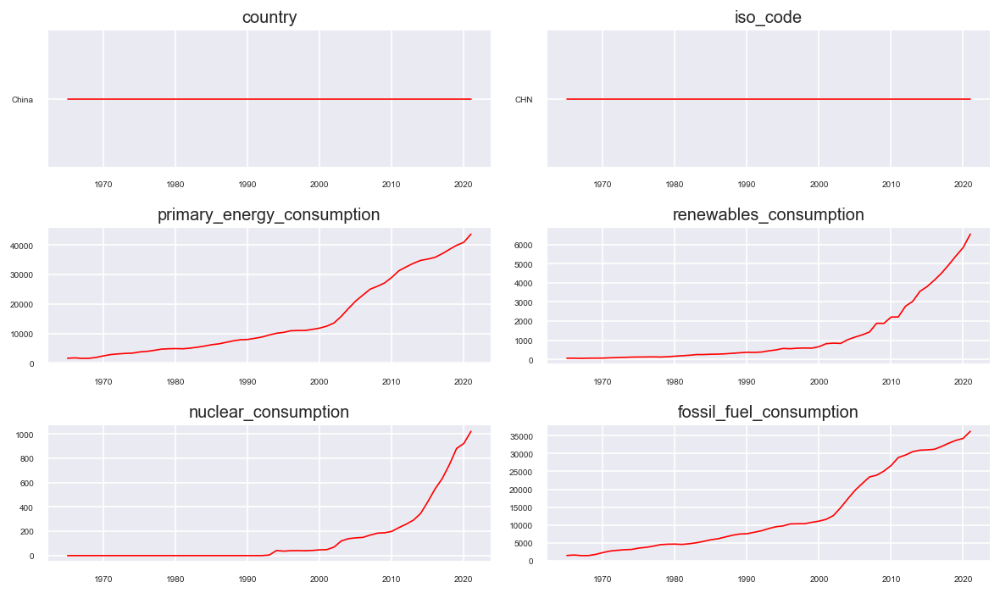

In [234]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=3, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_3_china[df_var_3_china.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_3_china.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

primary energy and fossil fuel consumption graphs are looking a like

In [235]:
#Let us check which time series is causing the other using granger casuality tests
print('primary_energy_consumption causes fossil_fuel_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_3_china[['fossil_fuel_consumption', 'primary_energy_consumption']], 8)
print('\n fossil_fuel_consumption causes primary_energy_consumption?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_3_china[['primary_energy_consumption', 'fossil_fuel_consumption']], 8)

primary_energy_consumption causes fossil_fuel_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=5.0347  , p=0.0290  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=5.3197  , p=0.0211  , df=1
likelihood ratio test: chi2=5.0820  , p=0.0242  , df=1
parameter F test:         F=5.0347  , p=0.0290  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.9689  , p=0.3865  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=2.1316  , p=0.3445  , df=2
likelihood ratio test: chi2=2.0913  , p=0.3515  , df=2
parameter F test:         F=0.9689  , p=0.3865  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=1.0670  , p=0.3721  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=3.6778  , p=0.2984  , df=3
likelihood ratio test: chi2=3.5580  , p=0.3133  , df=3
parameter F test:         F=1.0670  , p=0.3721  , df_denom=47, df_num=3

Granger Causality
nu

In [236]:
print('\n So Finally primary_energy_consumption causes fossil_fuel_consumption\n')
#Taking two of them into separate dataframe before fitting into model
df_var_3_china=df_var_3_china[['fossil_fuel_consumption', 'primary_energy_consumption']]
print(df_var_3_china.shape)


 So Finally primary_energy_consumption causes fossil_fuel_consumption

(57, 2)


In [237]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_3_china=df_var_3_china[:-12]
test_var_3_china=df_var_3_china[-12:]

In [238]:
#Taking the training data for modelling
model = VAR(train_var_3_china)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [239]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        26.43       26.52   3.011e+11       26.46
1        20.92       21.19   1.219e+09       21.01
2        19.75       20.19   3.777e+08       19.90
3        19.74       20.36   3.784e+08       19.96
4        19.76       20.56   3.893e+08       20.03
5        19.58       20.56   3.344e+08       19.92
6        18.81       19.96   1.586e+08       19.21
7        18.99       20.32   1.984e+08       19.45
8       18.35*      19.86*  1.113e+08*      18.87*
9        18.50       20.19   1.410e+08       19.09
10       18.72       20.58   1.948e+08       19.36
--------------------------------------------------


Order '8' is having all lower values

In [240]:
var_model = VARMAX(train_var_3_china, order=(8,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\varmax.py:374: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



                                               Statespace Model Results                                              
Dep. Variable:     ['fossil_fuel_consumption', 'primary_energy_consumption']   No. Observations:                   45
Model:                                                                VAR(8)   Log Likelihood               -1814.446
                                                                 + intercept   AIC                           3702.892
Date:                                                       Thu, 27 Jul 2023   BIC                           3769.739
Time:                                                               12:48:20   HQIC                          3727.812
Sample:                                                           01-01-1965                                         
                                                                - 01-01-2009                                         
Covariance Type:                                        

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [241]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [242]:
#Naming the columns of predicted results with suitable names
predictions.columns=['fossil_fuel_consumption_predicted','primary_energy_consumption_predicted']
predictions

,fossil_fuel_consumption_predicted,primary_energy_consumption_predicted
2010-01-01,37667.390689,39960.032990
2011-01-01,32301.206558,34419.060255
2012-01-01,38178.794834,40690.592819
2013-01-01,36468.508525,38900.947190
2014-01-01,38678.188958,41309.582928
2015-01-01,35214.370441,37741.552720
2016-01-01,39037.738214,41693.136979
2017-01-01,35275.717971,37606.051684
2018-01-01,36916.045395,39249.933735
2019-01-01,35027.097770,37250.340491


<Axes: >

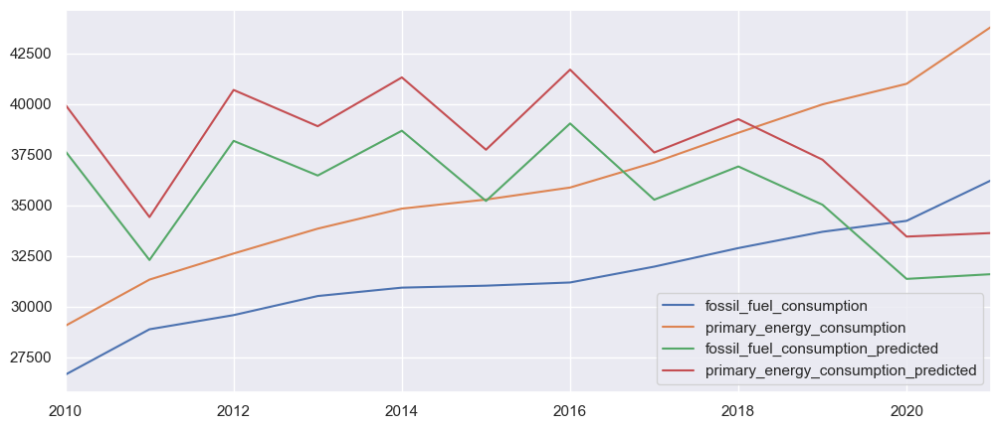

In [243]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_3_china,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [244]:
mean_absolute_percentage_error(y_true=test_var_3_china['primary_energy_consumption'],
                   y_pred=predictions['primary_energy_consumption_predicted'])

15.025452176294316

In [245]:
rmse_tenergy=math.sqrt(mean_squared_error(predictions['primary_energy_consumption_predicted'],test_var_3_china['primary_energy_consumption']))
print('Mean value of total energy is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_3_china['primary_energy_consumption']),rmse_tenergy))

Mean value of total energy is : 36108.831666666665. Root Mean Squared Error is :6252.509409610851


## Forecasting Total energy of China 

Out of all the four models,SARIMAX(0,2,0) is predicting well

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



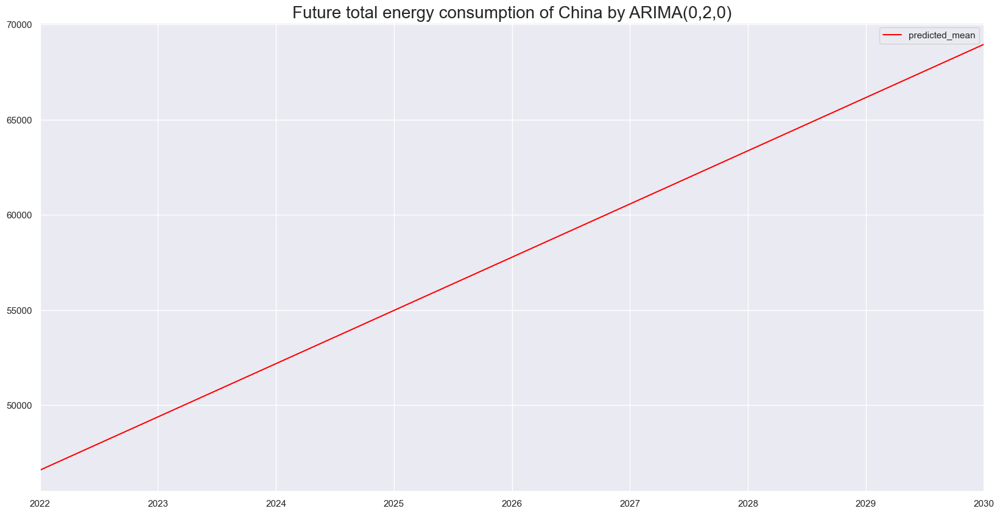

In [246]:
#Let us fit the model for whole dataset
model_Arima_020_tenergy=ARIMA(df_china.primary_energy_consumption[1:],order=(0,2,0))
model_Arima_020_tenergy=model_Arima_020_tenergy.fit()
#predicting the values for test dataset
start_date="2022-01-01"
end_date="2030-01-01"
df_china_Arima_020_predict_tenergy=model_Arima_020_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_china_Arima_020_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Future total energy consumption of China by ARIMA(0,2,0)",size=20)
plt.show()

In [247]:
df_china_Arima_020_predict_tenergy

2022-01-01    46587.216
2023-01-01    49383.537
2024-01-01    52179.858
2025-01-01    54976.179
2026-01-01    57772.500
2027-01-01    60568.821
2028-01-01    63365.142
2029-01-01    66161.463
2030-01-01    68957.784
Freq: AS-JAN, Name: predicted_mean, dtype: float64

# 2.Time Series analysis and Forecasting for "Unites States"

# Data Pre-Processing

In [248]:
#Taking the United States country data only for further analysis
df_usa=df_world_renw_1[df_world_renw['country'].isin(['United States'])]
df_usa

,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
20552,United States,1900,USA,NaN,NaN,NaN
20553,United States,1901,USA,NaN,NaN,NaN
20554,United States,1902,USA,NaN,NaN,NaN
20555,United States,1903,USA,NaN,NaN,NaN
20556,United States,1904,USA,NaN,NaN,NaN
...,...,...,...,...,...,...
20669,United States,2017,USA,2344.897,9.082,25819.031
20670,United States,2018,USA,2399.240,8.965,26762.473
20671,United States,2019,USA,2475.220,9.315,26571.660
20672,United States,2020,USA,2590.215,10.532,24593.223


In [249]:
#Checking whether there are any null values in dataset
df_usa.isnull().sum()

country                        0
year                           0
iso_code                       0
renewables_consumption        65
renewables_share_energy       65
primary_energy_consumption    65
dtype: int64

In [250]:
df_usa.dropna(inplace=True)
df_usa.head()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3248491163.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
20617,United States,1965,USA,630.852,4.369,14439.701
20618,United States,1966,USA,636.029,4.171,15247.363
20619,United States,1967,USA,716.695,4.542,15778.539
20620,United States,1968,USA,724.112,4.331,16719.385
20621,United States,1969,USA,808.640,4.599,17583.424


In [251]:
df_usa.year=pd.to_datetime(df_usa.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3312407765.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [252]:
df_usa_no_index=df_usa[['year','renewables_consumption']]
df_usa_no_index.head()

,year,renewables_consumption
20617,1965-01-01,630.852
20618,1966-01-01,636.029
20619,1967-01-01,716.695
20620,1968-01-01,724.112
20621,1969-01-01,808.640


In [253]:
df_usa_No_index_rshare=df_usa[['year','renewables_share_energy']]
df_usa_No_index_rshare.head()

,year,renewables_share_energy
20617,1965-01-01,4.369
20618,1966-01-01,4.171
20619,1967-01-01,4.542
20620,1968-01-01,4.331
20621,1969-01-01,4.599


In [254]:
df_usa_No_index_tenergy=df_usa[['year','primary_energy_consumption']]
df_usa_No_index_tenergy.head()

,year,primary_energy_consumption
20617,1965-01-01,14439.701
20618,1966-01-01,15247.363
20619,1967-01-01,15778.539
20620,1968-01-01,16719.385
20621,1969-01-01,17583.424


In [255]:
df_usa.set_index("year",inplace=True)
df_usa.head()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
year,,,,,
1965-01-01,United States,USA,630.852,4.369,14439.701
1966-01-01,United States,USA,636.029,4.171,15247.363
1967-01-01,United States,USA,716.695,4.542,15778.539
1968-01-01,United States,USA,724.112,4.331,16719.385
1969-01-01,United States,USA,808.640,4.599,17583.424


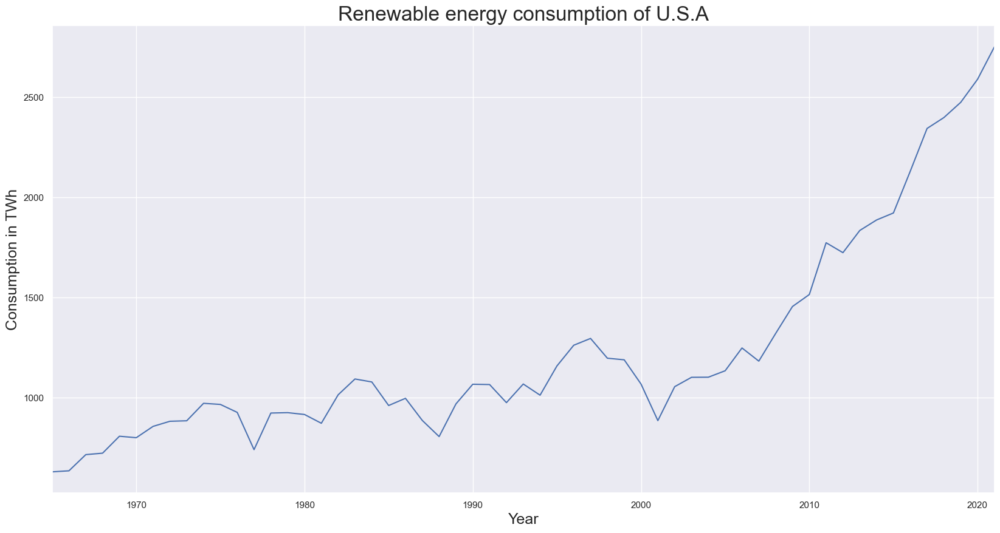

In [256]:
df_usa.renewables_consumption.plot(figsize=(20,10))
plt.title("Renewable energy consumption of U.S.A",size=24)
plt.ylabel("Consumption in TWh",size=18)
plt.xlabel("Year",size=18)
plt.show()

# Seasonality Check

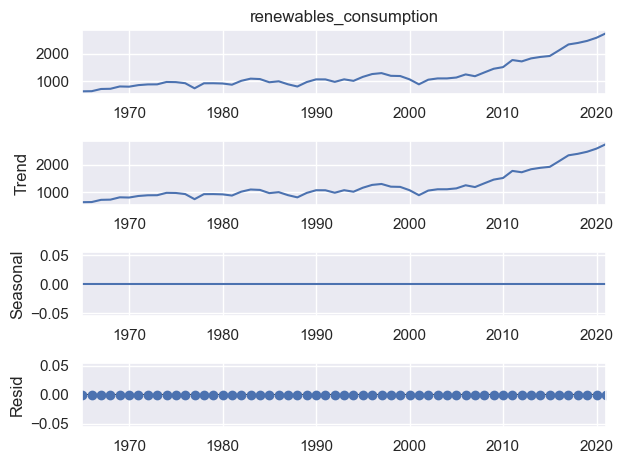

In [257]:
seas_decompose_additive_usa= seasonal_decompose(df_usa.renewables_consumption,model="additive")
seas_decompose_additive_usa.plot()
plt.show()

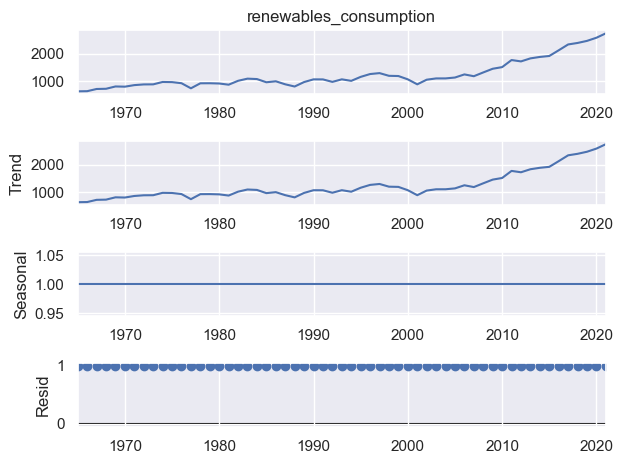

In [258]:
seas_decompose_multiplicative_usa= seasonal_decompose(df_usa.renewables_consumption,model="multiplicative",period=1)
seas_decompose_multiplicative_usa.plot()
plt.show()

# Stationarity Check

In [259]:
result = adfuller(df_usa.renewables_consumption)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - USA Time Series is Stationary")
else:
    print ("Failed to Reject Ho - USA Time Series is Non-Stationary")

ADF Statistic: 2.129344
p-value: 0.998819
Critical Values:
	1%: -3.553
	5%: -2.915
	10%: -2.595
Failed to Reject Ho - USA Time Series is Non-Stationary


In [260]:
#Lets Fit ARIMA Model As it is a Non-stationary Data
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_usa=ARIMA(df_usa.renewables_consumption[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_usa=model_AR_I_MA_111_usa.fit()
#print the summary of model results
results_AR_I_MA_111_usa.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     renewables_consumption   No. Observations:                   56
Model:                     ARIMA(1, 1, 1)   Log Likelihood                -330.886
Date:                    Thu, 27 Jul 2023   AIC                            667.771
Time:                            12:48:23   BIC                            673.793
Sample:                        01-01-1966   HQIC                           670.100
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9813      0.077     12.737      0.000       0.830       1.132
ma.L1         -0.8827      0.121     -7.267      0.000      -1.121      -0.645
sigma2      9706.6217   2179.574      4.453      0.000    5434.736     1.4e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.44   Jarque-Bera (JB):                 0.56
Prob(Q):                              0.51   Prob(JB):                         0.76
Heteroskedasticity (H):               1.40   Skew:                            -0.01
Prob(H) (two-sided):                  0.48   Kurtosis:                         2.51
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3451530193.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



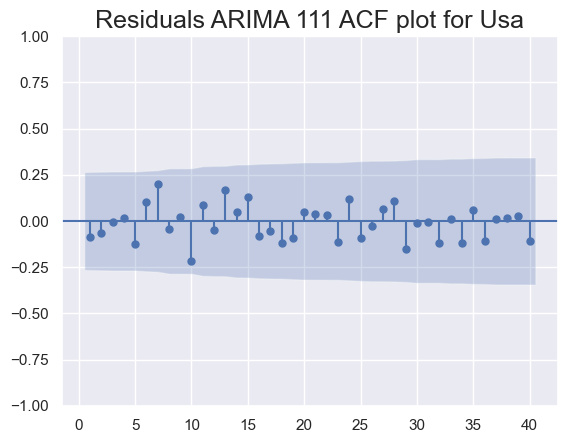

In [261]:
#All coefiicients are significant,Lets see Residuals plot to check whether any higher lags are significant
df_usa['residuals_ARIMA_111_usa']=results_AR_I_MA_111_usa.resid
sgt.plot_acf(df_usa.residuals_ARIMA_111_usa[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for Usa",size=18)
plt.show()

 Same here also,So we can conclude that ARIMA(1,1,1) is best for this time series.

In [262]:
#We have decided No higher lags are significant ,before conclusing lets check whether it is stationary or not
df_usa['usa_ren_consumption']=df_usa.renewables_consumption.diff(1)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1798808586.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [263]:
#To comapre ARIMA 111 results with manually integrated time series ,performing arma 11 for integrated series
#As Arima(1,0,1) should equal to Arma(1,1) of manully integrated series
#All of this are doing to check after the first integration whether the series is statioanry or not
model_AR_I_MA_101_usa=ARIMA(df_usa.usa_ren_consumption[2:],order=(1,0,1))
results_AR_I_MA_101_usa=model_AR_I_MA_101_usa.fit()
results_AR_I_MA_101_usa.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                SARIMAX Results                                
===============================================================================
Dep. Variable:     usa_ren_consumption   No. Observations:                   55
Model:                  ARIMA(1, 0, 1)   Log Likelihood                -329.892
Date:                 Thu, 27 Jul 2023   AIC                            667.783
Time:                         12:48:23   BIC                            675.812
Sample:                     01-01-1967   HQIC                           670.888
                          - 01-01-2021                                         
Covariance Type:                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         43.8976     40.425      1.086      0.278     -35.334     123.129
ar.L1          0.9214      0.313      2.941      0.003       0.307       1.535
ma.L1         -0.8493      0.350     -2.429      0.015      -1.535      -0.164
sigma2      9472.3833   2094.879      4.522      0.000    5366.497    1.36e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.19   Jarque-Bera (JB):                 0.52
Prob(Q):                              0.66   Prob(JB):                         0.77
Heteroskedasticity (H):               1.31   Skew:                            -0.04
Prob(H) (two-sided):                  0.57   Kurtosis:                         2.53
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [264]:
result = adfuller(df_usa.usa_ren_consumption[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -6.940882
p-value: 0.000000
Critical Values:
	1%: -3.555
	5%: -2.916
	10%: -2.596
Reject Ho - Time Series is Stationary


Yes ,First integration is enough the time series is stationary,No need to go for higher integration orders.So,It can be concluded that ARIMA(1,1,1) is the best model

# Predictions using ARIMA(1,1,1)

In [265]:
#defining 'size' variable to find out cut off point while splitting the data
#This is time series ,so shuffling data is impossible.,there is a need to start testing  from where training have stopped
size_usa=int(len(df_usa)*0.8)
size_usa

45

In [266]:
df_usa_train=df_usa.iloc[:size_usa]
df_usa_test=df_usa.iloc[size_usa:]

In [267]:
#let us check the ending year of training dataset ,so that starting date can be put as next year
df_usa_train.tail()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption,residuals_ARIMA_111_usa,usa_ren_consumption
year,,,,,,,
2005-01-01,United States,USA,1135.401,4.219,26910.133,28.394550,32.195
2006-01-01,United States,USA,1249.168,4.679,26698.119,107.236914,113.767
2007-01-01,United States,USA,1183.502,4.373,27063.787,-82.650812,-65.666
2008-01-01,United States,USA,1321.477,5.005,26405.516,129.458703,137.975
2009-01-01,United States,USA,1456.122,5.800,25105.531,113.519666,134.645


In [342]:
df_usa_test.head()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption,residuals_ARIMA_111_usa,usa_ren_consumption
year,,,,,,,
2010-01-01,United States,USA,1515.733,5.841,25951.865,27.684005,59.611
2011-01-01,United States,USA,1774.409,6.897,25726.064,224.614448,258.676
2012-01-01,United States,USA,1724.880,6.886,25047.865,-105.107265,-49.529
2013-01-01,United States,USA,1835.576,7.135,25727.750,66.520840,110.696
2014-01-01,United States,USA,1888.077,7.263,25996.219,2.589663,52.501


C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



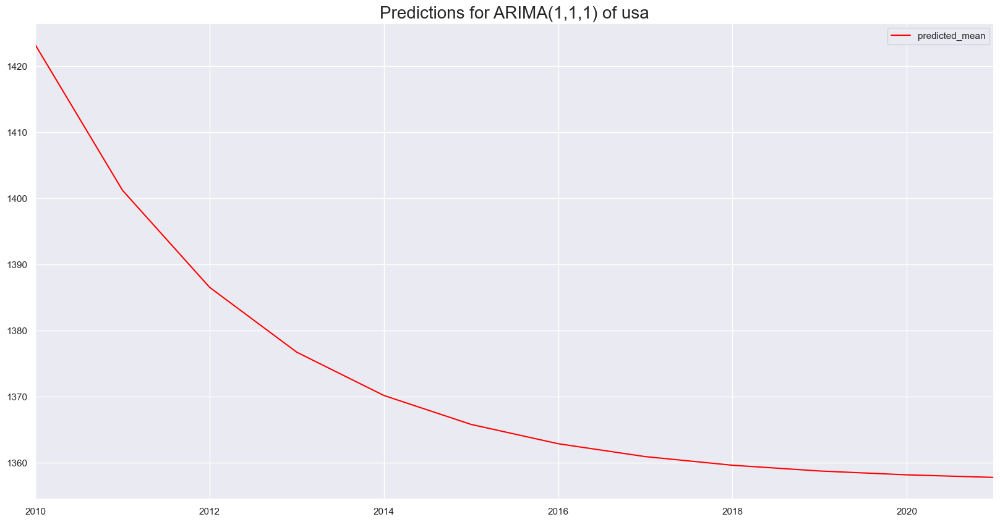

In [269]:
#Let us fit the model for only training dataset
model_Arima_111_usa=ARIMA(df_usa_train.renewables_consumption[1:],order=(1,1,1))
model_Arima_111_usa=model_Arima_111_usa.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_usa_Arima_111_predict=model_Arima_111_usa.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_usa_Arima_111_predict[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for ARIMA(1,1,1) of usa",size=20)
plt.show()

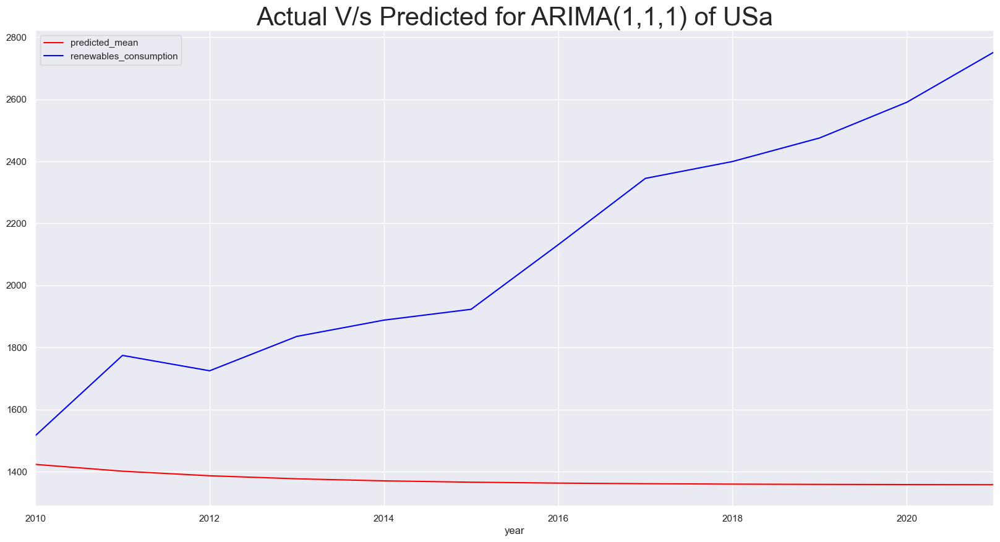

In [270]:
#Let us compare the test data and predicted values
df_usa_Arima_111_predict.plot(figsize=(20,10),color="red",legend=True)
df_usa_test.renewables_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for ARIMA(1,1,1) of USa",size=30)
plt.show()

In [271]:
rmse_111_usa=sqrt(mean_squared_error(df_usa_Arima_111_predict,df_usa_test['renewables_consumption']))
mse_111_usa=mean_squared_error(df_usa_Arima_111_predict,df_usa_test['renewables_consumption'])
mae_usa = np.mean(np.abs(df_usa_Arima_111_predict  - df_usa_test['renewables_consumption']))
print("Root Mean Squared Error for ARIMA(1,1,1): ",rmse_111_usa)
print("Mean Squared Error for ARIMA(1,1,1): ",mse_111_usa)
print("Mean absolute Error for ARIMA(1,1,1): ",mae_usa)

Root Mean Squared Error for ARIMA(1,1,1):  836.6129933539348
Mean Squared Error for ARIMA(1,1,1):  699921.300648631
Mean absolute Error for ARIMA(1,1,1):  739.38585789572


In [272]:
mean_absolute_percentage_error(y_true=df_usa_test['renewables_consumption'],
                   y_pred=df_usa_Arima_111_predict)

32.7361171170818

# 2.Predictions for Renewable share

In [273]:
df_usa_rshare=df_usa[['renewables_share_energy']]
df_usa_rshare.head()

,renewables_share_energy
year,
1965-01-01,4.369
1966-01-01,4.171
1967-01-01,4.542
1968-01-01,4.331
1969-01-01,4.599


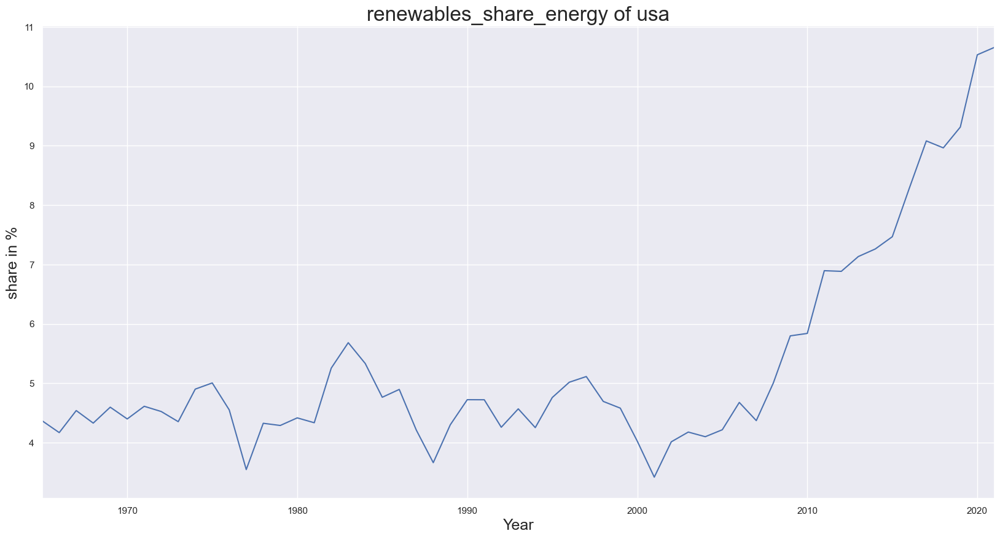

In [274]:
df_usa.renewables_share_energy.plot(figsize=(20,10))
plt.title("renewables_share_energy of usa",size=24)
plt.ylabel("share in %",size=18)
plt.xlabel("Year",size=18)
plt.show()

## Seasonality Checking

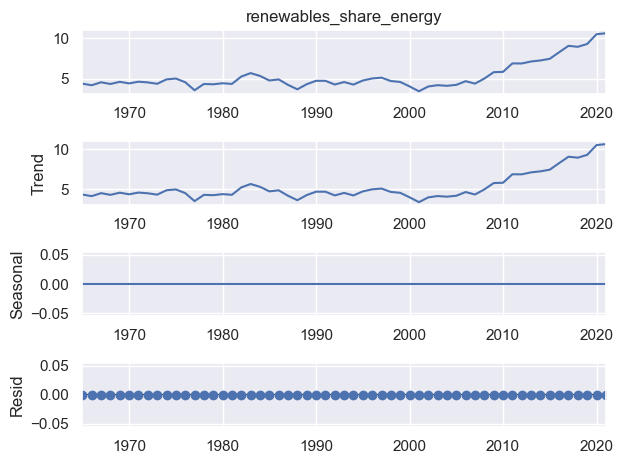

In [275]:
seas_decompose_additive= seasonal_decompose(df_usa.renewables_share_energy,model="additive")
seas_decompose_additive.plot()
plt.show()

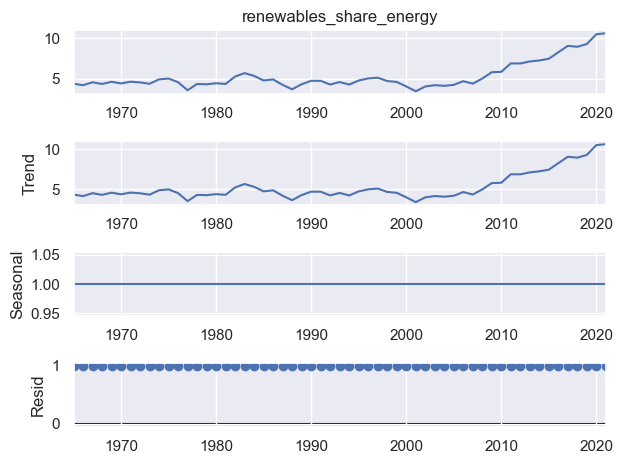

In [276]:
seas_decompose_multiplicative= seasonal_decompose(df_usa.renewables_share_energy,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

From both the methods it is clear that,there is no proof of seasonality

In [277]:
result = adfuller(df_usa.renewables_share_energy)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - usa Time Series is Stationary")
else:
    print ("Failed to Reject Ho - usa Time Series is Non-Stationary")

ADF Statistic: 1.487814
p-value: 0.997479
Critical Values:
	1%: -3.553
	5%: -2.915
	10%: -2.595
Failed to Reject Ho - usa Time Series is Non-Stationary


## ARIMA 

In [278]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_rshare=ARIMA(df_usa.renewables_share_energy[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_rshare=model_AR_I_MA_111_rshare.fit()
#print the summary of model results
results_AR_I_MA_111_rshare.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     renewables_share_energy   No. Observations:                   56
Model:                      ARIMA(1, 1, 1)   Log Likelihood                 -37.844
Date:                     Thu, 27 Jul 2023   AIC                             81.688
Time:                             12:48:26   BIC                             87.710
Sample:                         01-01-1966   HQIC                            84.016
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2157      1.493     -0.144      0.885      -3.142       2.711
ma.L1          0.3197      1.465      0.218      0.827      -2.553       3.192
sigma2         0.2318      0.049      4.772      0.000       0.137       0.327
===================================================================================
Ljung-Box (L1) (Q):                   0.15   Jarque-Bera (JB):                 0.75
Prob(Q):                              0.70   Prob(JB):                         0.69
Heteroskedasticity (H):               1.39   Skew:                             0.16
Prob(H) (two-sided):                  0.49   Kurtosis:                         2.52
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3090293214.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



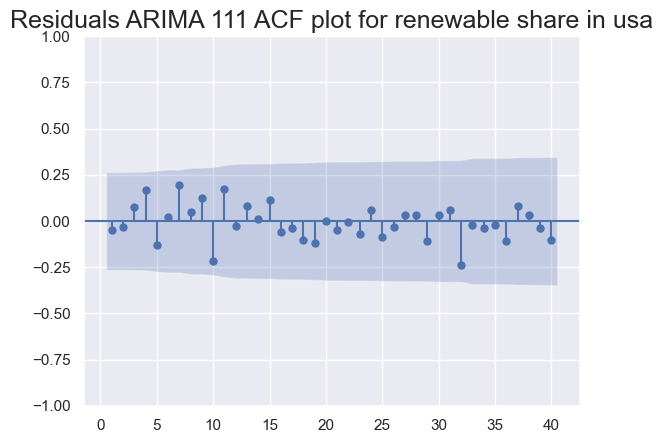

In [279]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_usa['residuals_ARIMA_111_rshare']=results_AR_I_MA_111_rshare.resid
sgt.plot_acf(df_usa.residuals_ARIMA_111_rshare[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for renewable share in usa",size=18)
plt.show()

## Checking Stationarity

In [280]:
df_usa['usa_renewables_share_energy_1']=df_usa.renewables_share_energy.diff(1)
model_AR_I_MA_101_usa=ARIMA(df_usa.usa_renewables_share_energy_1[2:],order=(1,0,1))
results_AR_I_MA_101_usa=model_AR_I_MA_101_usa.fit()
results_AR_I_MA_101_usa.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2818590485.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non

<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:     usa_renewables_share_energy_1   No. Observations:                   55
Model:                            ARIMA(1, 0, 1)   Log Likelihood                 -36.345
Date:                           Thu, 27 Jul 2023   AIC                             80.689
Time:                                   12:48:26   BIC                             88.719
Sample:                               01-01-1967   HQIC                            83.794
                                    - 01-01-2021                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.1180      0.076      1.562      0.118      -0.030       0.266
ar.L1         -0.3661      2.112     -0.173      0.862      -4.506       3.774
ma.L1          0.4298      2.058      0.209      0.835      -3.605       4.464
sigma2         0.2195      0.051      4.346      0.000       0.121       0.318
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):                 0.52
Prob(Q):                              0.92   Prob(JB):                         0.77
Heteroskedasticity (H):               1.13   Skew:                             0.12
Prob(H) (two-sided):                  0.80   Kurtosis:                         2.58
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [281]:
result = adfuller(df_usa.usa_renewables_share_energy_1[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -7.023830
p-value: 0.000000
Critical Values:
	1%: -3.555
	5%: -2.916
	10%: -2.596
Reject Ho - Time Series is Stationary


Therefore ARIMA(1,1,1) model is enough,as one differentiation made it stationary.

## Predicting Using ARIMA (1,1,1) 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



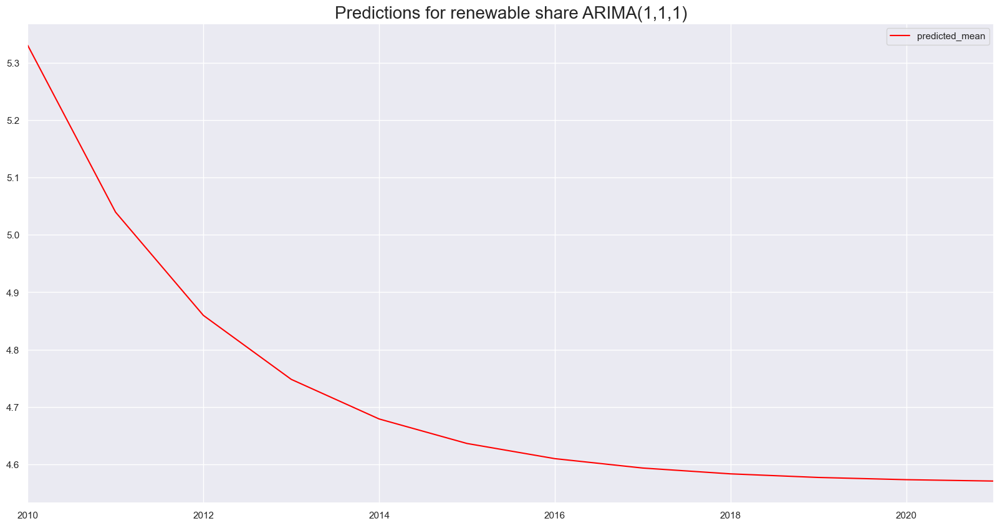

In [282]:
#Let us fit the model for only training dataset
model_Arima_111_rshare=ARIMA(df_usa_train.renewables_share_energy[1:],order=(1,1,1))
model_Arima_111_rshare=model_Arima_111_rshare.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_usa_Arima_111_predict_rshare=model_Arima_111_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_usa_Arima_111_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for renewable share ARIMA(1,1,1)",size=20)
plt.show()

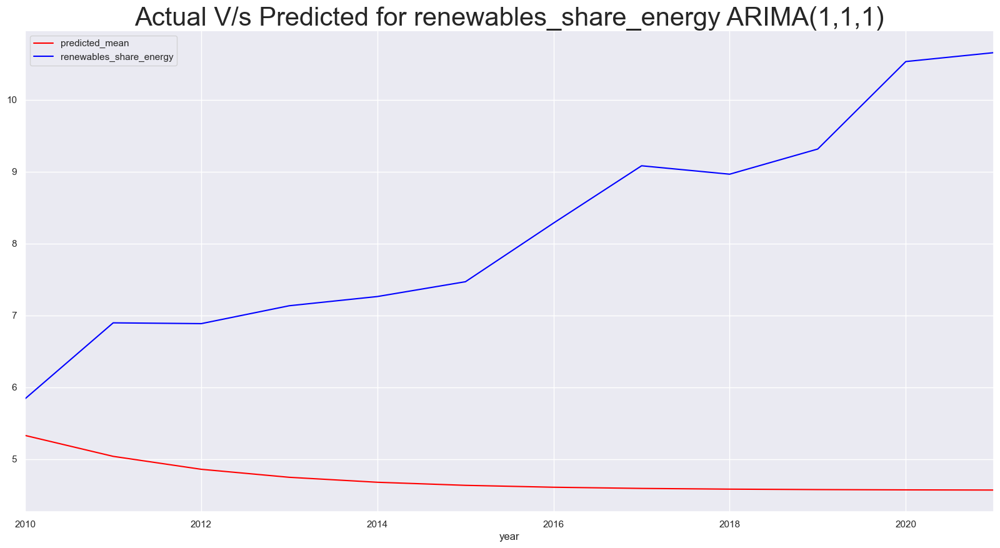

In [283]:
#Let us compare the test data and predicted values
df_usa_Arima_111_predict_rshare.plot(figsize=(20,10),color="red",legend=True)
df_usa_test.renewables_share_energy.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for renewables_share_energy ARIMA(1,1,1)",size=30)
plt.show()

In [284]:
rmse=sqrt(mean_squared_error(df_usa_Arima_111_predict_rshare,df_usa_test['renewables_share_energy']))
print(rmse)

3.8302929761354454


In [285]:
mean_absolute_percentage_error(y_true=df_usa_test['renewables_share_energy'],
                   y_pred=df_usa_Arima_111_predict_rshare)

39.93866898739996

## 3. Total energy predicting 

In [286]:
df_usa_tenergy=df_usa[['primary_energy_consumption']]
df_usa_tenergy.head()

,primary_energy_consumption
year,
1965-01-01,14439.701
1966-01-01,15247.363
1967-01-01,15778.539
1968-01-01,16719.385
1969-01-01,17583.424


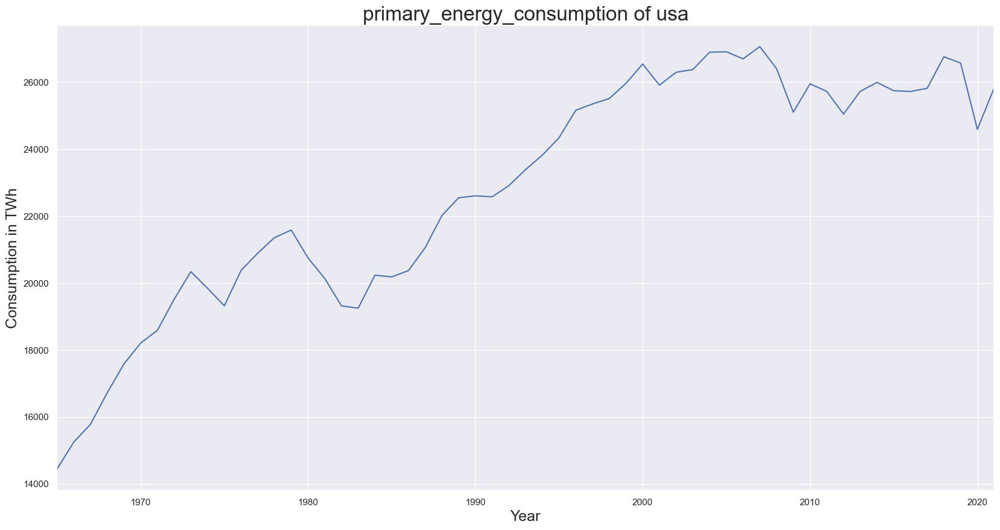

In [287]:
df_usa.primary_energy_consumption.plot(figsize=(20,10))
plt.title("primary_energy_consumption of usa",size=24)
plt.ylabel("Consumption in TWh",size=18)
plt.xlabel("Year",size=18)
plt.show()

## Seasonality Checking

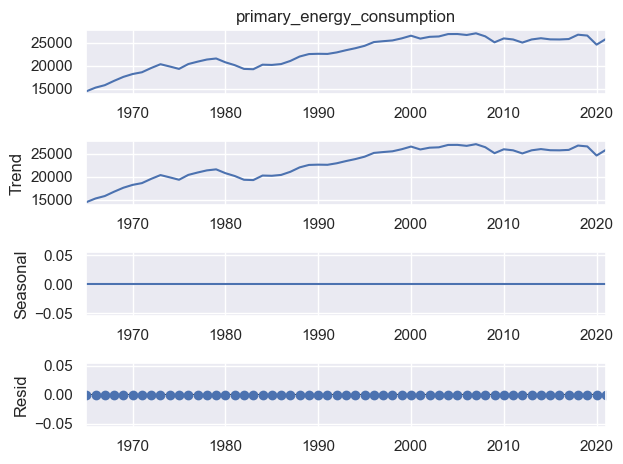

In [288]:
seas_decompose_additive= seasonal_decompose(df_usa.primary_energy_consumption,model="additive")
seas_decompose_additive.plot()
plt.show()

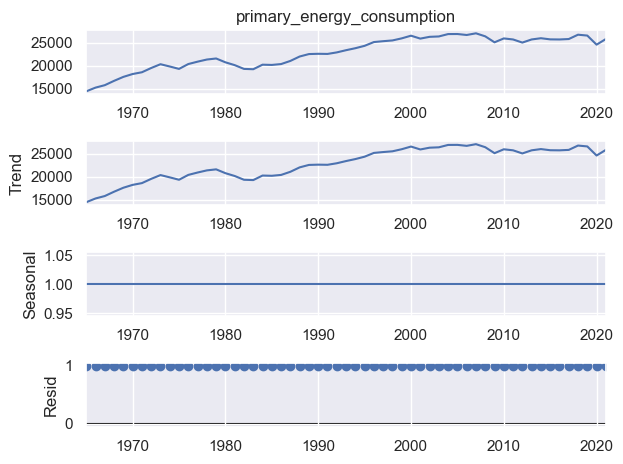

In [289]:
seas_decompose_multiplicative= seasonal_decompose(df_usa.primary_energy_consumption,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

From both the methods it is clear that,there is no proof of seasonality

In [290]:
result = adfuller(df_usa.primary_energy_consumption)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - usa Time Series is Stationary")
else:
    print ("Failed to Reject Ho - usa Time Series is Non-Stationary")

ADF Statistic: -2.740704
p-value: 0.067256
Critical Values:
	1%: -3.553
	5%: -2.915
	10%: -2.595
Failed to Reject Ho - usa Time Series is Non-Stationary


## ARIMA 

In [291]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_tenergy=ARIMA(df_usa.primary_energy_consumption[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_tenergy=model_AR_I_MA_111_tenergy.fit()
#print the summary of model results
results_AR_I_MA_111_tenergy.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                   SARIMAX Results                                    
======================================================================================
Dep. Variable:     primary_energy_consumption   No. Observations:                   56
Model:                         ARIMA(1, 1, 1)   Log Likelihood                -432.111
Date:                        Thu, 27 Jul 2023   AIC                            870.223
Time:                                12:48:29   BIC                            876.245
Sample:                            01-01-1966   HQIC                           872.552
                                 - 01-01-2021                                         
Covariance Type:                          opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9274      0.071     13.087      0.000       0.789       1.066
ma.L1         -0.8485      0.119     -7.117      0.000      -1.082      -0.615
sigma2      3.976e+05   6.77e+04      5.870      0.000    2.65e+05     5.3e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.06   Jarque-Bera (JB):                 7.68
Prob(Q):                              0.80   Prob(JB):                         0.02
Heteroskedasticity (H):               1.75   Skew:                            -0.76
Prob(H) (two-sided):                  0.25   Kurtosis:                         4.03
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3856808510.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



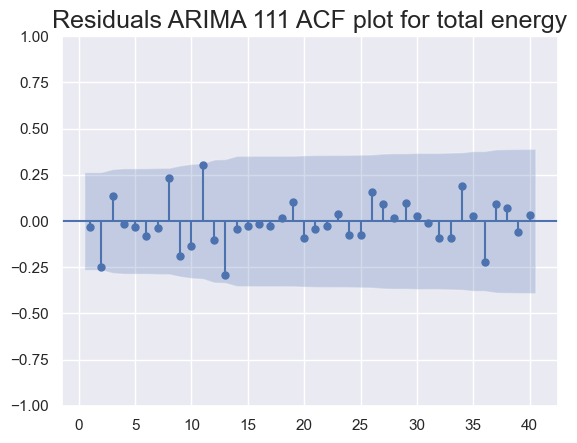

In [292]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_usa['residuals_ARIMA_111_tenergy']=results_AR_I_MA_111_tenergy.resid
sgt.plot_acf(df_usa.residuals_ARIMA_111_tenergy[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for total energy",size=18)
plt.show()

## Checking Stationarity

In [293]:
df_usa['usa_primary_energy_consumption_1']=df_usa.primary_energy_consumption.diff(1)
model_AR_I_MA_101_usa=ARIMA(df_usa.usa_primary_energy_consumption_1[2:],order=(1,0,1))
results_AR_I_MA_101_usa=model_AR_I_MA_101_usa.fit()
results_AR_I_MA_101_usa.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\4035580769.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                       
============================================================================================
Dep. Variable:     usa_primary_energy_consumption_1   No. Observations:                   55
Model:                               ARIMA(1, 0, 1)   Log Likelihood                -430.761
Date:                              Thu, 27 Jul 2023   AIC                            869.522
Time:                                      12:48:29   BIC                            877.551
Sample:                                  01-01-1967   HQIC                           872.627
                                       - 01-01-2021                                         
Covariance Type:                                opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        194.9802    116.113      1.679      0.093     -32.597     422.558
ar.L1         -0.4972      0.257     -1.932      0.053      -1.002       0.007
ma.L1          0.7615      0.225      3.380      0.001       0.320       1.203
sigma2      3.713e+05   7.31e+04      5.078      0.000    2.28e+05    5.15e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.32   Jarque-Bera (JB):                 3.50
Prob(Q):                              0.57   Prob(JB):                         0.17
Heteroskedasticity (H):               1.89   Skew:                            -0.55
Prob(H) (two-sided):                  0.19   Kurtosis:                         3.55
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [294]:
result = adfuller(df_usa.usa_primary_energy_consumption_1[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -2.419968
p-value: 0.136180
Critical Values:
	1%: -3.578
	5%: -2.925
	10%: -2.601
Failed to Reject Ho - Time Series is Non-Stationary


In [295]:
df_usa['usa_primary_energy_consumption_2']=df_usa.primary_energy_consumption.diff(2)
model_AR_I_MA_101_usa=ARIMA(df_usa.usa_primary_energy_consumption_2[2:],order=(1,0,1))
results_AR_I_MA_101_usa=model_AR_I_MA_101_usa.fit()
results_AR_I_MA_101_usa.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1108077907.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                       
============================================================================================
Dep. Variable:     usa_primary_energy_consumption_2   No. Observations:                   55
Model:                               ARIMA(1, 0, 1)   Log Likelihood                -434.980
Date:                              Thu, 27 Jul 2023   AIC                            877.959
Time:                                      12:48:29   BIC                            885.988
Sample:                                  01-01-1967   HQIC                           881.064
                                       - 01-01-2021                                         
Covariance Type:                                opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        381.2607    239.176      1.594      0.111     -87.515     850.036
ar.L1          0.0739      0.161      0.459      0.646      -0.242       0.389
ma.L1          0.9986      4.972      0.201      0.841      -8.746      10.743
sigma2      4.021e+05   1.97e+06      0.204      0.838   -3.45e+06    4.26e+06
===================================================================================
Ljung-Box (L1) (Q):                   0.02   Jarque-Bera (JB):                12.45
Prob(Q):                              0.90   Prob(JB):                         0.00
Heteroskedasticity (H):               1.64   Skew:                            -0.95
Prob(H) (two-sided):                  0.30   Kurtosis:                         4.34
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [296]:
result = adfuller(df_usa.usa_primary_energy_consumption_2[2:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -2.918834
p-value: 0.043201
Critical Values:
	1%: -3.593
	5%: -2.932
	10%: -2.604
Failed to Reject Ho - Time Series is Non-Stationary


In [297]:
df_usa['usa_primary_energy_consumption_3']=df_usa.primary_energy_consumption.diff(3)
model_AR_I_MA_101_usa=ARIMA(df_usa.usa_primary_energy_consumption_3[2:],order=(1,0,1))
results_AR_I_MA_101_usa=model_AR_I_MA_101_usa.fit()
results_AR_I_MA_101_usa.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\517598919.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                       
============================================================================================
Dep. Variable:     usa_primary_energy_consumption_3   No. Observations:                   55
Model:                               ARIMA(1, 0, 1)   Log Likelihood                -426.643
Date:                              Thu, 27 Jul 2023   AIC                            861.287
Time:                                      12:48:29   BIC                            869.316
Sample:                                  01-01-1967   HQIC                           864.392
                                       - 01-01-2021                                         
Covariance Type:                                opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        583.7916    320.666      1.821      0.069     -44.702    1212.285
ar.L1          0.6242      0.140      4.463      0.000       0.350       0.898
ma.L1          0.4630      0.155      2.987      0.003       0.159       0.767
sigma2      4.026e+05    8.8e+04      4.574      0.000     2.3e+05    5.75e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.09   Jarque-Bera (JB):                 1.56
Prob(Q):                              0.76   Prob(JB):                         0.46
Heteroskedasticity (H):               1.10   Skew:                            -0.40
Prob(H) (two-sided):                  0.85   Kurtosis:                         2.79
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [298]:
result = adfuller(df_usa.usa_primary_energy_consumption_3[3:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -3.097744
p-value: 0.026721
Critical Values:
	1%: -3.597
	5%: -2.933
	10%: -2.605
Reject Ho - Time Series is Stationary


So ARIMA (1,3,1) would be best suited statastical model.

## Predicting Using ARIMA (1,3,1) 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



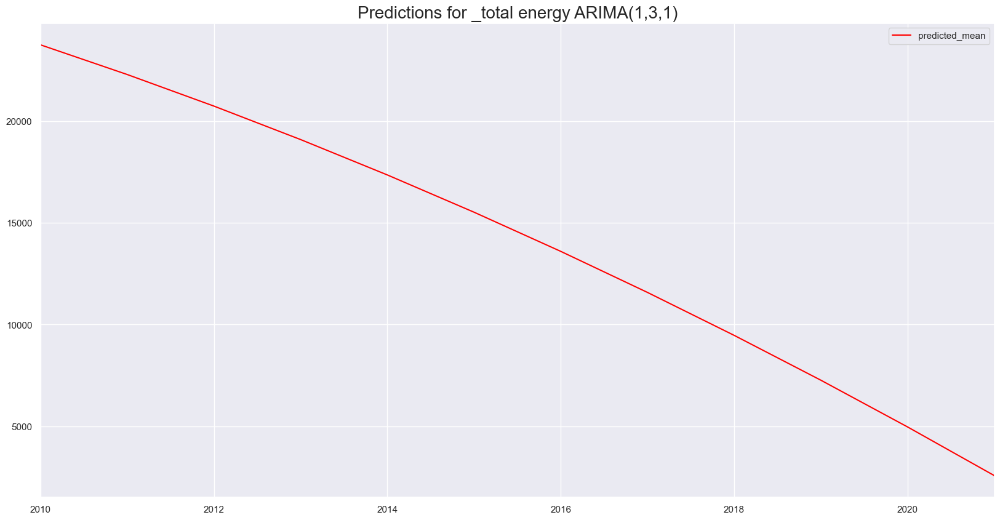

In [299]:
#Let us fit the model for only training dataset
model_Arima_131_tenergy=ARIMA(df_usa_train.primary_energy_consumption[1:],order=(1,3,1))
model_Arima_131_tenergy=model_Arima_131_tenergy.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_usa_Arima_131_predict_tenergy=model_Arima_131_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_usa_Arima_131_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for _total energy ARIMA(1,3,1)",size=20)
plt.show()

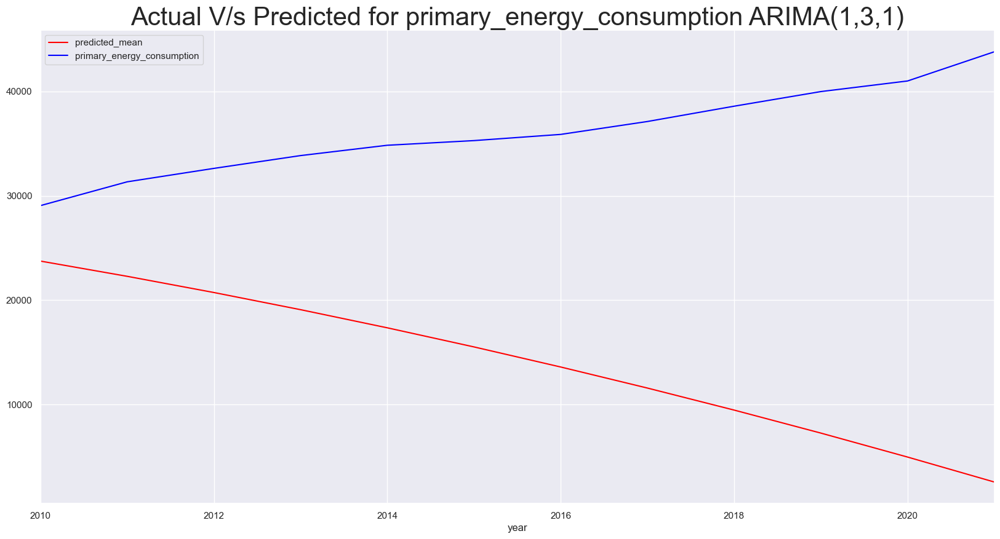

In [300]:
#Let us compare the test data and predicted values
df_usa_Arima_131_predict_tenergy.plot(figsize=(20,10),color="red",legend=True)
df_china_test.primary_energy_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for primary_energy_consumption ARIMA(1,3,1)",size=30)
plt.show()

In [301]:
rmse=sqrt(mean_squared_error(df_usa_Arima_131_predict_tenergy,df_usa_test['primary_energy_consumption']))
print(rmse)

13558.02865950612


In [302]:
mean_absolute_percentage_error(y_true=df_usa_test['primary_energy_consumption'],
                   y_pred=df_usa_Arima_131_predict_tenergy)

45.60736278017642

## Auto ARIMA Model 

In [303]:
#Let us check Auto Arima ,before forecasting
model_auto_usa=auto_arima(df_usa.renewables_consumption[1:])
model_auto_usa

ARIMA(order=(0, 2, 1), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [304]:
model_auto_usa.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 2, 1)   Log Likelihood                -325.490
Date:                Thu, 27 Jul 2023   AIC                            654.979
Time:                        12:48:30   BIC                            658.957
Sample:                    01-01-1966   HQIC                           656.513
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.8858      0.072    -12.262      0.000      -1.027      -0.744
sigma2      9782.2844   2184.029      4.479      0.000    5501.667    1.41e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.44   Jarque-Bera (JB):                 0.79
Prob(Q):                              0.51   Prob(JB):                         0.68
Heteroskedasticity (H):               1.13   Skew:                             0.10
Prob(H) (two-sided):                  0.80   Kurtosis:                         2.45
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

So Auto ARIMA reccomends SARIMAX(0,1,2).yet there is no seasonality and exogenous variable here So it can be treated as ARIMA(0,1,2) and its prediction accuracy can be checked in the next step

## Predictions for Auto ARIMA

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



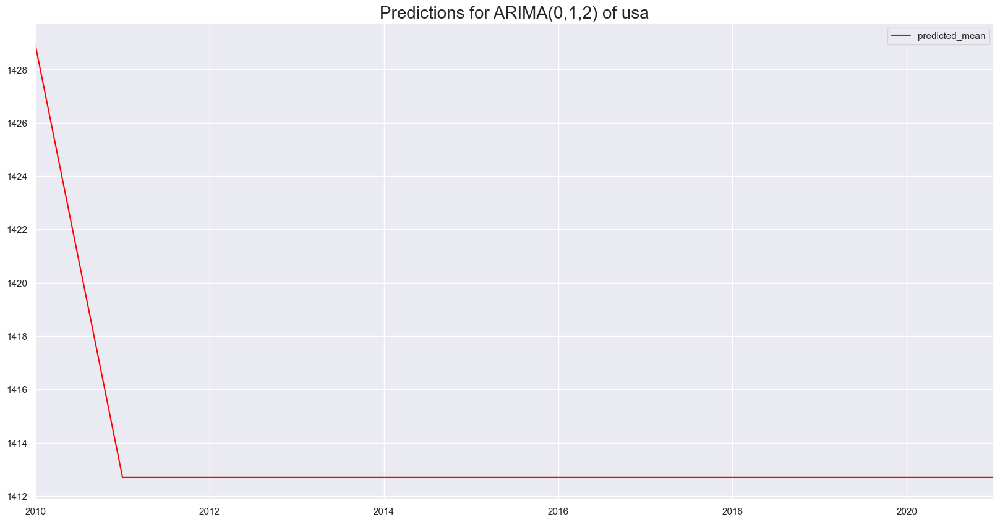

In [305]:
#Let us fit the model for only training dataset
model_Arima_012_usa=ARIMA(df_usa_train.renewables_consumption[1:],order=(0,1,2))
model_Arima_012_usa=model_Arima_012_usa.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_usa_Arima_012_predict=model_Arima_012_usa.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_usa_Arima_012_predict[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for ARIMA(0,1,2) of usa",size=20)
plt.show()

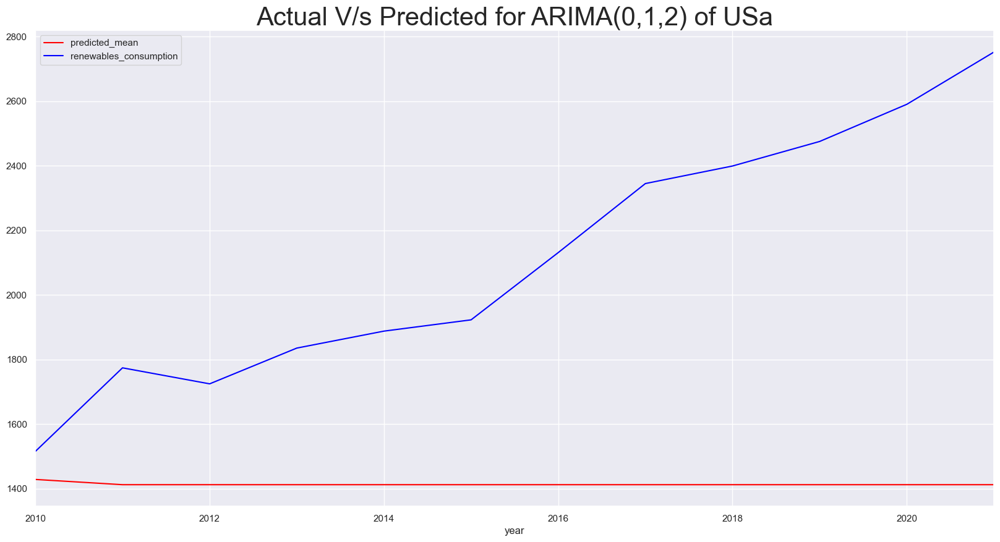

In [306]:
#Let us compare the test data and predicted values
df_usa_Arima_012_predict.plot(figsize=(20,10),color="red",legend=True)
df_usa_test.renewables_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for ARIMA(0,1,2) of USa",size=30)
plt.show()

In [307]:
rmse_012_usa=sqrt(mean_squared_error(df_usa_Arima_012_predict,df_usa_test['renewables_consumption']))
mse_012_usa=mean_squared_error(df_usa_Arima_012_predict,df_usa_test['renewables_consumption'])
mae_usa = np.mean(np.abs(df_usa_Arima_012_predict  - df_usa_test['renewables_consumption']))
print("Root Mean Squared Error for ARIMA(1,1,1): ",rmse_012_usa)
print("Mean Squared Error for ARIMA(1,1,1): ",mse_012_usa)
print("Mean absolute Error for ARIMA(1,1,1): ",mae_usa)

Root Mean Squared Error for ARIMA(1,1,1):  794.1778442570608
Mean Squared Error for ARIMA(1,1,1):  630718.4483087922
Mean absolute Error for ARIMA(1,1,1):  698.8142404295253


In [308]:
mean_absolute_percentage_error(y_true=df_usa_test['renewables_consumption'],
                   y_pred=df_usa_Arima_012_predict)

30.883464112106022

## 2. Renewable share predicting

In [309]:
model_auto_rshare=auto_arima(df_usa.renewables_share_energy[1:])

In [310]:
model_auto_rshare

ARIMA(order=(0, 2, 1), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [311]:
model_auto_rshare.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 2, 1)   Log Likelihood                 -37.106
Date:                Thu, 27 Jul 2023   AIC                             78.212
Time:                        12:48:31   BIC                             82.190
Sample:                    01-01-1966   HQIC                            79.747
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.9012      0.079    -11.424      0.000      -1.056      -0.747
sigma2         0.2244      0.053      4.212      0.000       0.120       0.329
===================================================================================
Ljung-Box (L1) (Q):                   0.21   Jarque-Bera (JB):                 1.36
Prob(Q):                              0.64   Prob(JB):                         0.51
Heteroskedasticity (H):               0.92   Skew:                             0.15
Prob(H) (two-sided):                  0.87   Kurtosis:                         2.29
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



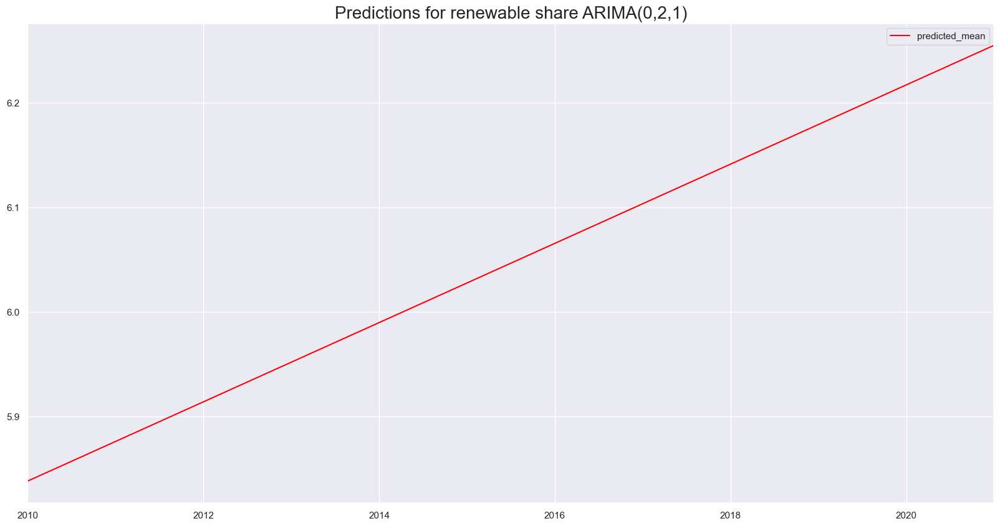

In [312]:
#Let us fit the model for only training dataset
model_Arima_021_rshare=ARIMA(df_usa_train.renewables_share_energy[1:],order=(0,2,1))
model_Arima_021_rshare=model_Arima_021_rshare.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_usa_Arima_021_predict_rshare=model_Arima_021_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_usa_Arima_021_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for renewable share ARIMA(0,2,1)",size=20)
plt.show()

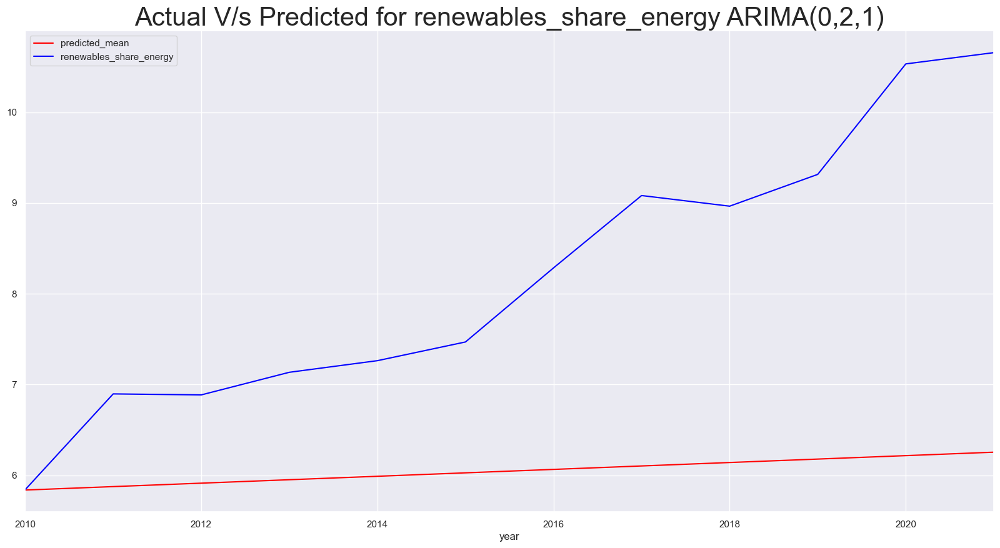

In [313]:
#Let us compare the test data and predicted values
df_usa_Arima_021_predict_rshare.plot(figsize=(20,10),color="red",legend=True)
df_usa_test.renewables_share_energy.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for renewables_share_energy ARIMA(0,2,1)",size=30)
plt.show()

In [314]:
rmse=sqrt(mean_squared_error(df_usa_Arima_021_predict_rshare,df_usa_test['renewables_share_energy']))
print(rmse)

2.5278976922033523


In [315]:
mean_absolute_percentage_error(y_true=df_usa_test['renewables_share_energy'],
                   y_pred=df_usa_Arima_021_predict_rshare)

24.118301129361885

## 3. Total enenrgy predicting

In [316]:
model_auto_tenergy=auto_arima(df_usa.primary_energy_consumption[1:])

In [317]:
model_auto_tenergy

ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True)

In [318]:
model_auto_tenergy.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -432.705
Date:                Thu, 27 Jul 2023   AIC                            869.411
Time:                        12:48:32   BIC                            873.425
Sample:                    01-01-1966   HQIC                           870.963
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept    192.3291    101.527      1.894      0.058      -6.659     391.318
sigma2      3.991e+05   7.24e+04      5.514      0.000    2.57e+05    5.41e+05
===================================================================================
Ljung-Box (L1) (Q):                   0.33   Jarque-Bera (JB):                11.51
Prob(Q):                              0.57   Prob(JB):                         0.00
Heteroskedasticity (H):               1.53   Skew:                            -0.96
Prob(H) (two-sided):                  0.38   Kurtosis:                         4.14
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



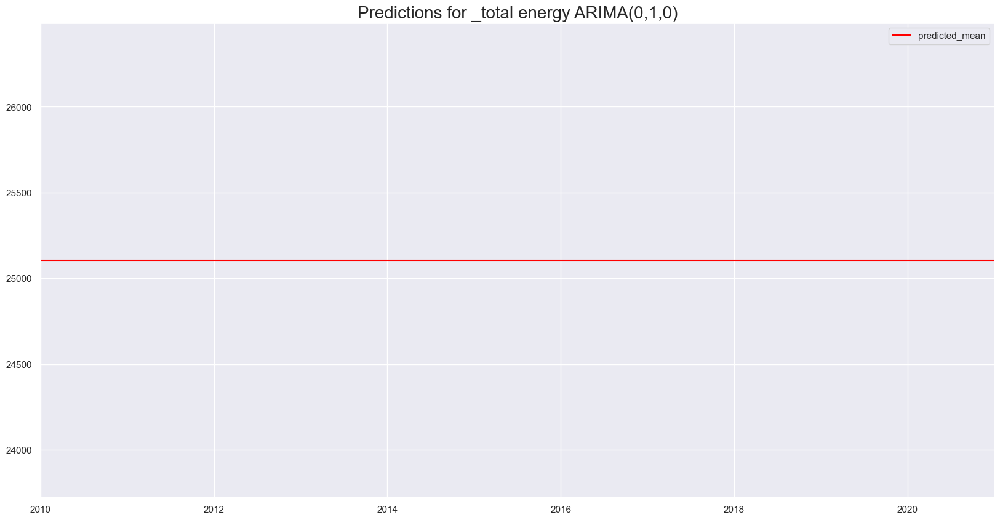

In [319]:
#Let us fit the model for only training dataset
model_Arima_010_tenergy=ARIMA(df_usa_train.primary_energy_consumption[1:],order=(0,1,0))
model_Arima_010_tenergy=model_Arima_010_tenergy.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_usa_Arima_010_predict_tenergy=model_Arima_010_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_usa_Arima_010_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for _total energy ARIMA(0,1,0)",size=20)
plt.show()

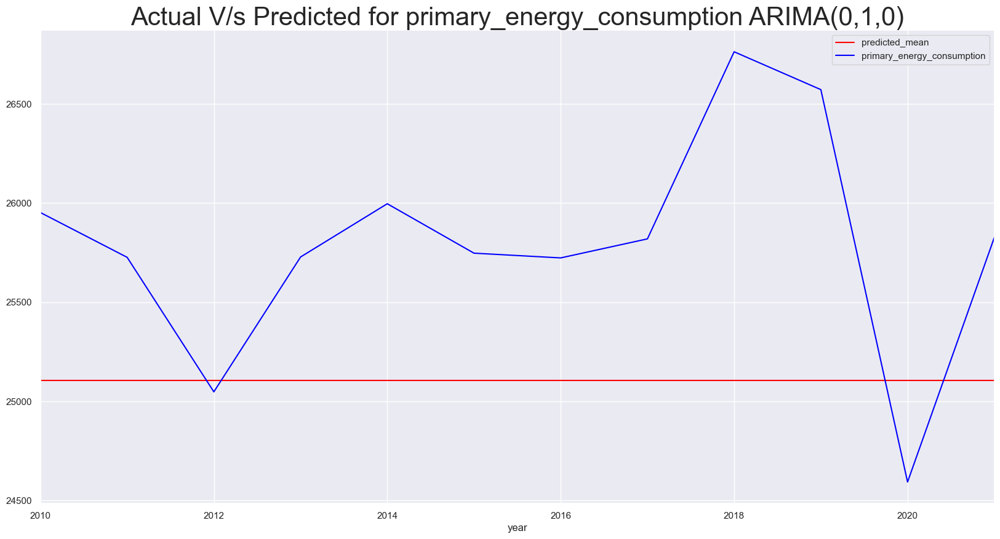

In [320]:
#Let us compare the test data and predicted values
df_usa_Arima_010_predict_tenergy.plot(figsize=(20,10),color="red",legend=True)
df_usa_test.primary_energy_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for primary_energy_consumption ARIMA(0,1,0)",size=30)
plt.show()

In [321]:
rmse=sqrt(mean_squared_error(df_usa_Arima_010_predict_tenergy,df_usa_test['primary_energy_consumption']))
print(rmse)

878.5860753657936


In [322]:
mean_absolute_percentage_error(y_true=df_usa_test['primary_energy_consumption'],
                   y_pred=df_usa_Arima_010_predict_tenergy)

2.998662726286731

# FB Prophet Model

## 1. Prediction for Renewable consumption 

In [323]:
df_usa_no_index.columns = ['ds','y']
df_usa_no_index.head()

,ds,y
20617,1965-01-01,630.852
20618,1966-01-01,636.029
20619,1967-01-01,716.695
20620,1968-01-01,724.112
20621,1969-01-01,808.640


In [333]:
train_usa = df_usa_no_index.iloc[:len(df_usa_no_index)-12]
test_usa = df_usa_no_index.iloc[len(df_usa_no_index)-12:]
test_usa.head()

,ds,y
20662,2010-01-01,1515.733
20663,2011-01-01,1774.409
20664,2012-01-01,1724.880
20665,2013-01-01,1835.576
20666,2014-01-01,1888.077


In [334]:
model_usa = Prophet()
model_usa.fit(train_usa)
future_usa = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast_usa = m.predict(future_usa)

12:50:55 - cmdstanpy - INFO - Chain [1] start processing
12:50:56 - cmdstanpy - INFO - Chain [1] done processing


In [335]:
forecast_usa[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,41406.808330,40308.975796,42538.766390
53,2018-01-01,43151.298333,41891.621138,44503.207086
54,2019-01-01,44920.144224,43509.963380,46374.356244
55,2020-01-01,46713.256639,45061.600217,48415.084494
56,2021-01-01,48395.430497,46641.469737,50223.079813


In [336]:
test_usa.tail()

,ds,y
20669,2017-01-01,2344.897
20670,2018-01-01,2399.240
20671,2019-01-01,2475.220
20672,2020-01-01,2590.215
20673,2021-01-01,2751.958


In [337]:
plot_plotly(model_usa,forecast_usa)


In [338]:
plot_components_plotly(model_usa, forecast_usa)


In [339]:
predictions_usa = forecast_usa.iloc[-12:]['yhat']
predictions_usa

45    29174.053999
46    30942.899891
47    32736.012305
48    34418.186163
49    36162.676166
50    37931.522058
51    39724.634472
52    41406.808330
53    43151.298333
54    44920.144224
55    46713.256639
56    48395.430497
Name: yhat, dtype: float64

In [343]:
test_usa.head()

,ds,y
20662,2010-01-01,1515.733
20663,2011-01-01,1774.409
20664,2012-01-01,1724.880
20665,2013-01-01,1835.576
20666,2014-01-01,1888.077


In [344]:
from statsmodels.tools.eval_measures import rmse


In [345]:
print("Root Mean Squared Error between actual and  predicted values for USA: ",rmse(predictions_usa,test_usa['y']))
print("Mean Value of Test Dataset for usa:", test_usa['y'].mean())

Root Mean Squared Error between actual and  predicted values for USA:  37128.195976939205
Mean Value of Test Dataset for usa: 2112.8641666666667


In [347]:
mean_absolute_percentage_error(y_true=test_usa['y'],
                   y_pred=predictions_usa)

1744.5453564202378

## 2. Predictions for Renewable share 

In [348]:
df_usa_No_index_rshare.head()

,year,renewables_share_energy
20617,1965-01-01,4.369
20618,1966-01-01,4.171
20619,1967-01-01,4.542
20620,1968-01-01,4.331
20621,1969-01-01,4.599


In [349]:
df_usa_No_index_rshare.columns = ['ds','y']
df_usa_No_index_rshare.head()

,ds,y
20617,1965-01-01,4.369
20618,1966-01-01,4.171
20619,1967-01-01,4.542
20620,1968-01-01,4.331
20621,1969-01-01,4.599


In [350]:
train = df_usa_No_index_rshare.iloc[:len(df_usa_No_index_rshare)-12]
test = df_usa_No_index_rshare.iloc[len(df_usa_No_index_rshare)-12:]
test.head()

,ds,y
20662,2010-01-01,5.841
20663,2011-01-01,6.897
20664,2012-01-01,6.886
20665,2013-01-01,7.135
20666,2014-01-01,7.263


In [351]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

12:59:00 - cmdstanpy - INFO - Chain [1] start processing
12:59:00 - cmdstanpy - INFO - Chain [1] done processing


In [352]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,-2.331752,3.931488,5.096051,-2.331752,-2.331752,6.859109,6.859109,6.859109,6.859109,6.859109,6.859109,0.0,0.0,0.0,4.527357
53,2018-01-01,-2.330317,3.992615,5.175719,-2.330317,-2.330317,6.929978,6.929978,6.929978,6.929978,6.929978,6.929978,0.0,0.0,0.0,4.599661
54,2019-01-01,-2.328882,3.996703,5.212465,-2.328882,-2.328882,6.943693,6.943693,6.943693,6.943693,6.943693,6.943693,0.0,0.0,0.0,4.614811
55,2020-01-01,-2.327447,3.970074,5.157546,-2.327447,-2.327447,6.900235,6.900235,6.900235,6.900235,6.900235,6.900235,0.0,0.0,0.0,4.572788
56,2021-01-01,-2.326008,3.904362,5.095434,-2.326008,-2.326008,6.859109,6.859109,6.859109,6.859109,6.859109,6.859109,0.0,0.0,0.0,4.533100


In [353]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,4.527357,3.931488,5.096051
53,2018-01-01,4.599661,3.992615,5.175719
54,2019-01-01,4.614811,3.996703,5.212465
55,2020-01-01,4.572788,3.970074,5.157546
56,2021-01-01,4.533100,3.904362,5.095434


In [354]:
test.tail()


,ds,y
20669,2017-01-01,9.082
20670,2018-01-01,8.965
20671,2019-01-01,9.315
20672,2020-01-01,10.532
20673,2021-01-01,10.656


In [355]:
plot_plotly(m,forecast)


In [356]:
plot_components_plotly(m, forecast)


In [357]:
predictions = forecast.iloc[-12:]['yhat']
predictions.tail()

52    4.527357
53    4.599661
54    4.614811
55    4.572788
56    4.533100
Name: yhat, dtype: float64

In [358]:
test['y'].tail()

20669     9.082
20670     8.965
20671     9.315
20672    10.532
20673    10.656
Name: y, dtype: float64

In [359]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))


Root Mean Squared Error between actual and  predicted values:  3.9060401055383305


In [360]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

42.36259921178847

## 3. Predictions for Total Energy 

In [361]:
df_usa_No_index_tenergy.head()

,year,primary_energy_consumption
20617,1965-01-01,14439.701
20618,1966-01-01,15247.363
20619,1967-01-01,15778.539
20620,1968-01-01,16719.385
20621,1969-01-01,17583.424


In [362]:
df_usa_No_index_tenergy.columns = ['ds','y']
df_usa_No_index_tenergy.head()

,ds,y
20617,1965-01-01,14439.701
20618,1966-01-01,15247.363
20619,1967-01-01,15778.539
20620,1968-01-01,16719.385
20621,1969-01-01,17583.424


In [363]:
train = df_usa_No_index_tenergy.iloc[:len(df_usa_No_index_tenergy)-12]
test = df_usa_No_index_tenergy.iloc[len(df_usa_No_index_tenergy)-12:]
test.head()

,ds,y
20662,2010-01-01,25951.865
20663,2011-01-01,25726.064
20664,2012-01-01,25047.865
20665,2013-01-01,25727.750
20666,2014-01-01,25996.219


In [364]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

13:04:17 - cmdstanpy - INFO - Chain [1] start processing
13:04:17 - cmdstanpy - INFO - Chain [1] done processing


In [365]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,16594.812412,28136.553039,30719.145661,16593.465849,16596.171208,12861.742028,12861.742028,12861.742028,12861.742028,12861.742028,12861.742028,0.0,0.0,0.0,29456.554439
53,2018-01-01,16846.076561,28374.862152,31015.527907,16844.460926,16847.721405,12911.767417,12911.767417,12911.767417,12911.767417,12911.767417,12911.767417,0.0,0.0,0.0,29757.843977
54,2019-01-01,17097.340710,28698.009414,31353.819853,17095.451939,17099.254687,13016.574150,13016.574150,13016.574150,13016.574150,13016.574150,13016.574150,0.0,0.0,0.0,30113.914859
55,2020-01-01,17348.604859,29265.803664,31767.291067,17346.403581,17350.837284,13176.064813,13176.064813,13176.064813,13176.064813,13176.064813,13176.064813,0.0,0.0,0.0,30524.669671
56,2021-01-01,17600.557402,29132.967359,31792.991888,17598.041921,17603.052246,12861.742028,12861.742028,12861.742028,12861.742028,12861.742028,12861.742028,0.0,0.0,0.0,30462.299430


In [366]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,29456.554439,28136.553039,30719.145661
53,2018-01-01,29757.843977,28374.862152,31015.527907
54,2019-01-01,30113.914859,28698.009414,31353.819853
55,2020-01-01,30524.669671,29265.803664,31767.291067
56,2021-01-01,30462.299430,29132.967359,31792.991888


In [367]:
test.tail()


,ds,y
20669,2017-01-01,25819.031
20670,2018-01-01,26762.473
20671,2019-01-01,26571.660
20672,2020-01-01,24593.223
20673,2021-01-01,25825.461


In [368]:
plot_plotly(m,forecast)


In [369]:
plot_components_plotly(m, forecast)


In [370]:
predictions = forecast.iloc[-12:]['yhat']
predictions.tail()

52    29456.554439
53    29757.843977
54    30113.914859
55    30524.669671
56    30462.299430
Name: yhat, dtype: float64

In [371]:
test['y'].tail()

20669    25819.031
20670    26762.473
20671    26571.660
20672    24593.223
20673    25825.461
Name: y, dtype: float64

In [372]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))


Root Mean Squared Error between actual and  predicted values:  3570.999743505261


In [373]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

13.305600646507395

## VAR Model for USA 

## 1. Predictions for renewable consumption 

In [374]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_usa=df_world_var[df_world_var['country'].isin(['United States'])]
df_var_usa

,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
20552,United States,1900,USA,NaN,NaN,NaN,NaN,NaN,NaN
20553,United States,1901,USA,NaN,NaN,NaN,NaN,NaN,NaN
20554,United States,1902,USA,NaN,NaN,NaN,NaN,NaN,NaN
20555,United States,1903,USA,NaN,NaN,NaN,NaN,NaN,NaN
20556,United States,1904,USA,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
20669,United States,2017,USA,2344.897,25819.031,21310.291,7110.247,64617.520,78289.016
20670,United States,2018,USA,2399.240,26762.473,22206.340,7223.578,66858.367,80575.875
20671,United States,2019,USA,2475.220,26571.660,21941.309,7403.752,65629.727,79479.797
20672,United States,2020,USA,2590.215,24593.223,19907.604,7710.305,59259.047,73206.750


In [375]:
#dropping the null values corresponding to initial years of null data
df_var_usa.dropna(inplace=True)
df_var_usa.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2455716141.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
20669,United States,2017,USA,2344.897,25819.031,21310.291,7110.247,64617.520,78289.016
20670,United States,2018,USA,2399.240,26762.473,22206.340,7223.578,66858.367,80575.875
20671,United States,2019,USA,2475.220,26571.660,21941.309,7403.752,65629.727,79479.797
20672,United States,2020,USA,2590.215,24593.223,19907.604,7710.305,59259.047,73206.750
20673,United States,2021,USA,2751.958,25825.461,21016.762,8166.106,62364.715,76633.953


In [376]:
#Converting them into date time format with years format
df_var_usa.year=pd.to_datetime(df_var_usa.year,format='%Y', errors='coerce')


C:\Users\91970\AppData\Local\Temp\ipykernel_13476\388904541.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [377]:
#Setting the year as index
df_var_usa.set_index("year",inplace=True)
df_var_usa.head()

,country,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
year,,,,,,,,
1965-01-01,United States,USA,630.852,14439.701,13797.927,3325.466,72734.258,76117.297
1966-01-01,United States,USA,636.029,15247.363,14594.848,3315.569,76081.812,79483.320
1967-01-01,United States,USA,716.695,15778.539,15038.979,3698.454,77607.547,81423.992
1968-01-01,United States,USA,724.112,16719.385,15957.852,3699.292,81524.328,85414.797
1969-01-01,United States,USA,808.640,17583.424,16733.182,4086.945,84571.102,88868.312


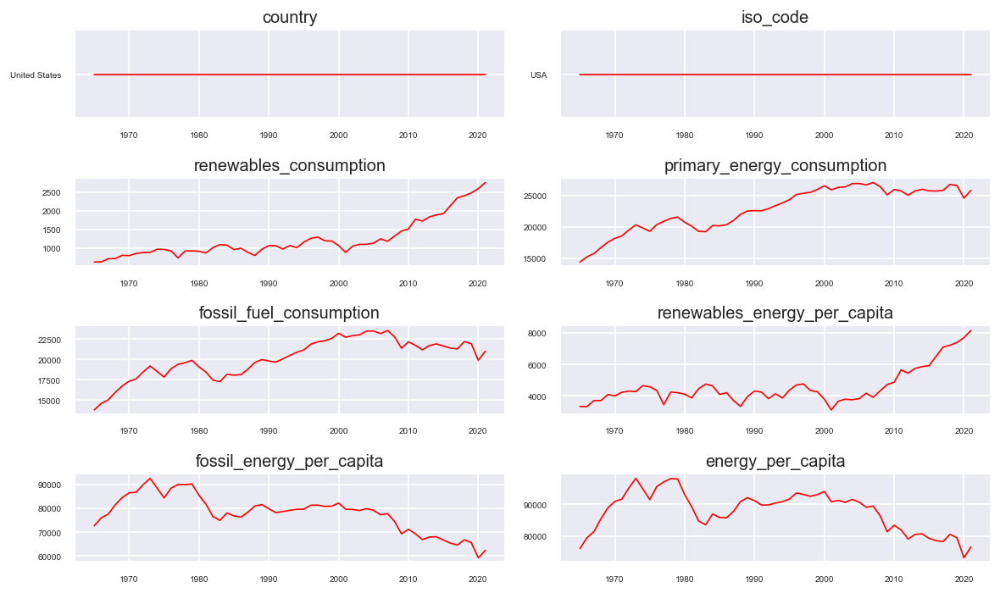

In [378]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=4, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_usa[df_var_usa.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_usa.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

So Renewable consumption and per-capita patterns are looking alike.

In [379]:
#Let us check which time series is causing the other using granger casuality tests
print('renewables_energy_per_capita causes renewables_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_usa[['renewables_consumption', 'renewables_energy_per_capita']], 8)

print('\n renewables_consumption causes renewables_energy_per_capita?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_usa[['renewables_energy_per_capita', 'renewables_consumption']], 8)

renewables_energy_per_capita causes renewables_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=3.5970  , p=0.0633  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=3.8006  , p=0.0512  , df=1
likelihood ratio test: chi2=3.6772  , p=0.0552  , df=1
parameter F test:         F=3.5970  , p=0.0633  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=1.4916  , p=0.2348  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=3.2816  , p=0.1938  , df=2
likelihood ratio test: chi2=3.1874  , p=0.2032  , df=2
parameter F test:         F=1.4916  , p=0.2348  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.8111  , p=0.4941  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=2.7956  , p=0.4242  , df=3
likelihood ratio test: chi2=2.7257  , p=0.4359  , df=3
parameter F test:         F=0.8111  , p=0.4941  , df_denom=47, df_num=3

Granger Causality
n

In [380]:
print('\n So Finally renewables_consumption causes renewables_energy_per_capita\n')
#Taking two of them into separate dataframe before fitting into model
df_var_usa=df_var_usa[['renewables_energy_per_capita', 'renewables_consumption']]
print(df_var_usa.shape)


 So Finally renewables_consumption causes renewables_energy_per_capita

(57, 2)


In [381]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_usa=df_var_usa[:-12]
test_var_usa=df_var_usa[-12:]

In [382]:
#Taking the training data for modelling
model = VAR(train_var_usa)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [383]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        21.73       21.82   2.730e+09       21.76
1        16.96      17.22*   2.315e+07      17.05*
2        17.09       17.54   2.660e+07       17.25
3        17.25       17.87   3.131e+07       17.46
4        17.16       17.96   2.906e+07       17.44
5        17.25       18.23   3.247e+07       17.59
6        17.32       18.47   3.569e+07       17.71
7        17.12       18.46   3.076e+07       17.58
8        16.62       18.13  1.980e+07*       17.14
9        16.56       18.25   2.014e+07       17.14
10      16.45*       18.32   2.026e+07       17.10
--------------------------------------------------


So Order '1' is having Lower BIC,HQIC values.although lag'8' and '10' are having lower FPE and AIC value,the order is very high.So Order '1' is considered as a better fit for this model.

In [384]:
#Here only modelling for VAR..so MA=0 and S0,VAR(1,0)
#Here the model automatically converts the series into stationaryn using function enfore_stationarity
var_model = VARMAX(train_var_usa, order=(1,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\varmax.py:374: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



                                               Statespace Model Results                                               
Dep. Variable:     ['renewables_energy_per_capita', 'renewables_consumption']   No. Observations:                   45
Model:                                                                 VAR(1)   Log Likelihood                -528.745
                                                                  + intercept   AIC                           1075.490
Date:                                                        Thu, 27 Jul 2023   BIC                           1091.750
Time:                                                                13:07:46   HQIC                          1081.551
Sample:                                                            01-01-1965                                         
                                                                 - 01-01-2009                                         
Covariance Type:                                

In [385]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [386]:
#Naming the columns of predicted results with suitable names
predictions.columns=['USA per capita consumption_predicted','consumption_predicted']
predictions

,USA per capita consumption_predicted,consumption_predicted
2010-01-01,4096.054871,1302.631883
2011-01-01,4096.522258,1301.905456
2012-01-01,4096.448544,1301.049550
2013-01-01,4096.375554,1300.196747
2014-01-01,4096.302819,1299.346922
2015-01-01,4096.230339,1298.500065
2016-01-01,4096.158111,1297.656166
2017-01-01,4096.086136,1296.815213
2018-01-01,4096.014411,1295.977198
2019-01-01,4095.942938,1295.142110


<Axes: >

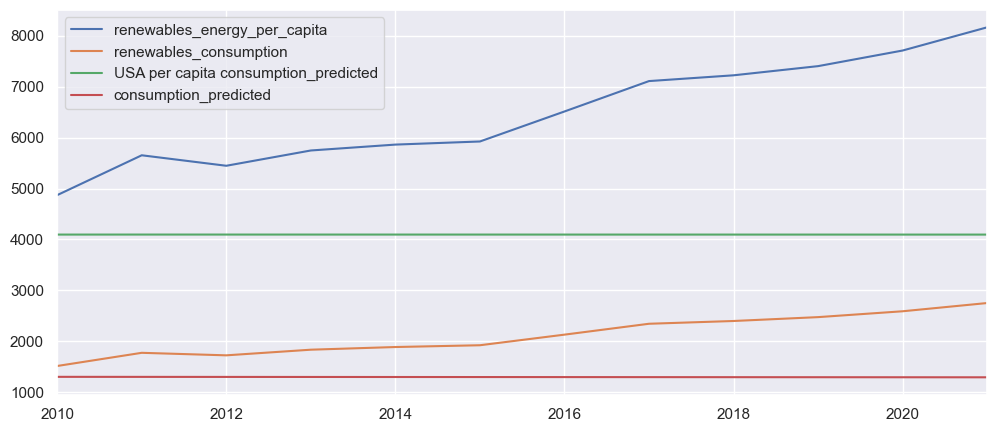

In [387]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_usa,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [388]:
mean_absolute_percentage_error(y_true=test_var_usa['renewables_consumption'],
                   y_pred=predictions['consumption_predicted'])

36.5481656687973

In [389]:
rmse_consumption=math.sqrt(mean_squared_error(predictions['consumption_predicted'],test_var_usa['renewables_consumption']))
print('Mean value of consumption is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_usa['renewables_consumption']),rmse_consumption))

Mean value of consumption is : 2112.8641666666667. Root Mean Squared Error is :898.1953020889098


In [390]:
#Forecasting into future
n_forecast = 19
predict = fitted_model.get_prediction(start="2022-01-01",end="2030-01-01")
predictions=predict.predicted_mean

<Axes: >

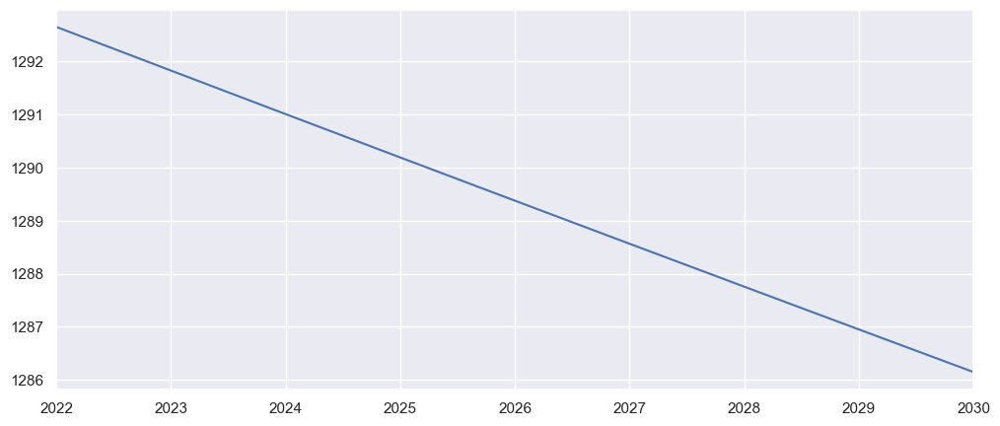

In [391]:
predictions['renewables_consumption'].plot(figsize=(12,5))

In [392]:
predictions['renewables_consumption']

2022-01-01    1292.654302
2023-01-01    1291.830818
2024-01-01    1291.010210
2025-01-01    1290.192468
2026-01-01    1289.377582
2027-01-01    1288.565542
2028-01-01    1287.756338
2029-01-01    1286.949960
2030-01-01    1286.146397
Freq: AS-JAN, Name: renewables_consumption, dtype: float64

# Future Predictions for U.S.A

Out of all models,Auto ARIMA is having less error.So,it is the best model to do future values.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



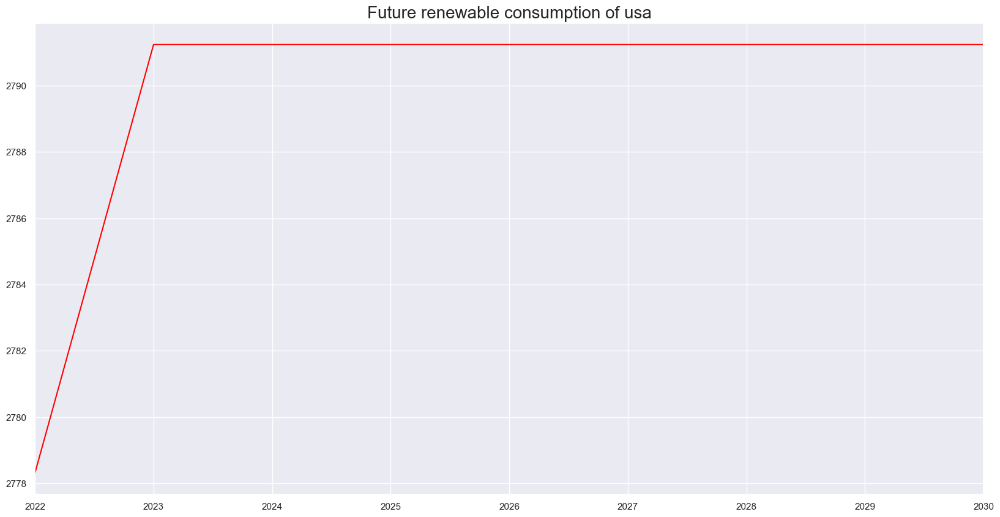

In [393]:
#Let us fit the model for whole dataset
forecast_Arima_012_usa=ARIMA(df_usa.renewables_consumption[1:],order=(0,1,2))
forecast_Arima_012_usa=forecast_Arima_012_usa.fit()
#predicting the values for test dataset
start_date="2022-01-01"
end_date="2030-01-01"
df_usa_Arima_012_forecast=forecast_Arima_012_usa.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_usa_Arima_012_forecast[start_date:end_date].plot(figsize=(20,10),color="red")
plt.title("Future renewable consumption of usa",size=20)
plt.show()

In [394]:
df_usa_Arima_012_forecast

2022-01-01    2778.315377
2023-01-01    2791.239155
2024-01-01    2791.239155
2025-01-01    2791.239155
2026-01-01    2791.239155
2027-01-01    2791.239155
2028-01-01    2791.239155
2029-01-01    2791.239155
2030-01-01    2791.239155
Freq: AS-JAN, Name: predicted_mean, dtype: float64

## 2. Predictions for renewable share 

In [395]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_2_usa=df_world_var_2[df_world_var_2['country'].isin(['United States'])]
df_var_2_usa

,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
20552,United States,1900,USA,NaN,NaN,NaN,NaN
20553,United States,1901,USA,NaN,NaN,NaN,NaN
20554,United States,1902,USA,NaN,NaN,NaN,NaN
20555,United States,1903,USA,NaN,NaN,NaN,NaN
20556,United States,1904,USA,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
20669,United States,2017,USA,9.082,0.982,8.381,82.537
20670,United States,2018,USA,8.965,0.936,8.059,82.976
20671,United States,2019,USA,9.315,0.882,8.111,82.574
20672,United States,2020,USA,10.532,0.919,8.520,80.948


In [396]:
#dropping the null values corresponding to initial years of null data
df_var_2_usa.dropna(inplace=True)
df_var_2_usa.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\4157698409.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
20669,United States,2017,USA,9.082,0.982,8.381,82.537
20670,United States,2018,USA,8.965,0.936,8.059,82.976
20671,United States,2019,USA,9.315,0.882,8.111,82.574
20672,United States,2020,USA,10.532,0.919,8.520,80.948
20673,United States,2021,USA,10.656,0.888,7.964,81.380


In [397]:
#Converting them into date time format with years format
df_var_2_usa.year=pd.to_datetime(df_var_2_usa.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\628231793.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [398]:
#Setting the year as index
df_var_2_usa.set_index("year",inplace=True)
df_var_2_usa.tail()

,country,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
year,,,,,,
2017-01-01,United States,USA,9.082,0.982,8.381,82.537
2018-01-01,United States,USA,8.965,0.936,8.059,82.976
2019-01-01,United States,USA,9.315,0.882,8.111,82.574
2020-01-01,United States,USA,10.532,0.919,8.520,80.948
2021-01-01,United States,USA,10.656,0.888,7.964,81.380


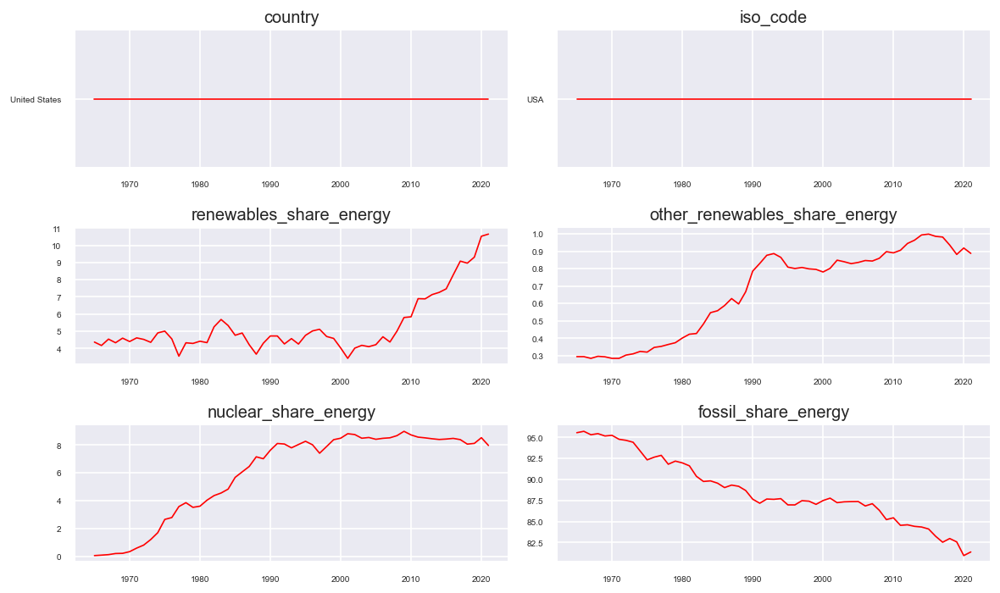

In [399]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=3, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_2_usa[df_var_2_usa.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_2_usa.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

Renewables and other renewables are some what of closer,rather than remaining

In [400]:
#Let us check which time series is causing the other using granger casuality tests
print('	renewables_share_energy causes other_renewables_share_energy?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_2_usa[['other_renewables_share_energy', 'renewables_share_energy']], 8)
print('\n other_renewables_share_energy causes renewables_share_energy?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_2_usa[['renewables_share_energy', 'other_renewables_share_energy']], 8)

	renewables_share_energy causes other_renewables_share_energy?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=1.9698  , p=0.1663  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=2.0813  , p=0.1491  , df=1
likelihood ratio test: chi2=2.0435  , p=0.1529  , df=1
parameter F test:         F=1.9698  , p=0.1663  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=1.1699  , p=0.3187  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=2.5738  , p=0.2761  , df=2
likelihood ratio test: chi2=2.5154  , p=0.2843  , df=2
parameter F test:         F=1.1699  , p=0.3187  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=1.4484  , p=0.2407  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=4.9923  , p=0.1724  , df=3
likelihood ratio test: chi2=4.7748  , p=0.1890  , df=3
parameter F test:         F=1.4484  , p=0.2407  , df_denom=47, df_num=3

Granger Causalit

In [402]:
print('\n So Finally other_renewables_share_energy causes renewables_share_energy\n')
#Taking two of them into separate dataframe before fitting into model
df_var_2_usa=df_var_2_usa[['renewables_share_energy', 'other_renewables_share_energy']]
print(df_var_2_usa.shape)


 So Finally other_renewables_share_energy causes renewables_share_energy

(57, 2)


In [403]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_2_usa=df_var_2_usa[:-12]
test_var_2_usa=df_var_2_usa[-12:]

In [404]:
#Taking the training data for modelling
model = VAR(train_var_2_usa)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [405]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -4.428      -4.340     0.01193      -4.398
1       -8.309     -8.042*   0.0002465     -8.217*
2      -8.370*      -7.926  0.0002326*      -8.217
3       -8.170      -7.548   0.0002860      -7.956
4       -8.017      -7.217   0.0003378      -7.740
5       -8.193      -7.216   0.0002890      -7.856
6       -8.076      -6.920   0.0003351      -7.677
7       -8.207      -6.874   0.0003069      -7.747
8       -8.159      -6.648   0.0003423      -7.637
9       -8.020      -6.331   0.0004272      -7.437
10      -8.021      -6.155   0.0004768      -7.377
--------------------------------------------------


Order '2' is conidered here.

In [406]:
var_model = VARMAX(train_var_2_usa, order=(2,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



                                                Statespace Model Results                                                
Dep. Variable:     ['renewables_share_energy', 'other_renewables_share_energy']   No. Observations:                   45
Model:                                                                   VAR(2)   Log Likelihood                  75.037
                                                                    + intercept   AIC                           -124.074
Date:                                                          Thu, 27 Jul 2023   BIC                           -100.587
Time:                                                                  13:19:59   HQIC                          -115.318
Sample:                                                              01-01-1965                                         
                                                                   - 01-01-2009                                         
Covariance Type:                

In [407]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [408]:
#Naming the columns of predicted results with suitable names
predictions.columns=['renewables_share_energy_predicted','other_renewables_share_energy_predicted']
predictions

,renewables_share_energy_predicted,other_renewables_share_energy_predicted
2010-01-01,5.314019,0.913059
2011-01-01,4.776517,0.902780
2012-01-01,4.538155,0.884041
2013-01-01,4.513644,0.867651
2014-01-01,4.555647,0.855875
2015-01-01,4.587933,0.847122
2016-01-01,4.597419,0.839573
2017-01-01,4.594704,0.832322
2018-01-01,4.589984,0.825173
2019-01-01,4.587189,0.818184


<Axes: >

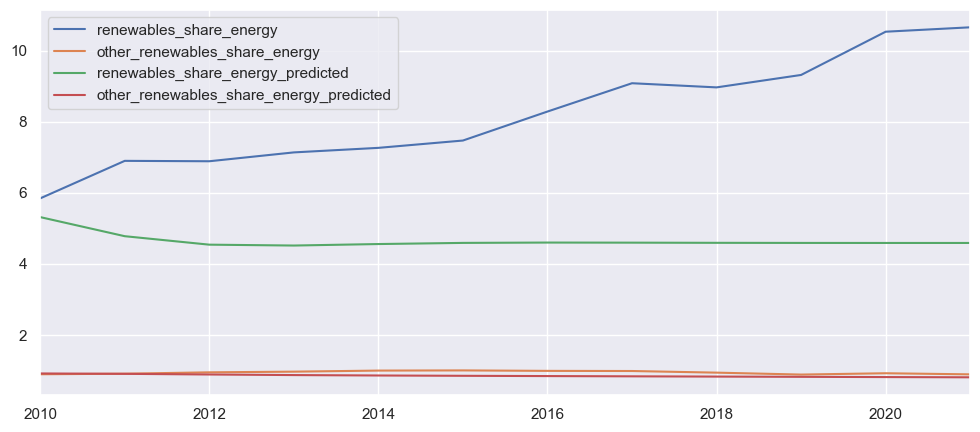

In [409]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_2_usa,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [410]:
mean_absolute_percentage_error(y_true=test_var_2_usa['renewables_share_energy'],
                   y_pred=predictions['renewables_share_energy_predicted'])

41.11184323774968

In [411]:
rmse_rshare=math.sqrt(mean_squared_error(predictions['renewables_share_energy_predicted'],test_var_2_usa['renewables_share_energy']))
print('Mean value of renewable share is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_2_usa['renewables_share_energy']),rmse_rshare))

Mean value of renewable share is : 8.193833333333334. Root Mean Squared Error is :3.8752523028044035


## forecasting future renewable share 

Out of all four models, SARIMAX (0,2,1) is predicting better

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



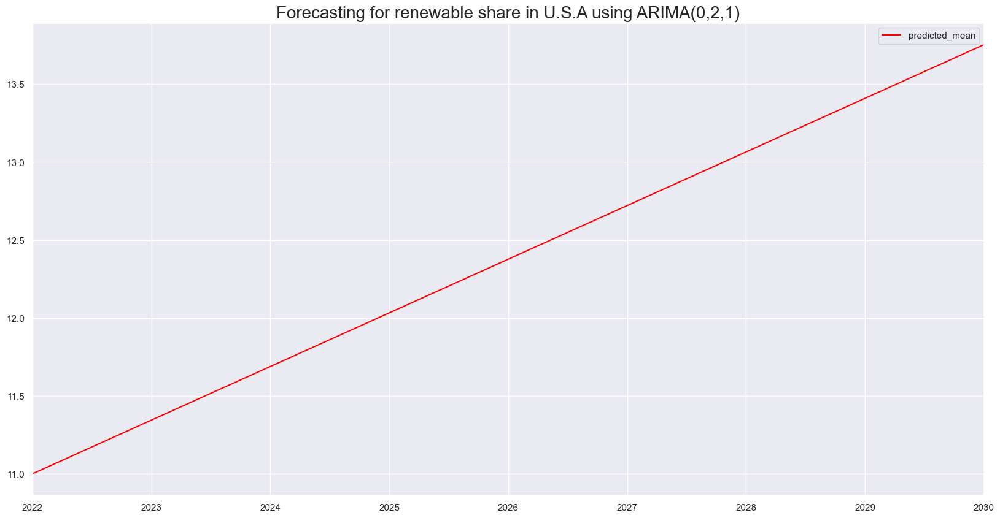

In [412]:
#Let us fit the model for wholedataset
model_Arima_021_rshare=ARIMA(df_usa.renewables_share_energy[1:],order=(0,2,1))
model_Arima_021_rshare=model_Arima_021_rshare.fit()
#predicting the values for test dataset
start_date="2022-01-01"
end_date="2030-01-01"
df_usa_Arima_021_predict_rshare=model_Arima_021_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_usa_Arima_021_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Forecasting for renewable share in U.S.A using ARIMA(0,2,1)",size=20)
plt.show()

In [413]:
df_usa_Arima_021_predict_rshare

2022-01-01    11.000176
2023-01-01    11.344352
2024-01-01    11.688529
2025-01-01    12.032705
2026-01-01    12.376881
2027-01-01    12.721057
2028-01-01    13.065233
2029-01-01    13.409410
2030-01-01    13.753586
Freq: AS-JAN, Name: predicted_mean, dtype: float64

## 3. Predictions for total energy 

In [414]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_3_usa=df_world_var_3[df_world_var_3['country'].isin(['United States'])]
df_var_3_usa

,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
20552,United States,1900,USA,NaN,NaN,NaN,NaN
20553,United States,1901,USA,NaN,NaN,NaN,NaN
20554,United States,1902,USA,NaN,NaN,NaN,NaN
20555,United States,1903,USA,NaN,NaN,NaN,NaN
20556,United States,1904,USA,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
20669,United States,2017,USA,25819.031,2344.897,2163.843,21310.291
20670,United States,2018,USA,26762.473,2399.240,2156.894,22206.340
20671,United States,2019,USA,26571.660,2475.220,2155.132,21941.309
20672,United States,2020,USA,24593.223,2590.215,2095.404,19907.604


In [415]:
#dropping the null values corresponding to initial years of null data
df_var_3_usa.dropna(inplace=True)
df_var_3_usa.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2053213557.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
20669,United States,2017,USA,25819.031,2344.897,2163.843,21310.291
20670,United States,2018,USA,26762.473,2399.240,2156.894,22206.340
20671,United States,2019,USA,26571.660,2475.220,2155.132,21941.309
20672,United States,2020,USA,24593.223,2590.215,2095.404,19907.604
20673,United States,2021,USA,25825.461,2751.958,2056.739,21016.762


In [416]:
#Converting them into date time format with years format
df_var_3_usa.year=pd.to_datetime(df_var_3_usa.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2209755113.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [417]:
#Setting the year as index
df_var_3_usa.set_index("year",inplace=True)
df_var_3_usa.tail()

,country,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
year,,,,,,
2017-01-01,United States,USA,25819.031,2344.897,2163.843,21310.291
2018-01-01,United States,USA,26762.473,2399.240,2156.894,22206.340
2019-01-01,United States,USA,26571.660,2475.220,2155.132,21941.309
2020-01-01,United States,USA,24593.223,2590.215,2095.404,19907.604
2021-01-01,United States,USA,25825.461,2751.958,2056.739,21016.762


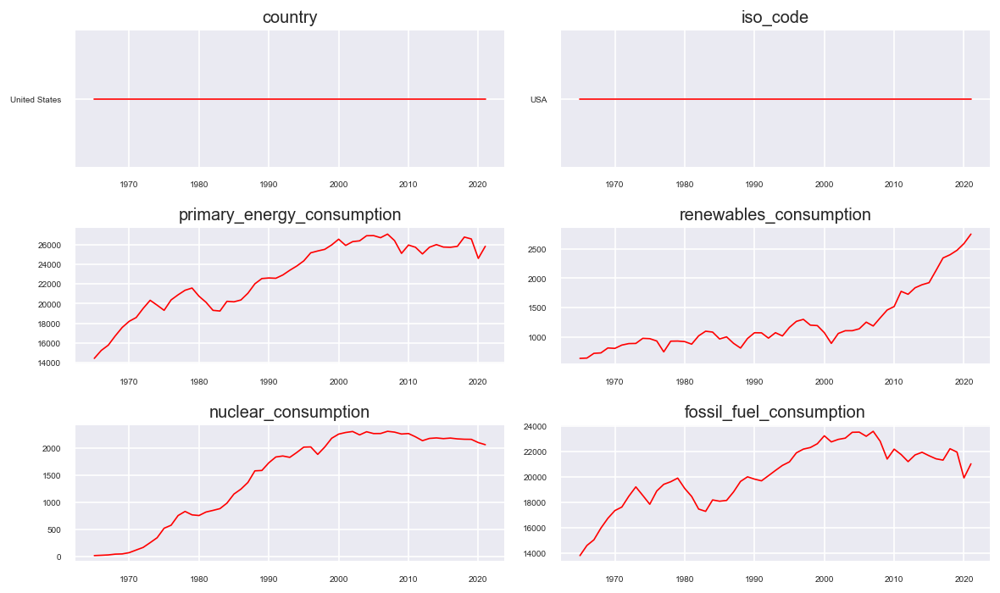

In [418]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=3, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_3_usa[df_var_3_usa.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_3_usa.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

primary energy and fossil fuel consumption graphs are looking a like

In [419]:
#Let us check which time series is causing the other using granger casuality tests
print('primary_energy_consumption causes fossil_fuel_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_3_usa[['fossil_fuel_consumption', 'primary_energy_consumption']], 8)
print('\n fossil_fuel_consumption causes primary_energy_consumption?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_3_usa[['primary_energy_consumption', 'fossil_fuel_consumption']], 8)

primary_energy_consumption causes fossil_fuel_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.7332  , p=0.3957  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=0.7747  , p=0.3788  , df=1
likelihood ratio test: chi2=0.7694  , p=0.3804  , df=1
parameter F test:         F=0.7332  , p=0.3957  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.5851  , p=0.5608  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=1.2873  , p=0.5254  , df=2
likelihood ratio test: chi2=1.2724  , p=0.5293  , df=2
parameter F test:         F=0.5851  , p=0.5608  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.2023  , p=0.8943  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=0.6974  , p=0.8738  , df=3
likelihood ratio test: chi2=0.6929  , p=0.8749  , df=3
parameter F test:         F=0.2023  , p=0.8943  , df_denom=47, df_num=3

Granger Causality
nu

In [420]:
print('\n So Finally fossil_fuel_consumption causes primary_energy_consumption\n')
#Taking two of them into separate dataframe before fitting into model
df_var_3_usa=df_var_3_usa[['primary_energy_consumption', 'fossil_fuel_consumption']]
print(df_var_3_usa.shape)


 So Finally fossil_fuel_consumption causes primary_energy_consumption

(57, 2)


In [421]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_3_usa=df_var_3_usa[:-12]
test_var_3_usa=df_var_3_usa[-12:]

In [422]:
#Taking the training data for modelling
model = VAR(train_var_3_usa)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [423]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        27.05       27.14   5.579e+11       27.08
1        21.97      22.23*   3.472e+09      22.06*
2        22.00       22.44   3.588e+09       22.15
3       21.94*       22.57  3.429e+09*       22.16
4        22.01       22.81   3.696e+09       22.28
5        22.21       23.19   4.642e+09       22.55
6        22.30       23.46   5.225e+09       22.70
7        22.43       23.76   6.179e+09       22.89
8        22.50       24.01   7.067e+09       23.02
9        22.35       24.04   6.587e+09       22.93
10       22.51       24.37   8.627e+09       23.15
--------------------------------------------------


Order '3' is selected

In [424]:
var_model = VARMAX(train_var_3_usa, order=(3,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



                                               Statespace Model Results                                              
Dep. Variable:     ['primary_energy_consumption', 'fossil_fuel_consumption']   No. Observations:                   45
Model:                                                                VAR(3)   Log Likelihood                -617.406
                                                                 + intercept   AIC                           1268.811
Date:                                                       Thu, 27 Jul 2023   BIC                           1299.525
Time:                                                               13:36:13   HQIC                          1280.261
Sample:                                                           01-01-1965                                         
                                                                - 01-01-2009                                         
Covariance Type:                                        

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [425]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [426]:
#Naming the columns of predicted results with suitable names
predictions.columns=['primary_energy_consumption_predicted','fossil_fuel_consumption_predicted']
predictions

,primary_energy_consumption_predicted,fossil_fuel_consumption_predicted
2010-01-01,24690.893206,20997.268832
2011-01-01,24656.933248,21064.460168
2012-01-01,24770.973028,21239.912728
2013-01-01,24966.366092,21465.332968
2014-01-01,25189.817865,21699.956250
2015-01-01,25400.568533,21910.513250
2016-01-01,25573.882509,22078.033170
2017-01-01,25698.319184,22195.454829
2018-01-01,25772.119863,22263.954956
2019-01-01,25799.902901,22289.816917


<Axes: >

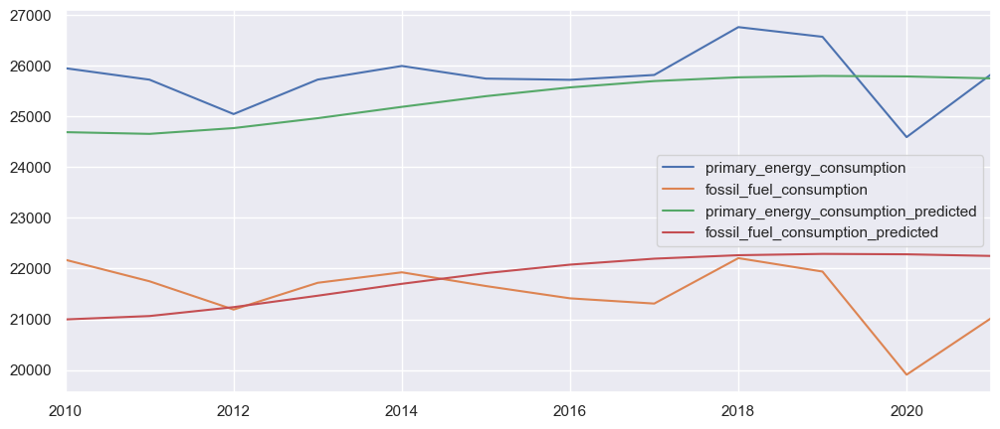

In [427]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_3_usa,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [428]:
mean_absolute_percentage_error(y_true=test_var_3_usa['primary_energy_consumption'],
                   y_pred=predictions['primary_energy_consumption_predicted'])

2.527668305386725

In [429]:
rmse_tenergy=math.sqrt(mean_squared_error(predictions['primary_energy_consumption_predicted'],test_var_3_usa['primary_energy_consumption']))
print('Mean value of total energy is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_3_usa['primary_energy_consumption']),rmse_tenergy))

Mean value of total energy is : 25790.983. Root Mean Squared Error is :775.1577394237736


## Forecasting Total energy of usa

Out of all the four models.VAR(3,0) is predicting well.

In [431]:
#Forecasting into future
n_forecast = 19
predict = fitted_model.get_prediction(start="2022-01-01",end="2030-01-01")
predictions=predict.predicted_mean

<Axes: >

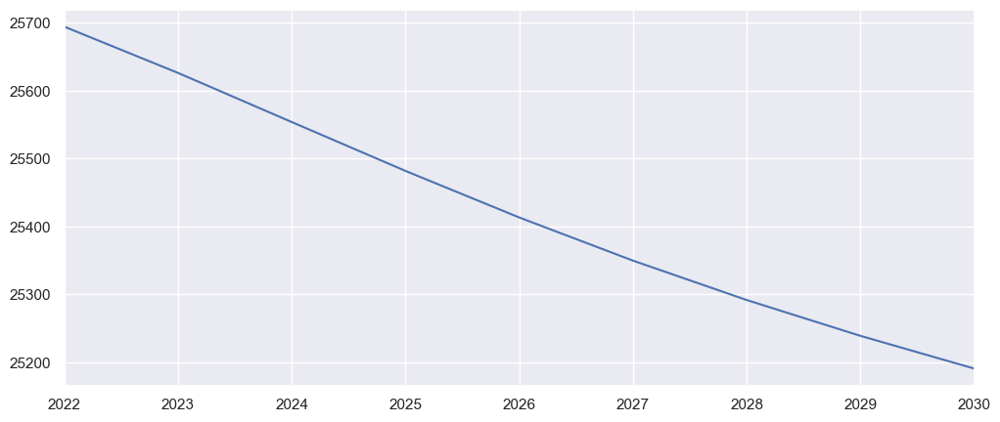

In [432]:
predictions['primary_energy_consumption'].plot(figsize=(12,5))

In [433]:
predictions['primary_energy_consumption']

2022-01-01    25694.219643
2023-01-01    25626.146720
2024-01-01    25553.781606
2025-01-01    25481.815618
2026-01-01    25413.260555
2027-01-01    25349.714521
2028-01-01    25291.690846
2029-01-01    25238.950446
2030-01-01    25190.799037
Freq: AS-JAN, Name: primary_energy_consumption, dtype: float64

# 3.Time Series analysis and Forecasting for "Canada"

# Data Pre-Processing

In [434]:
#Taking the canada country data only for further analysis
df_canada=df_world_renw_1[df_world_renw['country'].isin(['Canada'])]
df_canada

,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
3601,Canada,1900,CAN,NaN,NaN,NaN
3602,Canada,1901,CAN,NaN,NaN,NaN
3603,Canada,1902,CAN,NaN,NaN,NaN
3604,Canada,1903,CAN,NaN,NaN,NaN
3605,Canada,1904,CAN,NaN,NaN,NaN
...,...,...,...,...,...,...
3718,Canada,2017,CAN,1201.782,29.674,4049.998
3719,Canada,2018,CAN,1176.791,28.815,4084.020
3720,Canada,2019,CAN,1161.750,28.586,4064.001
3721,Canada,2020,CAN,1172.686,30.542,3839.567


In [435]:
#Checking whether there are any null values in dataset
df_canada.isnull().sum()

country                        0
year                           0
iso_code                       0
renewables_consumption        65
renewables_share_energy       65
primary_energy_consumption    65
dtype: int64

Just like China ,this country also doesnot have any data in the forst few decades of 19th century ,so drop the rows corresponding those years

In [436]:
df_canada.dropna(inplace=True)
df_canada.head()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1244756893.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
3666,Canada,1965,CAN,349.185,25.139,1389.036
3667,Canada,1966,CAN,387.366,26.195,1478.791
3668,Canada,1967,CAN,396.012,25.610,1546.292
3669,Canada,1968,CAN,402.742,24.474,1645.590
3670,Canada,1969,CAN,445.435,25.521,1745.348


In [437]:
df_canada.year=pd.to_datetime(df_canada.year,format='%Y', errors='coerce')


C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2007937400.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [439]:
df_canada_no_index=df_canada[['year','renewables_consumption']]
df_canada_no_index.head()

,year,renewables_consumption
3666,1965-01-01,349.185
3667,1966-01-01,387.366
3668,1967-01-01,396.012
3669,1968-01-01,402.742
3670,1969-01-01,445.435


In [440]:
df_canada_No_index_rshare=df_canada[['year','renewables_share_energy']]
df_canada_No_index_rshare.head()

,year,renewables_share_energy
3666,1965-01-01,25.139
3667,1966-01-01,26.195
3668,1967-01-01,25.610
3669,1968-01-01,24.474
3670,1969-01-01,25.521


In [438]:
df_canada_No_index_tenergy=df_canada[['year','primary_energy_consumption']]
df_canada_No_index_tenergy.head()

,year,primary_energy_consumption
3666,1965-01-01,1389.036
3667,1966-01-01,1478.791
3668,1967-01-01,1546.292
3669,1968-01-01,1645.590
3670,1969-01-01,1745.348


In [441]:
df_canada.set_index("year",inplace=True)
df_canada.head()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
year,,,,,
1965-01-01,Canada,CAN,349.185,25.139,1389.036
1966-01-01,Canada,CAN,387.366,26.195,1478.791
1967-01-01,Canada,CAN,396.012,25.610,1546.292
1968-01-01,Canada,CAN,402.742,24.474,1645.590
1969-01-01,Canada,CAN,445.435,25.521,1745.348


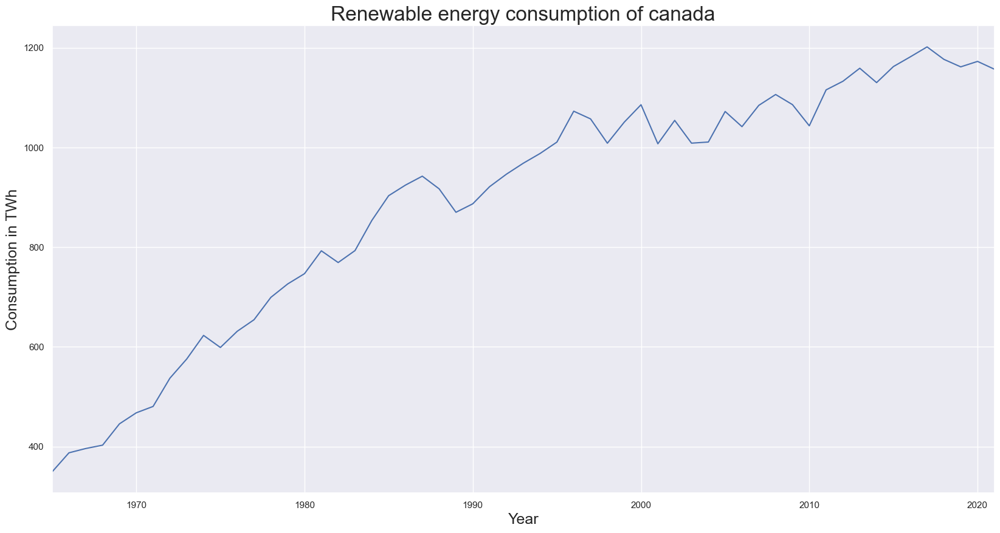

In [442]:
df_canada.renewables_consumption.plot(figsize=(20,10))
plt.title("Renewable energy consumption of canada",size=24)
plt.ylabel("Consumption in TWh",size=18)
plt.xlabel("Year",size=18)
plt.show()

# Seasonality Check

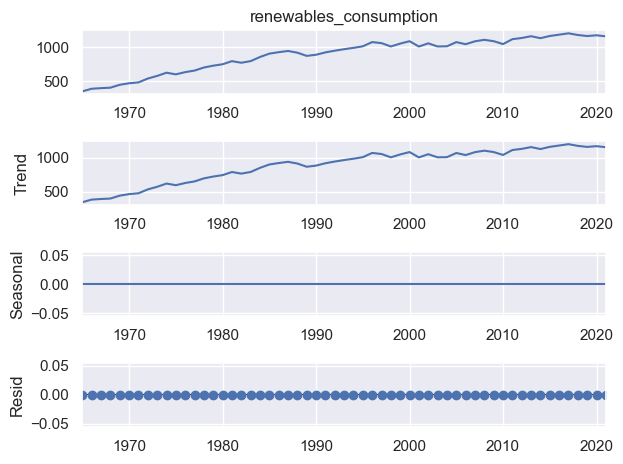

In [443]:
seas_decompose_additive_canada= seasonal_decompose(df_canada.renewables_consumption,model="additive")
seas_decompose_additive_canada.plot()
plt.show()

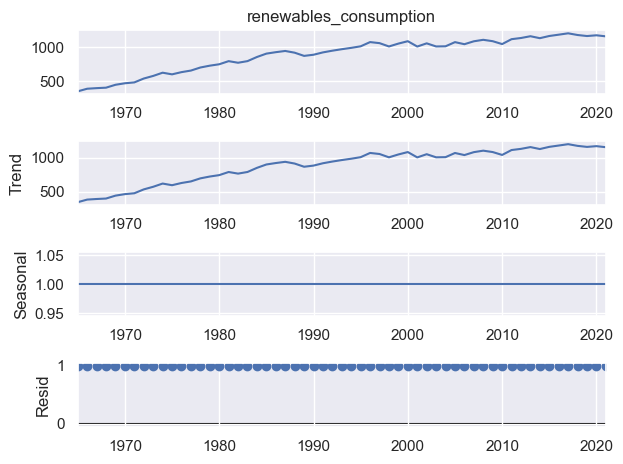

In [444]:
seas_decompose_multiplicative_canada= seasonal_decompose(df_canada.renewables_consumption,model="multiplicative",period=1)
seas_decompose_multiplicative_canada.plot()
plt.show()

It shows from the two methods that,there is Upward trend and No seasonality for consumption data of Canada country

# Stationarity Check

In [445]:
result = adfuller(df_canada.renewables_consumption)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - canada Time Series is Stationary")
else:
    print ("Failed to Reject Ho - canada Time Series is Non-Stationary")

ADF Statistic: -2.456463
p-value: 0.126430
Critical Values:
	1%: -3.553
	5%: -2.915
	10%: -2.595
Failed to Reject Ho - canada Time Series is Non-Stationary


In [446]:
#Lets Fit ARIMA Model As it is a Non-stationary Data
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_canada=ARIMA(df_canada.renewables_consumption[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_canada=model_AR_I_MA_111_canada.fit()
#print the summary of model results
results_AR_I_MA_111_canada.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     renewables_consumption   No. Observations:                   56
Model:                     ARIMA(1, 1, 1)   Log Likelihood                -271.627
Date:                    Thu, 27 Jul 2023   AIC                            549.255
Time:                            14:10:44   BIC                            555.277
Sample:                        01-01-1966   HQIC                           551.583
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9921      0.017     57.537      0.000       0.958       1.026
ma.L1         -0.9443      0.072    -13.062      0.000      -1.086      -0.803
sigma2      1123.5109    243.752      4.609      0.000     645.766    1601.256
===================================================================================
Ljung-Box (L1) (Q):                   1.08   Jarque-Bera (JB):                 4.08
Prob(Q):                              0.30   Prob(JB):                         0.13
Heteroskedasticity (H):               1.45   Skew:                            -0.67
Prob(H) (two-sided):                  0.44   Kurtosis:                         2.96
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\4200091254.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



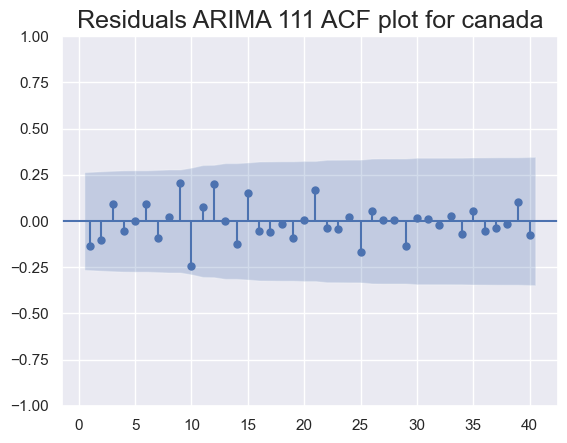

In [447]:
#All coefiicients are significant,Lets see Residuals plot to check whether any higher lags are significant
df_canada['residuals_ARIMA_111_canada']=results_AR_I_MA_111_canada.resid
sgt.plot_acf(df_canada.residuals_ARIMA_111_canada[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for canada",size=18)
plt.show()

## Checking Stationarity of Time Series 

In [448]:
#We have decided No higher lags are significant ,before conclusing lets check whether it is stationary or not
df_canada['canada_ren_consumption']=df_canada.renewables_consumption.diff(1)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\4097965887.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [449]:
#To comapre ARIMA 111 results with manually integrated time series ,performing arma 11 for integrated series
#As Arima(1,0,1) should equal to Arma(1,1) of manully integrated series
#All of this are doing to check after the first integration whether the series is statioanry or not
model_AR_I_MA_101_canada=ARIMA(df_canada.canada_ren_consumption[2:],order=(1,0,1))
results_AR_I_MA_101_canada=model_AR_I_MA_101_canada.fit()
results_AR_I_MA_101_canada.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     canada_ren_consumption   No. Observations:                   55
Model:                     ARIMA(1, 0, 1)   Log Likelihood                -269.687
Date:                    Thu, 27 Jul 2023   AIC                            547.373
Time:                            14:10:46   BIC                            555.403
Sample:                        01-01-1967   HQIC                           550.478
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         14.1307      4.171      3.388      0.001       5.955      22.306
ar.L1          0.2319      0.803      0.289      0.773      -1.343       1.807
ma.L1         -0.3755      0.781     -0.481      0.631      -1.906       1.155
sigma2      1062.6535    247.615      4.292      0.000     577.337    1547.970
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                 4.41
Prob(Q):                              0.97   Prob(JB):                         0.11
Heteroskedasticity (H):               1.39   Skew:                            -0.69
Prob(H) (two-sided):                  0.49   Kurtosis:                         2.82
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [450]:
result = adfuller(df_canada.canada_ren_consumption[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -8.237749
p-value: 0.000000
Critical Values:
	1%: -3.555
	5%: -2.916
	10%: -2.596
Reject Ho - Time Series is Stationary


# Predicting Using ARIMA(1,1,1) 

In [451]:
size_canada=int(len(df_canada)*0.8)
size_canada

45

In [452]:
df_canada_train=df_canada.iloc[:size_canada]
df_canada_test=df_canada.iloc[size_canada:]

In [453]:
#let us check the ending year of training dataset ,so that starting date can be put as next year
df_canada_train.head()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption,residuals_ARIMA_111_canada,canada_ren_consumption
year,,,,,,,
1965-01-01,Canada,CAN,349.185,25.139,1389.036,NaN,NaN
1966-01-01,Canada,CAN,387.366,26.195,1478.791,387.366000,38.181
1967-01-01,Canada,CAN,396.012,25.610,1546.292,8.562077,8.646
1968-01-01,Canada,CAN,402.742,24.474,1645.590,5.204892,6.730
1969-01-01,Canada,CAN,445.435,25.521,1745.348,40.428509,42.693


In [454]:
df_canada_test.tail()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption,residuals_ARIMA_111_canada,canada_ren_consumption
year,,,,,,,
2017-01-01,Canada,CAN,1201.782,29.674,4049.998,9.464815,20.041
2018-01-01,Canada,CAN,1176.791,28.815,4084.020,-35.938932,-24.991
2019-01-01,Canada,CAN,1161.750,28.586,4064.001,-24.176510,-15.041
2020-01-01,Canada,CAN,1172.686,30.542,3839.567,3.033194,10.936
2021-01-01,Canada,CAN,1157.028,29.888,3871.156,-23.644304,-15.658


C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



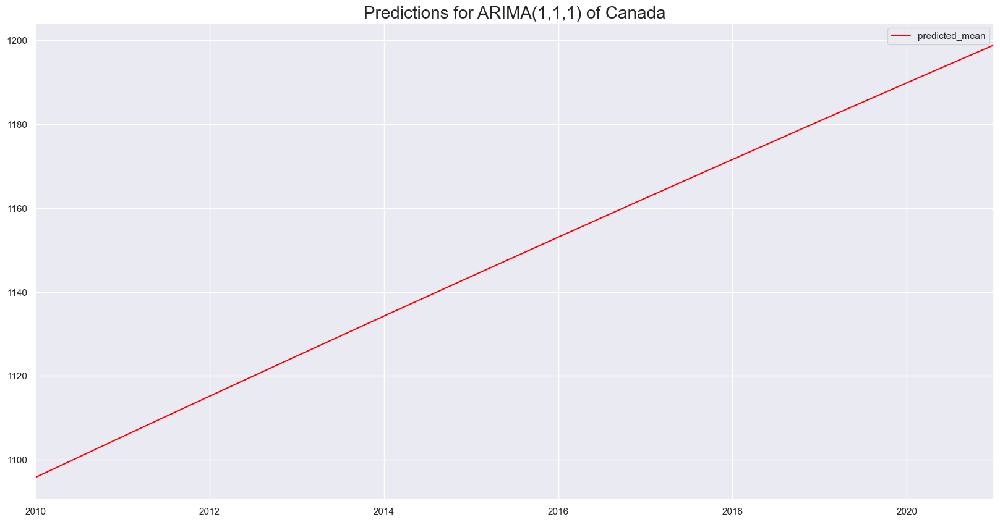

In [455]:
#Let us fit the model for only training dataset
model_Arima_111_canada=ARIMA(df_canada_train.renewables_consumption[1:],order=(1,1,1))
model_Arima_111_canada=model_Arima_111_canada.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_canada_Arima_111_predict=model_Arima_111_canada.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_canada_Arima_111_predict[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for ARIMA(1,1,1) of Canada",size=20)
plt.show()

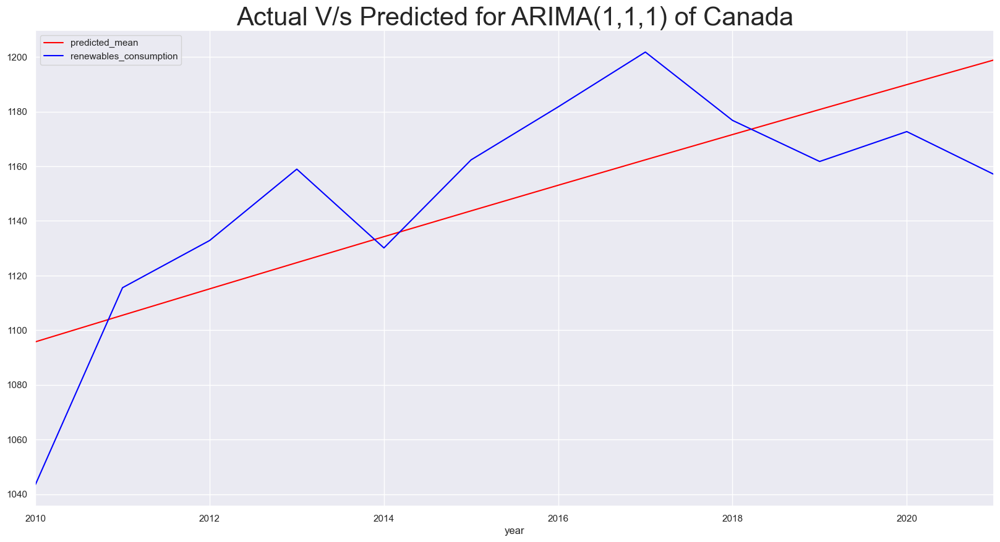

In [456]:
#Let us compare the test data and predicted values
df_canada_Arima_111_predict.plot(figsize=(20,10),color="red",legend=True)
df_canada_test.renewables_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for ARIMA(1,1,1) of Canada",size=30)
plt.show()

In [457]:
rmse_111_canada=sqrt(mean_squared_error(df_canada_Arima_111_predict,df_canada_test['renewables_consumption']))
mse_111_canada=mean_squared_error(df_canada_Arima_111_predict,df_canada_test['renewables_consumption'])
mae_canada = np.mean(np.abs(df_canada_Arima_111_predict  - df_canada_test['renewables_consumption']))
print("Root Mean Squared Error for ARIMA(1,2,1): ",rmse_111_canada)
print("Mean Squared Error for ARIMA(1,2,1): ",mse_111_canada)
print("Mean absolute Error for ARIMA(1,2,1): ",mae_canada)

Root Mean Squared Error for ARIMA(1,2,1):  28.12917271029329
Mean Squared Error for ARIMA(1,2,1):  791.2503573655086
Mean absolute Error for ARIMA(1,2,1):  24.031474930172067


In [458]:
mean_absolute_percentage_error(y_true=df_canada_test['renewables_consumption'],
                   y_pred=df_canada_Arima_111_predict)

2.1053266151164807

## 2.Predictions for Renewable share

In [501]:
df_canada_rshare=df_canada[['renewables_share_energy']]
df_canada_rshare.head()

,renewables_share_energy
year,
1965-01-01,25.139
1966-01-01,26.195
1967-01-01,25.610
1968-01-01,24.474
1969-01-01,25.521


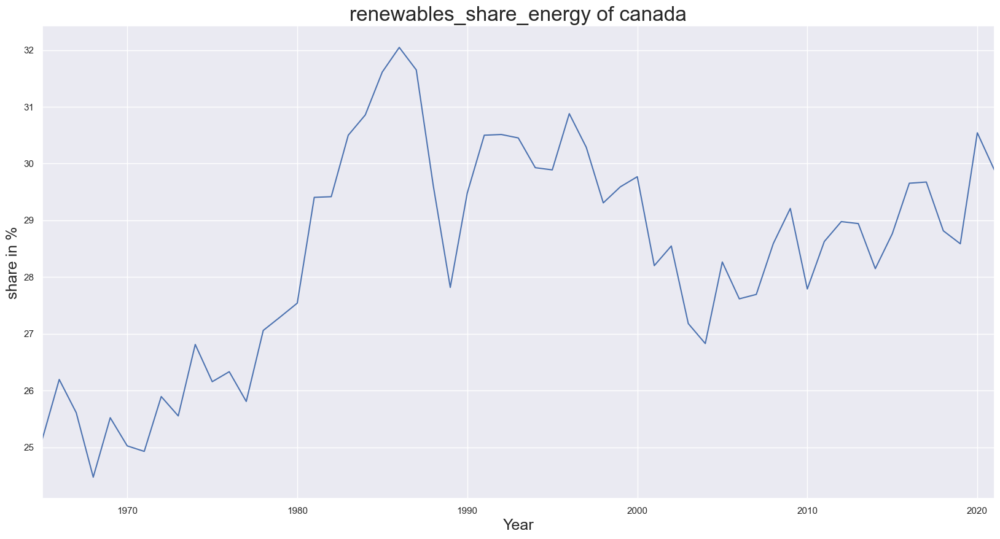

In [502]:
df_canada.renewables_share_energy.plot(figsize=(20,10))
plt.title("renewables_share_energy of canada",size=24)
plt.ylabel("share in %",size=18)
plt.xlabel("Year",size=18)
plt.show()

## Seasonality Checking

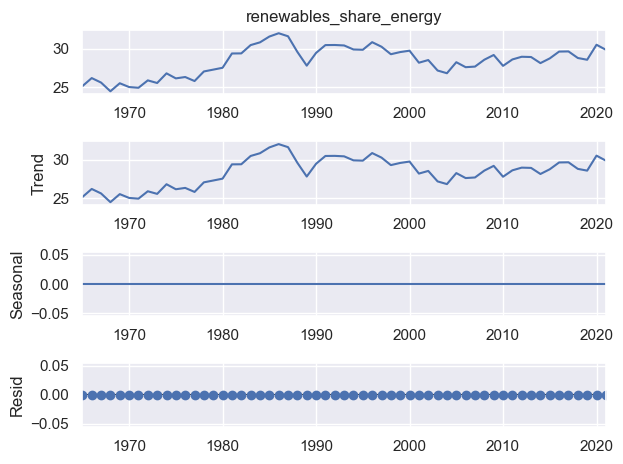

In [503]:
seas_decompose_additive= seasonal_decompose(df_canada.renewables_share_energy,model="additive")
seas_decompose_additive.plot()
plt.show()

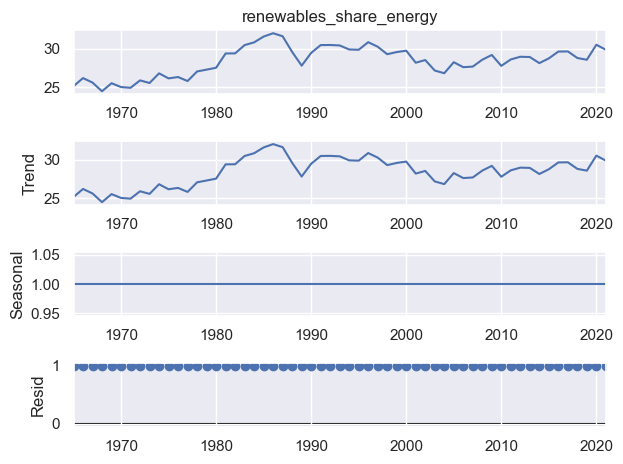

In [504]:
seas_decompose_multiplicative= seasonal_decompose(df_canada.renewables_share_energy,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

From both the methods it is clear that,there is no proof of seasonality

In [505]:
result = adfuller(df_canada.renewables_share_energy)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - canada Time Series is Stationary")
else:
    print ("Failed to Reject Ho - canada Time Series is Non-Stationary")

ADF Statistic: -2.169797
p-value: 0.217389
Critical Values:
	1%: -3.553
	5%: -2.915
	10%: -2.595
Failed to Reject Ho - canada Time Series is Non-Stationary


## ARIMA 

In [506]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_rshare=ARIMA(df_canada.renewables_share_energy[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_rshare=model_AR_I_MA_111_rshare.fit()
#print the summary of model results
results_AR_I_MA_111_rshare.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     renewables_share_energy   No. Observations:                   56
Model:                      ARIMA(1, 1, 1)   Log Likelihood                 -72.284
Date:                     Thu, 27 Jul 2023   AIC                            150.568
Time:                             14:19:57   BIC                            156.590
Sample:                         01-01-1966   HQIC                           152.897
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4436      0.594      0.747      0.455      -0.721       1.608
ma.L1         -0.5717      0.552     -1.035      0.301      -1.654       0.511
sigma2         0.8106      0.180      4.515      0.000       0.459       1.163
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):                 0.72
Prob(Q):                              0.91   Prob(JB):                         0.70
Heteroskedasticity (H):               0.91   Skew:                            -0.25
Prob(H) (two-sided):                  0.84   Kurtosis:                         2.76
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1439784973.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



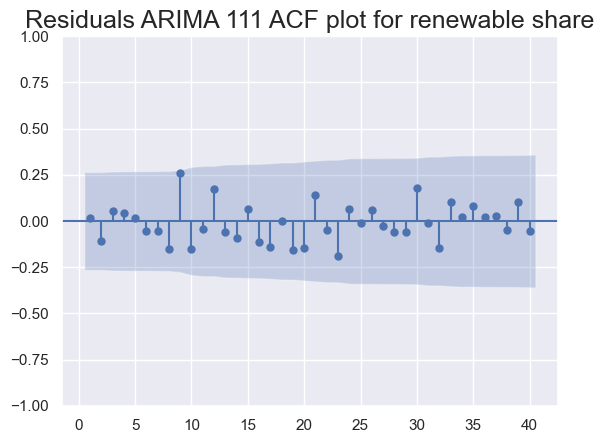

In [507]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_canada['residuals_ARIMA_111_rshare']=results_AR_I_MA_111_rshare.resid
sgt.plot_acf(df_canada.residuals_ARIMA_111_rshare[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for renewable share",size=18)
plt.show()

## Checking Stationarity

In [508]:
df_canada['canada_renewables_share_energy_1']=df_canada.renewables_share_energy.diff(1)
model_AR_I_MA_101_canada=ARIMA(df_canada.canada_renewables_share_energy_1[2:],order=(1,0,1))
results_AR_I_MA_101_canada=model_AR_I_MA_101_canada.fit()
results_AR_I_MA_101_canada.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3270417802.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                       
============================================================================================
Dep. Variable:     canada_renewables_share_energy_1   No. Observations:                   55
Model:                               ARIMA(1, 0, 1)   Log Likelihood                 -71.976
Date:                              Thu, 27 Jul 2023   AIC                            151.953
Time:                                      14:22:13   BIC                            159.982
Sample:                                  01-01-1967   HQIC                           155.058
                                       - 01-01-2021                                         
Covariance Type:                                opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0718      0.094      0.761      0.447      -0.113       0.257
ar.L1          0.5110      0.464      1.102      0.271      -0.398       1.420
ma.L1         -0.6510      0.415     -1.567      0.117      -1.465       0.163
sigma2         0.8014      0.180      4.460      0.000       0.449       1.154
===================================================================================
Ljung-Box (L1) (Q):                   0.04   Jarque-Bera (JB):                 0.72
Prob(Q):                              0.85   Prob(JB):                         0.70
Heteroskedasticity (H):               0.92   Skew:                            -0.25
Prob(H) (two-sided):                  0.85   Kurtosis:                         2.74
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [509]:
result = adfuller(df_canada.canada_renewables_share_energy_1[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -6.513351
p-value: 0.000000
Critical Values:
	1%: -3.558
	5%: -2.917
	10%: -2.596
Reject Ho - Time Series is Stationary


SO Arima (1,1,1) would be suitable model

## Predicting Using ARIMA (1,1,1) 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



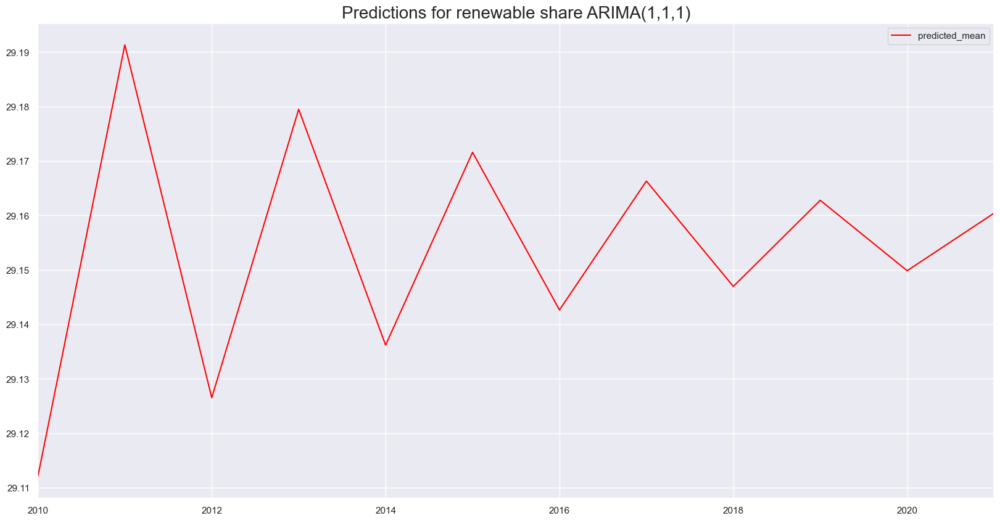

In [510]:
#Let us fit the model for only training dataset
model_Arima_111_rshare=ARIMA(df_canada_train.renewables_share_energy[1:],order=(1,1,1))
model_Arima_111_rshare=model_Arima_111_rshare.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_canada_Arima_111_predict_rshare=model_Arima_111_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_canada_Arima_111_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for renewable share ARIMA(1,1,1)",size=20)
plt.show()

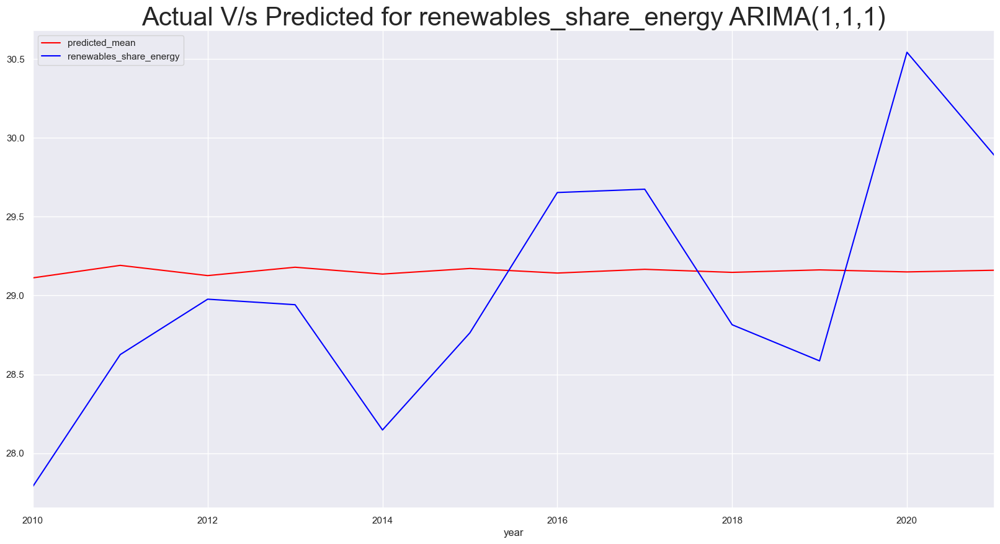

In [511]:
#Let us compare the test data and predicted values
df_canada_Arima_111_predict_rshare.plot(figsize=(20,10),color="red",legend=True)
df_canada_test.renewables_share_energy.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for renewables_share_energy ARIMA(1,1,1)",size=30)
plt.show()

In [512]:
rmse=sqrt(mean_squared_error(df_canada_Arima_111_predict_rshare,df_canada_test['renewables_share_energy']))
print(rmse)

0.748186142663666


In [513]:
mean_absolute_percentage_error(y_true=df_canada_test['renewables_share_energy'],
                   y_pred=df_canada_Arima_111_predict_rshare)

2.215895212311243

## 3.Predictions for Total energy

In [514]:
df_canada_tenergy=df_canada[['primary_energy_consumption']]
df_canada_tenergy.head()

,primary_energy_consumption
year,
1965-01-01,1389.036
1966-01-01,1478.791
1967-01-01,1546.292
1968-01-01,1645.590
1969-01-01,1745.348


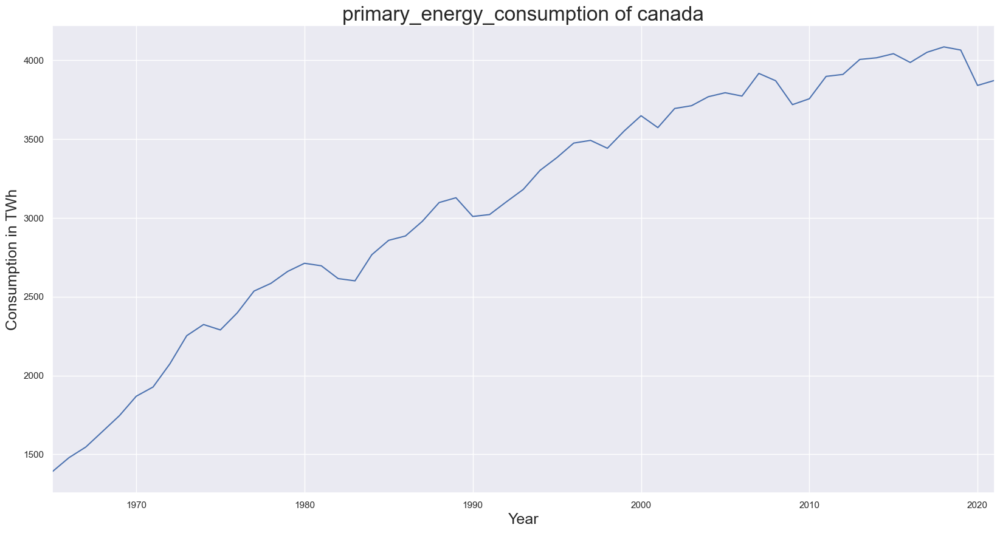

In [515]:
df_canada.primary_energy_consumption.plot(figsize=(20,10))
plt.title("primary_energy_consumption of canada",size=24)
plt.ylabel("Consumption in TWh",size=18)
plt.xlabel("Year",size=18)
plt.show()

## Seasonality Checking

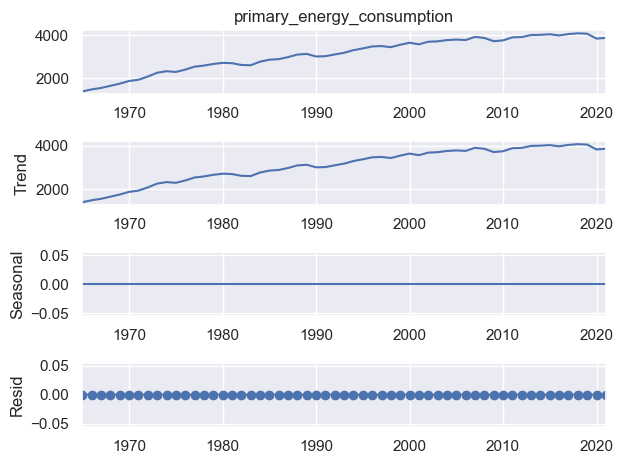

In [516]:
seas_decompose_additive= seasonal_decompose(df_canada.primary_energy_consumption,model="additive")
seas_decompose_additive.plot()
plt.show()

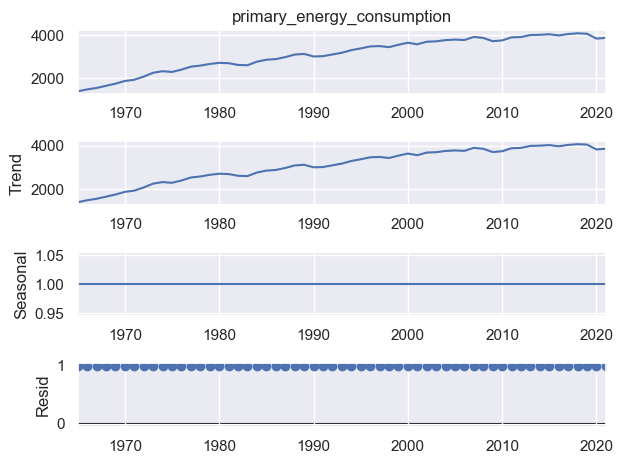

In [517]:
seas_decompose_multiplicative= seasonal_decompose(df_canada.primary_energy_consumption,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

From both the methods it is clear that,there is no proof of seasonaloty

In [518]:
result = adfuller(df_canada.primary_energy_consumption)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - canadaTime Series is Stationary")
else:
    print ("Failed to Reject Ho - canada Time Series is Non-Stationary")

ADF Statistic: -1.449874
p-value: 0.558147
Critical Values:
	1%: -3.585
	5%: -2.928
	10%: -2.602
Failed to Reject Ho - canada Time Series is Non-Stationary


## ARIMA 

In [519]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_tenergy=ARIMA(df_canada.primary_energy_consumption[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_tenergy=model_AR_I_MA_111_tenergy.fit()
#print the summary of model results
results_AR_I_MA_111_tenergy.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                   SARIMAX Results                                    
======================================================================================
Dep. Variable:     primary_energy_consumption   No. Observations:                   56
Model:                         ARIMA(1, 1, 1)   Log Likelihood                -322.333
Date:                        Thu, 27 Jul 2023   AIC                            650.666
Time:                                14:32:42   BIC                            656.688
Sample:                            01-01-1966   HQIC                           652.995
                                 - 01-01-2021                                         
Covariance Type:                          opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0119      0.461     -0.026      0.979      -0.915       0.891
ma.L1          0.4004      0.435      0.920      0.358      -0.453       1.253
sigma2      7193.3381   1630.675      4.411      0.000    3997.274    1.04e+04
===================================================================================
Ljung-Box (L1) (Q):                   1.25   Jarque-Bera (JB):                 4.49
Prob(Q):                              0.26   Prob(JB):                         0.11
Heteroskedasticity (H):               1.31   Skew:                            -0.68
Prob(H) (two-sided):                  0.58   Kurtosis:                         3.37
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3418902784.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



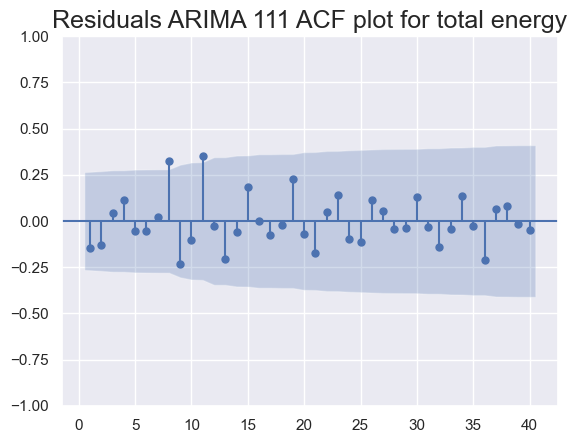

In [520]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_canada['residuals_ARIMA_111_tenergy']=results_AR_I_MA_111_tenergy.resid
sgt.plot_acf(df_canada.residuals_ARIMA_111_tenergy[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for total energy",size=18)
plt.show()

Lags 8 and 11 are significant

## Checking Stationarity

In [521]:
df_canada['canada_primary_energy_consumption_1']=df_canada.primary_energy_consumption.diff(1)
model_AR_I_MA_101_canada=ARIMA(df_canada.canada_primary_energy_consumption_1[2:],order=(1,0,1))
results_AR_I_MA_101_canada=model_AR_I_MA_101_canada.fit()
results_AR_I_MA_101_canada.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2395431949.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                        SARIMAX Results                                        
===============================================================================================
Dep. Variable:     canada_primary_energy_consumption_1   No. Observations:                   55
Model:                                  ARIMA(1, 0, 1)   Log Likelihood                -317.283
Date:                                 Thu, 27 Jul 2023   AIC                            642.567
Time:                                         14:35:55   BIC                            650.596
Sample:                                     01-01-1967   HQIC                           645.672
                                          - 01-01-2021                                         
Covariance Type:                                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         43.8577     14.765      2.970      0.003      14.918      72.798
ar.L1         -0.3334      0.508     -0.656      0.512      -1.330       0.663
ma.L1          0.5762      0.451      1.277      0.202      -0.308       1.460
sigma2      5992.5656   1236.298      4.847      0.000    3569.467    8415.664
===================================================================================
Ljung-Box (L1) (Q):                   0.04   Jarque-Bera (JB):                 8.94
Prob(Q):                              0.84   Prob(JB):                         0.01
Heteroskedasticity (H):               1.92   Skew:                            -0.88
Prob(H) (two-sided):                  0.18   Kurtosis:                         3.89
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [522]:
result = adfuller(df_canada.canada_primary_energy_consumption_1[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -1.363468
p-value: 0.599660
Critical Values:
	1%: -3.585
	5%: -2.928
	10%: -2.602
Failed to Reject Ho - Time Series is Non-Stationary


In [523]:
df_canada['canada_primary_energy_consumption_2']=df_canada.primary_energy_consumption.diff(2)
model_AR_I_MA_101_canada=ARIMA(df_canada.canada_primary_energy_consumption_2[2:],order=(1,0,1))
results_AR_I_MA_101_canada=model_AR_I_MA_101_canada.fit()
results_AR_I_MA_101_canada.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1663349659.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non

<class 'statsmodels.iolib.summary.Summary'>
"""
                                        SARIMAX Results                                        
===============================================================================================
Dep. Variable:     canada_primary_energy_consumption_2   No. Observations:                   55
Model:                                  ARIMA(1, 0, 1)   Log Likelihood                -320.253
Date:                                 Thu, 27 Jul 2023   AIC                            648.507
Time:                                         14:37:02   BIC                            656.536
Sample:                                     01-01-1967   HQIC                           651.612
                                          - 01-01-2021                                         
Covariance Type:                                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         88.0980     29.045      3.033      0.002      31.171     145.024
ar.L1          0.1751      0.184      0.952      0.341      -0.185       0.535
ma.L1          0.9472      0.103      9.182      0.000       0.745       1.149
sigma2      6375.6583   1337.054      4.768      0.000    3755.081    8996.235
===================================================================================
Ljung-Box (L1) (Q):                   0.14   Jarque-Bera (JB):                 6.55
Prob(Q):                              0.71   Prob(JB):                         0.04
Heteroskedasticity (H):               1.73   Skew:                            -0.78
Prob(H) (two-sided):                  0.25   Kurtosis:                         3.63
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [524]:
result = adfuller(df_canada.canada_primary_energy_consumption_2[2:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -1.267620
p-value: 0.643853
Critical Values:
	1%: -3.585
	5%: -2.928
	10%: -2.602
Failed to Reject Ho - Time Series is Non-Stationary


In [525]:
df_canada['canada_primary_energy_consumption_3']=df_canada.primary_energy_consumption.diff(3)
model_AR_I_MA_101_canada=ARIMA(df_canada.canada_primary_energy_consumption_3[2:],order=(1,0,1))
results_AR_I_MA_101_canada=model_AR_I_MA_101_canada.fit()
results_AR_I_MA_101_canada.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2815082101.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                        SARIMAX Results                                        
===============================================================================================
Dep. Variable:     canada_primary_energy_consumption_3   No. Observations:                   55
Model:                                  ARIMA(1, 0, 1)   Log Likelihood                -322.074
Date:                                 Thu, 27 Jul 2023   AIC                            652.149
Time:                                         14:38:15   BIC                            660.178
Sample:                                     01-01-1967   HQIC                           655.254
                                          - 01-01-2021                                         
Covariance Type:                                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        131.1741     48.644      2.697      0.007      35.833     226.515
ar.L1          0.5814      0.168      3.457      0.001       0.252       0.911
ma.L1          0.3855      0.211      1.829      0.067      -0.028       0.798
sigma2      8713.9827   1804.461      4.829      0.000    5177.304    1.23e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.22   Jarque-Bera (JB):                 8.66
Prob(Q):                              0.64   Prob(JB):                         0.01
Heteroskedasticity (H):               2.21   Skew:                            -0.88
Prob(H) (two-sided):                  0.10   Kurtosis:                         3.82
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [526]:
result = adfuller(df_canada.canada_primary_energy_consumption_3[3:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -2.035126
p-value: 0.271387
Critical Values:
	1%: -3.597
	5%: -2.933
	10%: -2.605
Failed to Reject Ho - Time Series is Non-Stationary


In [527]:
df_canada['canada_primary_energy_consumption_4']=df_canada.primary_energy_consumption.diff(4)
model_AR_I_MA_101_canada=ARIMA(df_canada.canada_primary_energy_consumption_4[2:],order=(1,0,1))
results_AR_I_MA_101_canada=model_AR_I_MA_101_canada.fit()
results_AR_I_MA_101_canada.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\738214780.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                        SARIMAX Results                                        
===============================================================================================
Dep. Variable:     canada_primary_energy_consumption_4   No. Observations:                   55
Model:                                  ARIMA(1, 0, 1)   Log Likelihood                -315.264
Date:                                 Thu, 27 Jul 2023   AIC                            638.528
Time:                                         14:38:55   BIC                            646.557
Sample:                                     01-01-1967   HQIC                           641.633
                                          - 01-01-2021                                         
Covariance Type:                                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        180.7100     44.609      4.051      0.000      93.277     268.143
ar.L1          0.5029      0.154      3.268      0.001       0.201       0.804
ma.L1          0.7628      0.124      6.133      0.000       0.519       1.007
sigma2      8304.9056   1947.780      4.264      0.000    4487.326    1.21e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.52   Jarque-Bera (JB):                 0.24
Prob(Q):                              0.47   Prob(JB):                         0.88
Heteroskedasticity (H):               2.21   Skew:                            -0.10
Prob(H) (two-sided):                  0.10   Kurtosis:                         2.73
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [528]:
result = adfuller(df_canada.canada_primary_energy_consumption_4[4:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -1.770037
p-value: 0.395435
Critical Values:
	1%: -3.578
	5%: -2.925
	10%: -2.601
Failed to Reject Ho - Time Series is Non-Stationary


In [529]:
df_canada['canada_primary_energy_consumption_5']=df_canada.primary_energy_consumption.diff(5)
model_AR_I_MA_101_canada=ARIMA(df_canada.canada_primary_energy_consumption_5[2:],order=(1,0,1))
results_AR_I_MA_101_canada=model_AR_I_MA_101_canada.fit()
results_AR_I_MA_101_canada.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\4154916151.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                        SARIMAX Results                                        
===============================================================================================
Dep. Variable:     canada_primary_energy_consumption_5   No. Observations:                   55
Model:                                  ARIMA(1, 0, 1)   Log Likelihood                -315.371
Date:                                 Thu, 27 Jul 2023   AIC                            638.742
Time:                                         14:39:40   BIC                            646.771
Sample:                                     01-01-1967   HQIC                           641.847
                                          - 01-01-2021                                         
Covariance Type:                                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        232.7724     61.756      3.769      0.000     111.732     353.813
ar.L1          0.6683      0.159      4.207      0.000       0.357       0.980
ma.L1          0.4274      0.182      2.342      0.019       0.070       0.785
sigma2      1.058e+04   2620.496      4.038      0.000    5445.397    1.57e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.02   Jarque-Bera (JB):                 2.99
Prob(Q):                              0.89   Prob(JB):                         0.22
Heteroskedasticity (H):               2.04   Skew:                            -0.57
Prob(H) (two-sided):                  0.14   Kurtosis:                         3.15
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [530]:
result = adfuller(df_canada.canada_primary_energy_consumption_5[5:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -1.360171
p-value: 0.601215
Critical Values:
	1%: -3.606
	5%: -2.937
	10%: -2.607
Failed to Reject Ho - Time Series is Non-Stationary


The p-value is fluctuating,so there is inherent non-stationarity for this series

So ARIMA(8,1,1) (1,1,8) (11,1,1) and (1,1,11) need to be modelled

## Evaluating for Better Model 

In [531]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_811_tenergy=ARIMA(df_canada.primary_energy_consumption[1:],order=(8,1,1))
#fit the model
results_AR_I_MA_811_tenergy=model_AR_I_MA_811_tenergy.fit()
#print the summary of model results
results_AR_I_MA_811_tenergy.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                   SARIMAX Results                                    
======================================================================================
Dep. Variable:     primary_energy_consumption   No. Observations:                   56
Model:                         ARIMA(8, 1, 1)   Log Likelihood                -312.260
Date:                        Thu, 27 Jul 2023   AIC                            644.519
Time:                                14:58:37   BIC                            664.592
Sample:                            01-01-1966   HQIC                           652.282
                                 - 01-01-2021                                         
Covariance Type:                          opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1860      0.264     -0.705      0.481      -0.703       0.331
ar.L2         -0.0367      0.174     -0.211      0.833      -0.377       0.304
ar.L3          0.0903      0.157      0.577      0.564      -0.217       0.397
ar.L4          0.1853      0.150      1.234      0.217      -0.109       0.480
ar.L5          0.0335      0.172      0.195      0.845      -0.303       0.370
ar.L6          0.1236      0.145      0.853      0.394      -0.160       0.408
ar.L7          0.1447      0.149      0.971      0.331      -0.147       0.437
ar.L8          0.4895      0.166      2.955      0.003       0.165       0.814
ma.L1          0.4296      0.274      1.568      0.117      -0.108       0.967
sigma2      4741.6164   1121.947      4.226      0.000    2542.641    6940.592
===================================================================================
Ljung-Box (L1) (Q):                   0.07   Jarque-Bera (JB):                 2.77
Prob(Q):                              0.80   Prob(JB):                         0.25
Heteroskedasticity (H):               1.89   Skew:                            -0.55
Prob(H) (two-sided):                  0.19   Kurtosis:                         3.09
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1439887674.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



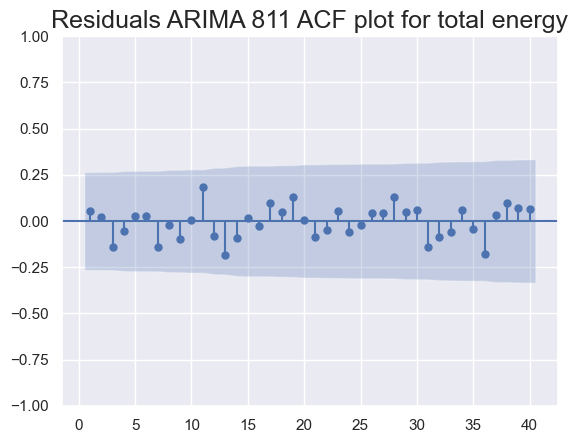

In [532]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_canada['residuals_ARIMA_811_tenergy']=results_AR_I_MA_811_tenergy.resid
sgt.plot_acf(df_canada.residuals_ARIMA_811_tenergy[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 811 ACF plot for total energy",size=18)
plt.show()

So,It captures the significant lags.11th lag effect is also considered here.SO,No need to model for 11th lag

In [533]:
LLR_test(model_AR_I_MA_111_tenergy,model_AR_I_MA_811_tenergy)

0.0

The p-value is within significance range,So it can be confirmed that higher order is the best model i.e ARIMA(8,1,1)

## Predicting Using ARIMA (8,1,1) 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



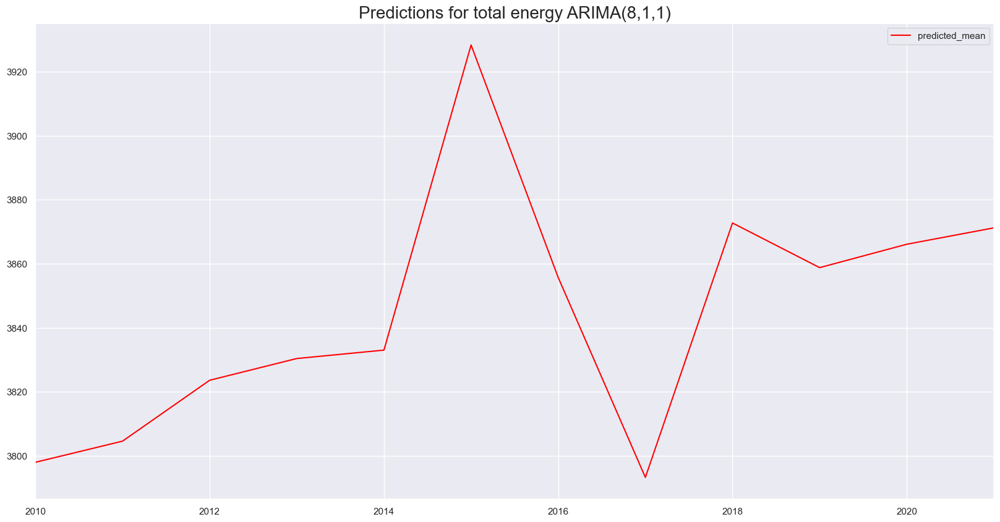

In [534]:
#Let us fit the model for only training dataset
model_Arima_811_tenergy=ARIMA(df_canada_train.primary_energy_consumption[1:],order=(8,1,1))
model_Arima_811_tenergy=model_Arima_811_tenergy.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_canada_Arima_811_predict_tenergy=model_Arima_811_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_canada_Arima_811_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for total energy ARIMA(8,1,1)",size=20)
plt.show()

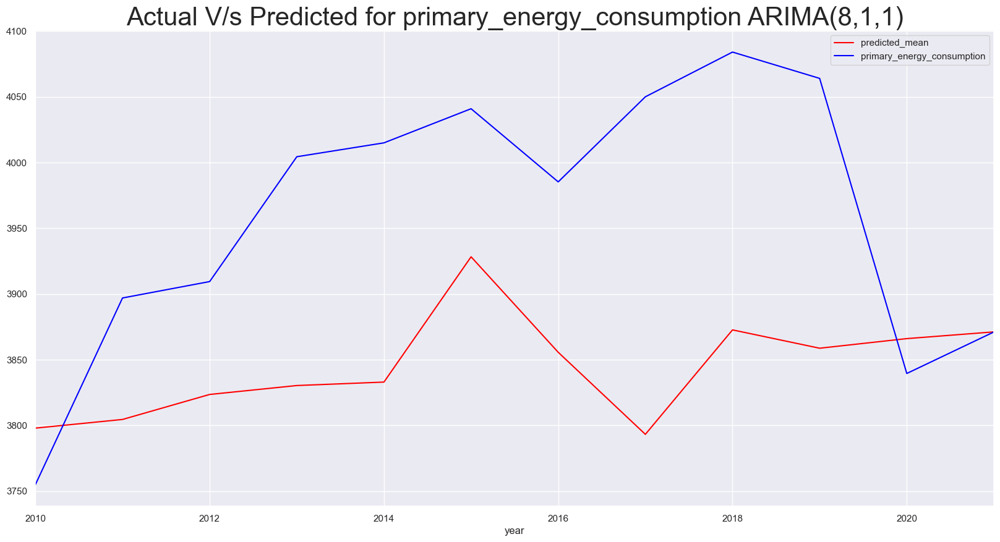

In [535]:
#Let us compare the test data and predicted values
df_canada_Arima_811_predict_tenergy.plot(figsize=(20,10),color="red",legend=True)
df_canada_test.primary_energy_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for primary_energy_consumption ARIMA(8,1,1)",size=30)
plt.show()

In [536]:
rmse=sqrt(mean_squared_error(df_canada_Arima_811_predict_tenergy,df_canada_test['primary_energy_consumption']))
print(rmse)

148.32229232277604


In [537]:
mean_absolute_percentage_error(y_true=df_canada_test['primary_energy_consumption'],
                   y_pred=df_canada_Arima_811_predict_tenergy)

3.156888998960993

## Auto Arima for Canada 

## 1. Predictions for renewable consumption 

In [459]:
model_auto_canada=auto_arima(df_canada.renewables_consumption[1:])
model_auto_canada

ARIMA(order=(0, 2, 1), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [460]:
model_auto_canada.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 2, 1)   Log Likelihood                -267.540
Date:                Thu, 27 Jul 2023   AIC                            539.080
Time:                        14:11:03   BIC                            543.058
Sample:                    01-01-1966   HQIC                           540.614
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.9444      0.066    -14.388      0.000      -1.073      -0.816
sigma2      1130.0805    205.060      5.511      0.000     728.171    1531.990
===================================================================================
Ljung-Box (L1) (Q):                   1.76   Jarque-Bera (JB):                 3.42
Prob(Q):                              0.18   Prob(JB):                         0.18
Heteroskedasticity (H):               1.77   Skew:                            -0.62
Prob(H) (two-sided):                  0.24   Kurtosis:                         2.97
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

So Auto ARIMA reccomends SARIMAX(0,2,1).yet there is no seasonality and exogenous variable here So it can be treated as ARIMA(0,2,1) and its prediction accuracy can be checked in the next step

## Predictions for Auto ARIMA

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



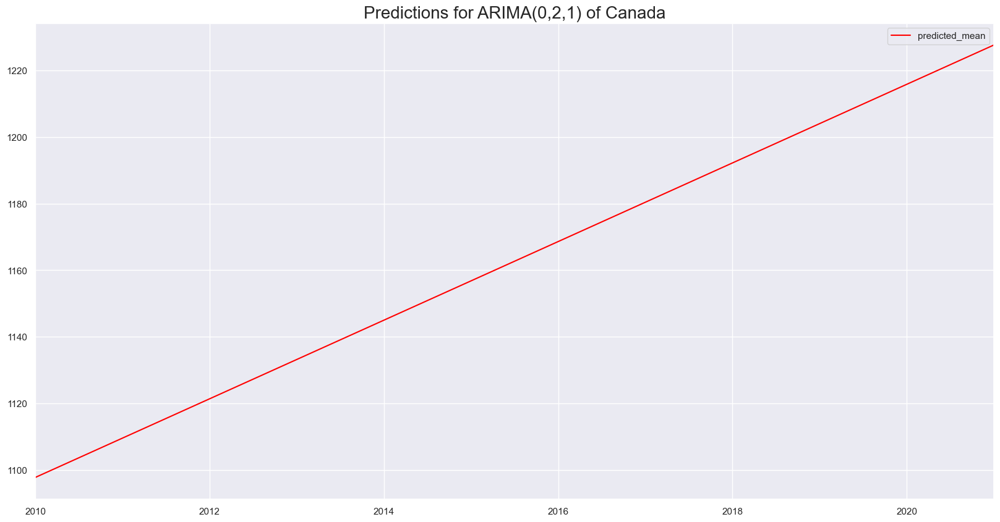

In [461]:
#Let us fit the model for only training dataset
model_Arima_021_canada=ARIMA(df_canada_train.renewables_consumption[1:],order=(0,2,1))
model_Arima_021_canada=model_Arima_021_canada.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_canada_Arima_021_predict=model_Arima_021_canada.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_canada_Arima_021_predict[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for ARIMA(0,2,1) of Canada",size=20)
plt.show()

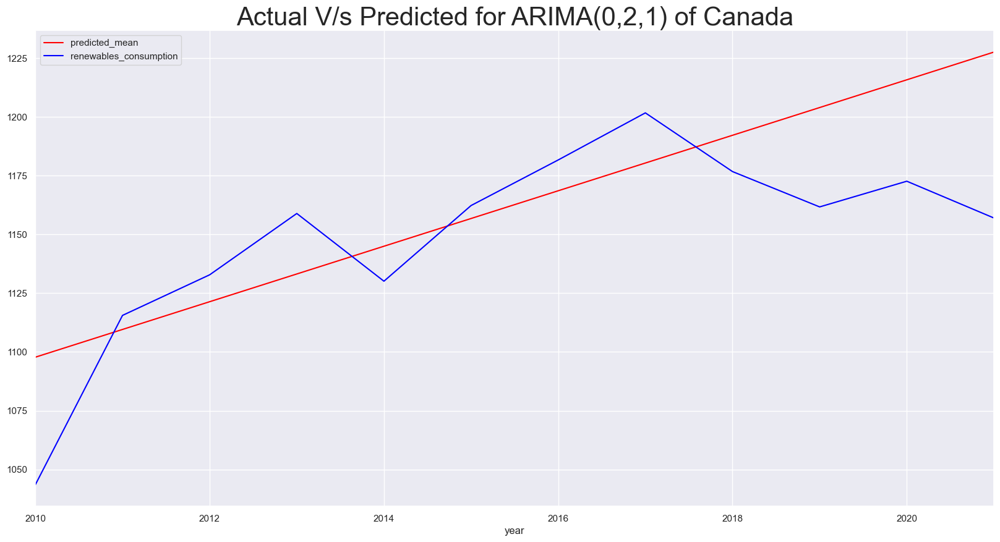

In [462]:
#Let us compare the test data and predicted values
df_canada_Arima_021_predict.plot(figsize=(20,10),color="red",legend=True)
df_canada_test.renewables_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for ARIMA(0,2,1) of Canada",size=30)
plt.show()

In [463]:
rmse_021_canada=sqrt(mean_squared_error(df_canada_Arima_021_predict,df_canada_test['renewables_consumption']))
mse_021_canada=mean_squared_error(df_canada_Arima_021_predict,df_canada_test['renewables_consumption'])
mae_canada = np.mean(np.abs(df_canada_Arima_021_predict  - df_canada_test['renewables_consumption']))
print("Root Mean Squared Error for ARIMA(0,2,1): ",rmse_021_canada)
print("Mean Squared Error for ARIMA(0,2,1): ",mse_021_canada)
print("Mean absolute Error for ARIMA(0,2,1): ",mae_canada)

Root Mean Squared Error for ARIMA(0,2,1):  33.586897189091374
Mean Squared Error for ARIMA(0,2,1):  1128.0796627905938
Mean absolute Error for ARIMA(0,2,1):  26.990787820484115


In [464]:
mean_absolute_percentage_error(y_true=df_canada_test['renewables_consumption'],
                   y_pred=df_canada_Arima_021_predict)

2.3657625343248783

## 2. Predictions for renewable share 

In [538]:
model_auto_rshare=auto_arima(df_canada.renewables_share_energy[1:])

In [539]:
model_auto_rshare

ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [540]:
model_auto_rshare.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -72.838
Date:                Thu, 27 Jul 2023   AIC                            147.677
Time:                        15:35:39   BIC                            149.684
Sample:                    01-01-1966   HQIC                           148.453
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.8276      0.177      4.667      0.000       0.480       1.175
===================================================================================
Ljung-Box (L1) (Q):                   0.49   Jarque-Bera (JB):                 0.44
Prob(Q):                              0.48   Prob(JB):                         0.80
Heteroskedasticity (H):               1.05   Skew:                            -0.10
Prob(H) (two-sided):                  0.91   Kurtosis:                         2.61
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



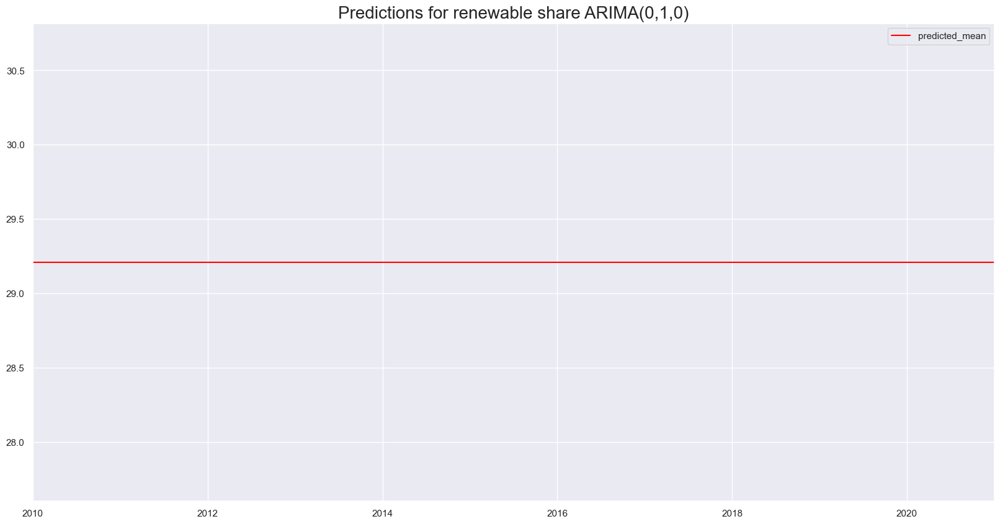

In [541]:
#Let us fit the model for only training dataset
model_Arima_010_rshare=ARIMA(df_canada_train.renewables_share_energy[1:],order=(0,1,0))
model_Arima_010_rshare=model_Arima_010_rshare.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_canada_Arima_010_predict_rshare=model_Arima_010_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_canada_Arima_010_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for renewable share ARIMA(0,1,0)",size=20)
plt.show()

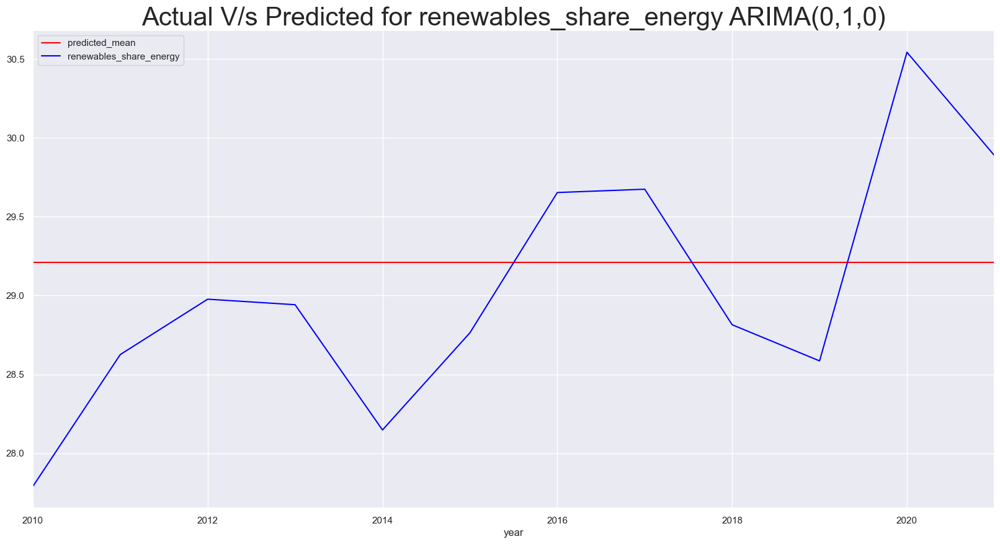

In [542]:
#Let us compare the test data and predicted values
df_canada_Arima_010_predict_rshare.plot(figsize=(20,10),color="red",legend=True)
df_canada_test.renewables_share_energy.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for renewables_share_energy ARIMA(0,1,0)",size=30)
plt.show()

In [543]:
rmse=sqrt(mean_squared_error(df_canada_Arima_010_predict_rshare,df_canada_test['renewables_share_energy']))
print(rmse)

0.7635970250509538


In [544]:
mean_absolute_percentage_error(y_true=df_canada_test['renewables_share_energy'],
                   y_pred=df_canada_Arima_010_predict_rshare)

2.285811958221311

## 3. Predictions for total energy

In [545]:
model_auto_tenergy=auto_arima(df_canada.primary_energy_consumption[1:])

In [546]:
model_auto_tenergy

ARIMA(order=(0, 2, 1), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [547]:
model_auto_tenergy.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 2, 1)   Log Likelihood                -314.061
Date:                Thu, 27 Jul 2023   AIC                            632.122
Time:                        15:40:56   BIC                            636.100
Sample:                    01-01-1966   HQIC                           633.656
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.9012      0.095     -9.527      0.000      -1.087      -0.716
sigma2      6395.4480   1133.385      5.643      0.000    4174.053    8616.843
===================================================================================
Ljung-Box (L1) (Q):                   0.02   Jarque-Bera (JB):                 5.96
Prob(Q):                              0.88   Prob(JB):                         0.05
Heteroskedasticity (H):               1.72   Skew:                            -0.78
Prob(H) (two-sided):                  0.26   Kurtosis:                         3.45
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



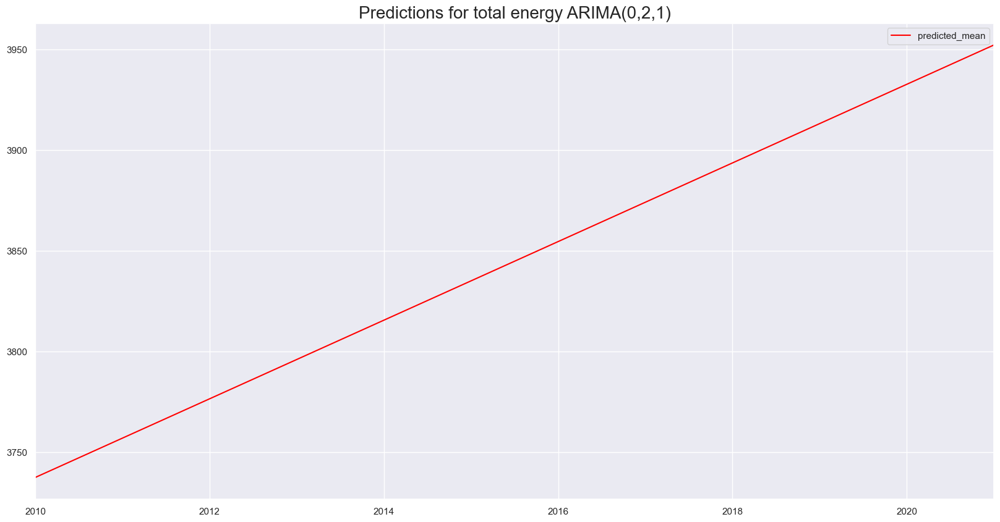

In [548]:
#Let us fit the model for only training dataset
model_Arima_021_tenergy=ARIMA(df_canada_train.primary_energy_consumption[1:],order=(0,2,1))
model_Arima_021_tenergy=model_Arima_021_tenergy.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_canada_Arima_021_predict_tenergy=model_Arima_021_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_canada_Arima_021_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for total energy ARIMA(0,2,1)",size=20)
plt.show()

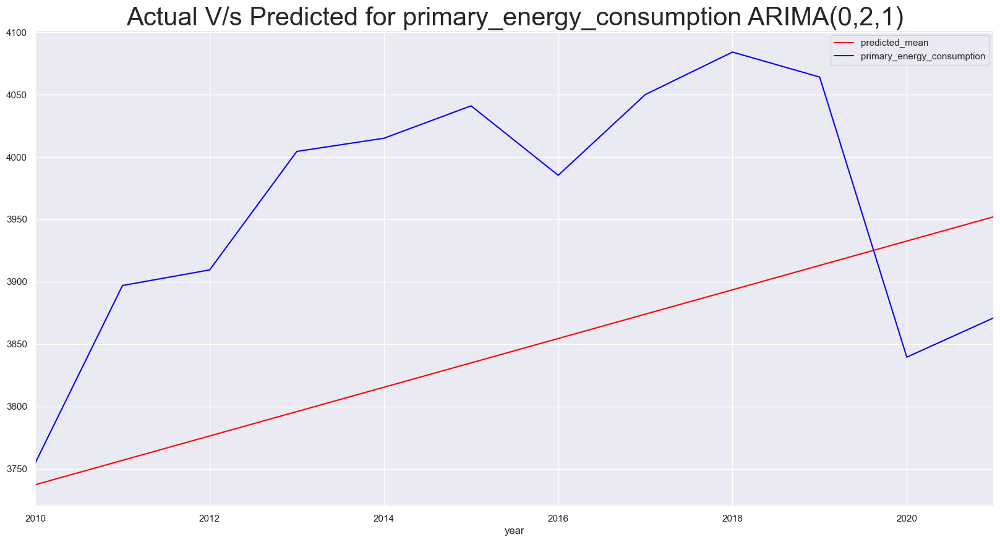

In [549]:
#Let us compare the test data and predicted values
df_canada_Arima_021_predict_tenergy.plot(figsize=(20,10),color="red",legend=True)
df_canada_test.primary_energy_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for primary_energy_consumption ARIMA(0,2,1)",size=30)
plt.show()

In [550]:
rmse=sqrt(mean_squared_error(df_canada_Arima_021_predict_tenergy,df_canada_test['primary_energy_consumption']))
print(rmse)

154.28228106582085


In [551]:
mean_absolute_percentage_error(y_true=df_canada_test['primary_energy_consumption'],
                   y_pred=df_canada_Arima_021_predict_tenergy)

3.6046693228051576

#  FB Prophet model for Canada 

## 1. Prediction for Renewable consumption 

In [465]:
df_canada_no_index.columns = ['ds','y']
df_canada_no_index.head()

,ds,y
3666,1965-01-01,349.185
3667,1966-01-01,387.366
3668,1967-01-01,396.012
3669,1968-01-01,402.742
3670,1969-01-01,445.435


In [467]:
train_canada = df_canada_no_index.iloc[:len(df_canada_no_index)-12]
test_canada = df_canada_no_index.iloc[len(df_canada_no_index)-12:]
test_canada.head()

,ds,y
3711,2010-01-01,1043.500
3712,2011-01-01,1115.566
3713,2012-01-01,1132.844
3714,2013-01-01,1158.950
3715,2014-01-01,1130.124


In [468]:
model_canada = Prophet()
model_canada.fit(train_canada)
future_canada = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast_canada = m.predict(future_canada)

14:11:40 - cmdstanpy - INFO - Chain [1] start processing
14:11:40 - cmdstanpy - INFO - Chain [1] done processing


In [469]:
forecast_canada[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,29456.554439,28122.024631,30753.766829
53,2018-01-01,29757.843977,28455.244957,31133.265151
54,2019-01-01,30113.914859,28897.400429,31449.613372
55,2020-01-01,30524.669671,29272.022533,31765.957639
56,2021-01-01,30462.299430,29100.172751,31708.670893


In [470]:
test_canada.tail()

,ds,y
3718,2017-01-01,1201.782
3719,2018-01-01,1176.791
3720,2019-01-01,1161.750
3721,2020-01-01,1172.686
3722,2021-01-01,1157.028


In [471]:
plot_plotly(model_canada,forecast_canada)


In [472]:
plot_components_plotly(model_canada, forecast_canada)


In [475]:
predictions_canada = forecast_canada.iloc[-:]['yhat']
predictions_canada.tail()

52    29456.554439
53    29757.843977
54    30113.914859
55    30524.669671
56    30462.299430
Name: yhat, dtype: float64

In [476]:
test_canada['y'].tail()

3718    1201.782
3719    1176.791
3720    1161.750
3721    1172.686
3722    1157.028
Name: y, dtype: float64

In [477]:
print("Root Mean Squared Error between actual and  predicted values for canada: ",rmse(predictions_canada,test_canada['y']))
print("Mean Value of Test Dataset for canada:", test_canada['y'].mean())

Root Mean Squared Error between actual and  predicted values for canada:  28072.190898504137
Mean Value of Test Dataset for canada: 1149.5916666666667


In [478]:
mean_absolute_percentage_error(y_true=test_canada['y'],
                   y_pred=predictions_canada)

2441.997162258392

## 2. Predictions for Renewable share 

In [552]:
df_canada_No_index_rshare.head()

,year,renewables_share_energy
3666,1965-01-01,25.139
3667,1966-01-01,26.195
3668,1967-01-01,25.610
3669,1968-01-01,24.474
3670,1969-01-01,25.521


In [553]:
df_canada_No_index_rshare.columns = ['ds','y']
df_canada_No_index_rshare.head()

,ds,y
3666,1965-01-01,25.139
3667,1966-01-01,26.195
3668,1967-01-01,25.610
3669,1968-01-01,24.474
3670,1969-01-01,25.521


In [554]:
train = df_canada_No_index_rshare.iloc[:len(df_canada_No_index_rshare)-12]
test = df_canada_No_index_rshare.iloc[len(df_canada_No_index_rshare)-12:]
test.head()

,ds,y
3711,2010-01-01,27.790
3712,2011-01-01,28.626
3713,2012-01-01,28.977
3714,2013-01-01,28.942
3715,2014-01-01,28.148


In [555]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

15:47:30 - cmdstanpy - INFO - Chain [1] start processing
15:47:30 - cmdstanpy - INFO - Chain [1] done processing


In [556]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,1.438459,26.039224,28.642604,1.161065,1.663282,25.909206,25.909206,25.909206,25.909206,25.909206,25.909206,0.0,0.0,0.0,27.347665
53,2018-01-01,1.337151,25.927408,28.502007,1.008331,1.609270,25.939208,25.939208,25.939208,25.939208,25.939208,25.939208,0.0,0.0,0.0,27.276359
54,2019-01-01,1.235842,25.804026,28.572914,0.856595,1.555237,25.904250,25.904250,25.904250,25.904250,25.904250,25.904250,0.0,0.0,0.0,27.140092
55,2020-01-01,1.134533,25.632656,28.295507,0.688024,1.509629,25.804404,25.804404,25.804404,25.804404,25.804404,25.804404,0.0,0.0,0.0,26.938938
56,2021-01-01,1.032947,25.544458,28.262781,0.520181,1.460425,25.909206,25.909206,25.909206,25.909206,25.909206,25.909206,0.0,0.0,0.0,26.942153


In [557]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,27.347665,26.039224,28.642604
53,2018-01-01,27.276359,25.927408,28.502007
54,2019-01-01,27.140092,25.804026,28.572914
55,2020-01-01,26.938938,25.632656,28.295507
56,2021-01-01,26.942153,25.544458,28.262781


In [558]:
test.tail()


,ds,y
3718,2017-01-01,29.674
3719,2018-01-01,28.815
3720,2019-01-01,28.586
3721,2020-01-01,30.542
3722,2021-01-01,29.888


In [559]:
plot_plotly(m,forecast)


In [560]:
plot_components_plotly(m, forecast)


In [561]:
predictions = forecast.iloc[-12:]['yhat']
predictions.tail()

52    27.347665
53    27.276359
54    27.140092
55    26.938938
56    26.942153
Name: yhat, dtype: float64

In [562]:
test['y'].tail()

3718    29.674
3719    28.815
3720    28.586
3721    30.542
3722    29.888
Name: y, dtype: float64

In [564]:
from statsmodels.tools.eval_measures import rmse


In [565]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))


Root Mean Squared Error between actual and  predicted values:  1.8713625938425034


In [566]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

5.444808573019905

## 3. Predictions for Total Energy 

In [567]:
df_canada_No_index_tenergy.head()

,year,primary_energy_consumption
3666,1965-01-01,1389.036
3667,1966-01-01,1478.791
3668,1967-01-01,1546.292
3669,1968-01-01,1645.590
3670,1969-01-01,1745.348


In [568]:
df_canada_No_index_tenergy.columns = ['ds','y']
df_canada_No_index_tenergy.head()

,ds,y
3666,1965-01-01,1389.036
3667,1966-01-01,1478.791
3668,1967-01-01,1546.292
3669,1968-01-01,1645.590
3670,1969-01-01,1745.348


In [569]:
train = df_canada_No_index_tenergy.iloc[:len(df_canada_No_index_tenergy)-12]
test = df_canada_No_index_tenergy.iloc[len(df_canada_No_index_tenergy)-12:]
test.head()

,ds,y
3711,2010-01-01,3754.992
3712,2011-01-01,3896.988
3713,2012-01-01,3909.469
3714,2013-01-01,4004.413
3715,2014-01-01,4014.970


In [570]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

23:01:10 - cmdstanpy - INFO - Chain [1] start processing
23:01:11 - cmdstanpy - INFO - Chain [1] done processing


In [571]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,3757.890860,4124.768090,4315.875516,3724.173306,3791.792789,462.047788,462.047788,462.047788,462.047788,462.047788,462.047788,0.0,0.0,0.0,4219.938648
53,2018-01-01,3795.852798,4144.563745,4335.553051,3755.350114,3835.645572,448.567688,448.567688,448.567688,448.567688,448.567688,448.567688,0.0,0.0,0.0,4244.420486
54,2019-01-01,3833.814737,4193.410710,4390.649329,3786.017897,3881.636260,453.677767,453.677767,453.677767,453.677767,453.677767,453.677767,0.0,0.0,0.0,4287.492504
55,2020-01-01,3871.776675,4246.963344,4453.999795,3816.182597,3927.662799,477.380756,477.380756,477.380756,477.380756,477.380756,477.380756,0.0,0.0,0.0,4349.157432
56,2021-01-01,3909.842619,4260.114042,4479.175305,3846.125421,3973.774351,462.047788,462.047788,462.047788,462.047788,462.047788,462.047788,0.0,0.0,0.0,4371.890408


In [572]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,4219.938648,4124.768090,4315.875516
53,2018-01-01,4244.420486,4144.563745,4335.553051
54,2019-01-01,4287.492504,4193.410710,4390.649329
55,2020-01-01,4349.157432,4246.963344,4453.999795
56,2021-01-01,4371.890408,4260.114042,4479.175305


In [573]:
test.tail()


,ds,y
3718,2017-01-01,4049.998
3719,2018-01-01,4084.020
3720,2019-01-01,4064.001
3721,2020-01-01,3839.567
3722,2021-01-01,3871.156


In [574]:
plot_plotly(m,forecast)


In [575]:
plot_components_plotly(m, forecast)


In [576]:
predictions = forecast.iloc[-12:]['yhat']
predictions.tail()

52    4219.938648
53    4244.420486
54    4287.492504
55    4349.157432
56    4371.890408
Name: yhat, dtype: float64

In [577]:
test['y'].tail()

3718    4049.998
3719    4084.020
3720    4064.001
3721    3839.567
3722    3871.156
Name: y, dtype: float64

In [578]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))


Root Mean Squared Error between actual and  predicted values:  248.2001000328535


In [579]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

5.136913617491068

# VAR Model Development

## 1. Predictions for renewable consumption 

In [479]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_canada=df_world_var[df_world_var['country'].isin(['Canada'])]
df_var_canada

,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
3601,Canada,1900,CAN,NaN,NaN,NaN,NaN,NaN,NaN
3602,Canada,1901,CAN,NaN,NaN,NaN,NaN,NaN,NaN
3603,Canada,1902,CAN,NaN,NaN,NaN,NaN,NaN,NaN
3604,Canada,1903,CAN,NaN,NaN,NaN,NaN,NaN,NaN
3605,Canada,1904,CAN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
3718,Canada,2017,CAN,1201.782,4049.998,2591.321,32876.574,70889.547,110793.883
3719,Canada,2018,CAN,1176.791,4084.020,2653.267,31774.875,71641.648,110273.828
3720,Canada,2019,CAN,1161.750,4064.001,2648.054,30961.367,70572.273,108308.133
3721,Canada,2020,CAN,1172.686,3839.567,2421.132,30950.818,63901.152,101338.047


In [480]:
#dropping the null values corresponding to initial years of null data
df_var_canada.dropna(inplace=True)
df_var_canada.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2592691618.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
3718,Canada,2017,CAN,1201.782,4049.998,2591.321,32876.574,70889.547,110793.883
3719,Canada,2018,CAN,1176.791,4084.020,2653.267,31774.875,71641.648,110273.828
3720,Canada,2019,CAN,1161.750,4064.001,2648.054,30961.367,70572.273,108308.133
3721,Canada,2020,CAN,1172.686,3839.567,2421.132,30950.818,63901.152,101338.047
3722,Canada,2021,CAN,1157.028,3871.156,2483.220,30324.402,65082.406,101458.648


In [481]:
#Converting them into date time format with years format
df_var_canada.year=pd.to_datetime(df_var_canada.year,format='%Y', errors='coerce')


C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2341968530.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [482]:
#Setting the year as index
df_var_canada.set_index("year",inplace=True)
df_var_canada.head()

,country,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
year,,,,,,,,
1965-01-01,Canada,CAN,349.185,1389.036,1039.488,17735.199,52795.883,70549.539
1966-01-01,Canada,CAN,387.366,1478.791,1090.938,19314.930,54396.625,73735.891
1967-01-01,Canada,CAN,396.012,1546.292,1149.846,19404.691,56342.758,75768.719
1968-01-01,Canada,CAN,402.742,1645.590,1240.243,19426.168,59822.867,79374.680
1969-01-01,Canada,CAN,445.435,1745.348,1298.412,21176.963,61729.375,82977.695


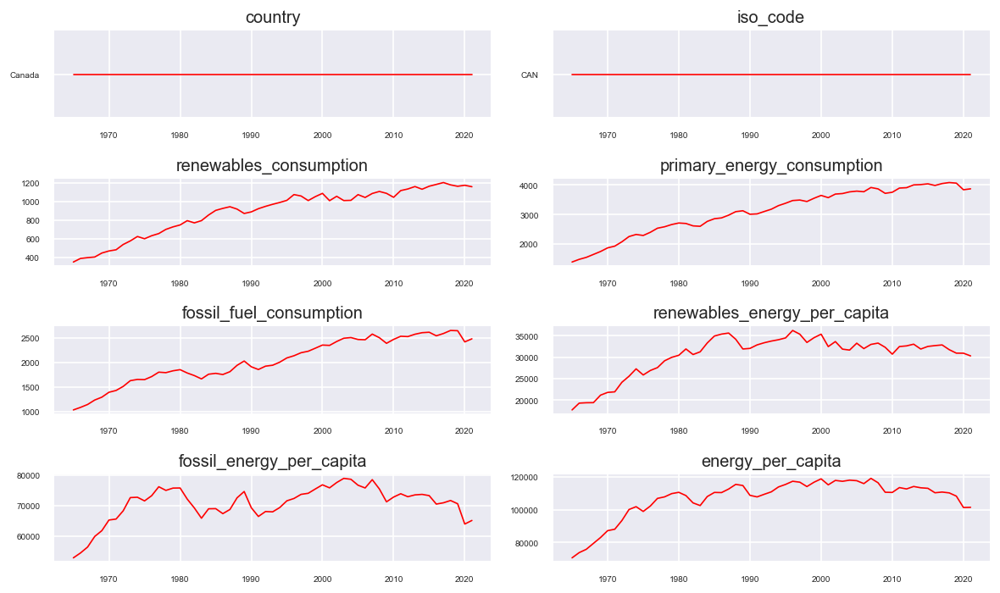

In [483]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=4, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_canada[df_var_canada.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_canada.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

So Renewable consumption and primary energy consumption patterns are looking alike.

In [484]:
#Let us check which time series is causing the other using granger casuality tests
print('primary_energy_consumption causes renewables_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_canada[['renewables_consumption', 'primary_energy_consumption']], 8)

print('\n renewables_consumption causes primary_energy_consumption?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_canada[['primary_energy_consumption', 'renewables_consumption']], 8)

primary_energy_consumption causes renewables_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=2.0501  , p=0.1581  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=2.1662  , p=0.1411  , df=1
likelihood ratio test: chi2=2.1253  , p=0.1449  , df=1
parameter F test:         F=2.0501  , p=0.1581  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.6103  , p=0.5472  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=1.3427  , p=0.5110  , df=2
likelihood ratio test: chi2=1.3266  , p=0.5151  , df=2
parameter F test:         F=0.6103  , p=0.5472  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.4753  , p=0.7010  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=1.6383  , p=0.6507  , df=3
likelihood ratio test: chi2=1.6139  , p=0.6562  , df=3
parameter F test:         F=0.4753  , p=0.7010  , df_denom=47, df_num=3

Granger Causality
num

The p-values are not significant,so it can be concluded that there is no casual relationship between these two variables.So lets check with another closest variable for renewable consumption,i.e fossil fuel consumption.Lets check granager casuality for renewable consumption and fossil fuel consumption.

In [485]:
#Let us check which time series is causing the other using granger casuality tests
print('fossil_fuel_consumption causes renewables_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_canada[['renewables_consumption', 'fossil_fuel_consumption']], 8)

print('\n renewables_consumption causes fossil_fuel_consumption?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_canada[['fossil_fuel_consumption', 'renewables_consumption']], 8)

fossil_fuel_consumption causes renewables_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=1.0563  , p=0.3087  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=1.1161  , p=0.2908  , df=1
likelihood ratio test: chi2=1.1051  , p=0.2931  , df=1
parameter F test:         F=1.0563  , p=0.3087  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.2516  , p=0.7785  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=0.5536  , p=0.7582  , df=2
likelihood ratio test: chi2=0.5508  , p=0.7593  , df=2
parameter F test:         F=0.2516  , p=0.7785  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.2400  , p=0.8680  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=0.8272  , p=0.8430  , df=3
likelihood ratio test: chi2=0.8209  , p=0.8445  , df=3
parameter F test:         F=0.2400  , p=0.8680  , df_denom=47, df_num=3

Granger Causality
number

Still there is no casuality lets check with renwables per capita consumption

In [486]:
#Let us check which time series is causing the other using granger casuality tests
print('renewables_energy_per_capita causes renewables_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_canada[['renewables_consumption', 'renewables_energy_per_capita']], 10)

print('\n renewables_consumption causes renewables_energy_per_capita?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_canada[['renewables_energy_per_capita', 'renewables_consumption']], 10)

renewables_energy_per_capita causes renewables_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.1293  , p=0.7206  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=0.1366  , p=0.7116  , df=1
likelihood ratio test: chi2=0.1365  , p=0.7118  , df=1
parameter F test:         F=0.1293  , p=0.7206  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.4145  , p=0.6629  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=0.9118  , p=0.6339  , df=2
likelihood ratio test: chi2=0.9043  , p=0.6362  , df=2
parameter F test:         F=0.4145  , p=0.6629  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.6449  , p=0.5901  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=2.2228  , p=0.5275  , df=3
likelihood ratio test: chi2=2.1783  , p=0.5362  , df=3
parameter F test:         F=0.6449  , p=0.5901  , df_denom=47, df_num=3

Granger Causality
n

There is somehow better casual relationship between these variables around 7th and 8th lags onwards.Lets try finally with the energy per capita.

In [487]:
#Let us check which time series is causing the other using granger casuality tests
print('energy_per_capita causes renewables_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_canada[['renewables_consumption', 'energy_per_capita']], 10)

print('\n renewables_consumption causes energy_per_capita?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_canada[['energy_per_capita', 'renewables_consumption']], 10)

energy_per_capita causes renewables_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.1943  , p=0.6612  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=0.2053  , p=0.6505  , df=1
likelihood ratio test: chi2=0.2049  , p=0.6508  , df=1
parameter F test:         F=0.1943  , p=0.6612  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.2118  , p=0.8098  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=0.4660  , p=0.7922  , df=2
likelihood ratio test: chi2=0.4640  , p=0.7929  , df=2
parameter F test:         F=0.2118  , p=0.8098  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.4466  , p=0.7208  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=1.5394  , p=0.6732  , df=3
likelihood ratio test: chi2=1.5178  , p=0.6782  , df=3
parameter F test:         F=0.4466  , p=0.7208  , df_denom=47, df_num=3

Granger Causality
number of la

This is also somehow giving same kind of relationship,but it has some closer values to 0.05,So it is considered that "renewables_consumption causes energy_per_capita"

In [488]:
print('\n So Finally renewables_consumption causes energy_per_capita\n')
#Taking two of them into separate dataframe before fitting into model
df_var_canada=df_var_canada[['energy_per_capita', 'renewables_consumption']]
print(df_var_canada.shape)


 So Finally renewables_consumption causes energy_per_capita

(57, 2)


In [489]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_canada=df_var_canada[:-12]
test_var_canada=df_var_canada[-12:]

In [490]:
#Taking the training data for modelling
model = VAR(train_var_canada)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [491]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        25.84       25.93   1.664e+11       25.87
1        22.73      22.99*   7.409e+09       22.82
2        22.58       23.02  6.423e+09*      22.73*
3        22.67       23.29   7.075e+09       22.88
4        22.70       23.50   7.422e+09       22.98
5        22.72       23.70   7.698e+09       23.06
6        22.87       24.02   9.204e+09       23.27
7        22.87       24.20   9.636e+09       23.33
8        22.93       24.45   1.092e+10       23.46
9        22.76       24.45   9.928e+09       23.34
10      22.50*       24.36   8.545e+09       23.14
--------------------------------------------------


So Order '1' is having Lower BIC value.But order two is having lower FPE and HQIC values.although lag '10'  having lower AIC value,the order is very high.So Order '2' is considered as a better fit for this model.

In [492]:
#Here only modelling for VAR..so MA=0 and S0,VAR(2,0)
#Here the model automatically converts the series into stationaryn using function enfore_stationarity
var_model = VARMAX(train_var_canada, order=(2,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



                                          Statespace Model Results                                         
Dep. Variable:     ['energy_per_capita', 'renewables_consumption']   No. Observations:                   45
Model:                                                      VAR(2)   Log Likelihood                -639.442
                                                       + intercept   AIC                           1304.885
Date:                                             Thu, 27 Jul 2023   BIC                           1328.371
Time:                                                     14:14:25   HQIC                          1313.640
Sample:                                                 01-01-1965                                         
                                                      - 01-01-2009                                         
Covariance Type:                                               opg                                         
Ljung-Box (L1) (Q):         

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [493]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [494]:
#Naming the columns of predicted results with suitable names
predictions.columns=['canada energy per capita_predicted','consumption_predicted']
predictions

,canada energy per capita_predicted,consumption_predicted
2010-01-01,109432.563133,1067.572905
2011-01-01,110393.716735,1055.230345
2012-01-01,112032.813778,1047.265823
2013-01-01,113546.859205,1041.870946
2014-01-01,114619.205594,1037.711377
2015-01-01,115211.867741,1033.958728
2016-01-01,115414.926928,1030.184534
2017-01-01,115353.655486,1026.226160
2018-01-01,115140.873984,1022.070682
2019-01-01,114859.221939,1017.772070


<Axes: >

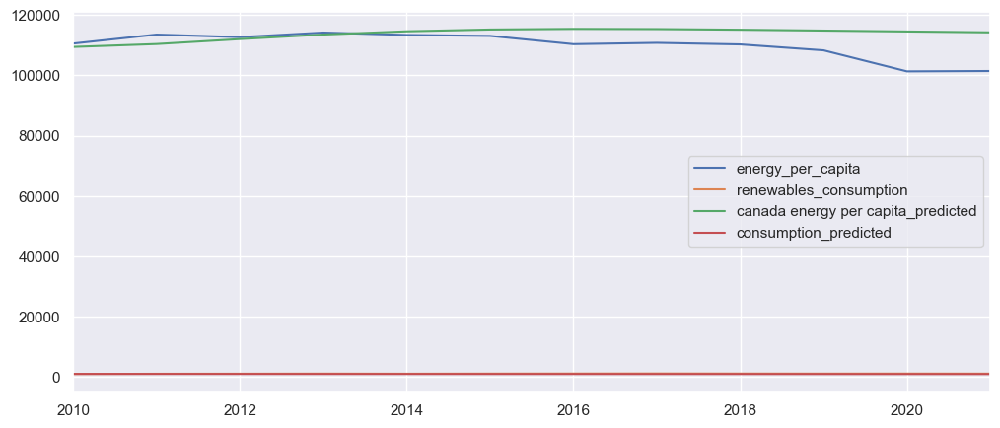

In [495]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_canada,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [496]:
mean_absolute_percentage_error(y_true=test_var_usa['renewables_consumption'],
                   y_pred=predictions['consumption_predicted'])

49.356839179222575

In [497]:
rmse_consumption=math.sqrt(mean_squared_error(predictions['consumption_predicted'],test_var_canada['renewables_consumption']))
print('Mean value of consumption is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_canada['renewables_consumption']),rmse_consumption))

Mean value of consumption is : 1149.5916666666667. Root Mean Squared Error is :127.80452924433936


# Future Consumption of Canada

Out of all the four models,ARIMA(1,1,1) performed well fpr predicting with lower accuracy,Therefore it is used for forecasting future value

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



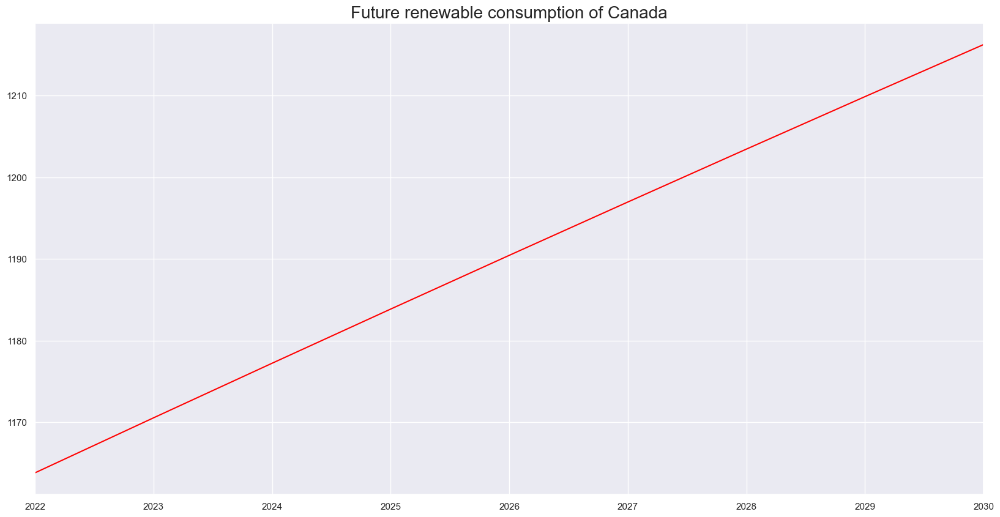

In [498]:
#Let us fit the model for whole dataset
forecast_Arima_111_canada=ARIMA(df_canada.renewables_consumption[1:],order=(1,1,1))
forecast_Arima_111_canada=forecast_Arima_111_canada.fit()
#predicting the values for test dataset
start_date="2022-01-01"
end_date="2030-01-01"
df_canada_Arima_111_forecast=forecast_Arima_111_canada.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_canada_Arima_111_forecast[start_date:end_date].plot(figsize=(20,10),color="red")
plt.title("Future renewable consumption of Canada",size=20)
plt.show()

In [499]:
df_canada_Arima_111_forecast

2022-01-01    1163.816920
2023-01-01    1170.552492
2024-01-01    1177.235135
2025-01-01    1183.865265
2026-01-01    1190.443295
2027-01-01    1196.969634
2028-01-01    1203.444688
2029-01-01    1209.868861
2030-01-01    1216.242552
Freq: AS-JAN, Name: predicted_mean, dtype: float64

## 2. Predictions for renewable share 

In [580]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_2_canada=df_world_var_2[df_world_var_2['country'].isin(['Canada'])]
df_var_2_canada

,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
3601,Canada,1900,CAN,NaN,NaN,NaN,NaN
3602,Canada,1901,CAN,NaN,NaN,NaN,NaN
3603,Canada,1902,CAN,NaN,NaN,NaN,NaN
3604,Canada,1903,CAN,NaN,NaN,NaN,NaN
3605,Canada,1904,CAN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
3718,Canada,2017,CAN,29.674,0.855,6.343,63.983
3719,Canada,2018,CAN,28.815,0.824,6.218,64.967
3720,Canada,2019,CAN,28.586,0.810,6.255,65.159
3721,Canada,2020,CAN,30.542,0.780,6.400,63.057


In [581]:
#dropping the null values corresponding to initial years of null data
df_var_2_canada.dropna(inplace=True)
df_var_2_canada.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2829930375.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
3718,Canada,2017,CAN,29.674,0.855,6.343,63.983
3719,Canada,2018,CAN,28.815,0.824,6.218,64.967
3720,Canada,2019,CAN,28.586,0.810,6.255,65.159
3721,Canada,2020,CAN,30.542,0.780,6.400,63.057
3722,Canada,2021,CAN,29.888,0.800,5.965,64.147


In [582]:
#Converting them into date time format with years format
df_var_2_canada.year=pd.to_datetime(df_var_2_canada.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1131532406.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [583]:
#Setting the year as index
df_var_2_canada.set_index("year",inplace=True)
df_var_2_canada.tail()

,country,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
year,,,,,,
2017-01-01,Canada,CAN,29.674,0.855,6.343,63.983
2018-01-01,Canada,CAN,28.815,0.824,6.218,64.967
2019-01-01,Canada,CAN,28.586,0.810,6.255,65.159
2020-01-01,Canada,CAN,30.542,0.780,6.400,63.057
2021-01-01,Canada,CAN,29.888,0.800,5.965,64.147


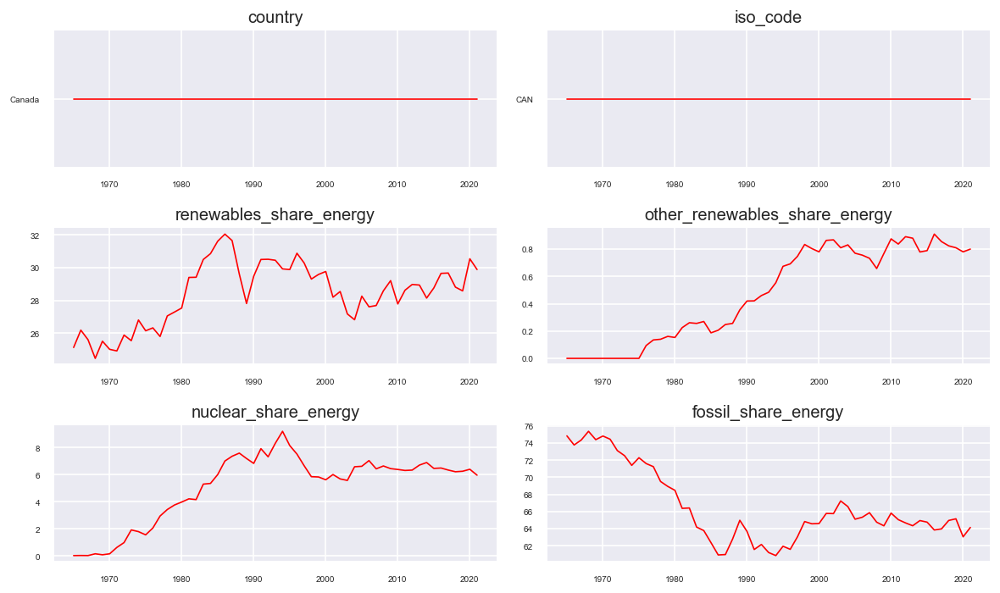

In [584]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=3, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_2_canada[df_var_2_canada.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_2_canada.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

renewables share and nuclear share are some what closer

In [585]:
#Let us check which time series is causing the other using granger casuality tests
print('	renewables_share_energy causes nuclear_share_energy?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_2_canada[['nuclear_share_energy', 'renewables_share_energy']], 8)
print('\n nuclear_share_energy causes renewables_share_energy?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_2_canada[['renewables_share_energy', 'nuclear_share_energy']], 8)

	renewables_share_energy causes nuclear_share_energy?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=2.3706  , p=0.1296  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=2.5048  , p=0.1135  , df=1
likelihood ratio test: chi2=2.4504  , p=0.1175  , df=1
parameter F test:         F=2.3706  , p=0.1296  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=1.1154  , p=0.3358  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=2.4540  , p=0.2932  , df=2
likelihood ratio test: chi2=2.4008  , p=0.3011  , df=2
parameter F test:         F=1.1154  , p=0.3358  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.8079  , p=0.4958  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=2.7848  , p=0.4260  , df=3
likelihood ratio test: chi2=2.7154  , p=0.4376  , df=3
parameter F test:         F=0.8079  , p=0.4958  , df_denom=47, df_num=3

Granger Causality
number 

In [586]:
print('\n So Finally nuclear_share_energy causes renewables_share_energy\n')
#Taking two of them into separate dataframe before fitting into model
df_var_2_canada=df_var_2_canada[['renewables_share_energy', 'nuclear_share_energy']]
print(df_var_2_canada.shape)


 So Finally nuclear_share_energy causes renewables_share_energy

(57, 2)


In [587]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_2_canada=df_var_2_canada[:-12]
test_var_2_canada=df_var_2_canada[-12:]

In [588]:
#Taking the training data for modelling
model = VAR(train_var_2_canada)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [589]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        1.738       1.827       5.685       1.769
1      -1.192*    -0.9256*     0.3038*     -1.100*
2      -0.9926     -0.5482      0.3721     -0.8392
3      -0.7755     -0.1533      0.4656     -0.5607
4      -0.5777      0.2222      0.5746     -0.3015
5      -0.4347      0.5429      0.6766    -0.09723
6      -0.3878      0.7676      0.7311     0.01104
7      -0.4818      0.8513      0.6952    -0.02160
8      -0.3875       1.123      0.8117      0.1341
9      -0.3459       1.343      0.9189      0.2370
10     -0.8287       1.038      0.6337     -0.1845
--------------------------------------------------


Order '1' is having all lower values

In [590]:
var_model = VARMAX(train_var_2_canada, order=(1,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



                                            Statespace Model Results                                           
Dep. Variable:     ['renewables_share_energy', 'nuclear_share_energy']   No. Observations:                   45
Model:                                                          VAR(1)   Log Likelihood                 -95.113
                                                           + intercept   AIC                            208.226
Date:                                                 Thu, 27 Jul 2023   BIC                            224.486
Time:                                                         23:19:30   HQIC                           214.288
Sample:                                                     01-01-1965                                         
                                                          - 01-01-2009                                         
Covariance Type:                                                   opg                                  

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [591]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [592]:
#Naming the columns of predicted results with suitable names
predictions.columns=['renewables_share_energy_predicted','nuclear_share_energy_predicted']
predictions

,renewables_share_energy_predicted,nuclear_share_energy_predicted
2010-01-01,29.123011,6.408537
2011-01-01,29.053471,6.362767
2012-01-01,28.995356,6.313797
2013-01-01,28.945249,6.263051
2014-01-01,28.900819,6.211485
2015-01-01,28.860478,6.159743
2016-01-01,28.823144,6.108254
2017-01-01,28.788072,6.057299
2018-01-01,28.754754,6.007063
2019-01-01,28.722840,5.957663


<Axes: >

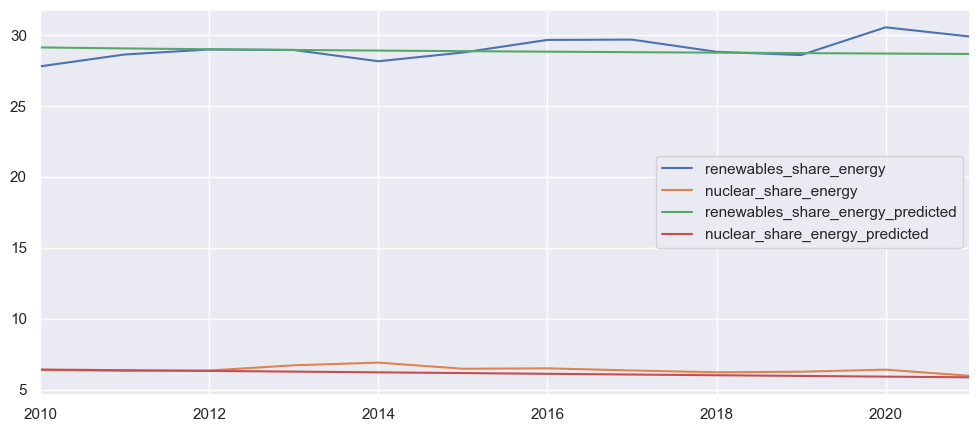

In [593]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_2_canada,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [594]:
mean_absolute_percentage_error(y_true=test_var_2_canada['renewables_share_energy'],
                   y_pred=predictions['renewables_share_energy_predicted'])

2.167019924787732

In [595]:
rmse_rshare=math.sqrt(mean_squared_error(predictions['renewables_share_energy_predicted'],test_var_2_canada['renewables_share_energy']))
print('Mean value of renewable share is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_2_canada['renewables_share_energy']),rmse_rshare))

Mean value of renewable share is : 29.03375. Root Mean Squared Error is :0.8639250746938433


## forecasting future renewable share 

Out of all four models,ARIMA(1,1,1) is predicting better.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



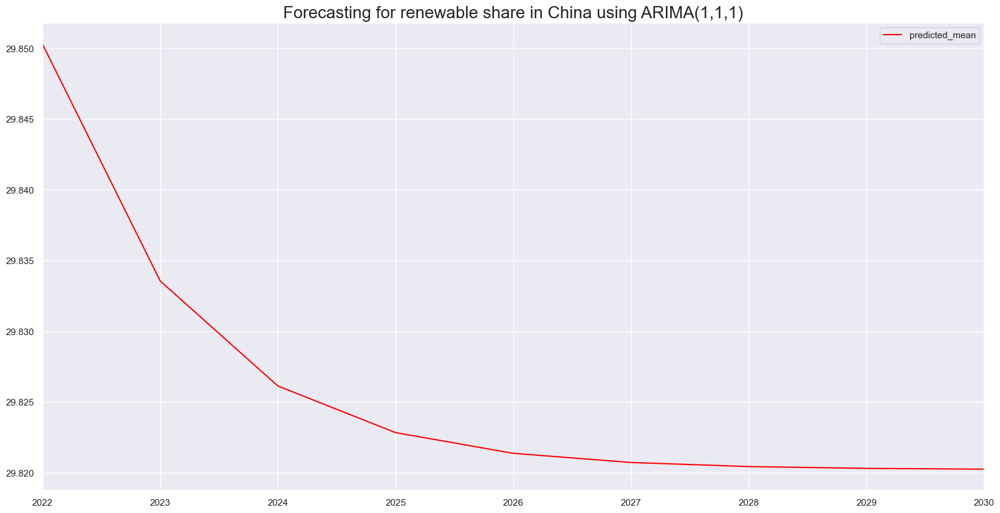

In [596]:
#Let us fit the model for wholedataset
model_Arima_111_rshare=ARIMA(df_canada.renewables_share_energy[1:],order=(1,1,1))
model_Arima_111_rshare=model_Arima_111_rshare.fit()
#predicting the values for test dataset
start_date="2022-01-01"
end_date="2030-01-01"
df_canada_Arima_111_predict_rshare=model_Arima_111_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_canada_Arima_111_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Forecasting for renewable share in China using ARIMA(1,1,1)",size=20)
plt.show()

In [597]:
df_canada_Arima_111_predict_rshare

2022-01-01    29.850282
2023-01-01    29.833548
2024-01-01    29.826124
2025-01-01    29.822831
2026-01-01    29.821370
2027-01-01    29.820721
2028-01-01    29.820434
2029-01-01    29.820306
2030-01-01    29.820250
Freq: AS-JAN, Name: predicted_mean, dtype: float64

## 3. Predictions for total energy 

In [598]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_3_canada=df_world_var_3[df_world_var_3['country'].isin(['Canada'])]
df_var_3_canada

,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
3601,Canada,1900,CAN,NaN,NaN,NaN,NaN
3602,Canada,1901,CAN,NaN,NaN,NaN,NaN
3603,Canada,1902,CAN,NaN,NaN,NaN,NaN
3604,Canada,1903,CAN,NaN,NaN,NaN,NaN
3605,Canada,1904,CAN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
3718,Canada,2017,CAN,4049.998,1201.782,256.895,2591.321
3719,Canada,2018,CAN,4084.020,1176.791,253.962,2653.267
3720,Canada,2019,CAN,4064.001,1161.750,254.196,2648.054
3721,Canada,2020,CAN,3839.567,1172.686,245.749,2421.132


In [599]:
#dropping the null values corresponding to initial years of null data
df_var_3_canada.dropna(inplace=True)
df_var_3_canada.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3328599089.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
3718,Canada,2017,CAN,4049.998,1201.782,256.895,2591.321
3719,Canada,2018,CAN,4084.020,1176.791,253.962,2653.267
3720,Canada,2019,CAN,4064.001,1161.750,254.196,2648.054
3721,Canada,2020,CAN,3839.567,1172.686,245.749,2421.132
3722,Canada,2021,CAN,3871.156,1157.028,230.908,2483.220


In [600]:
#Converting them into date time format with years format
df_var_3_canada.year=pd.to_datetime(df_var_3_canada.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3908326173.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [601]:
#Setting the year as index
df_var_3_canada.set_index("year",inplace=True)
df_var_3_canada.tail()

,country,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
year,,,,,,
2017-01-01,Canada,CAN,4049.998,1201.782,256.895,2591.321
2018-01-01,Canada,CAN,4084.020,1176.791,253.962,2653.267
2019-01-01,Canada,CAN,4064.001,1161.750,254.196,2648.054
2020-01-01,Canada,CAN,3839.567,1172.686,245.749,2421.132
2021-01-01,Canada,CAN,3871.156,1157.028,230.908,2483.220


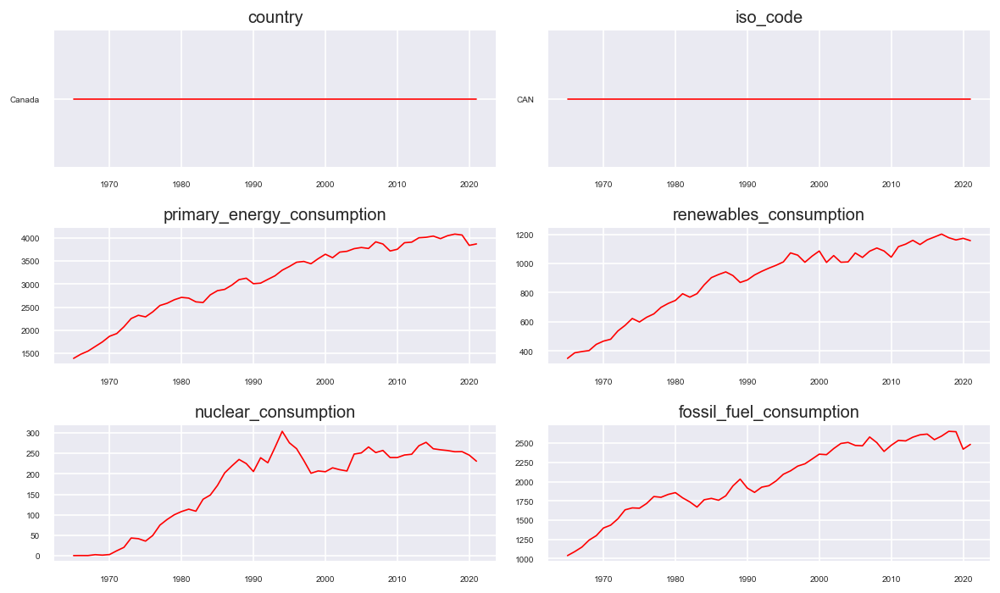

In [602]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=3, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_3_canada[df_var_3_canada.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_3_canada.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

primary and renewable energy consumptions are same

In [603]:
#Let us check which time series is causing the other using granger casuality tests
print('primary_energy_consumption causes renewables_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_3_canada[['renewables_consumption', 'primary_energy_consumption']], 8)
print('\n renewables_consumption causes primary_energy_consumption?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_3_canada[['primary_energy_consumption', 'renewables_consumption']], 8)

primary_energy_consumption causes renewables_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=2.0501  , p=0.1581  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=2.1662  , p=0.1411  , df=1
likelihood ratio test: chi2=2.1253  , p=0.1449  , df=1
parameter F test:         F=2.0501  , p=0.1581  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.6103  , p=0.5472  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=1.3427  , p=0.5110  , df=2
likelihood ratio test: chi2=1.3266  , p=0.5151  , df=2
parameter F test:         F=0.6103  , p=0.5472  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.4753  , p=0.7010  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=1.6383  , p=0.6507  , df=3
likelihood ratio test: chi2=1.6139  , p=0.6562  , df=3
parameter F test:         F=0.4753  , p=0.7010  , df_denom=47, df_num=3

Granger Causality
num

In [604]:
print('\n So Finally renewables_consumption causes primary_energy_consumption\n')
#Taking two of them into separate dataframe before fitting into model
df_var_3_canada=df_var_3_canada[['primary_energy_consumption', 'renewables_consumption']]
print(df_var_3_canada.shape)


 So Finally renewables_consumption causes primary_energy_consumption

(57, 2)


In [605]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_3_canada=df_var_3_canada[:-12]
test_var_3_canada=df_var_3_canada[-12:]

In [606]:
#Taking the training data for modelling
model = VAR(train_var_3_canada)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [607]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        20.18       20.26   5.782e+08       20.21
1        15.59      15.86*  5.928e+06*      15.69*
2        15.68       16.12   6.465e+06       15.83
3        15.65       16.27   6.317e+06       15.86
4        15.78       16.58   7.276e+06       16.05
5        15.79       16.76   7.502e+06       16.12
6        15.93       17.09   8.929e+06       16.33
7        15.81       17.14   8.258e+06       16.27
8        15.87       17.38   9.306e+06       16.39
9        15.84       17.53   9.843e+06       16.42
10      15.50*       17.37   7.826e+06       16.14
--------------------------------------------------


Order '1' is selected

In [608]:
var_model = VARMAX(train_var_3_canada, order=(1,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



                                              Statespace Model Results                                              
Dep. Variable:     ['primary_energy_consumption', 'renewables_consumption']   No. Observations:                   45
Model:                                                               VAR(1)   Log Likelihood                -475.967
                                                                + intercept   AIC                            969.934
Date:                                                      Thu, 27 Jul 2023   BIC                            986.194
Time:                                                              23:35:22   HQIC                           975.995
Sample:                                                          01-01-1965                                         
                                                               - 01-01-2009                                         
Covariance Type:                                                

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [609]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [610]:
#Naming the columns of predicted results with suitable names
predictions.columns=['primary_energy_consumption_predicted','renewables_consumption_predicted']
predictions

,primary_energy_consumption_predicted,renewables_consumption_predicted
2010-01-01,3745.595732,1089.132268
2011-01-01,3770.388425,1091.644993
2012-01-01,3792.412696,1093.546219
2013-01-01,3811.833025,1094.874795
2014-01-01,3828.805220,1095.667485
2015-01-01,3843.476861,1095.959076
2016-01-01,3855.987714,1095.782478
2017-01-01,3866.470133,1095.168822
2018-01-01,3875.049436,1094.147549
2019-01-01,3881.844268,1092.746499


<Axes: >

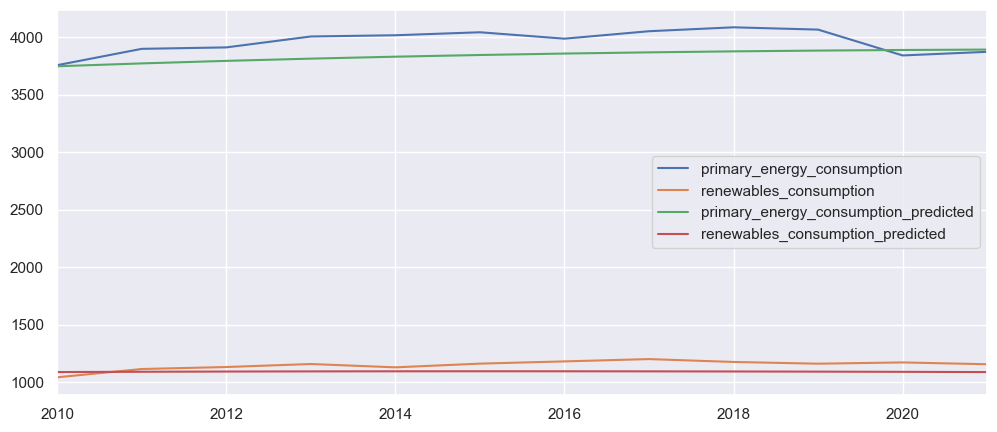

In [611]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_3_canada,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [612]:
mean_absolute_percentage_error(y_true=test_var_3_canada['primary_energy_consumption'],
                   y_pred=predictions['primary_energy_consumption_predicted'])

3.3279215830127185

In [613]:
rmse_tenergy=math.sqrt(mean_squared_error(predictions['primary_energy_consumption_predicted'],test_var_3_canada['primary_energy_consumption']))
print('Mean value of total energy is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_3_canada['primary_energy_consumption']),rmse_tenergy))

Mean value of total energy is : 3959.649. Root Mean Squared Error is :150.11693552589202


## Forecasting Total energy of China 

Out of all four models ARIMA(8,1,1) is predicting better

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



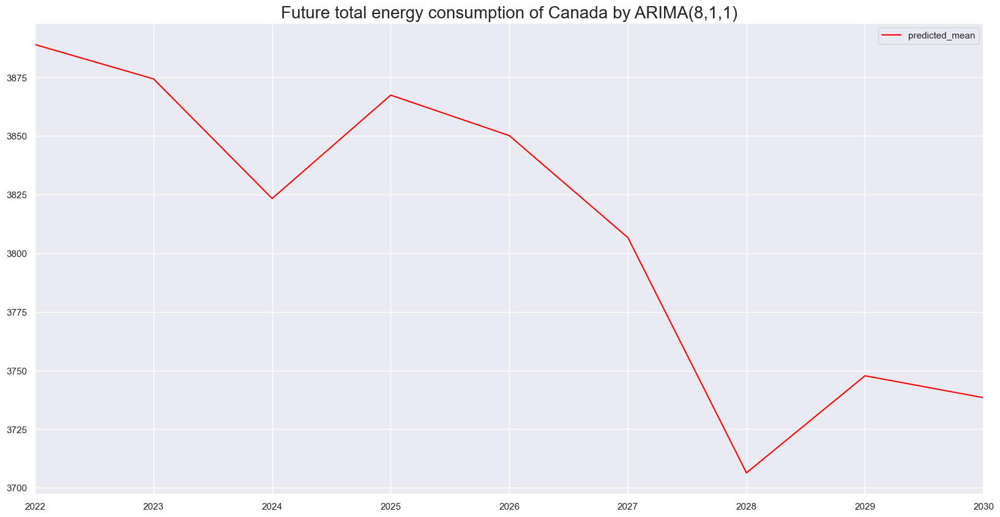

In [614]:
#Let us fit the model for whole dataset
model_Arima_811_tenergy=ARIMA(df_canada.primary_energy_consumption[1:],order=(8,1,1))
model_Arima_811_tenergy=model_Arima_811_tenergy.fit()
#predicting the values for test dataset
start_date="2022-01-01"
end_date="2030-01-01"
df_canada_Arima_811_predict_tenergy=model_Arima_811_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_canada_Arima_811_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Future total energy consumption of Canada by ARIMA(8,1,1)",size=20)
plt.show()

In [615]:
df_canada_Arima_811_predict_tenergy

2022-01-01    3889.009870
2023-01-01    3874.352101
2024-01-01    3823.347316
2025-01-01    3867.436851
2026-01-01    3850.173487
2027-01-01    3806.679488
2028-01-01    3706.355885
2029-01-01    3747.747398
2030-01-01    3738.397483
Freq: AS-JAN, Name: predicted_mean, dtype: float64

# 4.Time Series analysis and Forecasting for "Brazil"

# Data Pre-Processing

In [616]:
#Taking the brazil country data only for further analysis
df_brazil=df_world_renw_1[df_world_renw['country'].isin(['Brazil'])]
df_brazil

,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
2807,Brazil,1900,BRA,NaN,NaN,NaN
2808,Brazil,1901,BRA,NaN,NaN,NaN
2809,Brazil,1902,BRA,NaN,NaN,NaN
2810,Brazil,1903,BRA,NaN,NaN,NaN
2811,Brazil,1904,BRA,NaN,NaN,NaN
...,...,...,...,...,...,...
2924,Brazil,2017,BRA,1473.244,43.281,3403.931
2925,Brazil,2018,BRA,1574.748,46.080,3417.385
2926,Brazil,2019,BRA,1649.812,47.305,3487.616
2927,Brazil,2020,BRA,1649.188,49.472,3333.586


In [617]:
#Checking whether there are any null values in dataset
df_brazil.isnull().sum()

country                        0
year                           0
iso_code                       0
renewables_consumption        65
renewables_share_energy       65
primary_energy_consumption    65
dtype: int64

In [618]:
df_brazil.dropna(inplace=True)
df_brazil.head()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\624859534.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
2872,Brazil,1965,BRA,75.448,27.549,273.870
2873,Brazil,1966,BRA,82.518,27.618,298.780
2874,Brazil,1967,BRA,86.312,27.880,309.579
2875,Brazil,1968,BRA,90.336,25.556,353.486
2876,Brazil,1969,BRA,96.670,25.056,385.812


In [619]:
df_brazil.year=pd.to_datetime(df_brazil.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\942552256.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [620]:
df_brazil_no_index=df_brazil[['year','renewables_consumption']]
df_brazil_no_index.head()

,year,renewables_consumption
2872,1965-01-01,75.448
2873,1966-01-01,82.518
2874,1967-01-01,86.312
2875,1968-01-01,90.336
2876,1969-01-01,96.670


In [621]:
df_brazil_No_index_rshare=df_brazil[['year','renewables_share_energy']]
df_brazil_No_index_rshare.head()

,year,renewables_share_energy
2872,1965-01-01,27.549
2873,1966-01-01,27.618
2874,1967-01-01,27.880
2875,1968-01-01,25.556
2876,1969-01-01,25.056


In [622]:
df_brazil_No_index_tenergy=df_brazil[['year','primary_energy_consumption']]
df_brazil_No_index_tenergy.head()

,year,primary_energy_consumption
2872,1965-01-01,273.870
2873,1966-01-01,298.780
2874,1967-01-01,309.579
2875,1968-01-01,353.486
2876,1969-01-01,385.812


In [623]:
df_brazil.set_index("year",inplace=True)
df_brazil.head()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
year,,,,,
1965-01-01,Brazil,BRA,75.448,27.549,273.870
1966-01-01,Brazil,BRA,82.518,27.618,298.780
1967-01-01,Brazil,BRA,86.312,27.880,309.579
1968-01-01,Brazil,BRA,90.336,25.556,353.486
1969-01-01,Brazil,BRA,96.670,25.056,385.812


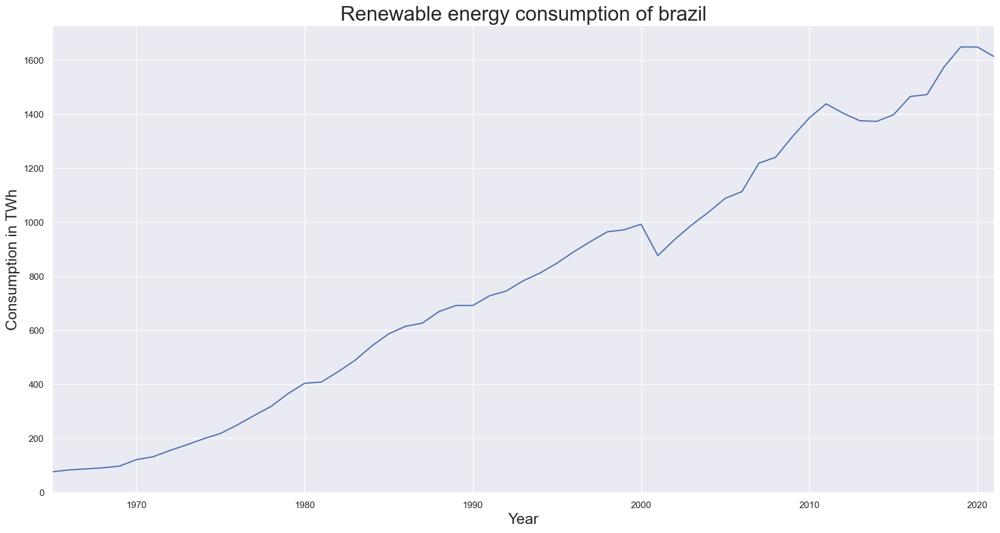

In [624]:
df_brazil.renewables_consumption.plot(figsize=(20,10))
plt.title("Renewable energy consumption of brazil",size=24)
plt.ylabel("Consumption in TWh",size=18)
plt.xlabel("Year",size=18)
plt.show()

# Seasonality Check

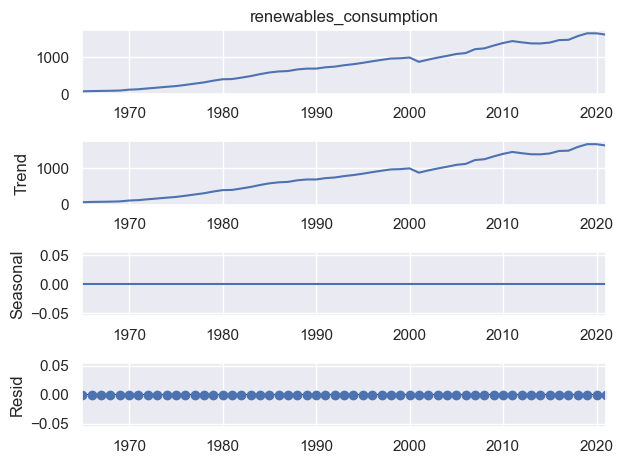

In [625]:
seas_decompose_additive_brazil= seasonal_decompose(df_brazil.renewables_consumption,model="additive")
seas_decompose_additive_brazil.plot()
plt.show()

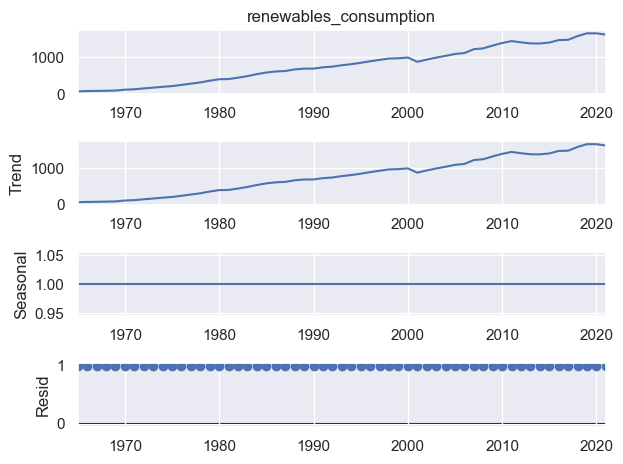

In [626]:
seas_decompose_multiplicative_brazil= seasonal_decompose(df_brazil.renewables_consumption,model="multiplicative",period=1)
seas_decompose_multiplicative_brazil.plot()
plt.show()

# Stationarity Check

In [627]:
result = adfuller(df_brazil.renewables_consumption)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - brazil Time Series is Stationary")
else:
    print ("Failed to Reject Ho - brazil Time Series is Non-Stationary")

ADF Statistic: 0.415430
p-value: 0.982063
Critical Values:
	1%: -3.553
	5%: -2.915
	10%: -2.595
Failed to Reject Ho - brazil Time Series is Non-Stationary


In [628]:
#Lets Fit ARIMA Model As it is a Non-stationary Data
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_brazil=ARIMA(df_brazil.renewables_consumption[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_brazil=model_AR_I_MA_111_brazil.fit()
#print the summary of model results
results_AR_I_MA_111_brazil.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     renewables_consumption   No. Observations:                   56
Model:                     ARIMA(1, 1, 1)   Log Likelihood                -274.263
Date:                    Thu, 27 Jul 2023   AIC                            554.526
Time:                            23:45:22   BIC                            560.548
Sample:                        01-01-1966   HQIC                           556.855
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0000      0.000   3668.968      0.000       0.999       1.001
ma.L1         -0.9985      0.118     -8.449      0.000      -1.230      -0.767
sigma2      1177.7828      0.000   1.15e+07      0.000    1177.783    1177.783
===================================================================================
Ljung-Box (L1) (Q):                   0.60   Jarque-Bera (JB):                85.52
Prob(Q):                              0.44   Prob(JB):                         0.00
Heteroskedasticity (H):               6.96   Skew:                            -1.52
Prob(H) (two-sided):                  0.00   Kurtosis:                         8.30
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 1.68e+22. Standard errors may be unstable.
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1616459351.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



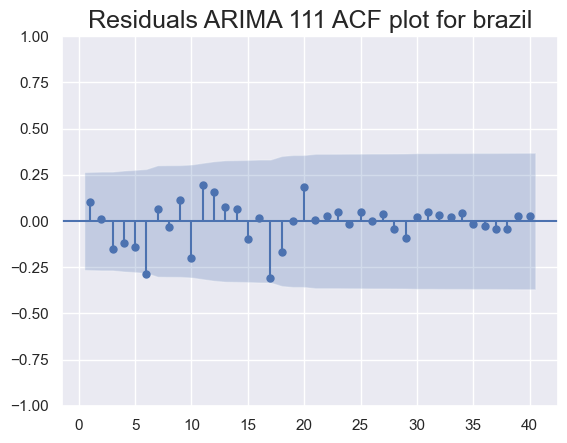

In [629]:
#All coefiicients are significant,Lets see Residuals plot to check whether any higher lags are significant
df_brazil['residuals_ARIMA_111_brazil']=results_AR_I_MA_111_brazil.resid
sgt.plot_acf(df_brazil.residuals_ARIMA_111_brazil[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for brazil",size=18)
plt.show()

# Checking Stationarity of Time Series 

In [630]:
#We have decided No higher lags are significant ,before conclusing lets check whether it is stationary or not
df_brazil['brazil_ren_consumption']=df_brazil.renewables_consumption.diff(1)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1520192644.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [631]:
#To comapre ARIMA 111 results with manually integrated time series ,performing arma 11 for integrated series
#As Arima(1,0,1) should equal to Arma(1,1) of manully integrated series
#All of this are doing to check after the first integration whether the series is statioanry or not
model_AR_I_MA_101_brazil=ARIMA(df_brazil.brazil_ren_consumption[2:],order=(1,0,1))
results_AR_I_MA_101_brazil=model_AR_I_MA_101_brazil.fit()
results_AR_I_MA_101_brazil.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     brazil_ren_consumption   No. Observations:                   55
Model:                     ARIMA(1, 0, 1)   Log Likelihood                -271.558
Date:                    Thu, 27 Jul 2023   AIC                            551.117
Time:                            23:45:25   BIC                            559.146
Sample:                        01-01-1967   HQIC                           554.222
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         27.5917      6.602      4.180      0.000      14.653      40.530
ar.L1          0.1594      1.206      0.132      0.895      -2.204       2.522
ma.L1         -0.0350      1.213     -0.029      0.977      -2.413       2.343
sigma2      1137.6361    149.171      7.626      0.000     845.267    1430.005
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                62.25
Prob(Q):                              1.00   Prob(JB):                         0.00
Heteroskedasticity (H):               8.69   Skew:                            -1.09
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.73
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [632]:
result = adfuller(df_brazil.brazil_ren_consumption[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -2.647713
p-value: 0.083531
Critical Values:
	1%: -3.585
	5%: -2.928
	10%: -2.602
Failed to Reject Ho - Time Series is Non-Stationary


In [633]:
#We have decided No higher lags are significant ,before conclusing lets check whether it is stationary or not
df_brazil['brazil_ren_consumption_2']=df_brazil.renewables_consumption.diff(2)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2573022126.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [634]:
model_AR_I_MA_101_brazil=ARIMA(df_brazil.brazil_ren_consumption_2[2:],order=(1,0,1))
results_AR_I_MA_101_brazil=model_AR_I_MA_101_brazil.fit()
results_AR_I_MA_101_brazil.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                   
====================================================================================
Dep. Variable:     brazil_ren_consumption_2   No. Observations:                   55
Model:                       ARIMA(1, 0, 1)   Log Likelihood                -273.580
Date:                      Thu, 27 Jul 2023   AIC                            555.161
Time:                              23:45:27   BIC                            563.190
Sample:                          01-01-1967   HQIC                           558.266
                               - 01-01-2021                                         
Covariance Type:                        opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         54.5102     12.335      4.419      0.000      30.335      78.686
ar.L1          0.1217      0.163      0.744      0.457      -0.199       0.442
ma.L1          0.9999     30.630      0.033      0.974     -59.034      61.034
sigma2      1133.5257   3.47e+04      0.033      0.974   -6.68e+04    6.91e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                51.07
Prob(Q):                              0.95   Prob(JB):                         0.00
Heteroskedasticity (H):               8.76   Skew:                            -0.98
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.29
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [635]:
result = adfuller(df_brazil.brazil_ren_consumption_2[2:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -4.390216
p-value: 0.000309
Critical Values:
	1%: -3.566
	5%: -2.920
	10%: -2.598
Reject Ho - Time Series is Stationary


In [636]:
model_AR_I_MA_121_brazil=ARIMA(df_brazil.renewables_consumption[1:],order=(1,2,1))
results_AR_I_MA_121_brazil=model_AR_I_MA_121_brazil.fit()
results_AR_I_MA_121_brazil.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     renewables_consumption   No. Observations:                   56
Model:                     ARIMA(1, 2, 1)   Log Likelihood                -268.977
Date:                    Thu, 27 Jul 2023   AIC                            543.954
Time:                            23:45:29   BIC                            549.921
Sample:                        01-01-1966   HQIC                           546.255
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.1467      0.119      1.231      0.218      -0.087       0.380
ma.L1         -0.9996      6.238     -0.160      0.873     -13.225      11.226
sigma2      1159.5339   7208.377      0.161      0.872    -1.3e+04    1.53e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.08   Jarque-Bera (JB):                72.34
Prob(Q):                              0.78   Prob(JB):                         0.00
Heteroskedasticity (H):               8.47   Skew:                            -1.33
Prob(H) (two-sided):                  0.00   Kurtosis:                         8.01
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\151028076.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



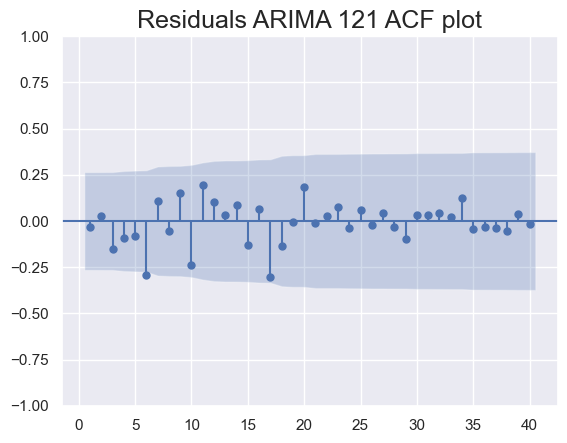

In [637]:
df_brazil['residuals_ARIMA_121']=results_AR_I_MA_121_brazil.resid
sgt.plot_acf(df_brazil.residuals_ARIMA_121[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 121 ACF plot",size=18)
plt.show()

So,there are no higher lags to be considered as significant.So lets compare ARIMA(1,1,1) and ARIMA(1,2,1) using LLR test

In [638]:
LLR_test(model_AR_I_MA_111_brazil,model_AR_I_MA_121_brazil)

0.001

The p-value is within significance range,So it can be confirmed that higher order is the best model i.e ARIMA(1,2,1)

# Predicting Using ARIMA(1,2,1) 

In [639]:
size_brazil=int(len(df_brazil)*0.8)
size_brazil

45

In [640]:
df_brazil_train=df_brazil.iloc[:size_brazil]
df_brazil_test=df_brazil.iloc[size_brazil:]

In [641]:
#let us check the ending year of training dataset ,so that starting date can be put as next year
df_brazil_train.tail()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption,residuals_ARIMA_111_brazil,brazil_ren_consumption,brazil_ren_consumption_2,residuals_ARIMA_121
year,,,,,,,,,
2005-01-01,Brazil,BRA,1088.534,43.146,2522.927,27.347710,51.474,98.917,23.075426
2006-01-01,Brazil,BRA,1113.878,43.046,2587.648,0.542912,25.344,76.818,-4.232330
2007-01-01,Brazil,BRA,1218.903,44.380,2746.501,80.210878,105.025,130.369,79.386149
2008-01-01,Brazil,BRA,1241.076,43.367,2861.812,-4.527600,22.173,127.198,-17.073113
2009-01-01,Brazil,BRA,1317.641,46.309,2845.335,49.968494,76.565,98.738,49.874268


In [642]:
df_brazil_test.tail()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption,residuals_ARIMA_111_brazil,brazil_ren_consumption,brazil_ren_consumption_2,residuals_ARIMA_121
year,,,,,,,,,
2017-01-01,Brazil,BRA,1473.244,43.281,3403.931,-19.611197,7.221,74.992,-26.378862
2018-01-01,Brazil,BRA,1574.748,46.080,3417.385,75.045592,101.504,108.725,77.299013
2019-01-01,Brazil,BRA,1649.812,47.305,3487.616,47.202036,75.064,176.568,35.553330
2020-01-01,Brazil,BRA,1649.188,49.472,3333.586,-29.352637,-0.624,74.440,-36.923193
2021-01-01,Brazil,BRA,1613.276,46.220,3490.447,-64.111278,-35.912,-36.536,-60.430283


C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



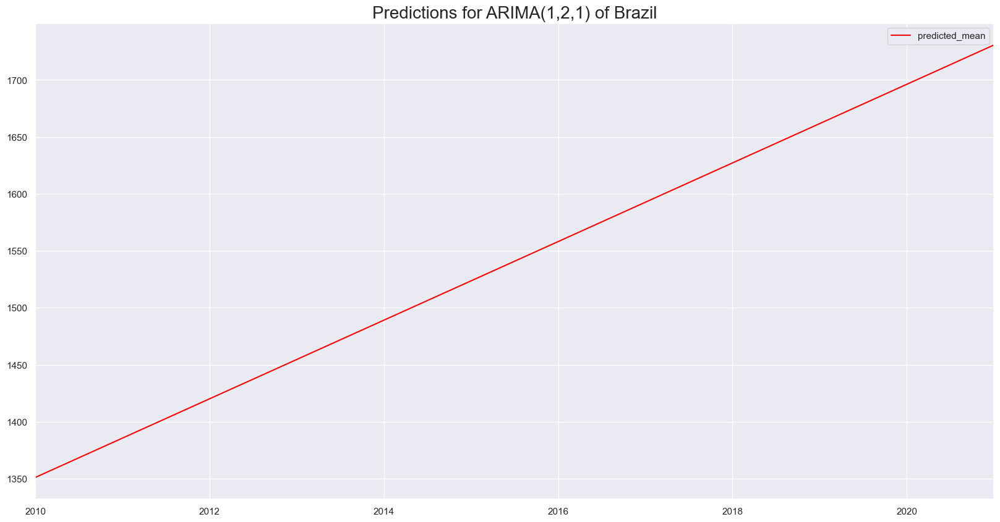

In [643]:
#Let us fit the model for only training dataset
model_Arima_121_brazil=ARIMA(df_brazil_train.renewables_consumption[1:],order=(1,2,1))
model_Arima_121_brazil=model_Arima_121_brazil.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_brazil_Arima_121_predict=model_Arima_121_brazil.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_brazil_Arima_121_predict[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for ARIMA(1,2,1) of Brazil",size=20)
plt.show()

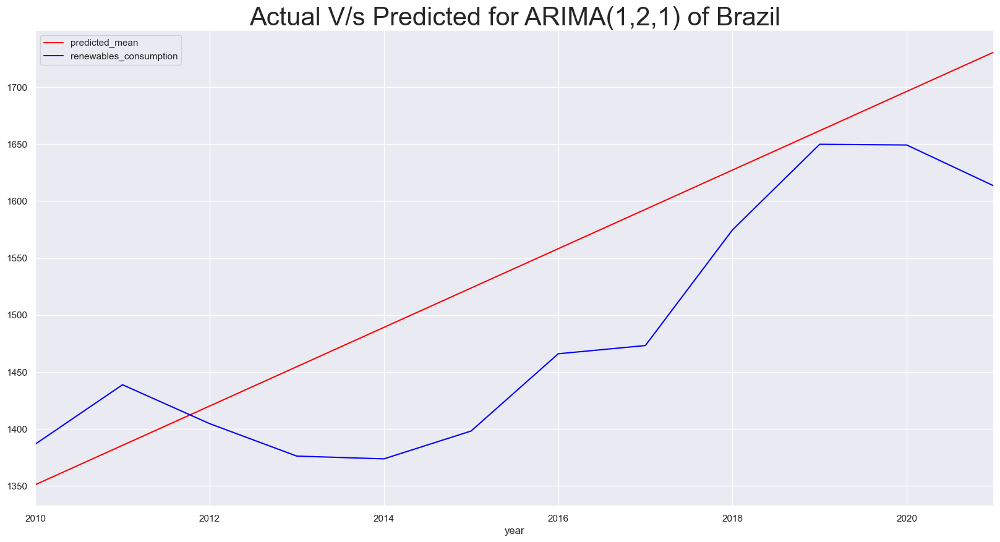

In [644]:
#Let us compare the test data and predicted values
df_brazil_Arima_121_predict.plot(figsize=(20,10),color="red",legend=True)
df_brazil_test.renewables_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for ARIMA(1,2,1) of Brazil",size=30)
plt.show()

In [645]:
rmse_121_brazil=sqrt(mean_squared_error(df_brazil_Arima_121_predict,df_brazil_test['renewables_consumption']))
mse_121_brazil=mean_squared_error(df_brazil_Arima_121_predict,df_brazil_test['renewables_consumption'])
mae_brazil = np.mean(np.abs(df_brazil_Arima_121_predict  - df_brazil_test['renewables_consumption']))
print("Root Mean Squared Error for ARIMA(1,2,1): ",rmse_121_brazil)
print("Mean Squared Error for ARIMA(1,2,1): ",mse_121_brazil)
print("Mean absolute Error for ARIMA(1,2,1): ",mae_brazil)

Root Mean Squared Error for ARIMA(1,2,1):  82.26759826430971
Mean Squared Error for ARIMA(1,2,1):  6767.957724177853
Mean absolute Error for ARIMA(1,2,1):  72.00719197913877


In [646]:
mean_absolute_percentage_error(y_true=df_brazil_test['renewables_consumption'],
                   y_pred=df_brazil_Arima_121_predict)

4.918416084242684

## 2.Predictions for Renewable share

In [647]:
df_brazil_rshare=df_brazil[['renewables_share_energy']]
df_brazil_rshare.head()

,renewables_share_energy
year,
1965-01-01,27.549
1966-01-01,27.618
1967-01-01,27.880
1968-01-01,25.556
1969-01-01,25.056


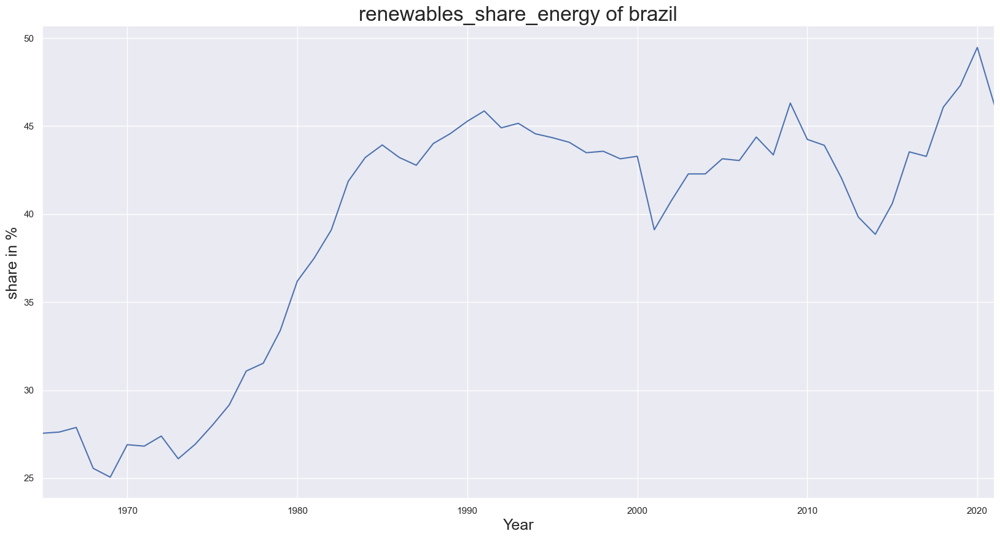

In [648]:
df_brazil.renewables_share_energy.plot(figsize=(20,10))
plt.title("renewables_share_energy of brazil",size=24)
plt.ylabel("share in %",size=18)
plt.xlabel("Year",size=18)
plt.show()

## Seasonality Checking

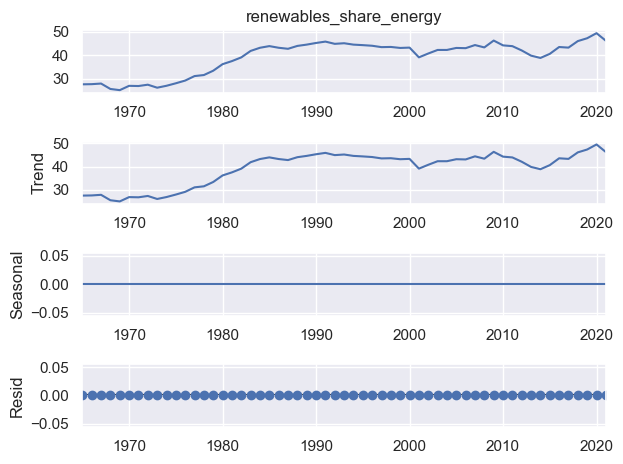

In [649]:
seas_decompose_additive= seasonal_decompose(df_brazil.renewables_share_energy,model="additive")
seas_decompose_additive.plot()
plt.show()

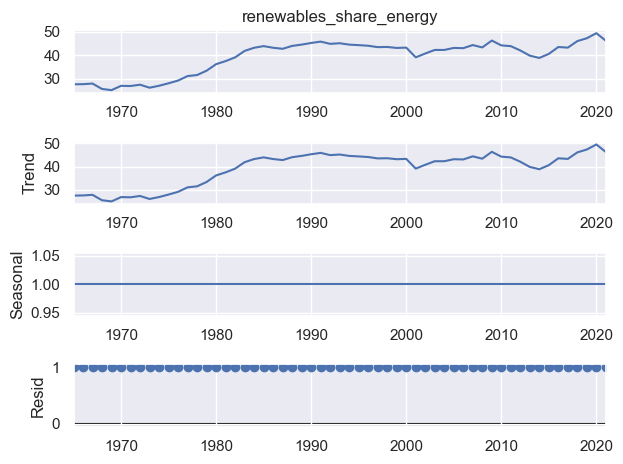

In [650]:
seas_decompose_multiplicative= seasonal_decompose(df_brazil.renewables_share_energy,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

From both the methods it is clear that,there is no proof of seasonality

In [651]:
result = adfuller(df_brazil.renewables_share_energy)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - brazil Time Series is Stationary")
else:
    print ("Failed to Reject Ho - brazil Time Series is Non-Stationary")

ADF Statistic: -1.343197
p-value: 0.609186
Critical Values:
	1%: -3.553
	5%: -2.915
	10%: -2.595
Failed to Reject Ho - brazil Time Series is Non-Stationary


## ARIMA

In [652]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_rshare=ARIMA(df_brazil.renewables_share_energy[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_rshare=model_AR_I_MA_111_rshare.fit()
#print the summary of model results
results_AR_I_MA_111_rshare.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     renewables_share_energy   No. Observations:                   56
Model:                      ARIMA(1, 1, 1)   Log Likelihood                -101.326
Date:                     Fri, 28 Jul 2023   AIC                            208.651
Time:                             00:14:41   BIC                            214.673
Sample:                         01-01-1966   HQIC                           210.980
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7392      0.453      1.630      0.103      -0.150       1.628
ma.L1         -0.6007      0.548     -1.096      0.273      -1.675       0.474
sigma2         2.3292      0.438      5.313      0.000       1.470       3.188
===================================================================================
Ljung-Box (L1) (Q):                   0.34   Jarque-Bera (JB):                 3.84
Prob(Q):                              0.56   Prob(JB):                         0.15
Heteroskedasticity (H):               1.98   Skew:                            -0.58
Prob(H) (two-sided):                  0.16   Kurtosis:                         3.59
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2407927278.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



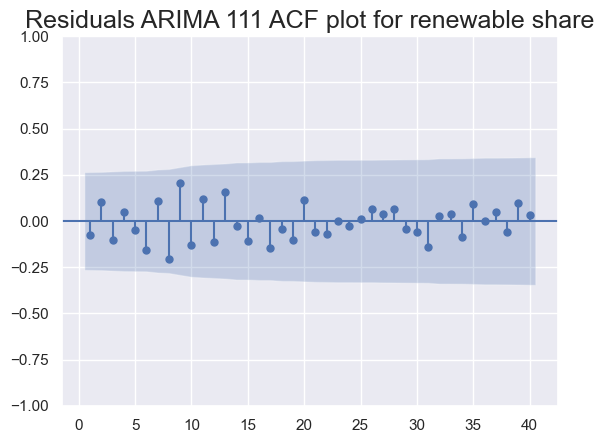

In [653]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_brazil['residuals_ARIMA_111_rshare']=results_AR_I_MA_111_rshare.resid
sgt.plot_acf(df_brazil.residuals_ARIMA_111_rshare[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for renewable share",size=18)
plt.show()

## Checking Stationarity

In [655]:
df_brazil['brazil_renewables_share_energy_1']=df_brazil.renewables_share_energy.diff(1)
model_AR_I_MA_101_brazil=ARIMA(df_brazil.brazil_renewables_share_energy_1[2:],order=(1,0,1))
results_AR_I_MA_101_brazil=model_AR_I_MA_101_brazil.fit()
results_AR_I_MA_101_brazil.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2690867055.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                       
============================================================================================
Dep. Variable:     brazil_renewables_share_energy_1   No. Observations:                   55
Model:                               ARIMA(1, 0, 1)   Log Likelihood                -100.700
Date:                              Fri, 28 Jul 2023   AIC                            209.400
Time:                                      00:17:50   BIC                            217.430
Sample:                                  01-01-1967   HQIC                           212.505
                                       - 01-01-2021                                         
Covariance Type:                                opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.3206      0.279      1.147      0.251      -0.227       0.868
ar.L1          0.6248      0.746      0.837      0.403      -0.838       2.088
ma.L1         -0.5192      0.842     -0.617      0.537      -2.169       1.130
sigma2         2.2784      0.422      5.400      0.000       1.451       3.105
===================================================================================
Ljung-Box (L1) (Q):                   0.11   Jarque-Bera (JB):                 3.69
Prob(Q):                              0.74   Prob(JB):                         0.16
Heteroskedasticity (H):               2.07   Skew:                            -0.58
Prob(H) (two-sided):                  0.13   Kurtosis:                         3.52
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [656]:
result = adfuller(df_brazil.brazil_renewables_share_energy_1[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -3.842682
p-value: 0.002500
Critical Values:
	1%: -3.558
	5%: -2.917
	10%: -2.596
Reject Ho - Time Series is Stationary


So ARIMA(1,1,1) is better model

## Predicting Using ARIMA (1,1,1) 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



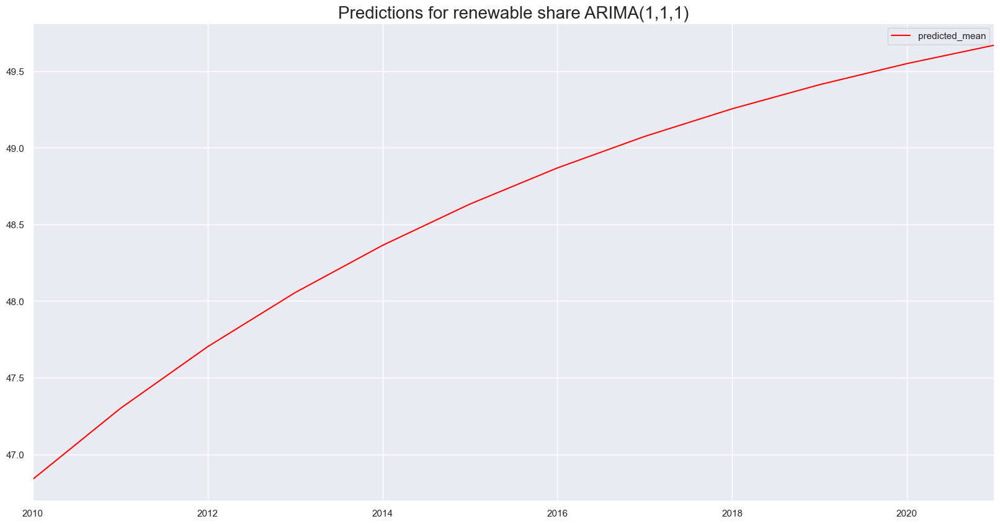

In [657]:
#Let us fit the model for only training dataset
model_Arima_111_rshare=ARIMA(df_brazil_train.renewables_share_energy[1:],order=(1,1,1))
model_Arima_111_rshare=model_Arima_111_rshare.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_brazil_Arima_111_predict_rshare=model_Arima_111_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_brazil_Arima_111_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for renewable share ARIMA(1,1,1)",size=20)
plt.show()

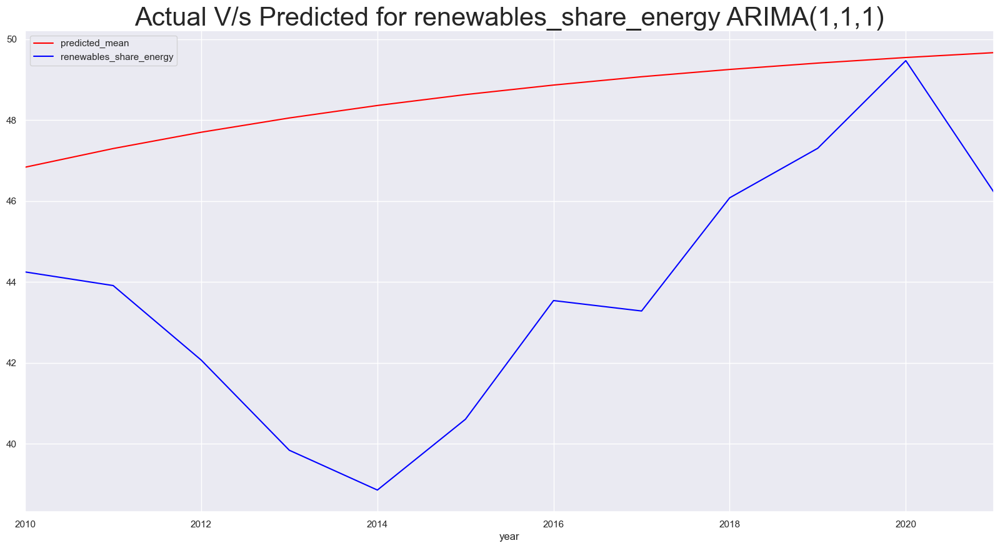

In [658]:
#Let us compare the test data and predicted values
df_brazil_Arima_111_predict_rshare.plot(figsize=(20,10),color="red",legend=True)
df_brazil_test.renewables_share_energy.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for renewables_share_energy ARIMA(1,1,1)",size=30)
plt.show()

In [659]:
rmse=sqrt(mean_squared_error(df_brazil_Arima_111_predict_rshare,df_brazil_test['renewables_share_energy']))
print(rmse)

5.483388695494754


In [660]:
mean_absolute_percentage_error(y_true=df_brazil_test['renewables_share_energy'],
                   y_pred=df_brazil_Arima_111_predict_rshare)

11.370420777148672

## 3.Predictions for Total energy

In [661]:
df_brazil_tenergy=df_brazil[['primary_energy_consumption']]
df_brazil_tenergy.head()

,primary_energy_consumption
year,
1965-01-01,273.870
1966-01-01,298.780
1967-01-01,309.579
1968-01-01,353.486
1969-01-01,385.812


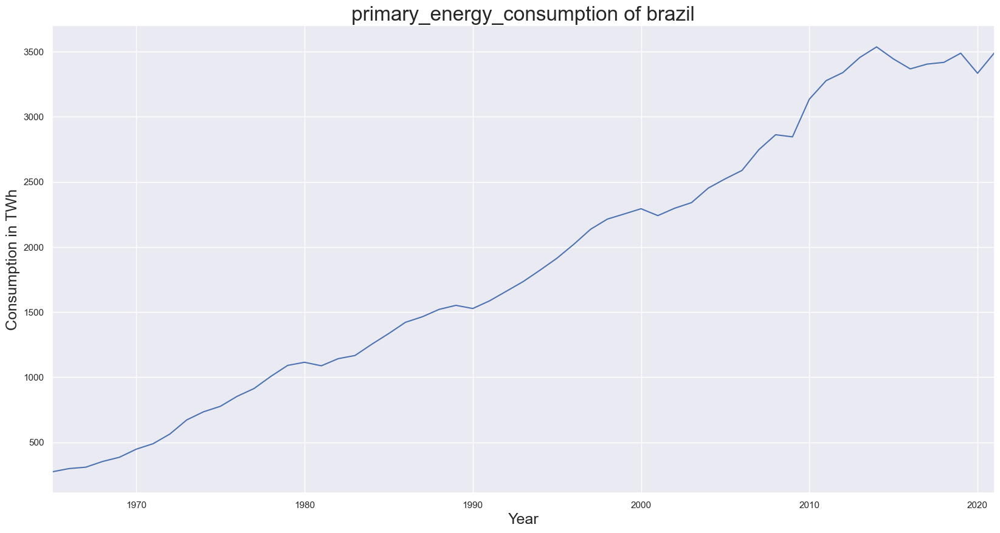

In [662]:
df_brazil.primary_energy_consumption.plot(figsize=(20,10))
plt.title("primary_energy_consumption of brazil",size=24)
plt.ylabel("Consumption in TWh",size=18)
plt.xlabel("Year",size=18)
plt.show()

## Seasonality Checking

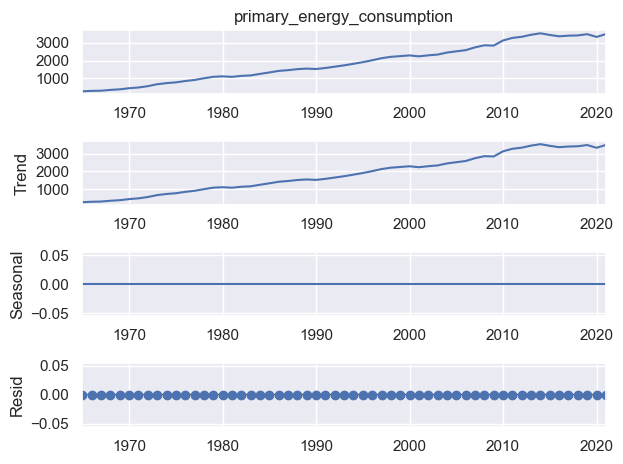

In [663]:
seas_decompose_additive= seasonal_decompose(df_brazil.primary_energy_consumption,model="additive")
seas_decompose_additive.plot()
plt.show()

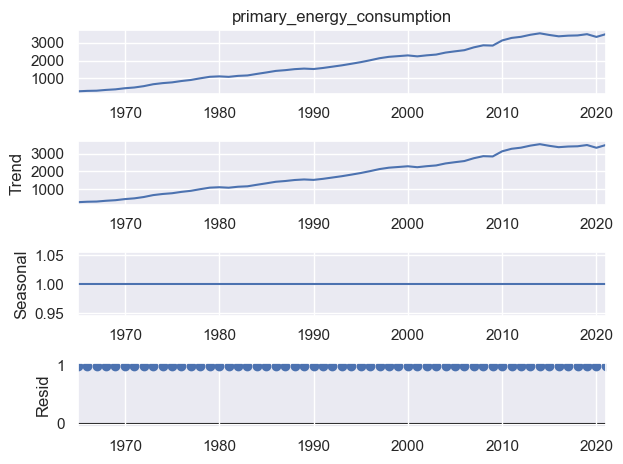

In [664]:
seas_decompose_multiplicative= seasonal_decompose(df_brazil.primary_energy_consumption,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

From both the methods it is clear that,there is no proof of seasonality

In [666]:
result = adfuller(df_brazil.primary_energy_consumption)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - brazil Time Series is Stationary")
else:
    print ("Failed to Reject Ho - brazil Time Series is Non-Stationary")

ADF Statistic: 1.565214
p-value: 0.997749
Critical Values:
	1%: -3.581
	5%: -2.927
	10%: -2.602
Failed to Reject Ho - brazil Time Series is Non-Stationary


## ARIMA

In [667]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_tenergy=ARIMA(df_brazil.primary_energy_consumption[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_tenergy=model_AR_I_MA_111_tenergy.fit()
#print the summary of model results
results_AR_I_MA_111_tenergy.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                   SARIMAX Results                                    
======================================================================================
Dep. Variable:     primary_energy_consumption   No. Observations:                   56
Model:                         ARIMA(1, 1, 1)   Log Likelihood                -310.240
Date:                        Fri, 28 Jul 2023   AIC                            626.481
Time:                                00:26:19   BIC                            632.503
Sample:                            01-01-1966   HQIC                           628.809
                                 - 01-01-2021                                         
Covariance Type:                          opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0000      0.000   3579.539      0.000       0.999       1.001
ma.L1         -0.9983      0.124     -8.078      0.000      -1.241      -0.756
sigma2      4349.2714    2.9e-05    1.5e+08      0.000    4349.271    4349.271
===================================================================================
Ljung-Box (L1) (Q):                   0.52   Jarque-Bera (JB):                27.74
Prob(Q):                              0.47   Prob(JB):                         0.00
Heteroskedasticity (H):               8.43   Skew:                            -0.48
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.34
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 2.11e+23. Standard errors may be unstable.
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1264750758.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



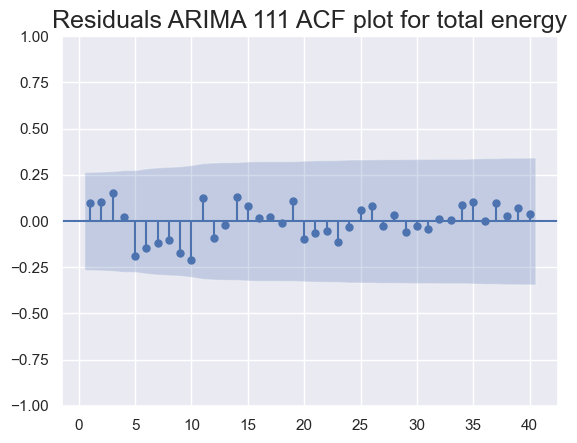

In [668]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_brazil['residuals_ARIMA_111_tenergy']=results_AR_I_MA_111_tenergy.resid
sgt.plot_acf(df_brazil.residuals_ARIMA_111_tenergy[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for total energy",size=18)
plt.show()

## Checking Stationarity

In [669]:
df_brazil['brazil_primary_energy_consumption_1']=df_brazil.primary_energy_consumption.diff(1)
model_AR_I_MA_101_brazil=ARIMA(df_brazil.brazil_primary_energy_consumption_1[2:],order=(1,0,1))
results_AR_I_MA_101_brazil=model_AR_I_MA_101_brazil.fit()
results_AR_I_MA_101_brazil.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\471369241.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-

<class 'statsmodels.iolib.summary.Summary'>
"""
                                        SARIMAX Results                                        
===============================================================================================
Dep. Variable:     brazil_primary_energy_consumption_1   No. Observations:                   55
Model:                                  ARIMA(1, 0, 1)   Log Likelihood                -307.501
Date:                                 Fri, 28 Jul 2023   AIC                            623.002
Time:                                         00:28:33   BIC                            631.032
Sample:                                     01-01-1967   HQIC                           626.107
                                          - 01-01-2021                                         
Covariance Type:                                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         57.9555     12.208      4.747      0.000      34.027      81.884
ar.L1          0.5370      0.796      0.674      0.500      -1.024       2.098
ma.L1         -0.4389      0.847     -0.518      0.604      -2.099       1.221
sigma2      4203.1592    602.633      6.975      0.000    3022.020    5384.299
===================================================================================
Ljung-Box (L1) (Q):                   0.05   Jarque-Bera (JB):                29.47
Prob(Q):                              0.83   Prob(JB):                         0.00
Heteroskedasticity (H):               9.80   Skew:                            -0.10
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.58
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [670]:
result = adfuller(df_brazil.brazil_primary_energy_consumption_1[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -2.506736
p-value: 0.113844
Critical Values:
	1%: -3.585
	5%: -2.928
	10%: -2.602
Failed to Reject Ho - Time Series is Non-Stationary


In [671]:
df_brazil['brazil_primary_energy_consumption_2']=df_brazil.primary_energy_consumption.diff(2)
model_AR_I_MA_101_brazil=ARIMA(df_brazil.brazil_primary_energy_consumption_2[2:],order=(1,0,1))
results_AR_I_MA_101_brazil=model_AR_I_MA_101_brazil.fit()
results_AR_I_MA_101_brazil.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1450474723.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                        SARIMAX Results                                        
===============================================================================================
Dep. Variable:     brazil_primary_energy_consumption_2   No. Observations:                   55
Model:                                  ARIMA(1, 0, 1)   Log Likelihood                -309.827
Date:                                 Fri, 28 Jul 2023   AIC                            627.653
Time:                                         00:29:35   BIC                            635.682
Sample:                                     01-01-1967   HQIC                           630.758
                                          - 01-01-2021                                         
Covariance Type:                                   opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        115.0492     20.324      5.661      0.000      75.215     154.883
ar.L1          0.0762      0.248      0.307      0.759      -0.410       0.562
ma.L1          0.9966      1.548      0.644      0.520      -2.038       4.031
sigma2      4255.5545   6127.126      0.695      0.487   -7753.391    1.63e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                26.86
Prob(Q):                              0.96   Prob(JB):                         0.00
Heteroskedasticity (H):              10.62   Skew:                            -0.19
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.40
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [672]:
result = adfuller(df_brazil.brazil_primary_energy_consumption_2[2:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -3.800513
p-value: 0.002902
Critical Values:
	1%: -3.581
	5%: -2.927
	10%: -2.602
Reject Ho - Time Series is Stationary


So ARIMA(1,2,1) would be better fit model

## Predicting Using ARIMA (1,2,1) 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



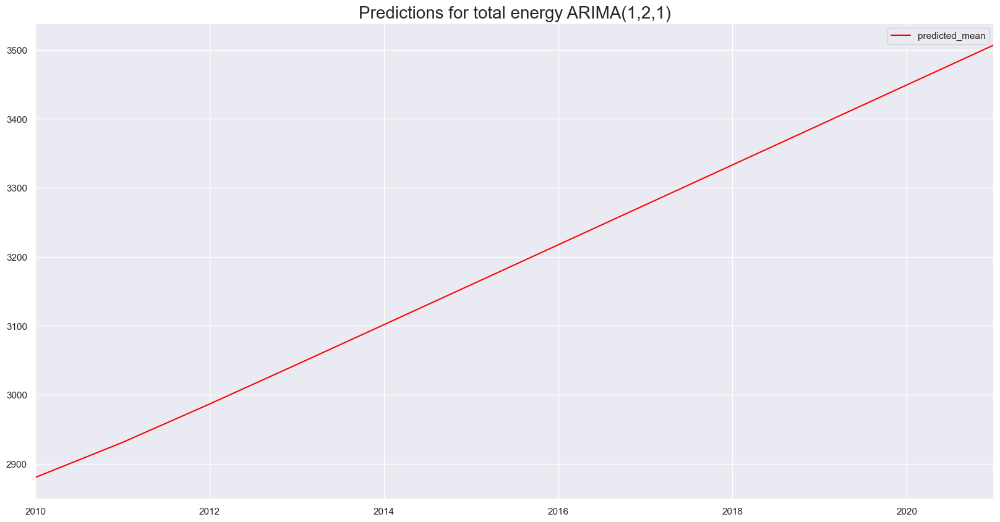

In [673]:
#Let us fit the model for only training dataset
model_Arima_121_tenergy=ARIMA(df_brazil_train.primary_energy_consumption[1:],order=(1,2,1))
model_Arima_121_tenergy=model_Arima_121_tenergy.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_brazil_Arima_121_predict_tenergy=model_Arima_121_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_brazil_Arima_121_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for total energy ARIMA(1,2,1)",size=20)
plt.show()

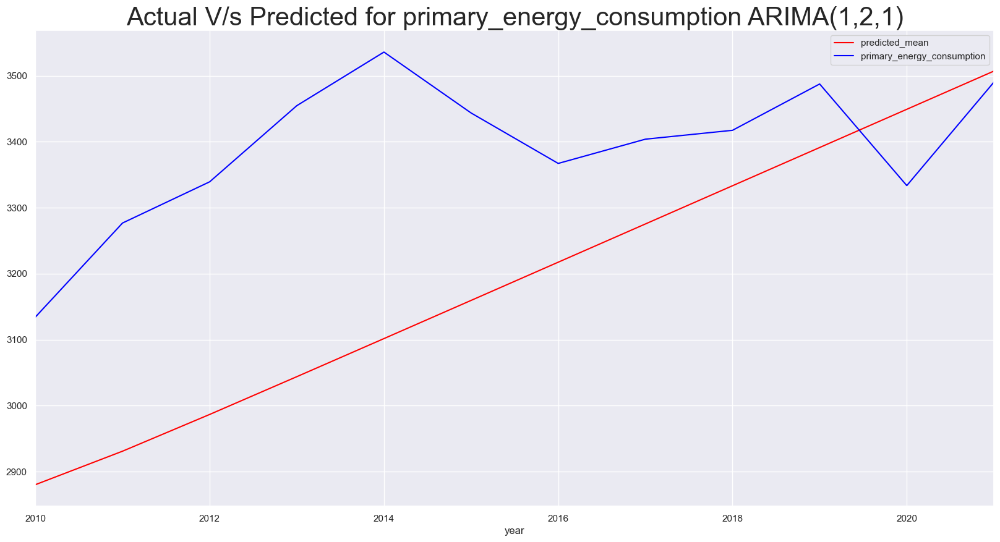

In [674]:
#Let us compare the test data and predicted values
df_brazil_Arima_121_predict_tenergy.plot(figsize=(20,10),color="red",legend=True)
df_brazil_test.primary_energy_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for primary_energy_consumption ARIMA(1,2,1)",size=30)
plt.show()

In [675]:
rmse=sqrt(mean_squared_error(df_brazil_Arima_121_predict_tenergy,df_brazil_test['primary_energy_consumption']))
print(rmse)

260.73792625112816


In [676]:
mean_absolute_percentage_error(y_true=df_brazil_test['primary_energy_consumption'],
                   y_pred=df_brazil_Arima_121_predict_tenergy)

6.587440806905219

## Auto Arima for Brazil 

## 1. Predictions for renewable consumption 

In [677]:
model_auto_brazil=auto_arima(df_brazil.renewables_consumption[1:])
model_auto_brazil

ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True)

In [678]:
model_auto_brazil.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -271.966
Date:                Fri, 28 Jul 2023   AIC                            547.931
Time:                        00:37:33   BIC                            551.946
Sample:                    01-01-1966   HQIC                           549.484
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     27.8320      5.120      5.436      0.000      17.798      37.866
sigma2      1154.9170    134.776      8.569      0.000     890.761    1419.073
===================================================================================
Ljung-Box (L1) (Q):                   0.80   Jarque-Bera (JB):                62.04
Prob(Q):                              0.37   Prob(JB):                         0.00
Heteroskedasticity (H):               8.19   Skew:                            -1.15
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.67
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

So Auto ARIMA reccomends SARIMAX(0,1,0).yet there is no seasonality and exogenous variable here So it can be treated as ARIMA(0,1,0) and its prediction accuracy can be checked in the next step

## Predictions for Auto ARIMA

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



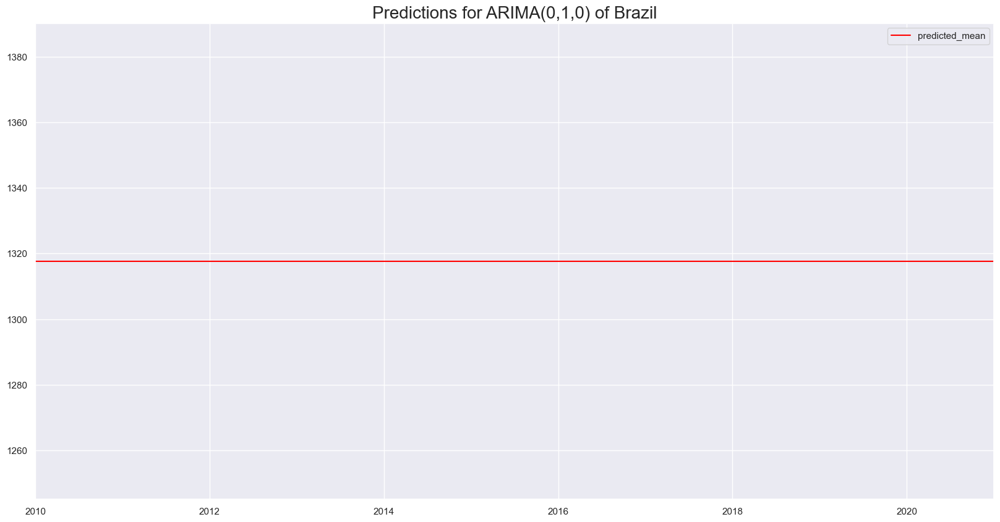

In [679]:
#Let us fit the model for only training dataset
model_Arima_010_brazil=ARIMA(df_brazil_train.renewables_consumption[1:],order=(0,1,0))
model_Arima_010_brazil=model_Arima_010_brazil.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_brazil_Arima_010_predict=model_Arima_010_brazil.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_brazil_Arima_010_predict[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for ARIMA(0,1,0) of Brazil",size=20)
plt.show()

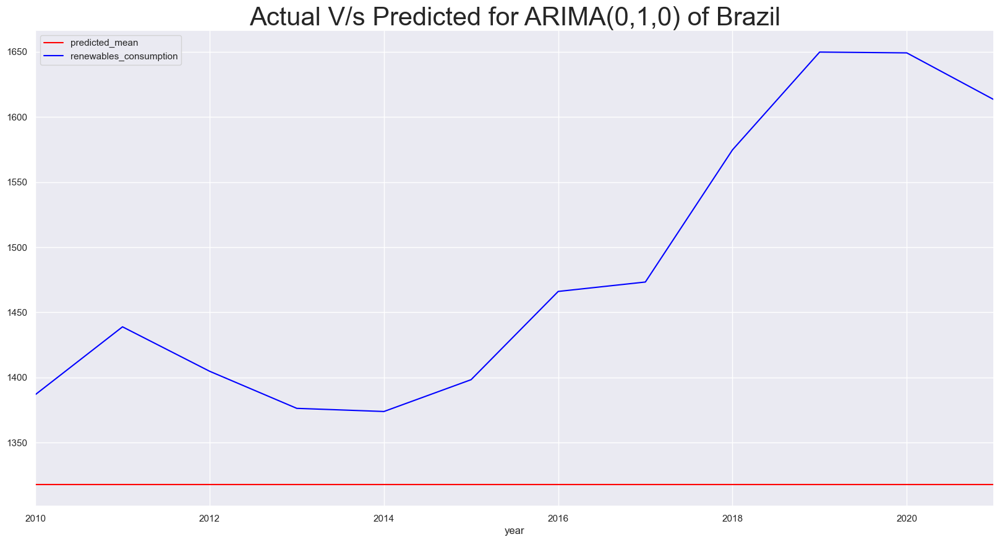

In [680]:
#Let us compare the test data and predicted values
df_brazil_Arima_010_predict.plot(figsize=(20,10),color="red",legend=True)
df_brazil_test.renewables_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for ARIMA(0,1,0) of Brazil",size=30)
plt.show()

In [681]:
rmse_010_brazil=sqrt(mean_squared_error(df_brazil_Arima_010_predict,df_brazil_test['renewables_consumption']))
mse_010_brazil=mean_squared_error(df_brazil_Arima_010_predict,df_brazil_test['renewables_consumption'])
mae_brazil = np.mean(np.abs(df_brazil_Arima_010_predict  - df_brazil_test['renewables_consumption']))
print("Root Mean Squared Error for ARIMA(0,1,0): ",rmse_010_brazil)
print("Mean Squared Error for ARIMA(0,1,0): ",mse_010_brazil)
print("Mean absolute Error for ARIMA(0,1,0): ",mae_brazil)

Root Mean Squared Error for ARIMA(0,1,0):  195.81941293404316
Mean Squared Error for ARIMA(0,1,0):  38345.24248183331
Mean absolute Error for ARIMA(0,1,0):  166.10883333333325


In [682]:
mean_absolute_percentage_error(y_true=df_brazil_test['renewables_consumption'],
                   y_pred=df_brazil_Arima_010_predict)

10.77473916992311

## 2. Predictions for renewable share 

In [683]:
model_auto_rshare=auto_arima(df_brazil.renewables_share_energy[1:])

In [684]:
model_auto_rshare

ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True)

In [685]:
model_auto_rshare.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -101.188
Date:                Fri, 28 Jul 2023   AIC                            206.377
Time:                        00:40:15   BIC                            210.391
Sample:                    01-01-1966   HQIC                           207.929
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3382      0.219      1.544      0.123      -0.091       0.768
sigma2         2.3203      0.434      5.344      0.000       1.469       3.171
===================================================================================
Ljung-Box (L1) (Q):                   0.31   Jarque-Bera (JB):                 2.93
Prob(Q):                              0.58   Prob(JB):                         0.23
Heteroskedasticity (H):               1.77   Skew:                            -0.54
Prob(H) (two-sided):                  0.23   Kurtosis:                         3.36
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



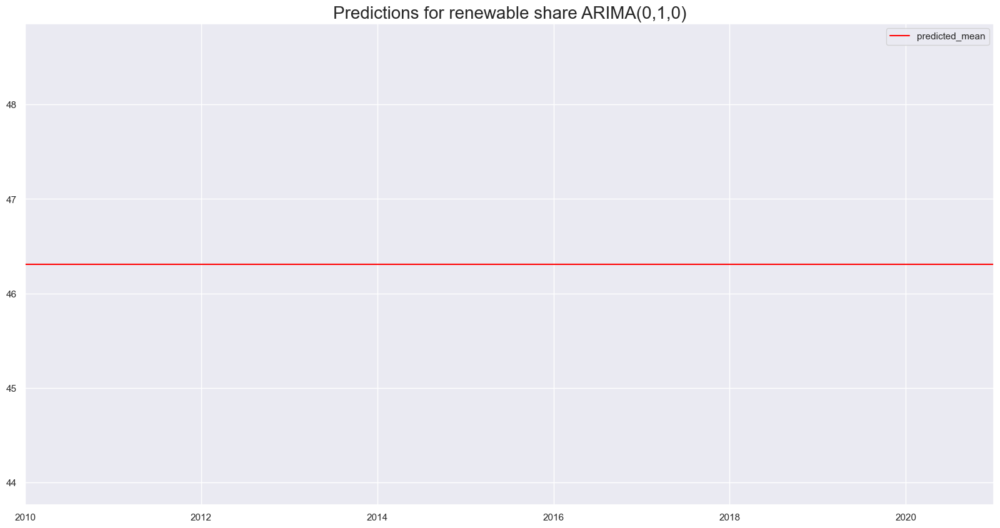

In [686]:
#Let us fit the model for only training dataset
model_Arima_010_rshare=ARIMA(df_brazil_train.renewables_share_energy[1:],order=(0,1,0))
model_Arima_010_rshare=model_Arima_010_rshare.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_brazil_Arima_010_predict_rshare=model_Arima_010_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_brazil_Arima_010_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for renewable share ARIMA(0,1,0)",size=20)
plt.show()

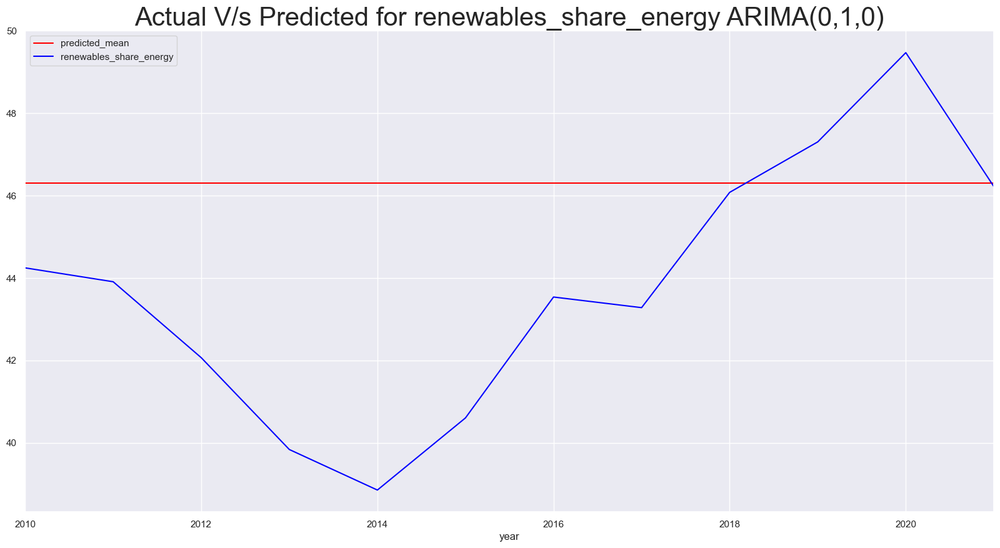

In [687]:
#Let us compare the test data and predicted values
df_brazil_Arima_010_predict_rshare.plot(figsize=(20,10),color="red",legend=True)
df_brazil_test.renewables_share_energy.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for renewables_share_energy ARIMA(0,1,0)",size=30)
plt.show()

In [688]:
rmse=sqrt(mean_squared_error(df_brazil_Arima_010_predict_rshare,df_brazil_test['renewables_share_energy']))
print(rmse)

3.9363103493838807


In [689]:
mean_absolute_percentage_error(y_true=df_brazil_test['renewables_share_energy'],
                   y_pred=df_brazil_Arima_010_predict_rshare)

7.686981669305581

## 3. Predictions for total energy

In [690]:
model_auto_tenergy=auto_arima(df_brazil.primary_energy_consumption[1:])

In [691]:
model_auto_tenergy

ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True)

In [692]:
model_auto_tenergy.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 1, 0)   Log Likelihood                -307.875
Date:                Fri, 28 Jul 2023   AIC                            619.751
Time:                        00:45:05   BIC                            623.766
Sample:                    01-01-1966   HQIC                           621.303
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     58.0303      8.827      6.574      0.000      40.730      75.330
sigma2      4262.4248    500.143      8.522      0.000    3282.163    5242.687
===================================================================================
Ljung-Box (L1) (Q):                   0.38   Jarque-Bera (JB):                25.37
Prob(Q):                              0.54   Prob(JB):                         0.00
Heteroskedasticity (H):               9.67   Skew:                            -0.17
Prob(H) (two-sided):                  0.00   Kurtosis:                         6.31
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



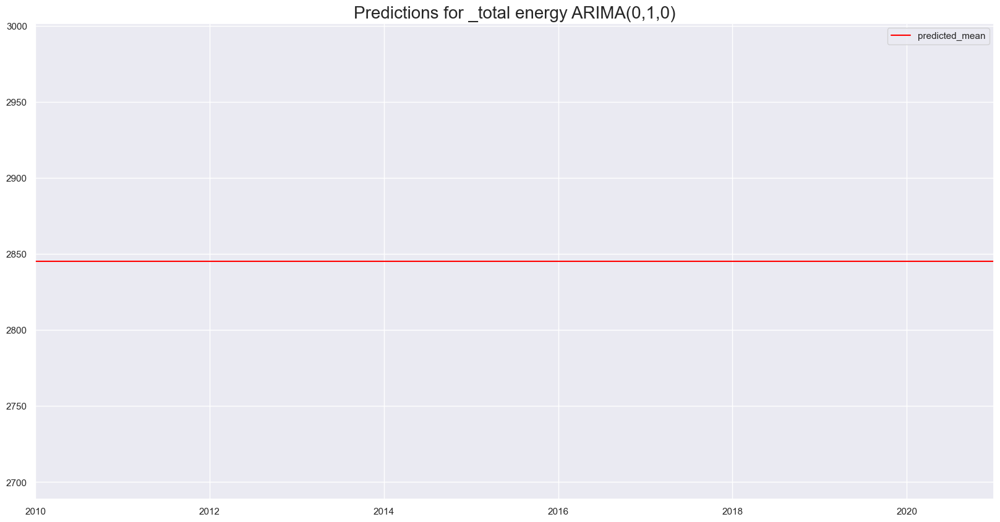

In [693]:
#Let us fit the model for only training dataset
model_Arima_010_tenergy=ARIMA(df_brazil_train.primary_energy_consumption[1:],order=(0,1,0))
model_Arima_010_tenergy=model_Arima_010_tenergy.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_brazil_Arima_010_predict_tenergy=model_Arima_010_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_brazil_Arima_010_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for _total energy ARIMA(0,1,0)",size=20)
plt.show()

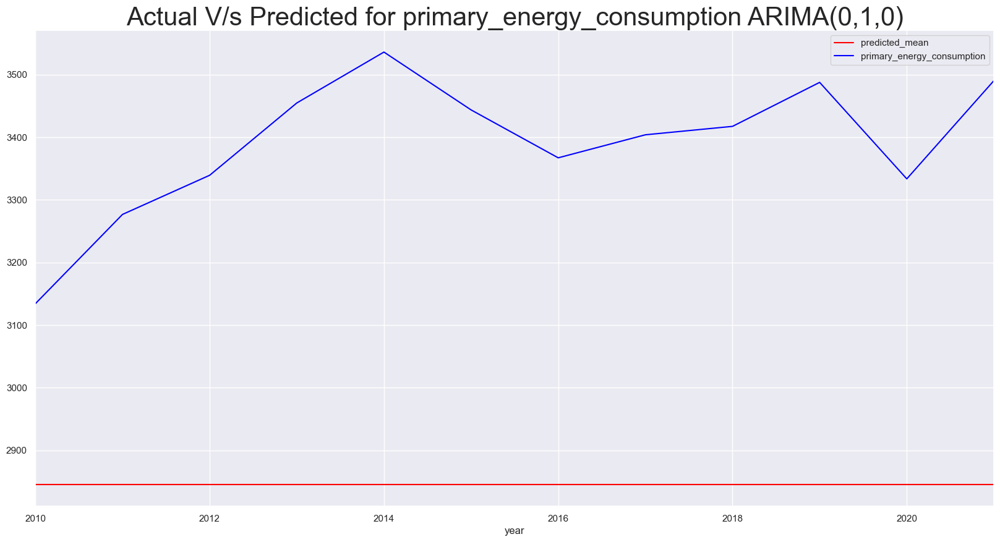

In [694]:
#Let us compare the test data and predicted values
df_brazil_Arima_010_predict_tenergy.plot(figsize=(20,10),color="red",legend=True)
df_brazil_test.primary_energy_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for primary_energy_consumption ARIMA(0,1,0)",size=30)
plt.show()

In [695]:
rmse=sqrt(mean_squared_error(df_brazil_Arima_010_predict_tenergy,df_brazil_test['primary_energy_consumption']))
print(rmse)

555.1806888517617


In [696]:
mean_absolute_percentage_error(y_true=df_brazil_test['primary_energy_consumption'],
                   y_pred=df_brazil_Arima_010_predict_tenergy)

15.99311617482297

# FB prophet for Brazil

## 1. Prediction for Renewable consumption 

In [697]:
df_brazil_no_index.columns = ['ds','y']
df_brazil_no_index.head()

,ds,y
2872,1965-01-01,75.448
2873,1966-01-01,82.518
2874,1967-01-01,86.312
2875,1968-01-01,90.336
2876,1969-01-01,96.670


In [698]:
train_brazil = df_brazil_no_index.iloc[:len(df_brazil_no_index)-12]
test_brazil = df_brazil_no_index.iloc[len(df_brazil_no_index)-12:]
test_brazil

,ds,y
2917,2010-01-01,1386.804
2918,2011-01-01,1438.850
2919,2012-01-01,1404.720
2920,2013-01-01,1376.248
2921,2014-01-01,1373.833
2922,2015-01-01,1398.252
2923,2016-01-01,1466.023
2924,2017-01-01,1473.244
2925,2018-01-01,1574.748
2926,2019-01-01,1649.812


In [699]:
model_brazil = Prophet()
model_brazil.fit(train_brazil)
future_brazil = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast_brazil = m.predict(future_brazil)

00:51:07 - cmdstanpy - INFO - Chain [1] start processing
00:51:08 - cmdstanpy - INFO - Chain [1] done processing


In [700]:
forecast_brazil[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,4219.938648,4127.411373,4313.156829
53,2018-01-01,4244.420486,4145.782652,4340.147732
54,2019-01-01,4287.492504,4187.175823,4395.586699
55,2020-01-01,4349.157432,4243.532022,4463.621712
56,2021-01-01,4371.890408,4262.001843,4482.906044


In [701]:
test_brazil.tail()

,ds,y
2924,2017-01-01,1473.244
2925,2018-01-01,1574.748
2926,2019-01-01,1649.812
2927,2020-01-01,1649.188
2928,2021-01-01,1613.276


In [702]:
plot_plotly(model_brazil,forecast_brazil)

In [703]:
plot_components_plotly(model_brazil, forecast_brazil)


In [704]:
predictions_brazil = forecast_brazil.iloc[-12:]['yhat']
predictions_brazil.tail()

52    4219.938648
53    4244.420486
54    4287.492504
55    4349.157432
56    4371.890408
Name: yhat, dtype: float64

In [705]:
test_brazil['y'].tail()

2924    1473.244
2925    1574.748
2926    1649.812
2927    1649.188
2928    1613.276
Name: y, dtype: float64

In [707]:
from statsmodels.tools.eval_measures import rmse


In [708]:
print("Root Mean Squared Error between actual and  predicted values for brazil: ",rmse(predictions_brazil,test_brazil['y']))
print("Mean Value of Test Dataset for canada:", test_brazil['y'].mean())

Root Mean Squared Error between actual and  predicted values for brazil:  2678.412810326605
Mean Value of Test Dataset for canada: 1483.7498333333333


In [709]:
mean_absolute_percentage_error(y_true=test_brazil['y'],
                   y_pred=predictions_brazil)

181.2559007673848

## 2. Predictions for Renewable share 

In [710]:
df_brazil_No_index_rshare.head()

,year,renewables_share_energy
2872,1965-01-01,27.549
2873,1966-01-01,27.618
2874,1967-01-01,27.880
2875,1968-01-01,25.556
2876,1969-01-01,25.056


In [711]:
df_brazil_No_index_rshare.columns = ['ds','y']
df_brazil_No_index_rshare.head()

,ds,y
2872,1965-01-01,27.549
2873,1966-01-01,27.618
2874,1967-01-01,27.880
2875,1968-01-01,25.556
2876,1969-01-01,25.056


In [774]:
train = df_brazil_No_index_rshare.iloc[:len(df_brazil_No_index_rshare)-12]
test = df_brazil_No_index_rshare.iloc[len(df_brazil_No_index_rshare)-12:]
test.head()

,ds,y
2917,2010-01-01,44.247
2918,2011-01-01,43.910
2919,2012-01-01,42.066
2920,2013-01-01,39.837
2921,2014-01-01,38.853


In [713]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

00:55:06 - cmdstanpy - INFO - Chain [1] start processing
00:55:06 - cmdstanpy - INFO - Chain [1] done processing


In [714]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,20.781466,41.282670,47.050961,20.273155,21.331932,23.383520,23.383520,23.383520,23.383520,23.383520,23.383520,0.0,0.0,0.0,44.164986
53,2018-01-01,20.809690,41.395402,47.441778,20.189792,21.469424,23.412169,23.412169,23.412169,23.412169,23.412169,23.412169,0.0,0.0,0.0,44.221858
54,2019-01-01,20.837913,41.255779,47.392826,20.109398,21.612189,23.414165,23.414165,23.414165,23.414165,23.414165,23.414165,0.0,0.0,0.0,44.252078
55,2020-01-01,20.866137,41.385286,47.399150,20.026013,21.749327,23.389465,23.389465,23.389465,23.389465,23.389465,23.389465,0.0,0.0,0.0,44.255602
56,2021-01-01,20.894437,41.148007,47.510122,19.908344,21.877988,23.383520,23.383520,23.383520,23.383520,23.383520,23.383520,0.0,0.0,0.0,44.277957


In [715]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,44.164986,41.282670,47.050961
53,2018-01-01,44.221858,41.395402,47.441778
54,2019-01-01,44.252078,41.255779,47.392826
55,2020-01-01,44.255602,41.385286,47.399150
56,2021-01-01,44.277957,41.148007,47.510122


In [716]:
test.tail()


,ds,y
2924,2017-01-01,43.281
2925,2018-01-01,46.080
2926,2019-01-01,47.305
2927,2020-01-01,49.472
2928,2021-01-01,46.220


In [717]:
plot_plotly(m,forecast)


In [718]:
plot_components_plotly(m, forecast)


In [719]:
predictions = forecast.iloc[-12:]['yhat']
predictions.tail()

52    44.164986
53    44.221858
54    44.252078
55    44.255602
56    44.277957
Name: yhat, dtype: float64

In [720]:
test['y'].tail()

2924    43.281
2925    46.080
2926    47.305
2927    49.472
2928    46.220
Name: y, dtype: float64

In [721]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))


Root Mean Squared Error between actual and  predicted values:  2.982187832845279


In [722]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

5.581284731631216

## 3. Predictions for Total Energy 

In [723]:
df_brazil_No_index_tenergy.head()

,year,primary_energy_consumption
2872,1965-01-01,273.870
2873,1966-01-01,298.780
2874,1967-01-01,309.579
2875,1968-01-01,353.486
2876,1969-01-01,385.812


In [724]:
df_brazil_No_index_tenergy.columns = ['ds','y']
df_brazil_No_index_tenergy.head()

,ds,y
2872,1965-01-01,273.870
2873,1966-01-01,298.780
2874,1967-01-01,309.579
2875,1968-01-01,353.486
2876,1969-01-01,385.812


In [795]:
train = df_brazil_No_index_tenergy.iloc[:len(df_brazil_No_index_tenergy)-12]
test = df_brazil_No_index_tenergy.iloc[len(df_brazil_No_index_tenergy)-12:]
test.head()

,ds,y
2917,2010-01-01,3134.266
2918,2011-01-01,3276.812
2919,2012-01-01,3339.294
2920,2013-01-01,3454.733
2921,2014-01-01,3536.000


In [726]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

00:59:36 - cmdstanpy - INFO - Chain [1] start processing
00:59:36 - cmdstanpy - INFO - Chain [1] done processing


In [727]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,3505.662025,3265.429842,3411.093568,3499.756957,3510.733366,-166.873854,-166.873854,-166.873854,-166.873854,-166.873854,-166.873854,0.0,0.0,0.0,3338.788171
53,2018-01-01,3570.266834,3330.631563,3467.619181,3563.181900,3576.262325,-171.522988,-171.522988,-171.522988,-171.522988,-171.522988,-171.522988,0.0,0.0,0.0,3398.743846
54,2019-01-01,3634.871644,3402.297763,3532.833882,3626.692773,3642.000075,-168.320093,-168.320093,-168.320093,-168.320093,-168.320093,-168.320093,0.0,0.0,0.0,3466.551550
55,2020-01-01,3699.476453,3476.119744,3611.466878,3690.024400,3707.794664,-157.264484,-157.264484,-157.264484,-157.264484,-157.264484,-157.264484,0.0,0.0,0.0,3542.211969
56,2021-01-01,3764.258262,3527.427071,3669.662905,3753.624384,3773.764739,-166.873854,-166.873854,-166.873854,-166.873854,-166.873854,-166.873854,0.0,0.0,0.0,3597.384408


In [728]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,3338.788171,3265.429842,3411.093568
53,2018-01-01,3398.743846,3330.631563,3467.619181
54,2019-01-01,3466.551550,3402.297763,3532.833882
55,2020-01-01,3542.211969,3476.119744,3611.466878
56,2021-01-01,3597.384408,3527.427071,3669.662905


In [729]:
test.tail()


,ds,y
2924,2017-01-01,3403.931
2925,2018-01-01,3417.385
2926,2019-01-01,3487.616
2927,2020-01-01,3333.586
2928,2021-01-01,3490.447


In [730]:
plot_plotly(m,forecast)


In [731]:
plot_components_plotly(m, forecast)


In [732]:
predictions = forecast.iloc[-12:]['yhat']
predictions.tail()

52    3338.788171
53    3398.743846
54    3466.551550
55    3542.211969
56    3597.384408
Name: yhat, dtype: float64

In [733]:
test['y'].tail()

2924    3403.931
2925    3417.385
2926    3487.616
2927    3333.586
2928    3490.447
Name: y, dtype: float64

In [734]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))


Root Mean Squared Error between actual and  predicted values:  239.68342357855823


In [735]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

5.934611102076377

# VAR Model development 

## 1. Predictions for renewable consumption 

In [736]:
df_var_brazil=df_world_var[df_world_var['country'].isin(['Brazil'])]
df_var_brazil

,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
2807,Brazil,1900,BRA,NaN,NaN,NaN,NaN,NaN,NaN
2808,Brazil,1901,BRA,NaN,NaN,NaN,NaN,NaN,NaN
2809,Brazil,1902,BRA,NaN,NaN,NaN,NaN,NaN,NaN
2810,Brazil,1903,BRA,NaN,NaN,NaN,NaN,NaN,NaN
2811,Brazil,1904,BRA,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
2924,Brazil,2017,BRA,1473.244,3403.931,1890.492,7065.751,9066.894,16325.418
2925,Brazil,2018,BRA,1574.748,3417.385,1802.844,7492.857,8578.165,16260.365
2926,Brazil,2019,BRA,1649.812,3487.616,1797.008,7790.108,8485.141,16467.885
2927,Brazil,2020,BRA,1649.188,3333.586,1648.983,7735.537,7734.577,15636.229


In [737]:
df_var_brazil.dropna(inplace=True)
df_var_brazil.tail(15)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2979827765.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
2914,Brazil,2007,BRA,1218.903,2746.501,1494.088,6389.071,7831.495,14396.211
2915,Brazil,2008,BRA,1241.076,2861.812,1583.070,6441.380,8216.386,14853.263
2916,Brazil,2009,BRA,1317.641,2845.335,1492.971,6773.895,7675.250,14627.652
2917,Brazil,2010,BRA,1386.804,3134.266,1708.780,7062.792,8702.571,15962.363
2918,Brazil,2011,BRA,1438.850,3276.812,1796.509,7260.126,9064.792,16534.084
2919,Brazil,2012,BRA,1404.720,3339.294,1892.375,7024.382,9462.931,16698.334
2920,Brazil,2013,BRA,1376.248,3454.733,2038.079,6822.507,10103.418,17126.229
2921,Brazil,2014,BRA,1373.833,3536.000,2122.189,6752.361,10430.514,17379.367
2922,Brazil,2015,BRA,1398.252,3443.672,2007.344,6814.485,9782.940,16782.990
2923,Brazil,2016,BRA,1466.023,3367.171,1860.395,7087.042,8993.517,16277.570


In [738]:
df_var_brazil.year=pd.to_datetime(df_var_brazil.year,format='%Y', errors='coerce')


C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2044220356.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [739]:
df_var_brazil.set_index("year",inplace=True)
df_var_brazil.head()

,country,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
year,,,,,,,,
1965-01-01,Brazil,BRA,75.448,273.870,198.422,891.565,2344.756,3236.321
1966-01-01,Brazil,BRA,82.518,298.780,216.262,948.706,2486.366,3435.073
1967-01-01,Brazil,BRA,86.312,309.579,223.268,966.283,2499.544,3465.827
1968-01-01,Brazil,BRA,90.336,353.486,263.150,985.564,2870.959,3856.523
1969-01-01,Brazil,BRA,96.670,385.812,289.142,1028.399,3075.967,4104.366


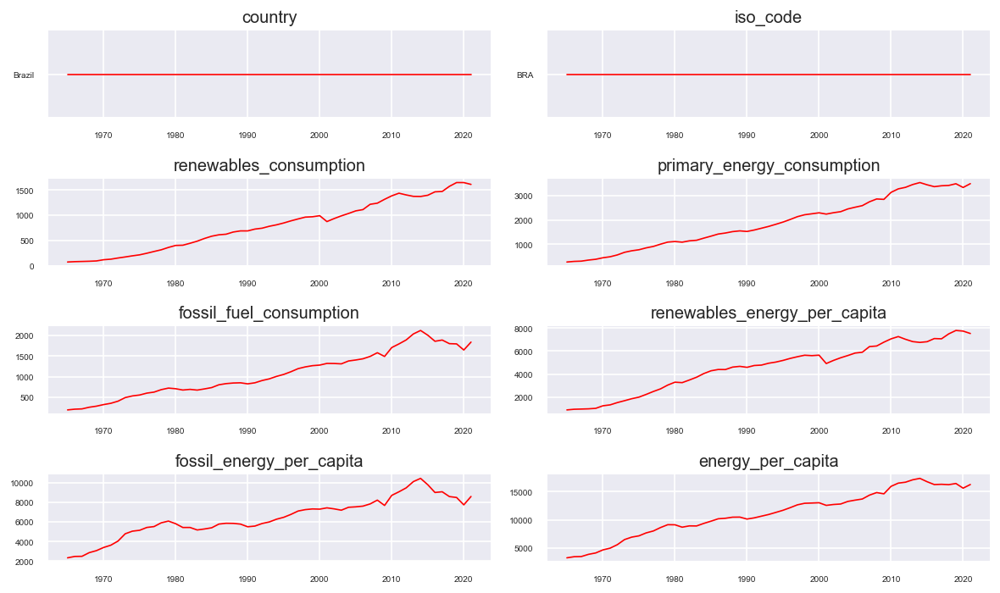

In [740]:
fig, axes = plt.subplots(nrows=4, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_brazil[df_var_brazil.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_brazil.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

So Renewable consumption and remeables energy per-capita patterns are looking alike.

In [741]:
print('renewables_energy_per_capita causes renewables_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_brazil[['renewables_consumption', 'renewables_energy_per_capita']], 8)

print('\n renewables_consumption causes renewables_energy_per_capita?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_brazil[['renewables_energy_per_capita', 'renewables_consumption']], 8)

renewables_energy_per_capita causes renewables_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.4064  , p=0.5265  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=0.4294  , p=0.5123  , df=1
likelihood ratio test: chi2=0.4278  , p=0.5131  , df=1
parameter F test:         F=0.4064  , p=0.5265  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.1482  , p=0.8627  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=0.3260  , p=0.8496  , df=2
likelihood ratio test: chi2=0.3250  , p=0.8500  , df=2
parameter F test:         F=0.1482  , p=0.8627  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.2158  , p=0.8849  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=0.7440  , p=0.8628  , df=3
likelihood ratio test: chi2=0.7389  , p=0.8640  , df=3
parameter F test:         F=0.2158  , p=0.8849  , df_denom=47, df_num=3

Granger Causality
n

In [742]:
print('\n So Finally renewables_energy_per_capita causes renewables_consumption\n')
#Taking two of them into separate dataframe before fitting into model
df_var_brazil=df_var_brazil[['renewables_consumption','renewables_energy_per_capita']]
print(df_var_brazil.shape)


 So Finally renewables_energy_per_capita causes renewables_consumption

(57, 2)


In [743]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_brazil=df_var_brazil[:-12]
test_var_brazil=df_var_brazil[-12:]

In [744]:
model = VAR(train_var_brazil)


C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [745]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        22.18       22.27   4.304e+09       22.21
1       13.18*      13.44*  5.282e+05*      13.27*
2        13.32       13.77   6.135e+05       13.48
3        13.50       14.12   7.392e+05       13.72
4        13.72       14.52   9.262e+05       13.99
5        13.93       14.90   1.167e+06       14.26
6        14.14       15.30   1.495e+06       14.54
7        14.04       15.38   1.414e+06       14.50
8        14.22       15.73   1.790e+06       14.74
9        13.68       15.36   1.129e+06       14.26
10       13.87       15.73   1.527e+06       14.51
--------------------------------------------------


Order '1' is having all lower values.So it is the order of the model

In [746]:
var_model = VARMAX(train_var_brazil, order=(1,0),enforce_stationarity= True)
fitted_model = var_model.fit(disp=False)
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\varmax.py:374: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



                                               Statespace Model Results                                               
Dep. Variable:     ['renewables_consumption', 'renewables_energy_per_capita']   No. Observations:                   45
Model:                                                                 VAR(1)   Log Likelihood                -969.706
                                                                  + intercept   AIC                           1957.413
Date:                                                        Fri, 28 Jul 2023   BIC                           1973.673
Time:                                                                01:02:40   HQIC                          1963.474
Sample:                                                            01-01-1965                                         
                                                                 - 01-01-2009                                         
Covariance Type:                                

In [747]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [748]:
#Naming the columns of predicted results with suitable names
predictions.columns=['brazil_consumption_predicted','brazil per capita consumption_predicted']
predictions

,brazil_consumption_predicted,brazil per capita consumption_predicted
2010-01-01,1349.658745,6978.262504
2011-01-01,1352.540292,6996.556417
2012-01-01,1352.837267,6998.344397
2013-01-01,1352.904966,6998.668168
2014-01-01,1352.952321,6998.862027
2015-01-01,1352.997864,6999.044334
2016-01-01,1353.043240,6999.225590
2017-01-01,1353.088593,6999.406724
2018-01-01,1353.133938,6999.587820
2019-01-01,1353.179276,6999.768886


<Axes: >

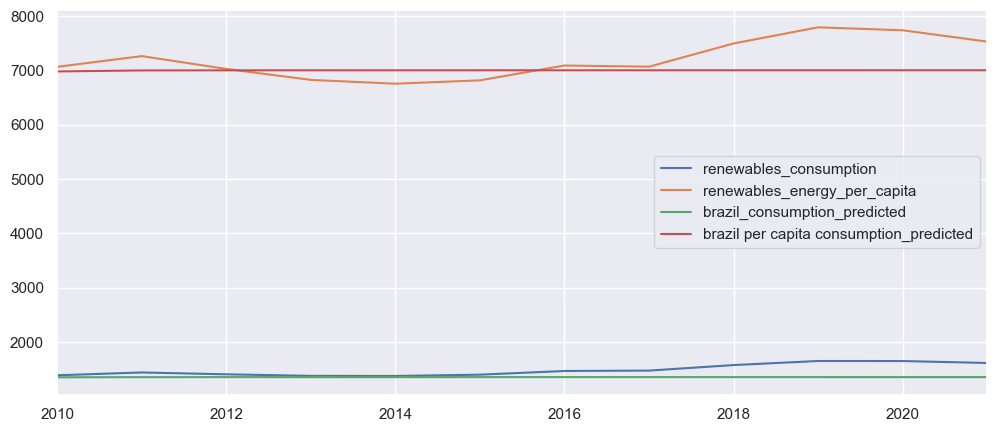

In [749]:
test_vs_pred=pd.concat([test_var_brazil,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [750]:
mean_absolute_percentage_error(y_true=test_var_brazil['renewables_consumption'],
                   y_pred=predictions['brazil_consumption_predicted'])

8.400064727909738

In [751]:
rmse_consumption=math.sqrt(mean_squared_error(predictions['brazil_consumption_predicted'],test_var_brazil['renewables_consumption']))
print('Mean value of consumption is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_brazil['renewables_consumption']),rmse_consumption))

Mean value of consumption is : 1483.7498333333333. Root Mean Squared Error is :166.84643459963502


# Future Consumption of Brazil

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



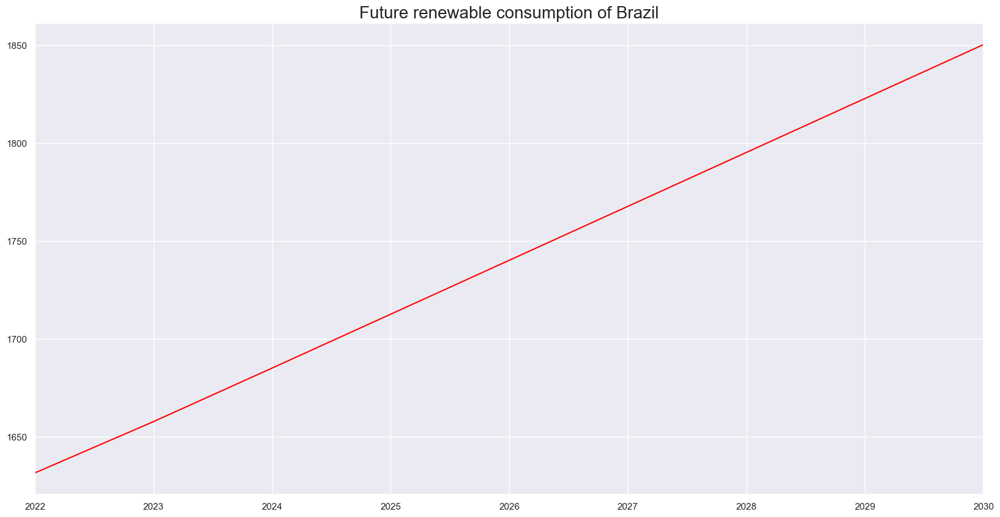

In [752]:
#Let us fit the model for whole dataset
forecast_Arima_121_brazil=ARIMA(df_brazil.renewables_consumption[1:],order=(1,2,1))
forecast_Arima_121_brazil=forecast_Arima_121_brazil.fit()
#predicting the values for test dataset
start_date="2022-01-01"
end_date="2030-01-01"
df_brazil_Arima_121_forecast=forecast_Arima_121_brazil.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_brazil_Arima_121_forecast[start_date:end_date].plot(figsize=(20,10),color="red")
plt.title("Future renewable consumption of Brazil",size=20)
plt.show()

In [753]:
df_brazil_Arima_121_forecast

2022-01-01    1631.526447
2023-01-01    1657.721073
2024-01-01    1685.080896
2025-01-01    1712.611623
2026-01-01    1740.167416
2027-01-01    1767.726886
2028-01-01    1795.286896
2029-01-01    1822.846984
2030-01-01    1850.407084
Freq: AS-JAN, Name: predicted_mean, dtype: float64

## 2. Predictions for renewable share 

In [754]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_2_brazil=df_world_var_2[df_world_var_2['country'].isin(['Brazil'])]
df_var_2_brazil

,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
2807,Brazil,1900,BRA,NaN,NaN,NaN,NaN
2808,Brazil,1901,BRA,NaN,NaN,NaN,NaN
2809,Brazil,1902,BRA,NaN,NaN,NaN,NaN
2810,Brazil,1903,BRA,NaN,NaN,NaN,NaN
2811,Brazil,1904,BRA,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
2924,Brazil,2017,BRA,43.281,4.962,1.181,55.539
2925,Brazil,2018,BRA,46.080,5.080,1.164,52.755
2926,Brazil,2019,BRA,47.305,5.027,1.170,51.525
2927,Brazil,2020,BRA,49.472,5.625,1.062,49.466


In [755]:
#dropping the null values corresponding to initial years of null data
df_var_2_brazil.dropna(inplace=True)
df_var_2_brazil.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2390306428.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
2924,Brazil,2017,BRA,43.281,4.962,1.181,55.539
2925,Brazil,2018,BRA,46.080,5.080,1.164,52.755
2926,Brazil,2019,BRA,47.305,5.027,1.170,51.525
2927,Brazil,2020,BRA,49.472,5.625,1.062,49.466
2928,Brazil,2021,BRA,46.220,5.026,1.058,52.722


In [756]:
#Converting them into date time format with years format
df_var_2_brazil.year=pd.to_datetime(df_var_2_brazil.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3895277976.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [757]:
#Setting the year as index
df_var_2_brazil.set_index("year",inplace=True)
df_var_2_brazil.tail()

,country,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
year,,,,,,
2017-01-01,Brazil,BRA,43.281,4.962,1.181,55.539
2018-01-01,Brazil,BRA,46.080,5.080,1.164,52.755
2019-01-01,Brazil,BRA,47.305,5.027,1.170,51.525
2020-01-01,Brazil,BRA,49.472,5.625,1.062,49.466
2021-01-01,Brazil,BRA,46.220,5.026,1.058,52.722


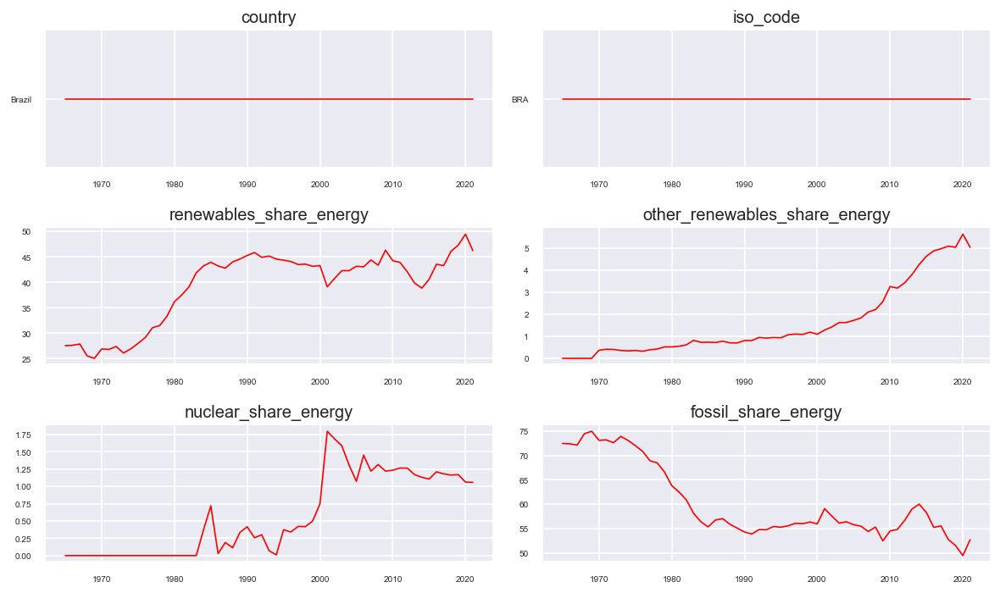

In [758]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=3, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_2_brazil[df_var_2_brazil.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_2_brazil.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

renewables and fossilfuel having opposite relation.But other renewables is having same starting and ending point

In [760]:
#Let us check which time series is causing the other using granger casuality tests
print('	renewables_share_energy causes other_renewables_share_energy?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_2_brazil[['other_renewables_share_energy', 'renewables_share_energy']], 8)
print('\n other_renewables_share_energy causes renewables_share_energy?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_2_brazil[['renewables_share_energy', 'other_renewables_share_energy']], 8)

	renewables_share_energy causes other_renewables_share_energy?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.0485  , p=0.8265  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=0.0513  , p=0.8209  , df=1
likelihood ratio test: chi2=0.0512  , p=0.8209  , df=1
parameter F test:         F=0.0485  , p=0.8265  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=0.7648  , p=0.4708  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=1.6825  , p=0.4312  , df=2
likelihood ratio test: chi2=1.6573  , p=0.4366  , df=2
parameter F test:         F=0.7648  , p=0.4708  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=1.7399  , p=0.1717  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=5.9971  , p=0.1118  , df=3
likelihood ratio test: chi2=5.6868  , p=0.1279  , df=3
parameter F test:         F=1.7399  , p=0.1717  , df_denom=47, df_num=3

Granger Causalit

In [761]:
print('\n So Finallyrenewables_share_energy causes other_renewables_share_energy\n')
#Taking two of them into separate dataframe before fitting into model
df_var_2_brazil=df_var_2_brazil[['other_renewables_share_energy', 'renewables_share_energy']]
print(df_var_2_brazil.shape)


 So Finallyrenewables_share_energy causes other_renewables_share_energy

(57, 2)


In [762]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_2_brazil=df_var_2_brazil[:-12]
test_var_2_brazil=df_var_2_brazil[-12:]

In [763]:
#Taking the training data for modelling
model = VAR(train_var_2_brazil)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [764]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        1.733       1.822       5.658       1.764
1       -4.332     -4.065*     0.01315      -4.240
2       -4.426      -3.982    0.01201*     -4.273*
3       -4.357      -3.735     0.01296      -4.142
4       -4.383      -3.583     0.01279      -4.107
5       -4.287      -3.310     0.01436      -3.950
6       -4.302      -3.146     0.01459      -3.903
7       -4.198      -2.865     0.01692      -3.738
8       -4.378      -2.867     0.01501      -3.856
9       -4.282      -2.594     0.01794      -3.699
10     -4.474*      -2.607     0.01656      -3.829
--------------------------------------------------


Order '2' is selected

In [765]:
var_model = VARMAX(train_var_2_brazil, order=(2,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\varmax.py:374: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



                                                Statespace Model Results                                                
Dep. Variable:     ['other_renewables_share_energy', 'renewables_share_energy']   No. Observations:                   45
Model:                                                                   VAR(2)   Log Likelihood                -117.040
                                                                    + intercept   AIC                            260.080
Date:                                                          Fri, 28 Jul 2023   BIC                            283.567
Time:                                                                  01:33:33   HQIC                           268.836
Sample:                                                              01-01-1965                                         
                                                                   - 01-01-2009                                         
Covariance Type:                

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [766]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [767]:
#Naming the columns of predicted results with suitable names
predictions.columns=['other_renewables_share_energy_predicted','renewables_share_energy_predicted']
predictions

,other_renewables_share_energy_predicted,renewables_share_energy_predicted
2010-01-01,2.590778,58.931497
2011-01-01,2.284934,59.582850
2012-01-01,2.301676,58.365219
2013-01-01,2.284960,56.188293
2014-01-01,2.334872,56.653310
2015-01-01,2.302424,56.638302
2016-01-01,2.301760,56.902688
2017-01-01,2.280066,56.584378
2018-01-01,2.280325,56.542300
2019-01-01,2.267978,56.371812


<Axes: >

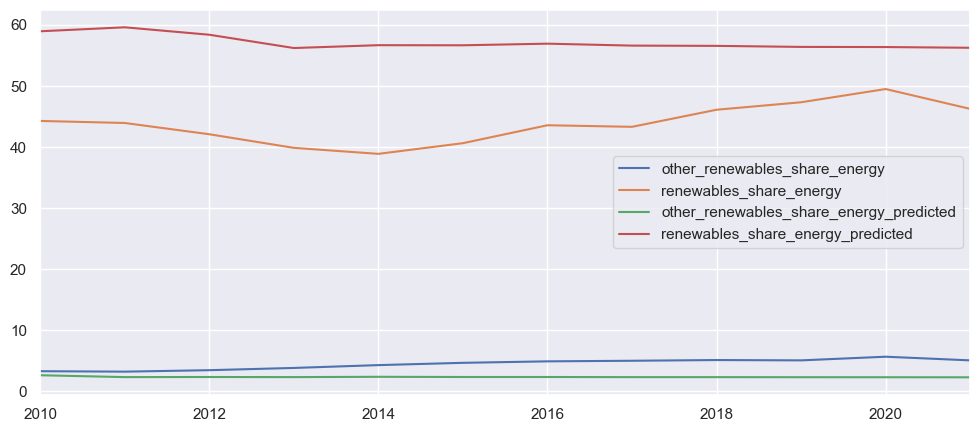

In [768]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_2_brazil,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [769]:
mean_absolute_percentage_error(y_true=test_var_2_brazil['renewables_share_energy'],
                   y_pred=predictions['renewables_share_energy_predicted'])

31.0698233095364

In [770]:
rmse_rshare=math.sqrt(mean_squared_error(predictions['renewables_share_energy_predicted'],test_var_2_brazil['renewables_share_energy']))
print('Mean value of renewable share is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_2_brazil['renewables_share_energy']),rmse_rshare))

Mean value of renewable share is : 43.7845. Root Mean Squared Error is :13.732519621994355


## forecasting future renewable share 

Out of all four models FB prophet is predicting better

In [775]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=21,freq='AS') #AS for annually
forecast = m.predict(future)

01:47:38 - cmdstanpy - INFO - Chain [1] start processing
01:47:38 - cmdstanpy - INFO - Chain [1] done processing


In [776]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
62,2027-01-01,21.063856,40.896391,48.153162,19.076218,22.920463,23.414165,23.414165,23.414165,23.414165,23.414165,23.414165,0.0,0.0,0.0,44.478021
63,2028-01-01,21.092079,41.024588,48.218485,18.927577,23.120011,23.389465,23.389465,23.389465,23.389465,23.389465,23.389465,0.0,0.0,0.0,44.481544
64,2029-01-01,21.120380,40.754136,48.216071,18.844395,23.339743,23.383520,23.383520,23.383520,23.383520,23.383520,23.383520,0.0,0.0,0.0,44.503900
65,2030-01-01,21.148603,41.086175,48.382993,18.733075,23.537487,23.412169,23.412169,23.412169,23.412169,23.412169,23.412169,0.0,0.0,0.0,44.560772
66,2031-01-01,21.176827,40.737655,48.485833,18.597058,23.757649,23.414165,23.414165,23.414165,23.414165,23.414165,23.414165,0.0,0.0,0.0,44.590992


In [777]:
plot_plotly(m,forecast)


## 3. Predictions for total energy 

In [778]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_3_brazil=df_world_var_3[df_world_var_3['country'].isin(['Brazil'])]
df_var_3_brazil

,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
2807,Brazil,1900,BRA,NaN,NaN,NaN,NaN
2808,Brazil,1901,BRA,NaN,NaN,NaN,NaN
2809,Brazil,1902,BRA,NaN,NaN,NaN,NaN
2810,Brazil,1903,BRA,NaN,NaN,NaN,NaN
2811,Brazil,1904,BRA,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
2924,Brazil,2017,BRA,3403.931,1473.244,40.194,1890.492
2925,Brazil,2018,BRA,3417.385,1574.748,39.793,1802.844
2926,Brazil,2019,BRA,3487.616,1649.812,40.797,1797.008
2927,Brazil,2020,BRA,3333.586,1649.188,35.415,1648.983


In [779]:
#dropping the null values corresponding to initial years of null data
df_var_3_brazil.dropna(inplace=True)
df_var_3_brazil.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\448126931.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
2924,Brazil,2017,BRA,3403.931,1473.244,40.194,1890.492
2925,Brazil,2018,BRA,3417.385,1574.748,39.793,1802.844
2926,Brazil,2019,BRA,3487.616,1649.812,40.797,1797.008
2927,Brazil,2020,BRA,3333.586,1649.188,35.415,1648.983
2928,Brazil,2021,BRA,3490.447,1613.276,36.923,1840.249


In [780]:
#Converting them into date time format with years format
df_var_3_brazil.year=pd.to_datetime(df_var_3_brazil.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1524984213.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [781]:
#Setting the year as index
df_var_3_brazil.set_index("year",inplace=True)
df_var_3_brazil.tail()

,country,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
year,,,,,,
2017-01-01,Brazil,BRA,3403.931,1473.244,40.194,1890.492
2018-01-01,Brazil,BRA,3417.385,1574.748,39.793,1802.844
2019-01-01,Brazil,BRA,3487.616,1649.812,40.797,1797.008
2020-01-01,Brazil,BRA,3333.586,1649.188,35.415,1648.983
2021-01-01,Brazil,BRA,3490.447,1613.276,36.923,1840.249


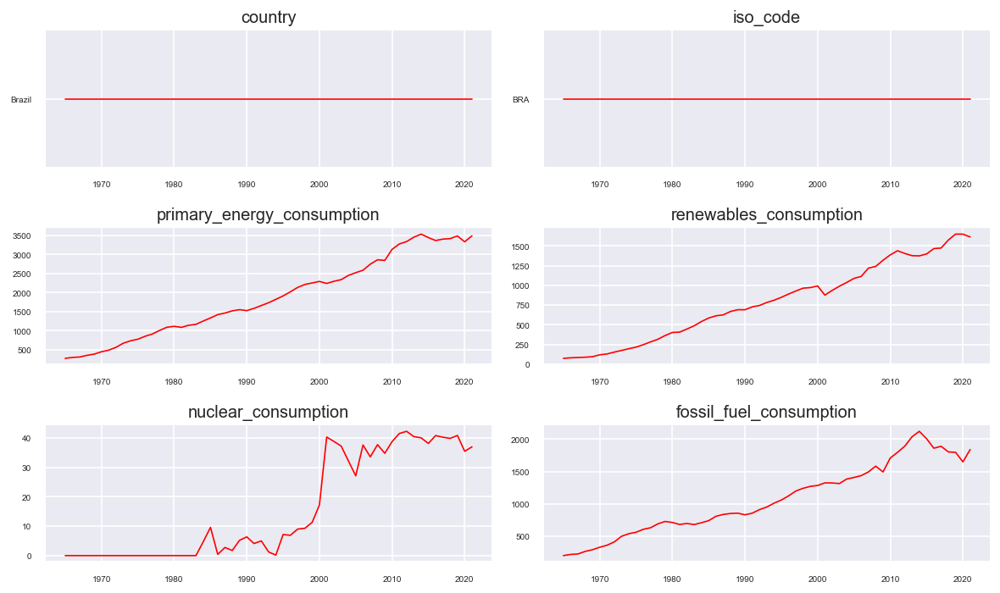

In [782]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=3, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_3_brazil[df_var_3_brazil.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_3_brazil.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

primary energy and fossil fuel consumption graphs are looking a like

In [784]:
#Let us check which time series is causing the other using granger casuality tests
print('primary_energy_consumption causes fossil_fuel_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_3_brazil[['fossil_fuel_consumption', 'primary_energy_consumption']], 8)
print('\n fossil_fuel_consumption causes primary_energy_consumption?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_3_brazil[['primary_energy_consumption', 'fossil_fuel_consumption']], 8)

primary_energy_consumption causes fossil_fuel_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=5.8788  , p=0.0188  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=6.2115  , p=0.0127  , df=1
likelihood ratio test: chi2=5.8905  , p=0.0152  , df=1
parameter F test:         F=5.8788  , p=0.0188  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=3.8549  , p=0.0277  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=8.4807  , p=0.0144  , df=2
likelihood ratio test: chi2=7.8872  , p=0.0194  , df=2
parameter F test:         F=3.8549  , p=0.0277  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=4.0284  , p=0.0125  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=13.8851 , p=0.0031  , df=3
likelihood ratio test: chi2=12.3570 , p=0.0063  , df=3
parameter F test:         F=4.0284  , p=0.0125  , df_denom=47, df_num=3

Granger Causality
nu

In [785]:
print('\n So Finally primary_energy_consumption causes fossil_fuel_consumption\n')
#Taking two of them into separate dataframe before fitting into model
df_var_3_brazil=df_var_3_brazil[['fossil_fuel_consumption', 'primary_energy_consumption']]
print(df_var_3_brazil.shape)


 So Finally primary_energy_consumption causes fossil_fuel_consumption

(57, 2)


In [786]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_3_brazil=df_var_3_brazil[:-12]
test_var_3_brazil=df_var_3_brazil[-12:]

In [787]:
#Taking the training data for modelling
model = VAR(train_var_3_brazil)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [788]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        20.26       20.35   6.285e+08       20.29
1        14.06      14.33*  1.276e+06*      14.15*
2        14.20       14.64   1.471e+06       14.35
3        14.37       15.00   1.766e+06       14.59
4        14.50       15.30   2.028e+06       14.77
5        14.50       15.48   2.075e+06       14.84
6        14.53       15.69   2.212e+06       14.93
7        14.51       15.84   2.254e+06       14.97
8        14.03       15.54   1.487e+06       14.55
9       13.90*       15.59   1.419e+06       14.49
10       14.02       15.88   1.778e+06       14.66
--------------------------------------------------


Order '1' is confirmed

In [789]:
var_model = VARMAX(train_var_3_brazil, order=(1,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\varmax.py:374: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



                                               Statespace Model Results                                              
Dep. Variable:     ['fossil_fuel_consumption', 'primary_energy_consumption']   No. Observations:                   45
Model:                                                                VAR(1)   Log Likelihood                -624.800
                                                                 + intercept   AIC                           1267.601
Date:                                                       Fri, 28 Jul 2023   BIC                           1283.861
Time:                                                               02:01:01   HQIC                          1273.662
Sample:                                                           01-01-1965                                         
                                                                - 01-01-2009                                         
Covariance Type:                                        

In [790]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [791]:
#Naming the columns of predicted results with suitable names
predictions.columns=['fossil_fuel_consumption_predicted','primary_energy_consumption_predicted']
predictions

,fossil_fuel_consumption_predicted,primary_energy_consumption_predicted
2010-01-01,1678.533118,3155.018747
2011-01-01,1676.920319,3152.057680
2012-01-01,1676.308984,3150.769622
2013-01-01,1675.692826,3149.473740
2014-01-01,1675.077227,3148.179020
2015-01-01,1674.462158,3146.885414
2016-01-01,1673.847618,3145.592920
2017-01-01,1673.233606,3144.301539
2018-01-01,1672.620123,3143.011268
2019-01-01,1672.007167,3141.722107


<Axes: >

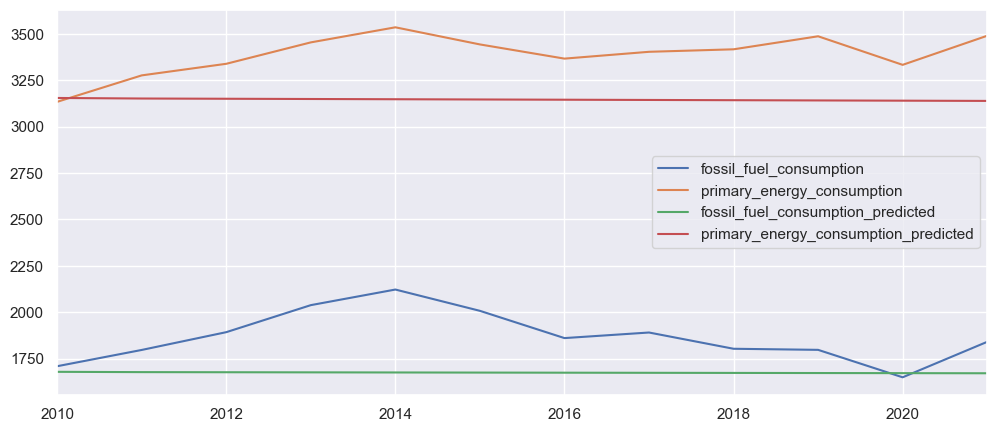

In [792]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_3_brazil,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [793]:
mean_absolute_percentage_error(y_true=test_var_3_brazil['primary_energy_consumption'],
                   y_pred=predictions['primary_energy_consumption_predicted'])

7.212514519543579

In [794]:
rmse_tenergy=math.sqrt(mean_squared_error(predictions['primary_energy_consumption_predicted'],test_var_3_brazil['primary_energy_consumption']))
print('Mean value of total energy is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_3_brazil['primary_energy_consumption']),rmse_tenergy))

Mean value of total energy is : 3390.409416666667. Root Mean Squared Error is :266.98212816061965


## Forecasting Total energy of China 

Out of all the four models fb prophet is forecasting better.

In [796]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=21,freq='AS') #AS for annually
forecast = m.predict(future)

02:07:43 - cmdstanpy - INFO - Chain [1] start processing
02:07:44 - cmdstanpy - INFO - Chain [1] done processing


In [797]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
61,2026-01-01,4087.459307,3849.745038,3989.059955,4069.748116,4105.817716,-171.522988,-171.522988,-171.522988,-171.522988,-171.522988,-171.522988,0.0,0.0,0.0,3915.936319
62,2027-01-01,4152.064117,3909.787556,4055.158620,4131.874746,4171.948068,-168.320093,-168.320093,-168.320093,-168.320093,-168.320093,-168.320093,0.0,0.0,0.0,3983.744023
63,2028-01-01,4216.668926,3984.593944,4133.774742,4195.221435,4237.588034,-157.264484,-157.264484,-157.264484,-157.264484,-157.264484,-157.264484,0.0,0.0,0.0,4059.404442
64,2029-01-01,4281.450735,4043.464779,4184.125999,4257.604397,4304.108389,-166.873854,-166.873854,-166.873854,-166.873854,-166.873854,-166.873854,0.0,0.0,0.0,4114.576881
65,2030-01-01,4346.055544,4098.724092,4244.926822,4320.309400,4370.253883,-171.522988,-171.522988,-171.522988,-171.522988,-171.522988,-171.522988,0.0,0.0,0.0,4174.532555


In [798]:
plot_plotly(m,forecast)


# 5.Time Series analysis and Forecasting for "India"

# Data Pre-processing

In [799]:
#Taking the India country data only for further analysis
df_india=df_world_renw_1[df_world_renw['country'].isin(['India'])]
df_india

,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
9165,India,1900,IND,NaN,NaN,NaN
9166,India,1901,IND,NaN,NaN,NaN
9167,India,1902,IND,NaN,NaN,NaN
9168,India,1903,IND,NaN,NaN,NaN
9169,India,1904,IND,NaN,NaN,NaN
...,...,...,...,...,...,...
9282,India,2017,IND,653.612,7.512,8701.049
9283,India,2018,IND,732.754,7.913,9260.351
9284,India,2019,IND,839.442,8.850,9485.631
9285,India,2020,IND,870.051,9.730,8941.913


In [800]:
#Checking whether there are any null values in dataset
df_india.isnull().sum()

country                        0
year                           0
iso_code                       0
renewables_consumption        65
renewables_share_energy       65
primary_energy_consumption    65
dtype: int64

In [801]:
df_india.dropna(inplace=True)
df_india.head()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\4200642747.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
9230,India,1965,IND,56.676,9.149,619.451
9231,India,1966,IND,59.186,9.271,638.414
9232,India,1967,IND,66.229,10.059,658.433
9233,India,1968,IND,76.435,10.858,703.985
9234,India,1969,IND,84.864,10.874,780.436


In [802]:
df_india.year=pd.to_datetime(df_india.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\102875000.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [804]:
df_india_no_index=df_india[['year','renewables_consumption']]
df_india_no_index.head()

,year,renewables_consumption
9230,1965-01-01,56.676
9231,1966-01-01,59.186
9232,1967-01-01,66.229
9233,1968-01-01,76.435
9234,1969-01-01,84.864


In [805]:
df_india_No_index_rshare=df_india[['year','renewables_share_energy']]
df_india_No_index_rshare.head()

,year,renewables_share_energy
9230,1965-01-01,9.149
9231,1966-01-01,9.271
9232,1967-01-01,10.059
9233,1968-01-01,10.858
9234,1969-01-01,10.874


In [806]:
df_india_No_index_tenergy=df_india[['year','primary_energy_consumption']]
df_india_No_index_tenergy.head()

,year,primary_energy_consumption
9230,1965-01-01,619.451
9231,1966-01-01,638.414
9232,1967-01-01,658.433
9233,1968-01-01,703.985
9234,1969-01-01,780.436


In [807]:
df_india.set_index("year",inplace=True)
df_india.head()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption
year,,,,,
1965-01-01,India,IND,56.676,9.149,619.451
1966-01-01,India,IND,59.186,9.271,638.414
1967-01-01,India,IND,66.229,10.059,658.433
1968-01-01,India,IND,76.435,10.858,703.985
1969-01-01,India,IND,84.864,10.874,780.436


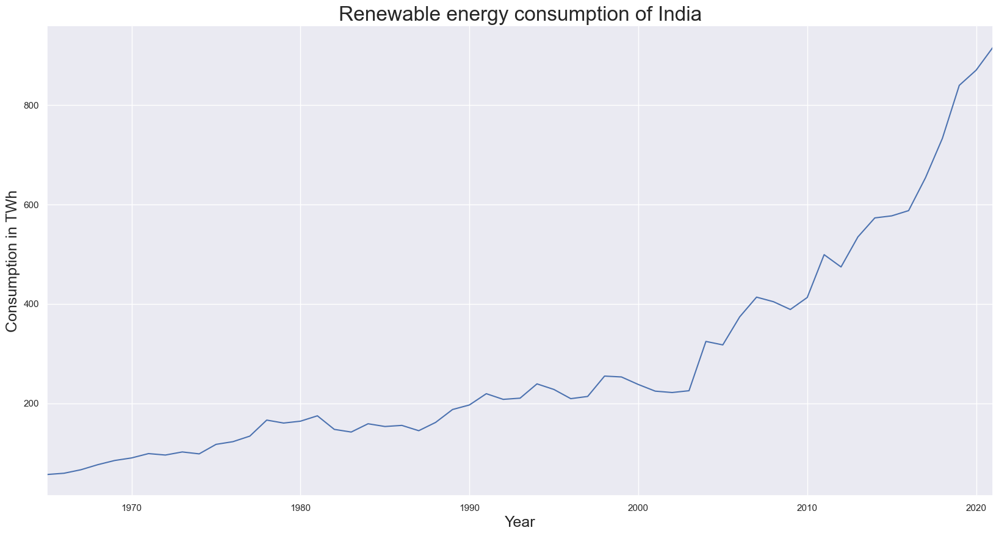

In [808]:
df_india.renewables_consumption.plot(figsize=(20,10))
plt.title("Renewable energy consumption of India",size=24)
plt.ylabel("Consumption in TWh",size=18)
plt.xlabel("Year",size=18)
plt.show()

# Seasonality Check

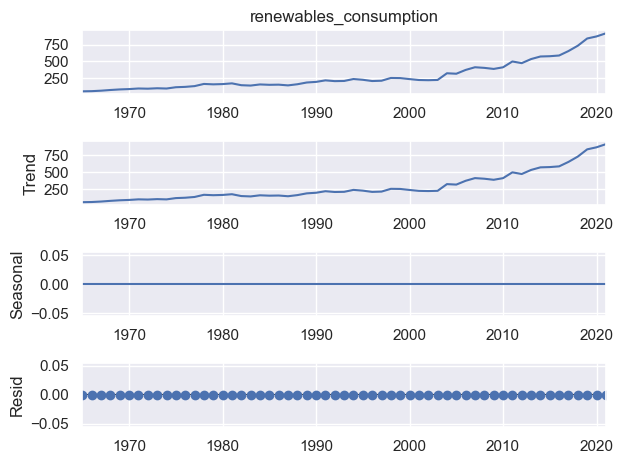

In [809]:
seas_decompose_additive_india= seasonal_decompose(df_india.renewables_consumption,model="additive")
seas_decompose_additive_india.plot()
plt.show()

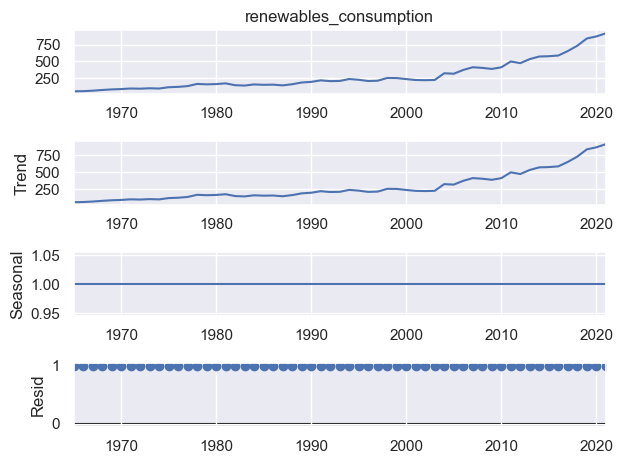

In [810]:
seas_decompose_multiplicative_india= seasonal_decompose(df_india.renewables_consumption,model="multiplicative",period=1)
seas_decompose_multiplicative_india.plot()
plt.show()

# Stationarity Check

In [811]:
result = adfuller(df_india.renewables_consumption)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - India Time Series is Stationary")
else:
    print ("Failed to Reject Ho - India Time Series is Non-Stationary")

ADF Statistic: 3.888264
p-value: 1.000000
Critical Values:
	1%: -3.553
	5%: -2.915
	10%: -2.595
Failed to Reject Ho - India Time Series is Non-Stationary


In [812]:
#Lets Fit ARIMA Model As it is a Non-stationary Data
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_india=ARIMA(df_india.renewables_consumption[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_india=model_AR_I_MA_111_india.fit()
#print the summary of model results
results_AR_I_MA_111_india.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                  
==================================================================================
Dep. Variable:     renewables_consumption   No. Observations:                   56
Model:                     ARIMA(1, 1, 1)   Log Likelihood                -262.745
Date:                    Fri, 28 Jul 2023   AIC                            531.489
Time:                            02:13:29   BIC                            537.511
Sample:                        01-01-1966   HQIC                           533.818
                             - 01-01-2021                                         
Covariance Type:                      opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9869      0.064     15.407      0.000       0.861       1.112
ma.L1         -0.8432      0.151     -5.601      0.000      -1.138      -0.548
sigma2       806.3360    123.141      6.548      0.000     564.983    1047.689
===================================================================================
Ljung-Box (L1) (Q):                   0.29   Jarque-Bera (JB):                16.39
Prob(Q):                              0.59   Prob(JB):                         0.00
Heteroskedasticity (H):              12.08   Skew:                             1.10
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.53
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3681670356.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



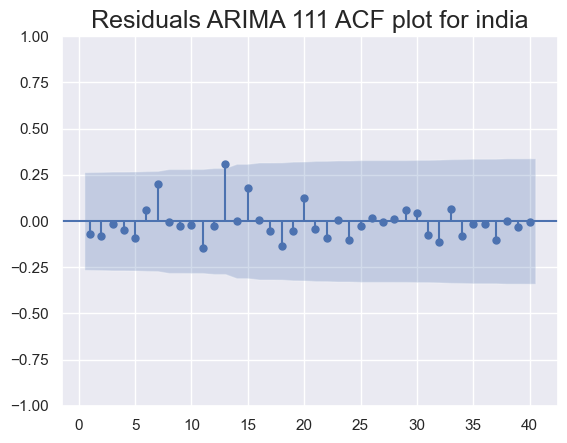

In [813]:
#All coefiicients are significant,Lets see Residuals plot to check whether any higher lags are significant
df_india['residuals_ARIMA_111_india']=results_AR_I_MA_111_india.resid
sgt.plot_acf(df_india.residuals_ARIMA_111_india[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for india",size=18)
plt.show()

No higher lags are significant,So no need to go for higher order model.

In [814]:
#We have decided No higher lags are significant ,before conclusing lets check whether it is stationary or not
df_india['india_ren_consumption']=df_india.renewables_consumption.diff(1)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\375844733.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [815]:
#To comapre ARIMA 111 results with manually integrated time series ,performing arma 11 for integrated series
#As Arima(1,0,1) should equal to Arma(1,1) of manully integrated series
#All of this are doing to check after the first integration whether the series is statioanry or not
model_AR_I_MA_101_india=ARIMA(df_india.india_ren_consumption[2:],order=(1,0,1))
results_AR_I_MA_101_india=model_AR_I_MA_101_india.fit()
results_AR_I_MA_101_india.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                 SARIMAX Results                                 
=================================================================================
Dep. Variable:     india_ren_consumption   No. Observations:                   55
Model:                    ARIMA(1, 0, 1)   Log Likelihood                -261.966
Date:                   Fri, 28 Jul 2023   AIC                            531.933
Time:                           02:13:32   BIC                            539.962
Sample:                       01-01-1967   HQIC                           535.038
                            - 01-01-2021                                         
Covariance Type:                     opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         19.6891     32.674      0.603      0.547     -44.350      83.728
ar.L1          0.9549      0.167      5.709      0.000       0.627       1.283
ma.L1         -0.8265      0.258     -3.201      0.001      -1.333      -0.320
sigma2       796.1493    152.871      5.208      0.000     496.528    1095.770
===================================================================================
Ljung-Box (L1) (Q):                   0.06   Jarque-Bera (JB):                18.16
Prob(Q):                              0.80   Prob(JB):                         0.00
Heteroskedasticity (H):               9.53   Skew:                             1.19
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.50
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [816]:
result = adfuller(df_india.india_ren_consumption[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -5.972933
p-value: 0.000000
Critical Values:
	1%: -3.555
	5%: -2.916
	10%: -2.596
Reject Ho - Time Series is Stationary


## Predicting Using ARIMA(1,1,1) 

In [817]:
size_india=int(len(df_india)*0.8)
size_india

45

In [818]:
df_india_train=df_india.iloc[:size_india]
df_india_test=df_india.iloc[size_india:]

In [819]:
#let us check the ending year of training dataset ,so that starting date can be put as next year
df_india_train.tail()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption,residuals_ARIMA_111_india,india_ren_consumption
year,,,,,,,
2005-01-01,India,IND,317.387,6.894,4603.610,-21.829013,-6.980
2006-01-01,India,IND,373.731,7.706,4849.720,44.825404,56.344
2007-01-01,India,IND,413.451,7.856,5263.111,21.912041,39.720
2008-01-01,India,IND,404.269,7.257,5570.697,-29.905093,-9.182
2009-01-01,India,IND,388.624,6.474,6003.236,-31.800553,-15.645


In [820]:
df_india_test.tail()

,country,iso_code,renewables_consumption,renewables_share_energy,primary_energy_consumption,residuals_ARIMA_111_india,india_ren_consumption
year,,,,,,,
2017-01-01,India,IND,653.612,7.512,8701.049,46.837095,66.135
2018-01-01,India,IND,732.754,7.913,9260.351,53.367493,79.142
2019-01-01,India,IND,839.442,8.850,9485.631,73.583398,106.688
2020-01-01,India,IND,870.051,9.730,8941.913,-12.634211,30.609
2021-01-01,India,IND,916.301,9.311,9841.214,5.387630,46.250


C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



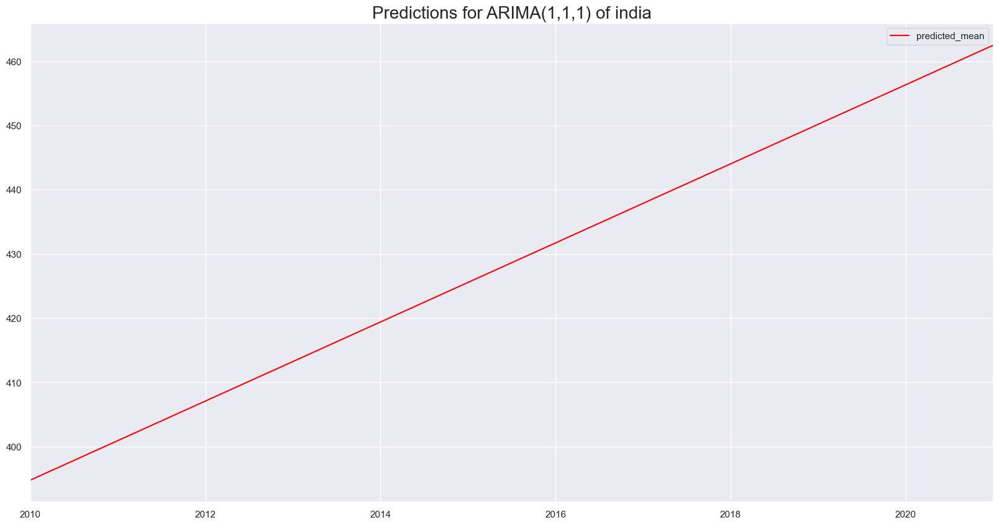

In [821]:
#Let us fit the model for only training dataset
model_Arima_111_india=ARIMA(df_india_train.renewables_consumption[1:],order=(1,1,1))
model_Arima_111_india=model_Arima_111_india.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_india_Arima_111_predict=model_Arima_111_india.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_india_Arima_111_predict[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for ARIMA(1,1,1) of india",size=20)
plt.show()

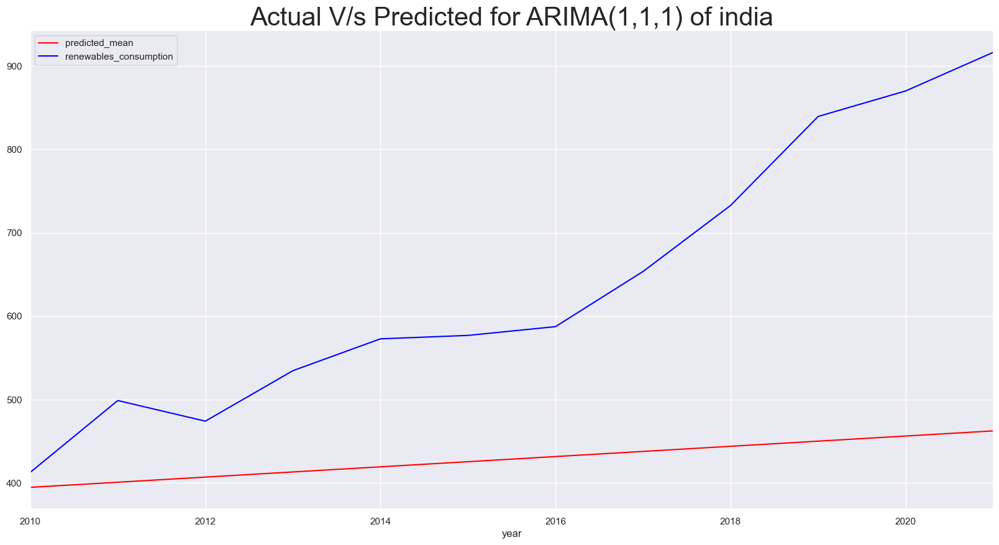

In [822]:
#Let us compare the test data and predicted values
df_india_Arima_111_predict.plot(figsize=(20,10),color="red",legend=True)
df_india_test.renewables_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for ARIMA(1,1,1) of india",size=30)
plt.show()

In [823]:
rmse_111_india=sqrt(mean_squared_error(df_india_Arima_111_predict,df_india_test['renewables_consumption']))
mse_111_india=mean_squared_error(df_india_Arima_111_predict,df_india_test['renewables_consumption'])
mae_india = np.mean(np.abs(df_india_Arima_111_predict  - df_india_test['renewables_consumption']))
print("Root Mean Squared Error for ARIMA(1,1,1): ",rmse_111_india)
print("Mean Squared Error for ARIMA(1,1,1): ",mse_111_india)
print("Mean absolute Error for ARIMA(1,1,1): ",mae_india)

Root Mean Squared Error for ARIMA(1,1,1):  251.4002625886215
Mean Squared Error for ARIMA(1,1,1):  63202.09202962785
Mean absolute Error for ARIMA(1,1,1):  210.5213983771098


In [824]:
mean_absolute_percentage_error(y_true=df_india_test['renewables_consumption'],
                   y_pred=df_india_Arima_111_predict)

29.68671267468384

## 2.Predictions for Renewable share

In [825]:
df_india_rshare=df_india[['renewables_share_energy']]
df_india_rshare.head()

,renewables_share_energy
year,
1965-01-01,9.149
1966-01-01,9.271
1967-01-01,10.059
1968-01-01,10.858
1969-01-01,10.874


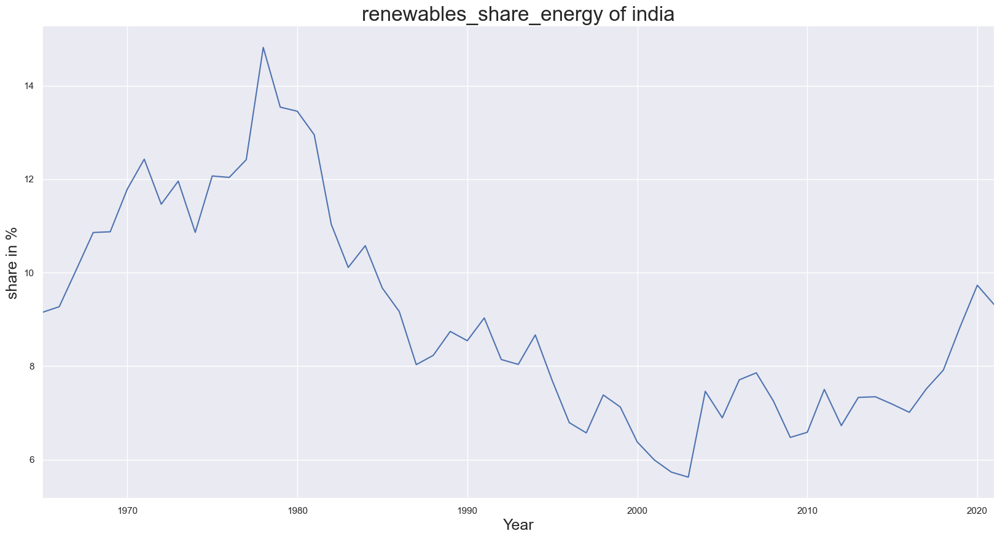

In [826]:
df_india.renewables_share_energy.plot(figsize=(20,10))
plt.title("renewables_share_energy of india",size=24)
plt.ylabel("share in %",size=18)
plt.xlabel("Year",size=18)
plt.show()

## Seasonality Checking

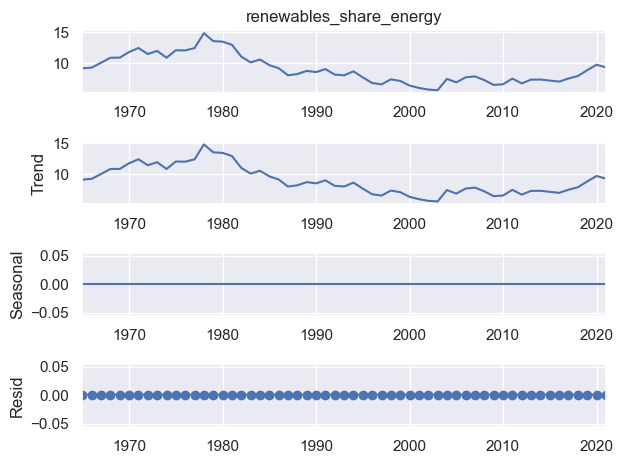

In [827]:
seas_decompose_additive= seasonal_decompose(df_india.renewables_share_energy,model="additive")
seas_decompose_additive.plot()
plt.show()

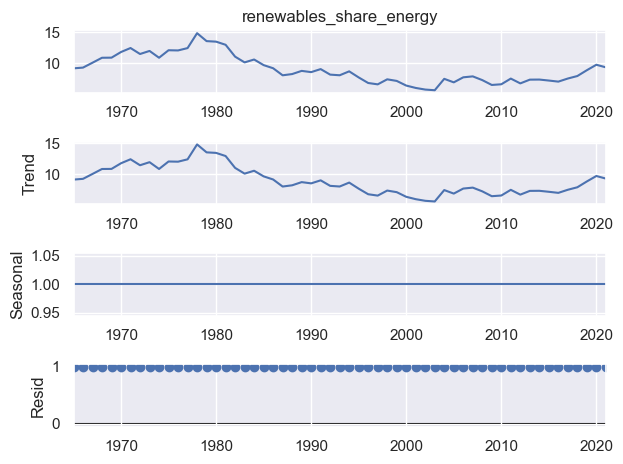

In [828]:
seas_decompose_multiplicative= seasonal_decompose(df_india.renewables_share_energy,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

From both the methods it is clear that,there is no proof of seasonality

In [829]:
result = adfuller(df_india.renewables_share_energy)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - India Time Series is Stationary")
else:
    print ("Failed to Reject Ho - India Time Series is Non-Stationary")

ADF Statistic: -1.323424
p-value: 0.618389
Critical Values:
	1%: -3.553
	5%: -2.915
	10%: -2.595
Failed to Reject Ho - India Time Series is Non-Stationary


## ARIMA 

In [830]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_rshare=ARIMA(df_india.renewables_share_energy[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_rshare=model_AR_I_MA_111_rshare.fit()
#print the summary of model results
results_AR_I_MA_111_rshare.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                  SARIMAX Results                                  
===================================================================================
Dep. Variable:     renewables_share_energy   No. Observations:                   56
Model:                      ARIMA(1, 1, 1)   Log Likelihood                 -66.111
Date:                     Fri, 28 Jul 2023   AIC                            138.222
Time:                             03:21:03   BIC                            144.244
Sample:                         01-01-1966   HQIC                           140.551
                              - 01-01-2021                                         
Covariance Type:                       opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1748      2.681     -0.065      0.948      -5.429       5.079
ma.L1          0.1089      2.685      0.041      0.968      -5.155       5.372
sigma2         0.6480      0.117      5.553      0.000       0.419       0.877
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                 1.42
Prob(Q):                              0.98   Prob(JB):                         0.49
Heteroskedasticity (H):               0.50   Skew:                             0.34
Prob(H) (two-sided):                  0.15   Kurtosis:                         3.39
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\218753340.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



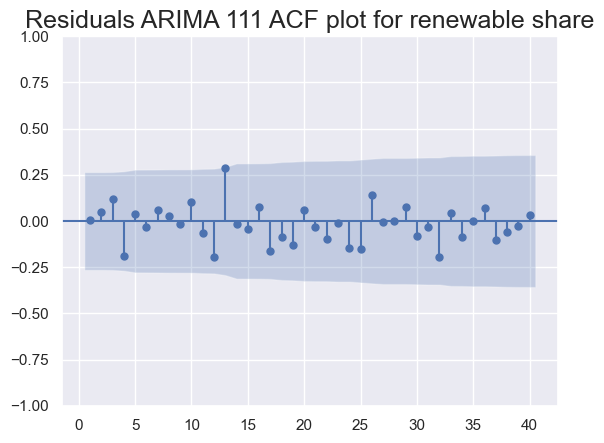

In [831]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_india['residuals_ARIMA_111_rshare']=results_AR_I_MA_111_rshare.resid
sgt.plot_acf(df_india.residuals_ARIMA_111_rshare[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for renewable share",size=18)
plt.show()

## Checking Stationarity

In [832]:
#We have decided No higher lags are significant ,before conclusing lets check whether it is stationary or not
df_india['india_renewables_share_energy']=df_india.renewables_share_energy.diff(1)

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3612022548.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [833]:
model_AR_I_MA_101_india=ARIMA(df_india.india_renewables_share_energy[2:],order=(1,0,1))
results_AR_I_MA_101_india=model_AR_I_MA_101_india.fit()
results_AR_I_MA_101_india.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                     
=========================================================================================
Dep. Variable:     india_renewables_share_energy   No. Observations:                   55
Model:                            ARIMA(1, 0, 1)   Log Likelihood                 -66.111
Date:                           Fri, 28 Jul 2023   AIC                            140.222
Time:                                   03:23:10   BIC                            148.251
Sample:                               01-01-1967   HQIC                           143.327
                                    - 01-01-2021                                         
Covariance Type:                             opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0005      0.105      0.005      0.996      -0.206       0.207
ar.L1         -0.1749      2.681     -0.065      0.948      -5.430       5.080
ma.L1          0.1090      2.686      0.041      0.968      -5.155       5.373
sigma2         0.6480      0.119      5.425      0.000       0.414       0.882
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                 1.42
Prob(Q):                              0.98   Prob(JB):                         0.49
Heteroskedasticity (H):               0.50   Skew:                             0.34
Prob(H) (two-sided):                  0.15   Kurtosis:                         3.39
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [834]:
result = adfuller(df_india.india_renewables_share_energy[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -7.725811
p-value: 0.000000
Critical Values:
	1%: -3.555
	5%: -2.916
	10%: -2.596
Reject Ho - Time Series is Stationary


So ARIMA(1,1,1) would be better model

## Predicting Using ARIMA (1,1,1) 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



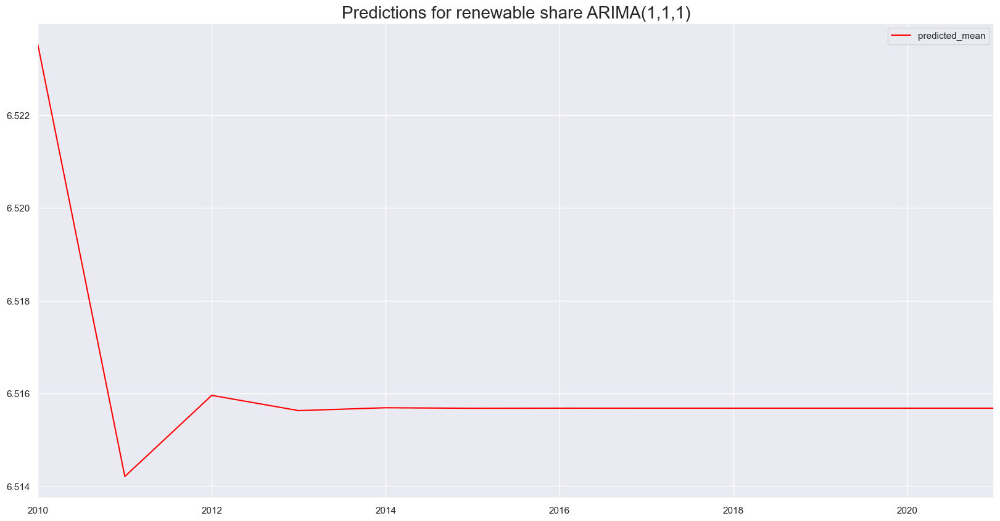

In [835]:
#Let us fit the model for only training dataset
model_Arima_111_rshare=ARIMA(df_india_train.renewables_share_energy[1:],order=(1,1,1))
model_Arima_111_rshare=model_Arima_111_rshare.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_india_Arima_111_predict_rshare=model_Arima_111_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_india_Arima_111_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for renewable share ARIMA(1,1,1)",size=20)
plt.show()

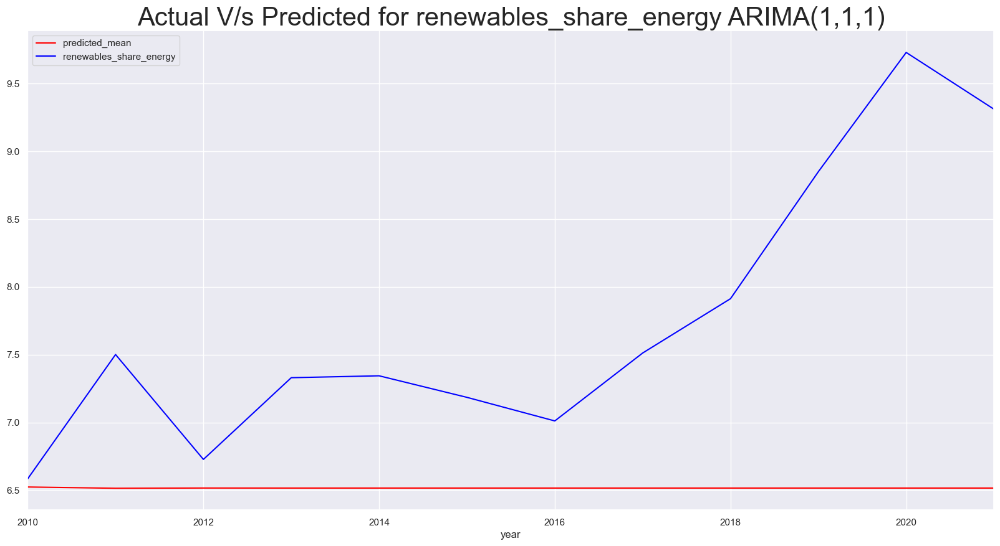

In [836]:
#Let us compare the test data and predicted values
df_india_Arima_111_predict_rshare.plot(figsize=(20,10),color="red",legend=True)
df_india_test.renewables_share_energy.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for renewables_share_energy ARIMA(1,1,1)",size=30)
plt.show()

In [837]:
rmse=sqrt(mean_squared_error(df_india_Arima_111_predict_rshare,df_india_test['renewables_share_energy']))
print(rmse)

1.5706803557994409


In [838]:
mean_absolute_percentage_error(y_true=df_india_test['renewables_share_energy'],
                   y_pred=df_india_Arima_111_predict_rshare)

14.694624829901192

## 3.Predictions for Total energy

In [839]:
df_india_tenergy=df_india[['primary_energy_consumption']]
df_india_tenergy.head()

,primary_energy_consumption
year,
1965-01-01,619.451
1966-01-01,638.414
1967-01-01,658.433
1968-01-01,703.985
1969-01-01,780.436


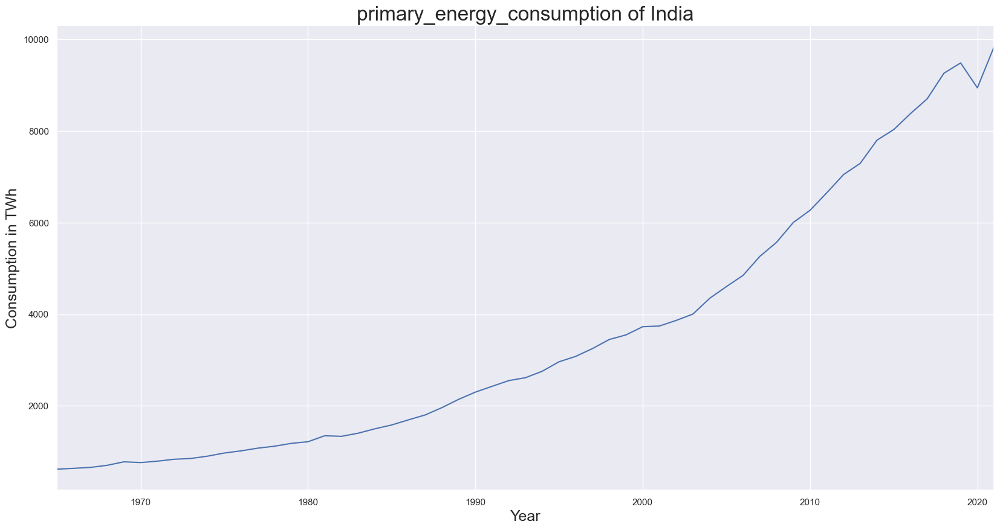

In [840]:
df_india.primary_energy_consumption.plot(figsize=(20,10))
plt.title("primary_energy_consumption of India",size=24)
plt.ylabel("Consumption in TWh",size=18)
plt.xlabel("Year",size=18)
plt.show()

## Seasonality Checking

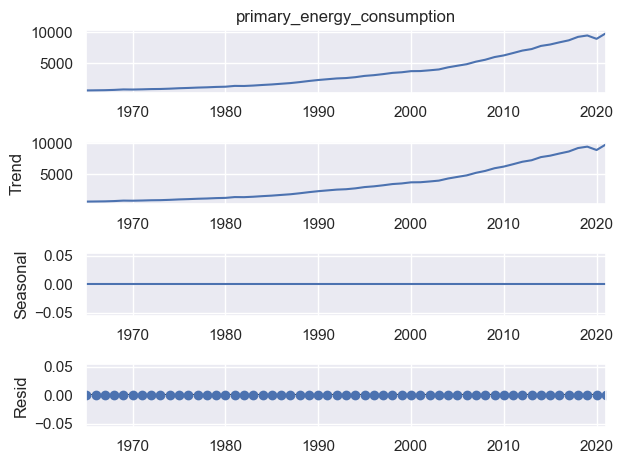

In [841]:
seas_decompose_additive= seasonal_decompose(df_india.primary_energy_consumption,model="additive")
seas_decompose_additive.plot()
plt.show()

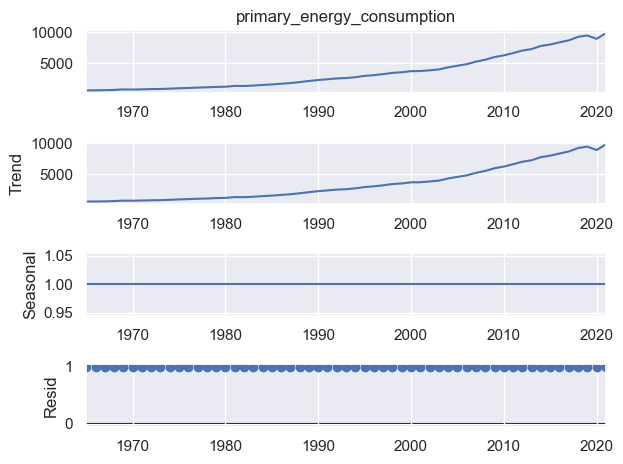

In [842]:
seas_decompose_multiplicative= seasonal_decompose(df_india.primary_energy_consumption,model="multiplicative",period=1)
seas_decompose_multiplicative.plot()
plt.show()

In [844]:
result = adfuller(df_india.primary_energy_consumption)
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - india Time Series is Stationary")
else:
    print ("Failed to Reject Ho - india Time Series is Non-Stationary")

ADF Statistic: 0.993502
p-value: 0.994197
Critical Values:
	1%: -3.575
	5%: -2.924
	10%: -2.600
Failed to Reject Ho - indiaTime Series is Non-Stationary


## ARIMA

In [845]:
#Let us model basic Arima (1,1,1) and interpret the results
model_AR_I_MA_111_tenergy=ARIMA(df_india.primary_energy_consumption[1:],order=(1,1,1))
#fit the model
results_AR_I_MA_111_tenergy=model_AR_I_MA_111_tenergy.fit()
#print the summary of model results
results_AR_I_MA_111_tenergy.summary()

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                   SARIMAX Results                                    
======================================================================================
Dep. Variable:     primary_energy_consumption   No. Observations:                   56
Model:                         ARIMA(1, 1, 1)   Log Likelihood                -363.072
Date:                        Fri, 28 Jul 2023   AIC                            732.143
Time:                                04:07:24   BIC                            738.165
Sample:                            01-01-1966   HQIC                           734.472
                                 - 01-01-2021                                         
Covariance Type:                          opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9930      0.013     73.963      0.000       0.967       1.019
ma.L1         -0.8555      0.095     -8.990      0.000      -1.042      -0.669
sigma2      3.075e+04   3666.498      8.388      0.000    2.36e+04    3.79e+04
===================================================================================
Ljung-Box (L1) (Q):                   5.40   Jarque-Bera (JB):               567.41
Prob(Q):                              0.02   Prob(JB):                         0.00
Heteroskedasticity (H):              67.58   Skew:                            -1.50
Prob(H) (two-sided):                  0.00   Kurtosis:                        18.45
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3836411828.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



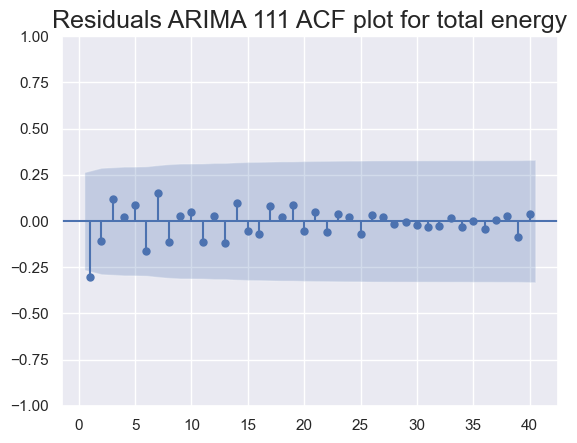

In [846]:
#The coefficents are significantlyty different from the zero,So it is best and can try higher lag models too.
#before that analysing the residual plot for ARIMA(1,1,1) makes analysis simpler
df_india['residuals_ARIMA_111_tenergy']=results_AR_I_MA_111_tenergy.resid
sgt.plot_acf(df_india.residuals_ARIMA_111_tenergy[2:],lags=40,zero=False)
plt.title("Residuals ARIMA 111 ACF plot for total energy",size=18)
plt.show()

## Checking Stationarity

In [847]:
df_india['india_primary_energy_consumption_1']=df_india.primary_energy_consumption.diff(1)
model_AR_I_MA_101_india=ARIMA(df_india.india_primary_energy_consumption_1[2:],order=(1,0,1))
results_AR_I_MA_101_india=model_AR_I_MA_101_india.fit()
results_AR_I_MA_101_india.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\594393130.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-

<class 'statsmodels.iolib.summary.Summary'>
"""
                                       SARIMAX Results                                        
==============================================================================================
Dep. Variable:     india_primary_energy_consumption_1   No. Observations:                   55
Model:                                 ARIMA(1, 0, 1)   Log Likelihood                -362.338
Date:                                Fri, 28 Jul 2023   AIC                            732.677
Time:                                        04:09:38   BIC                            740.706
Sample:                                    01-01-1967   HQIC                           735.782
                                         - 01-01-2021                                         
Covariance Type:                                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        167.4579    166.785      1.004      0.315    -159.434     494.350
ar.L1          0.9710      0.060     16.077      0.000       0.853       1.089
ma.L1         -0.8459      0.110     -7.707      0.000      -1.061      -0.631
sigma2      3.051e+04   4229.562      7.214      0.000    2.22e+04    3.88e+04
===================================================================================
Ljung-Box (L1) (Q):                   4.04   Jarque-Bera (JB):               396.15
Prob(Q):                              0.04   Prob(JB):                         0.00
Heteroskedasticity (H):              26.35   Skew:                            -1.00
Prob(H) (two-sided):                  0.00   Kurtosis:                        15.99
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [848]:
result = adfuller(df_india.india_primary_energy_consumption_1[1:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -1.545248
p-value: 0.511021
Critical Values:
	1%: -3.575
	5%: -2.924
	10%: -2.600
Failed to Reject Ho - Time Series is Non-Stationary


In [849]:
df_india['india_primary_energy_consumption_2']=df_india.primary_energy_consumption.diff(2)
model_AR_I_MA_101_india=ARIMA(df_india.india_primary_energy_consumption_2[2:],order=(1,0,1))
results_AR_I_MA_101_india=model_AR_I_MA_101_india.fit()
results_AR_I_MA_101_india.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1008692840.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                       SARIMAX Results                                        
==============================================================================================
Dep. Variable:     india_primary_energy_consumption_2   No. Observations:                   55
Model:                                 ARIMA(1, 0, 1)   Log Likelihood                -360.799
Date:                                Fri, 28 Jul 2023   AIC                            729.597
Time:                                        04:10:33   BIC                            737.626
Sample:                                    01-01-1967   HQIC                           732.702
                                         - 01-01-2021                                         
Covariance Type:                                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        277.0741    217.691      1.273      0.203    -149.592     703.740
ar.L1          0.9218      0.100      9.214      0.000       0.726       1.118
ma.L1         -0.4832      0.200     -2.411      0.016      -0.876      -0.090
sigma2      2.869e+04   4161.388      6.894      0.000    2.05e+04    3.68e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):              1322.60
Prob(Q):                              0.91   Prob(JB):                         0.00
Heteroskedasticity (H):              24.41   Skew:                            -3.92
Prob(H) (two-sided):                  0.00   Kurtosis:                        25.71
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [850]:
result = adfuller(df_india.india_primary_energy_consumption_2[2:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -2.268928
p-value: 0.182185
Critical Values:
	1%: -3.593
	5%: -2.932
	10%: -2.604
Failed to Reject Ho - Time Series is Non-Stationary


In [851]:
df_india['india_primary_energy_consumption_3']=df_india.primary_energy_consumption.diff(3)
model_AR_I_MA_101_india=ARIMA(df_india.india_primary_energy_consumption_3[2:],order=(1,0,1))
results_AR_I_MA_101_india=model_AR_I_MA_101_india.fit()
results_AR_I_MA_101_india.summary()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2581679361.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



<class 'statsmodels.iolib.summary.Summary'>
"""
                                       SARIMAX Results                                        
==============================================================================================
Dep. Variable:     india_primary_energy_consumption_3   No. Observations:                   55
Model:                                 ARIMA(1, 0, 1)   Log Likelihood                -349.492
Date:                                Fri, 28 Jul 2023   AIC                            706.983
Time:                                        04:11:29   BIC                            715.013
Sample:                                    01-01-1967   HQIC                           710.088
                                         - 01-01-2021                                         
Covariance Type:                                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        487.6900    234.688      2.078      0.038      27.711     947.669
ar.L1          0.9372      0.060     15.685      0.000       0.820       1.054
ma.L1         -0.2366      0.164     -1.445      0.148      -0.558       0.084
sigma2      2.374e+04   2958.814      8.025      0.000    1.79e+04    2.95e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):               523.60
Prob(Q):                              0.93   Prob(JB):                         0.00
Heteroskedasticity (H):              18.64   Skew:                            -2.59
Prob(H) (two-sided):                  0.00   Kurtosis:                        17.20
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [852]:
result = adfuller(df_india.india_primary_energy_consumption_3[3:])
print('ADF Statistic: %f' % result[0])
print('p-value: %f' % result[1])
print('Critical Values:')
for key, value in result[4].items():
    print('\t%s: %.3f' % (key, value))

if result[0] < result[4]["5%"]:
    print ("Reject Ho - Time Series is Stationary")
else:
    print ("Failed to Reject Ho - Time Series is Non-Stationary")

ADF Statistic: -1.075850
p-value: 0.724606
Critical Values:
	1%: -3.597
	5%: -2.933
	10%: -2.605
Failed to Reject Ho - Time Series is Non-Stationary


p-value is increasing and decreasing ,showing inherent non-stationarity

## Predicting Using ARIMA (1,1,1) 

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



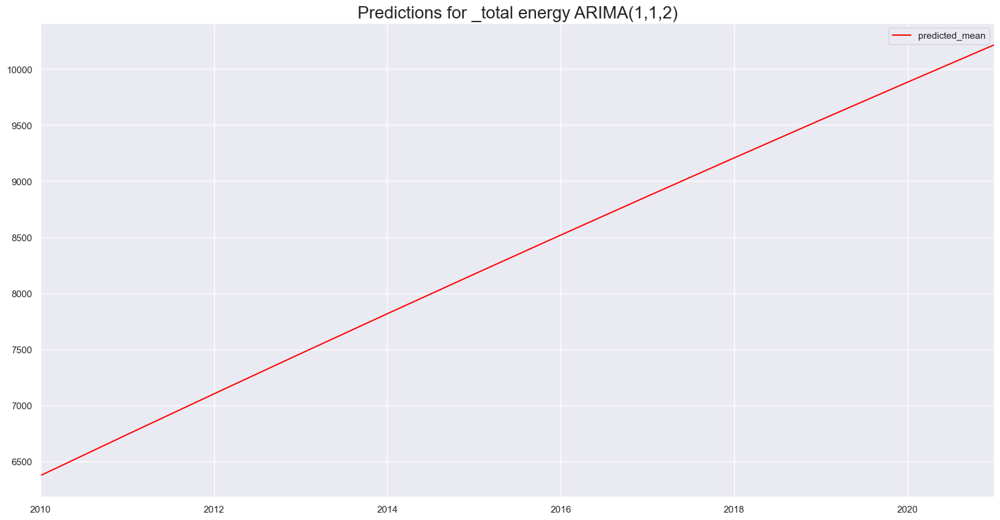

In [853]:
#Let us fit the model for only training dataset
model_Arima_111_tenergy=ARIMA(df_india_train.primary_energy_consumption[1:],order=(1,1,1))
model_Arima_111_tenergy=model_Arima_111_tenergy.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_india_Arima_111_predict_tenergy=model_Arima_111_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_india_Arima_111_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for _total energy ARIMA(1,1,2)",size=20)
plt.show()

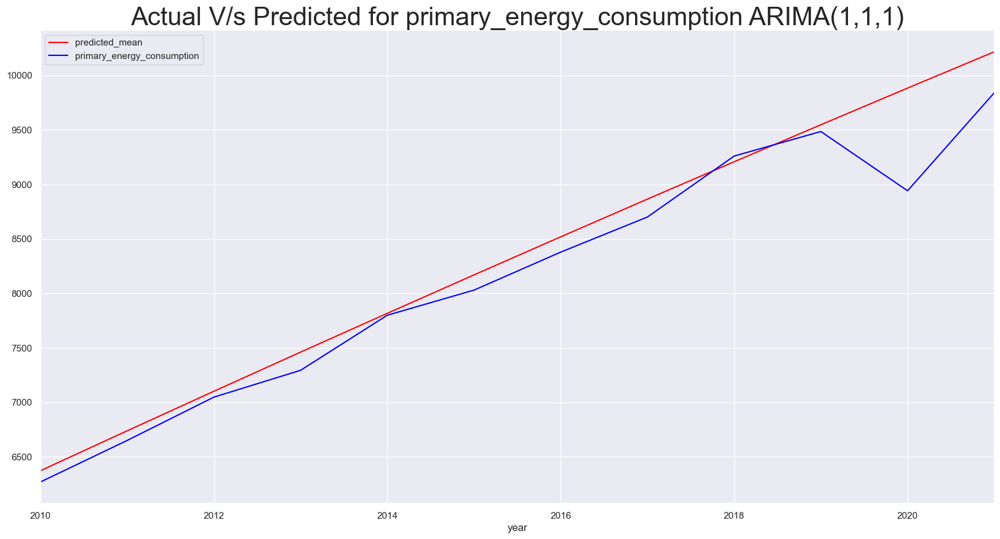

In [854]:
#Let us compare the test data and predicted values
df_india_Arima_111_predict_tenergy.plot(figsize=(20,10),color="red",legend=True)
df_india_test.primary_energy_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for primary_energy_consumption ARIMA(1,1,1)",size=30)
plt.show()

In [855]:
rmse=sqrt(mean_squared_error(df_india_Arima_111_predict_tenergy,df_india_test['primary_energy_consumption']))
print(rmse)

309.7677784960218


In [856]:
mean_absolute_percentage_error(y_true=df_india_test['primary_energy_consumption'],
                   y_pred=df_india_Arima_111_predict_tenergy)

2.2609626885916936

# Auto Arima For India

## 1. Predictions for renewable consumption 

In [857]:
model_auto_india=auto_arima(df_india.renewables_consumption[1:])
model_auto_india

ARIMA(order=(0, 2, 1), scoring_args={}, suppress_warnings=True)

In [858]:
model_auto_india.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 2, 1)   Log Likelihood                -256.874
Date:                Fri, 28 Jul 2023   AIC                            519.749
Time:                        14:03:04   BIC                            525.716
Sample:                    01-01-1966   HQIC                           522.050
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.8406      0.441      1.907      0.056      -0.023       1.704
ma.L1         -0.9150      0.074    -12.400      0.000      -1.060      -0.770
sigma2       766.9170    153.727      4.989      0.000     465.618    1068.217
===================================================================================
Ljung-Box (L1) (Q):                   0.10   Jarque-Bera (JB):                14.03
Prob(Q):                              0.75   Prob(JB):                         0.00
Heteroskedasticity (H):               8.38   Skew:                             1.06
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.32
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

So Auto ARIMA reccomends SARIMAX(0,2,1).yet there is no seasonality and exogenous variable here So it can be treated as ARIMA(0,2,1) and its prediction accuracy can be checked in the next step

## Predictions for Auto ARIMA

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



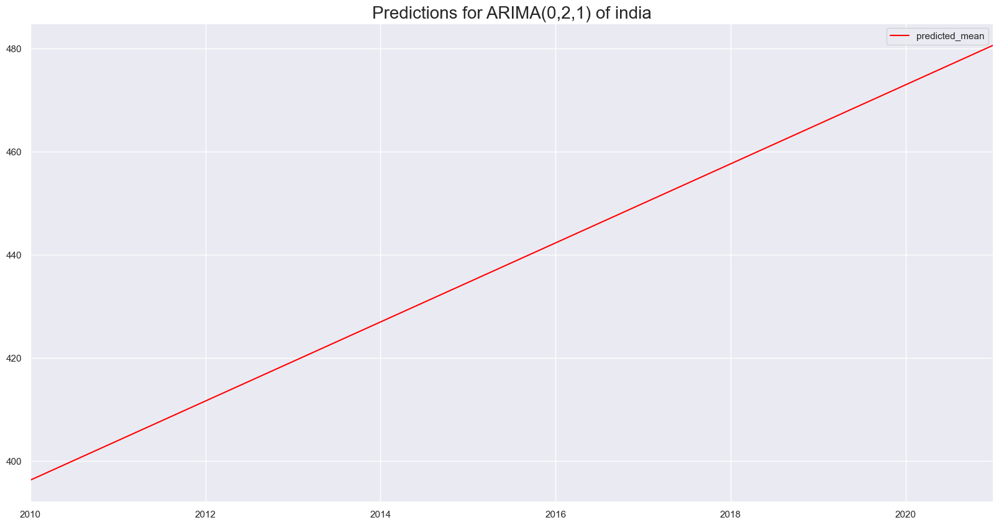

In [859]:
#Let us fit the model for only training dataset
model_Arima_021_india=ARIMA(df_india_train.renewables_consumption[1:],order=(0,2,1))
model_Arima_021_india=model_Arima_021_india.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_india_Arima_021_predict=model_Arima_021_india.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_india_Arima_021_predict[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for ARIMA(0,2,1) of india",size=20)
plt.show()

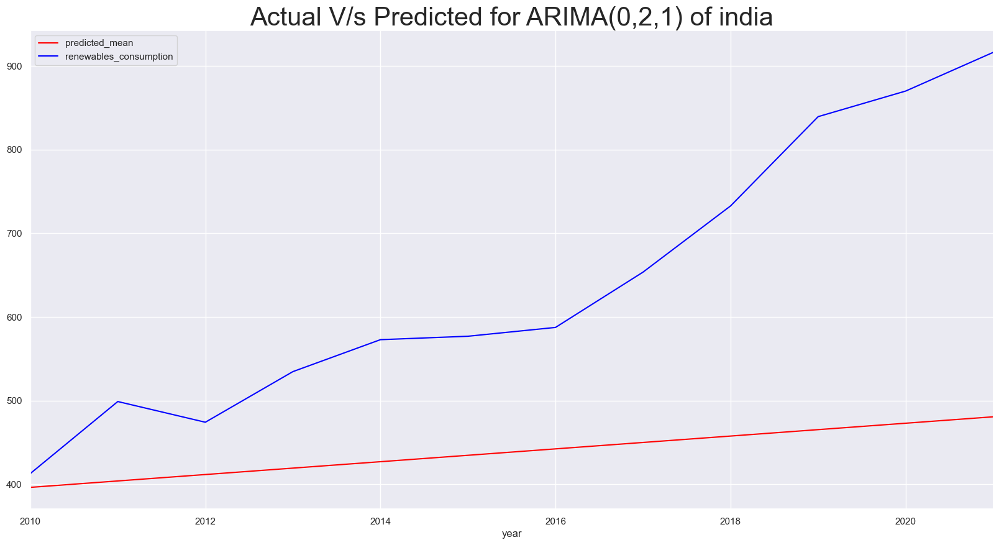

In [860]:
#Let us compare the test data and predicted values
df_india_Arima_021_predict.plot(figsize=(20,10),color="red",legend=True)
df_india_test.renewables_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for ARIMA(0,2,1) of india",size=30)
plt.show()

In [861]:
rmse_021_india=sqrt(mean_squared_error(df_india_Arima_021_predict,df_india_test['renewables_consumption']))
mse_021_india=mean_squared_error(df_india_Arima_021_predict,df_india_test['renewables_consumption'])
mae_india_021 = np.mean(np.abs(df_india_Arima_021_predict  - df_india_test['renewables_consumption']))
print("Root Mean Squared Error for ARIMA(0,2,1): ",rmse_021_india)
print("Mean Squared Error for ARIMA(0,2,1): ",mse_021_india)
print("Mean absolute Error for ARIMA(0,2,1): ",mae_india_021)

Root Mean Squared Error for ARIMA(0,2,1):  240.43584258210893
Mean Squared Error for ARIMA(0,2,1):  57809.39439816866
Mean absolute Error for ARIMA(0,2,1):  200.68881491103036


In [862]:
mean_absolute_percentage_error(y_true=df_india_test['renewables_consumption'],
                   y_pred=df_india_Arima_021_predict)

28.25650942540116

## 2. Predictions for renewable share 

In [863]:
model_auto_rshare=auto_arima(df_india.renewables_share_energy[1:])

In [864]:
model_auto_rshare

ARIMA(order=(0, 1, 0), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [865]:
model_auto_rshare.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(0, 1, 0)   Log Likelihood                 -66.234
Date:                Fri, 28 Jul 2023   AIC                            134.467
Time:                        14:04:25   BIC                            136.475
Sample:                    01-01-1966   HQIC                           135.244
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.6509      0.115      5.636      0.000       0.425       0.877
===================================================================================
Ljung-Box (L1) (Q):                   0.24   Jarque-Bera (JB):                 1.19
Prob(Q):                              0.63   Prob(JB):                         0.55
Heteroskedasticity (H):               0.50   Skew:                             0.33
Prob(H) (two-sided):                  0.15   Kurtosis:                         3.31
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



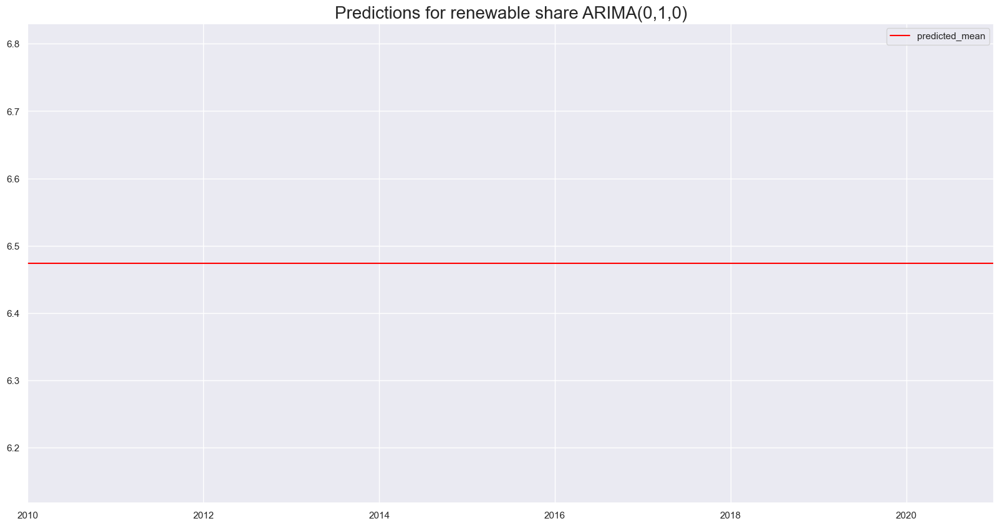

In [866]:
#Let us fit the model for only training dataset
model_Arima_010_rshare=ARIMA(df_india_train.renewables_share_energy[1:],order=(0,1,0))
model_Arima_010_rshare=model_Arima_010_rshare.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_india_Arima_010_predict_rshare=model_Arima_010_rshare.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_india_Arima_010_predict_rshare[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for renewable share ARIMA(0,1,0)",size=20)
plt.show()

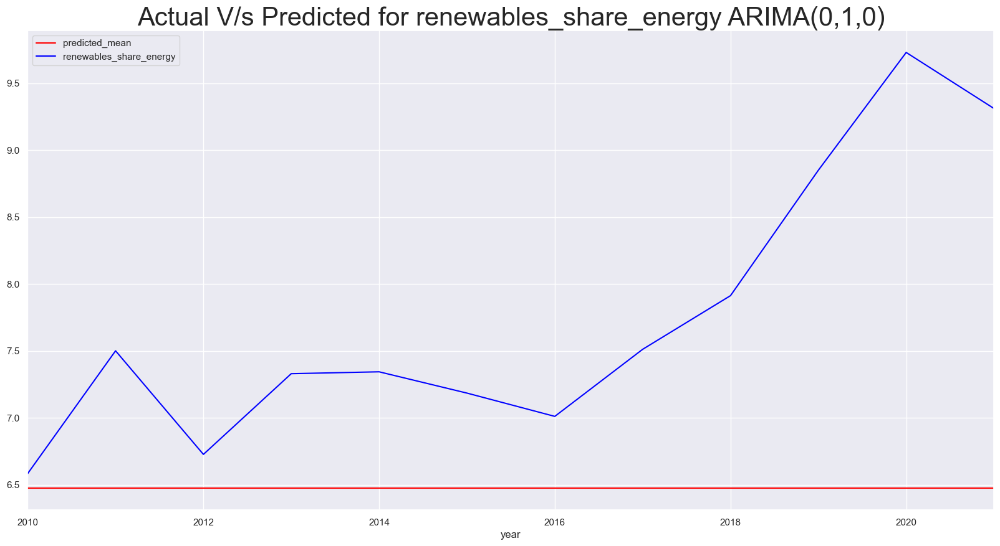

In [867]:
#Let us compare the test data and predicted values
df_india_Arima_010_predict_rshare.plot(figsize=(20,10),color="red",legend=True)
df_india_test.renewables_share_energy.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for renewables_share_energy ARIMA(0,1,0)",size=30)
plt.show()

In [868]:
rmse=sqrt(mean_squared_error(df_india_Arima_010_predict_rshare,df_india_test['renewables_share_energy']))
print(rmse)

1.6035899829237312


In [869]:
mean_absolute_percentage_error(y_true=df_india_test['renewables_share_energy'],
                   y_pred=df_india_Arima_010_predict_rshare)

15.248841910025899

## 3. Predictions for total energy

In [870]:
model_auto_tenergy=auto_arima(df_india.primary_energy_consumption[1:])

In [871]:
model_auto_tenergy

ARIMA(order=(2, 2, 1), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [872]:
model_auto_tenergy.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   56
Model:               SARIMAX(2, 2, 1)   Log Likelihood                -349.823
Date:                Fri, 28 Jul 2023   AIC                            707.646
Time:                        14:15:39   BIC                            715.602
Sample:                    01-01-1966   HQIC                           710.715
                         - 01-01-2021                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7191      0.232     -3.095      0.002      -1.174      -0.264
ar.L2         -0.6918      0.334     -2.069      0.039      -1.347      -0.036
ma.L1         -0.4857      0.254     -1.910      0.056      -0.984       0.013
sigma2      2.374e+04   4379.294      5.420      0.000    1.52e+04    3.23e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.14   Jarque-Bera (JB):               902.37
Prob(Q):                              0.71   Prob(JB):                         0.00
Heteroskedasticity (H):              55.13   Skew:                            -3.40
Prob(H) (two-sided):                  0.00   Kurtosis:                        21.84
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



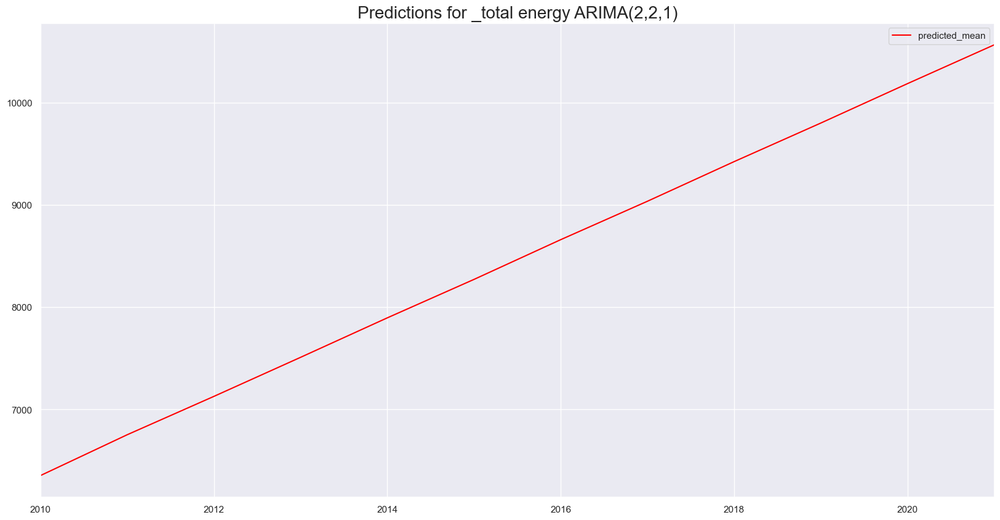

In [873]:
#Let us fit the model for only training dataset
model_Arima_221_tenergy=ARIMA(df_india_train.primary_energy_consumption[1:],order=(2,2,1))
model_Arima_221_tenergy=model_Arima_221_tenergy.fit()
#predicting the values for test dataset
start_date="2010-01-01"
end_date="2021-01-01"
df_india_Arima_221_predict_tenergy=model_Arima_221_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_india_Arima_221_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Predictions for _total energy ARIMA(2,2,1)",size=20)
plt.show()

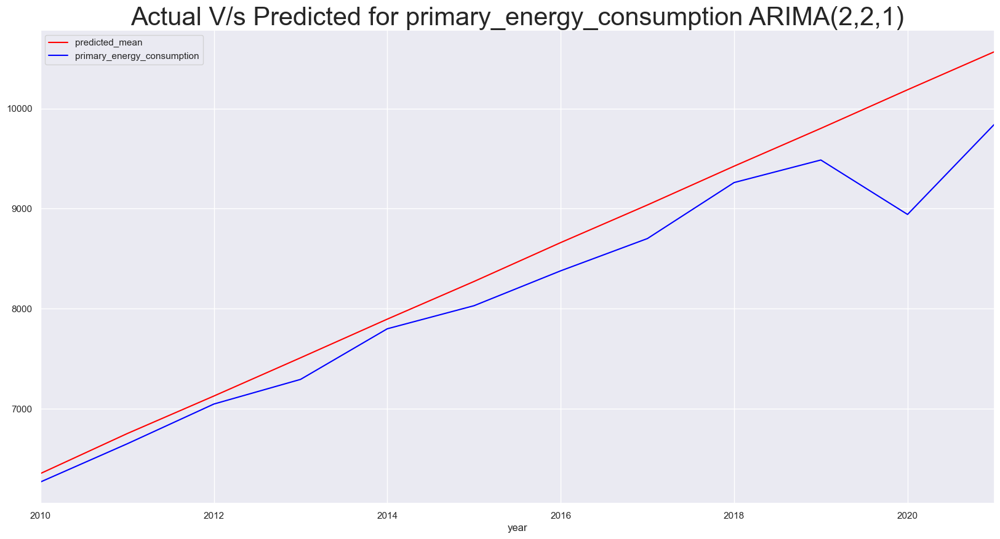

In [874]:
#Let us compare the test data and predicted values
df_india_Arima_221_predict_tenergy.plot(figsize=(20,10),color="red",legend=True)
df_india_test.primary_energy_consumption.plot(color="blue",legend=True)
plt.title("Actual V/s Predicted for primary_energy_consumption ARIMA(2,2,1)",size=30)
plt.show()

In [875]:
rmse=sqrt(mean_squared_error(df_india_Arima_221_predict_tenergy,df_india_test['primary_energy_consumption']))
print(rmse)

459.51530218007747


In [876]:
mean_absolute_percentage_error(y_true=df_india_test['primary_energy_consumption'],
                   y_pred=df_india_Arima_221_predict_tenergy)

3.736870091281875

## FB Prophet model for INDIA 

## 1. Prediction for Renewable consumption 

In [877]:
df_india_no_index.columns = ['ds','y']
df_india_no_index.head()

,ds,y
9230,1965-01-01,56.676
9231,1966-01-01,59.186
9232,1967-01-01,66.229
9233,1968-01-01,76.435
9234,1969-01-01,84.864


In [878]:
train_india = df_india_no_index.iloc[:len(df_india_no_index)-5]
test_india = df_india_no_index.iloc[len(df_india_no_index)-5:]
test_india

,ds,y
9282,2017-01-01,653.612
9283,2018-01-01,732.754
9284,2019-01-01,839.442
9285,2020-01-01,870.051
9286,2021-01-01,916.301


In [879]:
model_india = Prophet()
model_india.fit(train_india)
future_india = m.make_future_dataframe(periods=9,freq='AS') #AS for annually
forecast_india = m.predict(future_india)

14:20:58 - cmdstanpy - INFO - Chain [1] start processing
14:20:58 - cmdstanpy - INFO - Chain [1] done processing


In [880]:
forecast_india[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
49,2014-01-01,3140.147609,3074.089558,3206.024625
50,2015-01-01,3207.955314,3139.238726,3279.351571
51,2016-01-01,3283.615732,3215.248850,3355.872754
52,2017-01-01,3338.788171,3272.366335,3406.809221
53,2018-01-01,3398.743846,3327.355057,3462.818911


In [881]:
test_india.tail()

,ds,y
9282,2017-01-01,653.612
9283,2018-01-01,732.754
9284,2019-01-01,839.442
9285,2020-01-01,870.051
9286,2021-01-01,916.301


In [882]:
plot_plotly(model_india,forecast_india)

In [883]:
plot_components_plotly(model_india, forecast_india)


In [884]:
predictions_india = forecast_india.iloc[-5:]['yhat']
predictions_india.tail()

49    3140.147609
50    3207.955314
51    3283.615732
52    3338.788171
53    3398.743846
Name: yhat, dtype: float64

In [885]:
test_india['y'].tail()

9282    653.612
9283    732.754
9284    839.442
9285    870.051
9286    916.301
Name: y, dtype: float64

In [887]:
from statsmodels.tools.eval_measures import rmse


In [888]:
print("Root Mean Squared Error between actual and  predicted values for india: ",rmse(predictions_india,test_india['y']))
print("Mean Value of Test Dataset for india:", test_india['y'].mean())

Root Mean Squared Error between actual and  predicted values for india:  2471.4632030395574
Mean Value of Test Dataset for india: 802.432


In [889]:
mean_absolute_percentage_error(y_true=test_india['y'],
                   y_pred=predictions_india)

312.81139795405466

## 2. Predictions for Renewable share 

In [890]:
df_india_No_index_rshare.head()

,year,renewables_share_energy
9230,1965-01-01,9.149
9231,1966-01-01,9.271
9232,1967-01-01,10.059
9233,1968-01-01,10.858
9234,1969-01-01,10.874


In [891]:
df_india_No_index_rshare.columns = ['ds','y']
df_india_No_index_rshare.head()

,ds,y
9230,1965-01-01,9.149
9231,1966-01-01,9.271
9232,1967-01-01,10.059
9233,1968-01-01,10.858
9234,1969-01-01,10.874


In [892]:
train = df_india_No_index_rshare.iloc[:len(df_india_No_index_rshare)-12]
test = df_india_No_index_rshare.iloc[len(df_india_No_index_rshare)-12:]
test.head()

,ds,y
9275,2010-01-01,6.584
9276,2011-01-01,7.501
9277,2012-01-01,6.727
9278,2013-01-01,7.330
9279,2014-01-01,7.344


In [893]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

14:24:09 - cmdstanpy - INFO - Chain [1] start processing
14:24:09 - cmdstanpy - INFO - Chain [1] done processing


In [894]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,-8.261865,3.035968,6.942173,-8.262384,-8.261371,13.235508,13.235508,13.235508,13.235508,13.235508,13.235508,0.0,0.0,0.0,4.973644
53,2018-01-01,-8.402285,3.155128,6.845949,-8.402901,-8.401699,13.372271,13.372271,13.372271,13.372271,13.372271,13.372271,0.0,0.0,0.0,4.969987
54,2019-01-01,-8.542704,2.898363,6.838576,-8.543429,-8.542021,13.473178,13.473178,13.473178,13.473178,13.473178,13.473178,0.0,0.0,0.0,4.930474
55,2020-01-01,-8.683124,3.008664,6.865068,-8.683951,-8.682331,13.538108,13.538108,13.538108,13.538108,13.538108,13.538108,0.0,0.0,0.0,4.854984
56,2021-01-01,-8.823928,2.543454,6.134526,-8.824860,-8.823013,13.235508,13.235508,13.235508,13.235508,13.235508,13.235508,0.0,0.0,0.0,4.411580


In [895]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,4.973644,3.035968,6.942173
53,2018-01-01,4.969987,3.155128,6.845949
54,2019-01-01,4.930474,2.898363,6.838576
55,2020-01-01,4.854984,3.008664,6.865068
56,2021-01-01,4.411580,2.543454,6.134526


In [896]:
test.tail()


,ds,y
9282,2017-01-01,7.512
9283,2018-01-01,7.913
9284,2019-01-01,8.850
9285,2020-01-01,9.730
9286,2021-01-01,9.311


In [897]:
plot_plotly(m,forecast)


In [898]:
plot_components_plotly(m, forecast)


In [899]:
predictions = forecast.iloc[-12:]['yhat']
predictions.tail()

52    4.973644
53    4.969987
54    4.930474
55    4.854984
56    4.411580
Name: yhat, dtype: float64

In [900]:
test['y'].tail()

9282    7.512
9283    7.913
9284    8.850
9285    9.730
9286    9.311
Name: y, dtype: float64

In [901]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))


Root Mean Squared Error between actual and  predicted values:  2.784428843915316


In [902]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

29.2730611482517

## 3. Predictions for Total Energy 

In [903]:
df_india_No_index_tenergy.head()

,year,primary_energy_consumption
9230,1965-01-01,619.451
9231,1966-01-01,638.414
9232,1967-01-01,658.433
9233,1968-01-01,703.985
9234,1969-01-01,780.436


In [904]:
df_india_No_index_tenergy.columns = ['ds','y']
df_india_No_index_tenergy.head()

,ds,y
9230,1965-01-01,619.451
9231,1966-01-01,638.414
9232,1967-01-01,658.433
9233,1968-01-01,703.985
9234,1969-01-01,780.436


In [905]:
train = df_india_No_index_tenergy.iloc[:len(df_india_No_index_tenergy)-12]
test = df_india_No_index_tenergy.iloc[len(df_india_No_index_tenergy)-12:]
test.head()

,ds,y
9275,2010-01-01,6269.459
9276,2011-01-01,6650.710
9277,2012-01-01,7048.088
9278,2013-01-01,7294.344
9279,2014-01-01,7799.773


In [906]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=12,freq='AS') #AS for annually
forecast = m.predict(future)

14:29:08 - cmdstanpy - INFO - Chain [1] start processing
14:29:09 - cmdstanpy - INFO - Chain [1] done processing


In [907]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
52,2017-01-01,8336.523754,7313.059464,7665.984856,8200.651386,8442.135020,-830.150507,-830.150507,-830.150507,-830.150507,-830.150507,-830.150507,0.0,0.0,0.0,7506.373247
53,2018-01-01,8565.258166,7491.410813,7883.493035,8402.383146,8694.446606,-863.307960,-863.307960,-863.307960,-863.307960,-863.307960,-863.307960,0.0,0.0,0.0,7701.950207
54,2019-01-01,8793.992579,7686.773510,8124.072810,8608.718371,8948.649378,-867.249584,-867.249584,-867.249584,-867.249584,-867.249584,-867.249584,0.0,0.0,0.0,7926.742995
55,2020-01-01,9022.726992,7925.237971,8406.129106,8806.078738,9207.369720,-841.985300,-841.985300,-841.985300,-841.985300,-841.985300,-841.985300,0.0,0.0,0.0,8180.741692
56,2021-01-01,9252.088074,8129.580757,8662.533461,9000.689685,9461.159618,-830.150507,-830.150507,-830.150507,-830.150507,-830.150507,-830.150507,0.0,0.0,0.0,8421.937567


In [908]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()


,ds,yhat,yhat_lower,yhat_upper
52,2017-01-01,7506.373247,7313.059464,7665.984856
53,2018-01-01,7701.950207,7491.410813,7883.493035
54,2019-01-01,7926.742995,7686.773510,8124.072810
55,2020-01-01,8180.741692,7925.237971,8406.129106
56,2021-01-01,8421.937567,8129.580757,8662.533461


In [909]:
test.tail()


,ds,y
9282,2017-01-01,8701.049
9283,2018-01-01,9260.351
9284,2019-01-01,9485.631
9285,2020-01-01,8941.913
9286,2021-01-01,9841.214


In [910]:
plot_plotly(m,forecast)


In [911]:
plot_components_plotly(m, forecast)


In [912]:
predictions = forecast.iloc[-12:]['yhat']
predictions.tail()

52    7506.373247
53    7701.950207
54    7926.742995
55    8180.741692
56    8421.937567
Name: yhat, dtype: float64

In [913]:
test['y'].tail()

9282    8701.049
9283    9260.351
9284    9485.631
9285    8941.913
9286    9841.214
Name: y, dtype: float64

In [914]:
print("Root Mean Squared Error between actual and  predicted values: ",rmse(predictions,test['y']))


Root Mean Squared Error between actual and  predicted values:  1065.96160489049


In [915]:
mean_absolute_percentage_error(y_true=test['y'],
                   y_pred=predictions)

11.9301196336427

# Forecasting Using VAR Model

## 1. Predictions for renewable consumption 

In [916]:
df_var_india=df_world_var[df_world_var['country'].isin(['India'])]
df_var_india

,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
9165,India,1900,IND,NaN,NaN,NaN,NaN,NaN,NaN
9166,India,1901,IND,NaN,NaN,NaN,NaN,NaN,NaN
9167,India,1902,IND,NaN,NaN,NaN,NaN,NaN,NaN
9168,India,1903,IND,NaN,NaN,NaN,NaN,NaN,NaN
9169,India,1904,IND,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
9282,India,2017,IND,653.612,8701.049,7951.889,482.657,5872.039,6425.252
9283,India,2018,IND,732.754,9260.351,8428.454,535.246,6156.636,6764.301
9284,India,2019,IND,839.442,9485.631,8531.949,606.923,6168.661,6858.180
9285,India,2020,IND,870.051,8941.913,7959.428,623.073,5700.015,6403.606


In [917]:
#Checking whether there are any null values in dataset
df_var_india.isnull().sum()

country                          0
year                             0
iso_code                         0
renewables_consumption          65
primary_energy_consumption      65
fossil_fuel_consumption         65
renewables_energy_per_capita    65
fossil_energy_per_capita        65
energy_per_capita               65
dtype: int64

In [918]:
df_var_india.dropna(inplace=True)
df_var_india.head()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\331106016.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
9230,India,1965,IND,56.676,619.451,562.775,113.327,1125.293,1238.620
9231,India,1966,IND,59.186,638.414,579.228,115.825,1133.536,1249.360
9232,India,1967,IND,66.229,658.433,592.204,126.879,1134.519,1261.398
9233,India,1968,IND,76.435,703.985,627.550,143.290,1176.438,1319.728
9234,India,1969,IND,84.864,780.436,693.515,155.625,1271.770,1431.166


In [919]:
#As we have no dates ,So converting into year format
df_var_india.year=pd.to_datetime(df_var_india.year,format='%Y', errors='coerce')


C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2955697202.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [920]:
df_var_india.set_index("year",inplace=True)
df_var_india.head()

,country,iso_code,renewables_consumption,primary_energy_consumption,fossil_fuel_consumption,renewables_energy_per_capita,fossil_energy_per_capita,energy_per_capita
year,,,,,,,,
1965-01-01,India,IND,56.676,619.451,562.775,113.327,1125.293,1238.620
1966-01-01,India,IND,59.186,638.414,579.228,115.825,1133.536,1249.360
1967-01-01,India,IND,66.229,658.433,592.204,126.879,1134.519,1261.398
1968-01-01,India,IND,76.435,703.985,627.550,143.290,1176.438,1319.728
1969-01-01,India,IND,84.864,780.436,693.515,155.625,1271.770,1431.166


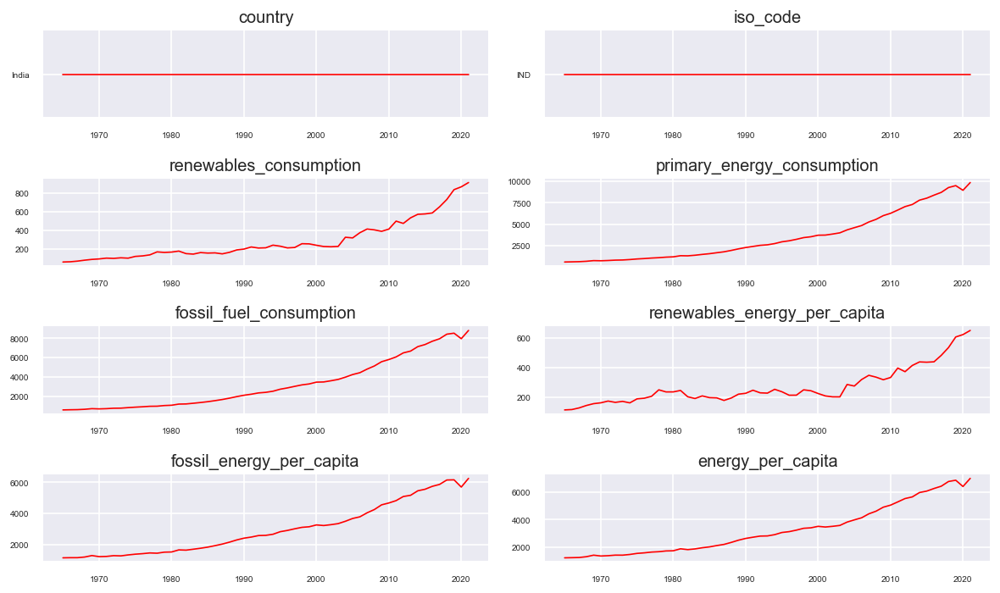

In [921]:
fig, axes = plt.subplots(nrows=4, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_india[df_var_india.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_india.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

The pattern of renewable energy consumption and renewable per capita are almost same,So these two are considered.

In [922]:
print('renewables_energy_per_capita causes renewables_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_india[['renewables_consumption', 'renewables_energy_per_capita']], 8)

print('\n renewables_consumption causes renewables_energy_per_capita?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_india[['renewables_energy_per_capita', 'renewables_consumption']], 8)

renewables_energy_per_capita causes renewables_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=4.2325  , p=0.0446  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=4.4721  , p=0.0345  , df=1
likelihood ratio test: chi2=4.3025  , p=0.0381  , df=1
parameter F test:         F=4.2325  , p=0.0446  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=1.8364  , p=0.1700  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=4.0401  , p=0.1326  , df=2
likelihood ratio test: chi2=3.8986  , p=0.1424  , df=2
parameter F test:         F=1.8364  , p=0.1700  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.9111  , p=0.4428  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=3.1403  , p=0.3705  , df=3
likelihood ratio test: chi2=3.0524  , p=0.3836  , df=3
parameter F test:         F=0.9111  , p=0.4428  , df_denom=47, df_num=3

Granger Causality
n

In [923]:
print('\n So Finally renewables_consumption causes renewables_energy_per_capita\n')
#Taking two of them into separate dataframe before fitting into model
df_var_india=df_var_india[['renewables_energy_per_capita', 'renewables_consumption']]
print(df_var_india.shape)


 So Finally renewables_consumption causes renewables_energy_per_capita

(57, 2)


In [924]:
train_var_india=df_var_india[:-12]
test_var_india=df_var_india[-12:]

In [925]:
model = VAR(train_var_india)


C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [926]:
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        14.56       14.65   2.111e+06       14.59
1       9.686*      9.953*  1.610e+04*      9.778*
2        9.888       10.33   1.977e+04       10.04
3        10.08       10.71   2.422e+04       10.30
4        10.03       10.83   2.333e+04       10.31
5        10.12       11.10   2.597e+04       10.46
6        9.759       10.91   1.865e+04       10.16
7        9.903       11.24   2.251e+04       10.36
8        9.927       11.44   2.449e+04       10.45
9        10.14       11.83   3.307e+04       10.73
10       10.34       12.21   4.496e+04       10.99
--------------------------------------------------


Every parameter is lower at order '1'.Therefore it is best model.

In [927]:
var_model = VARMAX(train_var_india, order=(1,0),enforce_stationarity= True)
fitted_model = var_model.fit(disp=False)
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\varmax.py:374: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



                                               Statespace Model Results                                               
Dep. Variable:     ['renewables_energy_per_capita', 'renewables_consumption']   No. Observations:                   45
Model:                                                                 VAR(1)   Log Likelihood                -377.115
                                                                  + intercept   AIC                            772.231
Date:                                                        Fri, 28 Jul 2023   BIC                            788.491
Time:                                                                14:33:00   HQIC                           778.292
Sample:                                                            01-01-1965                                         
                                                                 - 01-01-2009                                         
Covariance Type:                                

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [928]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [929]:
#Naming the columns of predicted results with suitable names
predictions.columns=['india_ per capita consumption_predicted','india_consumption_predicted']
predictions

,india_ per capita consumption_predicted,india_consumption_predicted
2010-01-01,319.107432,388.911535
2011-01-01,318.285587,387.163730
2012-01-01,317.387793,385.362134
2013-01-01,316.498055,383.580332
2014-01-01,315.619366,381.820793
2015-01-01,314.751704,380.083340
2016-01-01,313.894934,378.367699
2017-01-01,313.048920,376.673596
2018-01-01,312.213527,375.000760
2019-01-01,311.388622,373.348926


<Axes: >

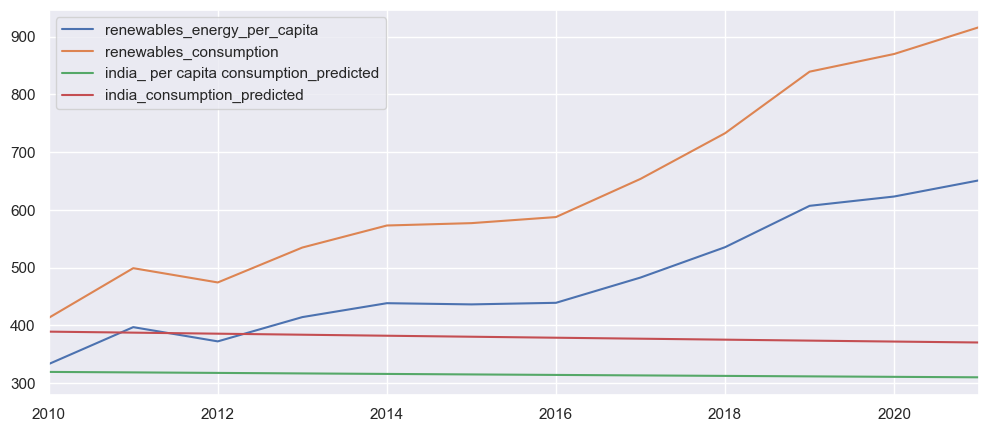

In [930]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_india,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [931]:
mean_absolute_percentage_error(y_true=test_var_india['renewables_consumption'],
                   y_pred=predictions['india_consumption_predicted'])

36.818214884555495

In [932]:
rmse_consumption=math.sqrt(mean_squared_error(predictions['india_consumption_predicted'],test_var_india['renewables_consumption']))
print('Mean value of consumption is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_india['renewables_consumption']),rmse_consumption))

Mean value of consumption is : 639.1559166666667. Root Mean Squared Error is :307.0443409695475


# Future Consumption of India

Out of all four models,Auto ARIMA predicts better with less error.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



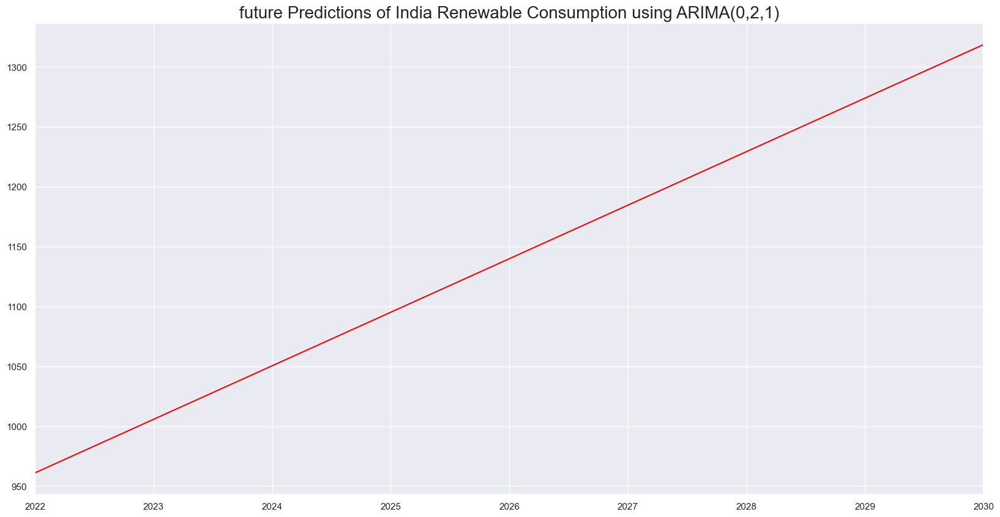

In [933]:
#let us fit the model with the whole dataset
model_AR_I_MA_021=ARIMA(df_india.renewables_consumption[1:],order=(0,2,1))
results_AR_I_MA_021=model_AR_I_MA_021.fit()
#Let us forecast the future consumption of india
df_india_Arima_021_forecast=results_AR_I_MA_021.predict(start="2022-01-01",end="2030-01-01")
#Let us visualise the predicted data
df_india_Arima_021_forecast.plot(figsize=(20,10),color="red")
plt.title("future Predictions of India Renewable Consumption using ARIMA(0,2,1)",size=20)
plt.show()

In [934]:
df_india_Arima_021_forecast

2022-01-01     961.016644
2023-01-01    1005.732287
2024-01-01    1050.447931
2025-01-01    1095.163574
2026-01-01    1139.879218
2027-01-01    1184.594861
2028-01-01    1229.310505
2029-01-01    1274.026149
2030-01-01    1318.741792
Freq: AS-JAN, Name: predicted_mean, dtype: float64

## 2. Predictions for renewable share 

In [935]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_2_india=df_world_var_2[df_world_var_2['country'].isin(['India'])]
df_var_2_india

,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
9165,India,1900,IND,NaN,NaN,NaN,NaN
9166,India,1901,IND,NaN,NaN,NaN,NaN
9167,India,1902,IND,NaN,NaN,NaN,NaN
9168,India,1903,IND,NaN,NaN,NaN,NaN
9169,India,1904,IND,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
9282,India,2017,IND,7.512,0.914,1.098,91.390
9283,India,2018,IND,7.913,0.938,1.071,91.017
9284,India,2019,IND,8.850,1.060,1.204,89.946
9285,India,2020,IND,9.730,1.176,1.257,89.013


In [936]:
#dropping the null values corresponding to initial years of null data
df_var_2_india.dropna(inplace=True)
df_var_2_india.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\2011641921.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
9282,India,2017,IND,7.512,0.914,1.098,91.390
9283,India,2018,IND,7.913,0.938,1.071,91.017
9284,India,2019,IND,8.850,1.060,1.204,89.946
9285,India,2020,IND,9.730,1.176,1.257,89.013
9286,India,2021,IND,9.311,1.151,1.121,89.569


In [937]:
#Converting them into date time format with years format
df_var_2_india.year=pd.to_datetime(df_var_2_india.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\3613100951.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [938]:
#Setting the year as index
df_var_2_india.set_index("year",inplace=True)
df_var_2_india.tail()

,country,iso_code,renewables_share_energy,other_renewables_share_energy,nuclear_share_energy,fossil_share_energy
year,,,,,,
2017-01-01,India,IND,7.512,0.914,1.098,91.390
2018-01-01,India,IND,7.913,0.938,1.071,91.017
2019-01-01,India,IND,8.850,1.060,1.204,89.946
2020-01-01,India,IND,9.730,1.176,1.257,89.013
2021-01-01,India,IND,9.311,1.151,1.121,89.569


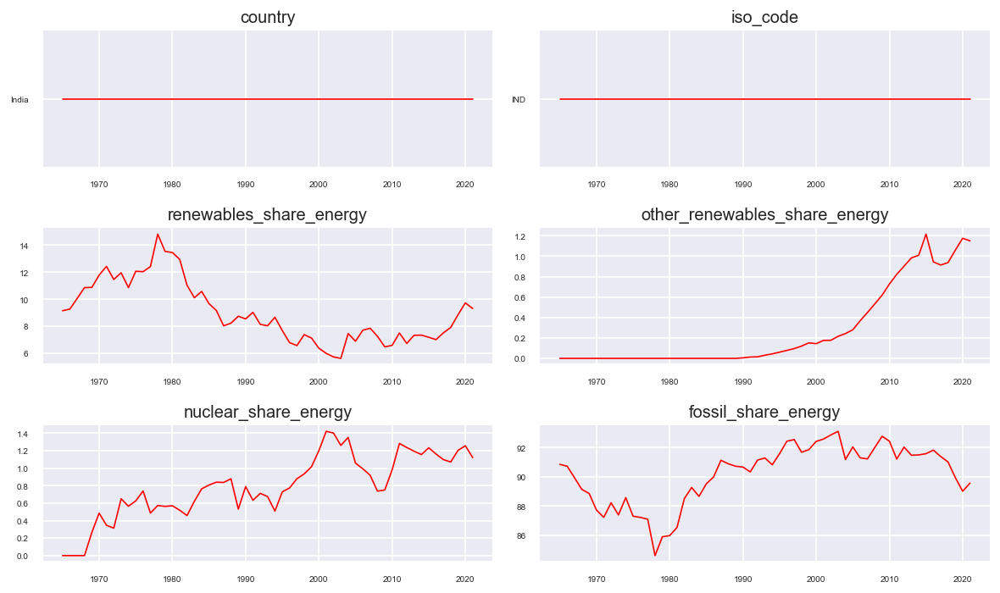

In [939]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=3, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_2_india[df_var_2_india.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_2_india.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

renewables and fossil fuel share having opposite trends

In [940]:
#Let us check which time series is causing the other using granger casuality tests
print('renewables_share_energy causes fossil_share_energy?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_2_india[['fossil_share_energy', 'renewables_share_energy']], 8)
print('\n fossil_share_energy causes renewables_share_energy?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_2_india[['renewables_share_energy', 'fossil_share_energy']], 8)

renewables_share_energy causes fossil_share_energy?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=2.1932  , p=0.1445  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=2.3174  , p=0.1279  , df=1
likelihood ratio test: chi2=2.2707  , p=0.1318  , df=1
parameter F test:         F=2.1932  , p=0.1445  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=1.3051  , p=0.2802  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=2.8713  , p=0.2380  , df=2
likelihood ratio test: chi2=2.7989  , p=0.2467  , df=2
parameter F test:         F=1.3051  , p=0.2802  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=0.6273  , p=0.6010  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=2.1623  , p=0.5394  , df=3
likelihood ratio test: chi2=2.1201  , p=0.5479  , df=3
parameter F test:         F=0.6273  , p=0.6010  , df_denom=47, df_num=3

Granger Causality
number of

In [941]:
print('\n So Finally renewables_share_energy causes fossil_share_energy\n')
#Taking two of them into separate dataframe before fitting into model
df_var_2_india=df_var_2_india[['fossil_share_energy', 'renewables_share_energy']]
print(df_var_2_india.shape)


 So Finally renewables_share_energy causes fossil_share_energy

(57, 2)


In [942]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_2_india=df_var_2_india[:-12]
test_var_2_india=df_var_2_india[-12:]

In [943]:
#Taking the training data for modelling
model = VAR(train_var_2_india)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [944]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -1.489      -1.400      0.2256      -1.458
1      -4.086*     -3.820*    0.01682*     -3.994*
2       -3.953      -3.509     0.01927      -3.800
3       -3.789      -3.167     0.02287      -3.574
4       -3.838      -3.038     0.02205      -3.562
5       -3.658      -2.680     0.02695      -3.320
6       -3.610      -2.454     0.02916      -3.211
7       -3.611      -2.277     0.03043      -3.150
8       -3.583      -2.072     0.03322      -3.062
9       -3.791      -2.103     0.02930      -3.209
10      -3.748      -1.882     0.03419      -3.104
--------------------------------------------------


Order '1' is confirmed

In [945]:
var_model = VARMAX(train_var_2_india, order=(1,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

                                           Statespace Model Results                                           
Dep. Variable:     ['fossil_share_energy', 'renewables_share_energy']   No. Observations:                   45
Model:                                                         VAR(1)   Log Likelihood                 -34.684
                                                          + intercept   AIC                             87.367
Date:                                                Fri, 28 Jul 2023   BIC                            103.627
Time:                                                        14:44:28   HQIC                            93.429
Sample:                                                    01-01-1965                                         
                                                         - 01-01-2009                                         
Covariance Type:                                                  opg                                         
L

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [946]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [947]:
#Naming the columns of predicted results with suitable names
predictions.columns=['fossil_share_energy_predicted','renewables_share_energy_predicted']
predictions

,fossil_share_energy_predicted,renewables_share_energy_predicted
2010-01-01,92.530021,6.697804
2011-01-01,92.330801,6.882572
2012-01-01,92.166888,7.037649
2013-01-01,92.029791,7.169974
2014-01-01,91.913209,7.284706
2015-01-01,91.812459,7.385690
2016-01-01,91.724050,7.475798
2017-01-01,91.645379,7.557184
2018-01-01,91.574494,7.631467
2019-01-01,91.509929,7.699873


<Axes: >

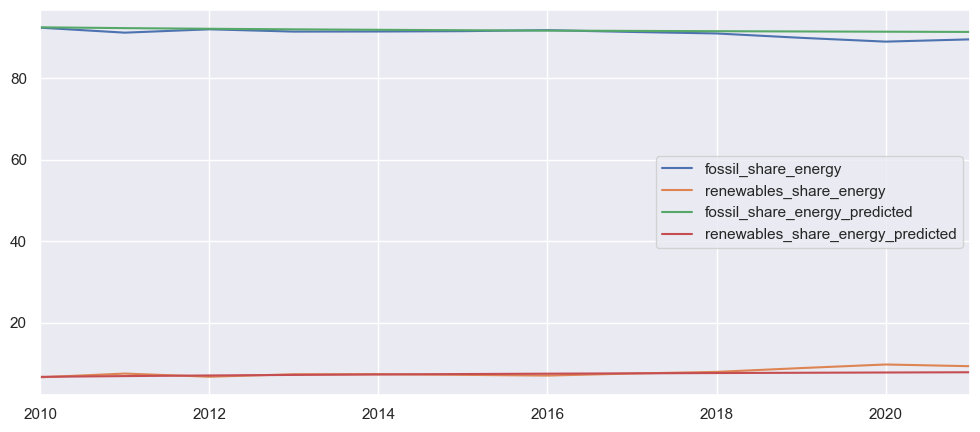

In [948]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_2_india,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [949]:
mean_absolute_percentage_error(y_true=test_var_2_india['renewables_share_energy'],
                   y_pred=predictions['renewables_share_energy_predicted'])

6.696459221737756

In [950]:
rmse_rshare=math.sqrt(mean_squared_error(predictions['renewables_share_energy_predicted'],test_var_2_india['renewables_share_energy']))
print('Mean value of renewable share is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_2_india['renewables_share_energy']),rmse_rshare))

Mean value of renewable share is : 7.749833333333333. Root Mean Squared Error is :0.8298905377182761


## forecasting future renewable share 

Out of all four models VAR (1,0) is predicting better

In [951]:
#Forecasting into future
n_forecast = 19
predict = fitted_model.get_prediction(start="2022-01-01",end="2030-01-01")
predictions=predict.predicted_mean

<Axes: >

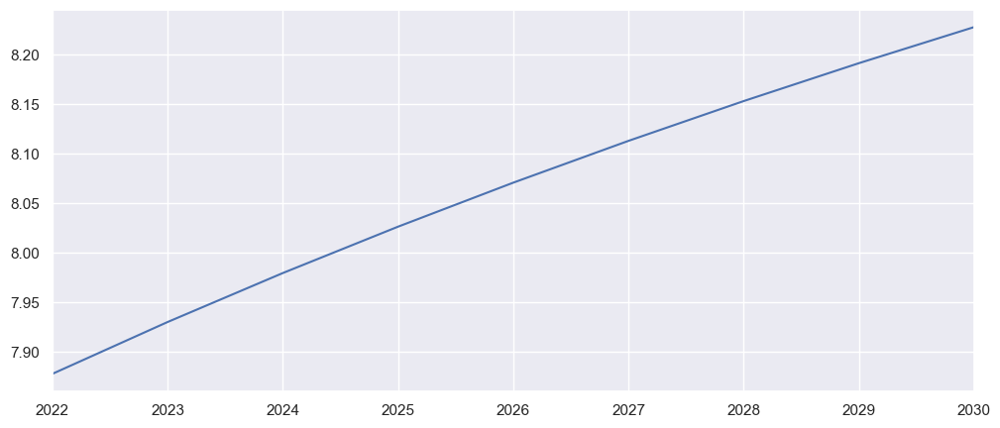

In [952]:
predictions['renewables_share_energy'].plot(figsize=(12,5))

In [953]:
predictions['renewables_share_energy']

2022-01-01    7.878135
2023-01-01    7.930459
2024-01-01    7.979887
2025-01-01    8.026697
2026-01-01    8.071112
2027-01-01    8.113322
2028-01-01    8.153482
2029-01-01    8.191728
2030-01-01    8.228178
Freq: AS-JAN, Name: renewables_share_energy, dtype: float64

## 3. Predictions for total energy 

In [954]:
#Taking this country data separately in a data frame where relevant dependent variables are also considered
df_var_3_india=df_world_var_3[df_world_var_3['country'].isin(['India'])]
df_var_3_india

,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
9165,India,1900,IND,NaN,NaN,NaN,NaN
9166,India,1901,IND,NaN,NaN,NaN,NaN
9167,India,1902,IND,NaN,NaN,NaN,NaN
9168,India,1903,IND,NaN,NaN,NaN,NaN
9169,India,1904,IND,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
9282,India,2017,IND,8701.049,653.612,95.548,7951.889
9283,India,2018,IND,9260.351,732.754,99.143,8428.454
9284,India,2019,IND,9485.631,839.442,114.238,8531.949
9285,India,2020,IND,8941.913,870.051,112.433,7959.428


In [955]:
#dropping the null values corresponding to initial years of null data
df_var_3_india.dropna(inplace=True)
df_var_3_india.tail()

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1186423707.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,country,year,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
9282,India,2017,IND,8701.049,653.612,95.548,7951.889
9283,India,2018,IND,9260.351,732.754,99.143,8428.454
9284,India,2019,IND,9485.631,839.442,114.238,8531.949
9285,India,2020,IND,8941.913,870.051,112.433,7959.428
9286,India,2021,IND,9841.214,916.301,110.276,8814.637


In [956]:
#Converting them into date time format with years format
df_var_3_india.year=pd.to_datetime(df_var_3_india.year,format='%Y', errors='coerce')

C:\Users\91970\AppData\Local\Temp\ipykernel_13476\1732787044.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [957]:
#Setting the year as index
df_var_3_india.set_index("year",inplace=True)
df_var_3_india.tail()

,country,iso_code,primary_energy_consumption,renewables_consumption,nuclear_consumption,fossil_fuel_consumption
year,,,,,,
2017-01-01,India,IND,8701.049,653.612,95.548,7951.889
2018-01-01,India,IND,9260.351,732.754,99.143,8428.454
2019-01-01,India,IND,9485.631,839.442,114.238,8531.949
2020-01-01,India,IND,8941.913,870.051,112.433,7959.428
2021-01-01,India,IND,9841.214,916.301,110.276,8814.637


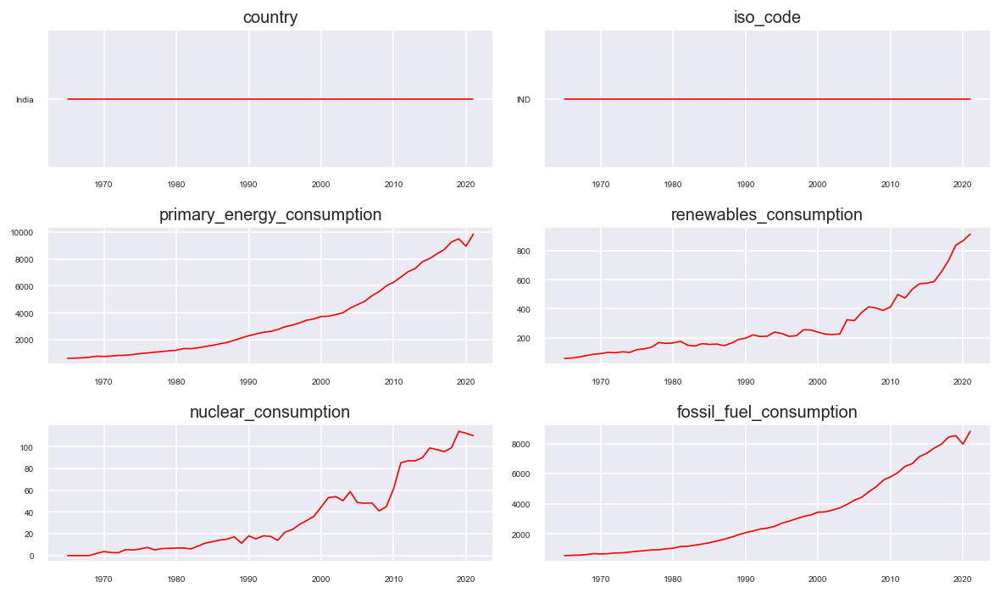

In [958]:
#Creating Sub plots to view the pattern of data
fig, axes = plt.subplots(nrows=3, ncols=2, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = df_var_3_india[df_var_3_india.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(df_var_3_india.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

primary and fossil fuel consumption are look alike

In [959]:
#Let us check which time series is causing the other using granger casuality tests
print('primary_energy_consumption causes fossil_fuel_consumption?\n')
print('------------------')
granger_1 = grangercausalitytests(df_var_3_india[['fossil_fuel_consumption', 'primary_energy_consumption']], 8)
print('\n fossil_fuel_consumption causes primary_energy_consumption?\n')
print('------------------')
granger_2 = grangercausalitytests(df_var_3_india[['primary_energy_consumption', 'fossil_fuel_consumption']], 8)

primary_energy_consumption causes fossil_fuel_consumption?

------------------

Granger Causality
number of lags (no zero) 1
ssr based F test:         F=0.2313  , p=0.6325  , df_denom=53, df_num=1
ssr based chi2 test:   chi2=0.2444  , p=0.6211  , df=1
likelihood ratio test: chi2=0.2439  , p=0.6214  , df=1
parameter F test:         F=0.2313  , p=0.6325  , df_denom=53, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=2.9823  , p=0.0598  , df_denom=50, df_num=2
ssr based chi2 test:   chi2=6.5611  , p=0.0376  , df=2
likelihood ratio test: chi2=6.1984  , p=0.0451  , df=2
parameter F test:         F=2.9823  , p=0.0598  , df_denom=50, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=2.3495  , p=0.0844  , df_denom=47, df_num=3
ssr based chi2 test:   chi2=8.0984  , p=0.0440  , df=3
likelihood ratio test: chi2=7.5457  , p=0.0564  , df=3
parameter F test:         F=2.3495  , p=0.0844  , df_denom=47, df_num=3

Granger Causality
nu

In [960]:
print('\n So Finally primary_energy_consumption causes fossil_fuel_consumption\n')
#Taking two of them into separate dataframe before fitting into model
df_var_3_india=df_var_3_india[['fossil_fuel_consumption', 'primary_energy_consumption']]
print(df_var_3_india.shape)


 So Finally primary_energy_consumption causes fossil_fuel_consumption

(57, 2)


In [961]:
#Taking 80% training and 20% for testing which is same for every model in this research
#here 20% means 12 years of data
train_var_3_india=df_var_3_india[:-12]
test_var_3_india=df_var_3_india[-12:]

In [970]:
#Taking the training data for modelling
model = VAR(train_var_3_india)

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



In [971]:
#Selecting the model order using function 'select_order'
#max_lags is just random number,lower number of lags might be better fit
sorted_order=model.select_order(maxlags=10)
print(sorted_order.summary())

 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0        20.93       21.02   1.233e+09       20.96
1       14.42*      14.69*  1.836e+06*      14.51*
2        14.64       15.08   2.287e+06       14.79
3        14.53       15.15   2.056e+06       14.74
4        14.59       15.39   2.228e+06       14.87
5        14.65       15.63   2.419e+06       14.99
6        14.51       15.67   2.164e+06       14.91
7        14.47       15.80   2.167e+06       14.93
8        14.65       16.16   2.761e+06       15.17
9        14.72       16.41   3.219e+06       15.31
10       14.60       16.46   3.170e+06       15.24
--------------------------------------------------


Order '1' is finalised

In [972]:
var_model = VARMAX(train_var_3_india, order=(1,0),enforce_stationarity= True)
#disp=false is to neglect just extra information regarding fitting
fitted_model = var_model.fit(disp=False)
#printing the summary
print(fitted_model.summary())

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\varmax.py:374: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.



                                               Statespace Model Results                                              
Dep. Variable:     ['fossil_fuel_consumption', 'primary_energy_consumption']   No. Observations:                   45
Model:                                                                VAR(1)   Log Likelihood                -709.675
                                                                 + intercept   AIC                           1437.349
Date:                                                       Fri, 28 Jul 2023   BIC                           1453.609
Time:                                                               15:24:48   HQIC                          1443.411
Sample:                                                           01-01-1965                                         
                                                                - 01-01-2009                                         
Covariance Type:                                        

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



In [973]:
#predicting into 12 years(i.e testing dataset)
n_forecast = 12
predict = fitted_model.get_prediction(start="2010-01-01",end="2021-01-01")
#the above values are stored in predict object needs to be accessed via predicted_mean function below
predictions=predict.predicted_mean

In [974]:
#Naming the columns of predicted results with suitable names
predictions.columns=['fossil_fuel_consumption_predicted','primary_energy_consumption_predicted']
predictions

,fossil_fuel_consumption_predicted,primary_energy_consumption_predicted
2010-01-01,5685.581536,6337.640658
2011-01-01,1645.368329,2245.817889
2012-01-01,-6187.956546,-5894.793437
2013-01-01,-17300.378931,-17545.252984
2014-01-01,-31056.367975,-32036.051509
2015-01-01,-46732.281146,-48602.415724
2016-01-01,-63552.161457,-66422.235726
2017-01-01,-80724.243710,-84654.827712
2018-01-01,-97476.530320,-102478.787544
2019-01-01,-113089.911333,-119127.308509


<Axes: >

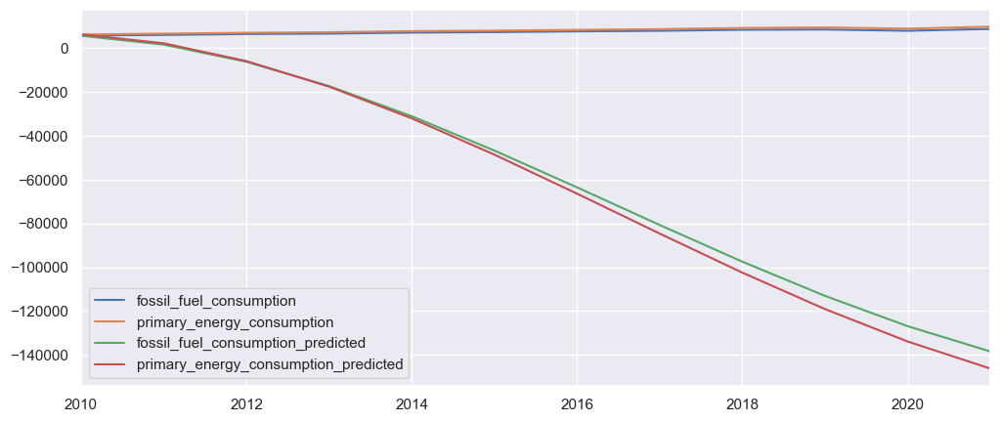

In [975]:
#plotting the actual and predicted values
test_vs_pred=pd.concat([test_var_3_india,predictions],axis=1)
test_vs_pred.plot(figsize=(12,5))

In [968]:
mean_absolute_percentage_error(y_true=test_var_3_india['primary_energy_consumption'],
                   y_pred=predictions['primary_energy_consumption_predicted'])

793.3139146780537

In [969]:
rmse_tenergy=math.sqrt(mean_squared_error(predictions['primary_energy_consumption_predicted'],test_var_3_india['primary_energy_consumption']))
print('Mean value of total energy is : {}. Root Mean Squared Error is :{}'.format(mean(test_var_3_india['primary_energy_consumption']),rmse_tenergy))

Mean value of total energy is : 8141.801166666667. Root Mean Squared Error is :88374.59416305374


## Forecasting Total energy of India

Out of all four models ARIMA (1,1,1) predicting better

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

C:\Users\91970\anaconda3\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



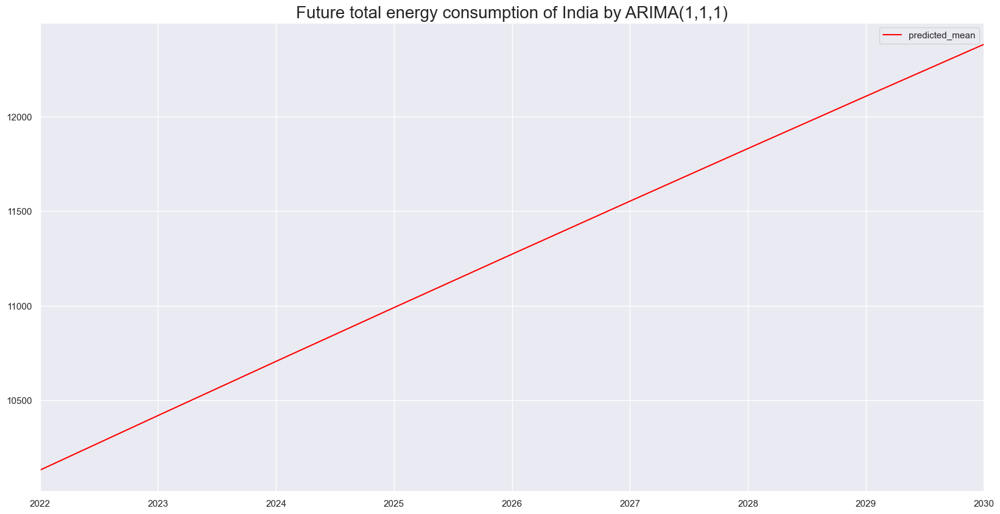

In [976]:
#Let us fit the model for whole dataset
model_Arima_111_tenergy=ARIMA(df_india.primary_energy_consumption[1:],order=(1,1,1))
model_Arima_111_tenergy=model_Arima_111_tenergy.fit()
#predicting the values for test dataset
start_date="2022-01-01"
end_date="2030-01-01"
df_india_Arima_111_predict_tenergy=model_Arima_111_tenergy.predict(start=start_date,end=end_date)
#Let us visualise the predicted data
df_india_Arima_111_predict_tenergy[start_date:end_date].plot(figsize=(20,10),color="red",legend=True)
plt.title("Future total energy consumption of India by ARIMA(1,1,1)",size=20)
plt.show()

In [977]:
df_india_Arima_111_predict_tenergy

2022-01-01    10131.542122
2023-01-01    10419.830532
2024-01-01    10706.093561
2025-01-01    10990.345438
2026-01-01    11272.600293
2027-01-01    11552.872155
2028-01-01    11831.174957
2029-01-01    12107.522531
2030-01-01    12381.928615
Freq: AS-JAN, Name: predicted_mean, dtype: float64

# Conclusion

In [978]:
cons_2020_cubci=np.array([5838.8,2590.2,1649.1,1172.6,870.0])
cons_2030_cubci=np.array([11234.8,2791.2,1850.4,1216.2,1318.7])
raise_cons=((cons_2030_cubci-cons_2020_cubci)/cons_2020_cubci)*100
print(raise_cons)

[92.41624991  7.76001853 12.20665818  3.71823299 51.57471264]


In [979]:
total_2020=np.sum(cons_2020_cubci)
total_2030=np.sum(cons_2030_cubci)
overall_raise_cons=((total_2030-total_2020)/total_2020)*100
print(overall_raise_cons)

51.8996427599066
